# **`Problem Statement`**:
 Given data about COVID-19 patients, write code to visualize the impact and \
 analyze the trend of rate of infection and recovery  as well as make predictions\
 about the number of cases expected a week in future based on the current trends.

# **`Project`**

### Imports and project setup

In [4]:
import os
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import plotly

In [5]:
import warnings
warnings.filterwarnings('ignore')

In [6]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors
import seaborn as sns

In [9]:
import math
import itertools

In [10]:
#date libraries
from dateutil import parser
from datetime import datetime, timedelta, date
import holidays

In [11]:
#prophet library
from prophet import Prophet
from prophet.diagnostics import performance_metrics
from prophet.plot import plot_cross_validation_metric
from prophet.diagnostics import cross_validation

In [12]:
#pandas options
pd.set_option('display.float_format', lambda x: '%.2f' % x)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [13]:
from sklearn.metrics import *

### Data Acquisition and Preparation

####  Data Injection and Quality Check

In [22]:
data = pd.read_csv('covid.csv')
display(data.head(),data.tail())
df = data.copy()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
0,NaN,Afghanistan,33.94,67.71,2020-01-22,0,0,0,0,Eastern Mediterranean
1,NaN,Albania,41.15,20.17,2020-01-22,0,0,0,0,Europe
2,NaN,Algeria,28.03,1.66,2020-01-22,0,0,0,0,Africa
3,NaN,Andorra,42.51,1.52,2020-01-22,0,0,0,0,Europe
4,NaN,Angola,-11.20,17.87,2020-01-22,0,0,0,0,Africa


,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
49063,NaN,Sao Tome and Principe,0.19,6.61,2020-07-27,865,14,734,117,Africa
49064,NaN,Yemen,15.55,48.52,2020-07-27,1691,483,833,375,Eastern Mediterranean
49065,NaN,Comoros,-11.65,43.33,2020-07-27,354,7,328,19,Africa
49066,NaN,Tajikistan,38.86,71.28,2020-07-27,7235,60,6028,1147,Europe
49067,NaN,Lesotho,-29.61,28.23,2020-07-27,505,12,128,365,Africa


In [23]:
data.shape

(49068, 10)

In [26]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49068 entries, 0 to 49067
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Province/State  14664 non-null  object 
 1   Country/Region  49068 non-null  object 
 2   Lat             49068 non-null  float64
 3   Long            49068 non-null  float64
 4   Date            49068 non-null  object 
 5   Confirmed       49068 non-null  int64  
 6   Deaths          49068 non-null  int64  
 7   Recovered       49068 non-null  int64  
 8   Active          49068 non-null  int64  
 9   WHO Region      49068 non-null  object 
dtypes: float64(2), int64(4), object(4)
memory usage: 3.7+ MB


#### Data Cleaning

##### Missing values imputation/ removal/ flagging

In [30]:
def missing_data(input_data):
    '''
    This function returns dataframe with information about the percentage of nulls in each column and the column data type.
    
    input: pandas df
    output: pandas df
    
    '''
    
    total = input_data.isnull().sum()
    percent = (input_data.isnull().sum()/input_data.isnull().count()*100)
    table = pd.concat([total, percent], axis = 1, keys = ['Total', 'Percent'])
    types = []
    for col in input_data.columns: 
        dtype = str(input_data[col].dtype)
        types.append(dtype)
    table["Types"] = types
    return(pd.DataFrame(table))

missing_data(data)

,Total,Percent,Types
Province/State,34404,70.11,object
Country/Region,0,0.00,object
Lat,0,0.00,float64
Long,0,0.00,float64
Date,0,0.00,object
Confirmed,0,0.00,int64
Deaths,0,0.00,int64
Recovered,0,0.00,int64
Active,0,0.00,int64
WHO Region,0,0.00,object


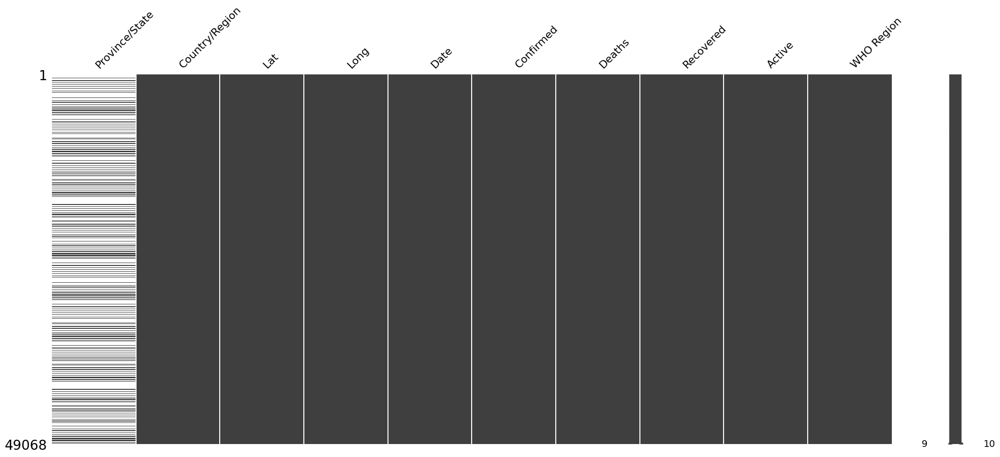

In [32]:
import missingno as msno

msno.matrix(data)
plt.show()

In [33]:
print('Number of countries: ',data['Country/Region'].nunique())

Number of countries:  187


Number of countries with Provice data:  8


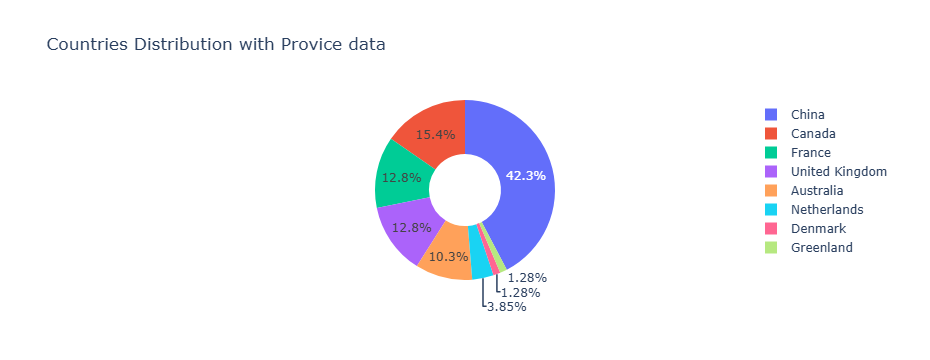

In [34]:
print('Number of countries with Provice data: ',data[data['Province/State'].notnull()]['Country/Region'].nunique())
fig = go.Figure(data=[go.Pie(labels=data[data['Province/State'].notnull()]['Country/Region'].value_counts().index, 
                             values=data[data['Province/State'].notnull()]['Country/Region'].value_counts().values, 
                             hole=0.4)])  

fig.update_layout(
    title="Countries Distribution with Provice data"
)

fig.show()

Number of countries with no Province/State data 183


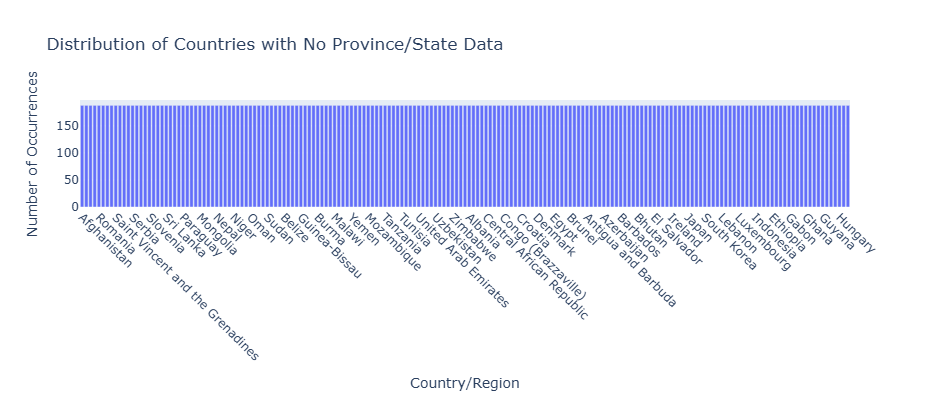

In [36]:
print('Number of countries with no Province/State data',data[data['Province/State'].isnull()]['Country/Region'].nunique())

null_province_data = data[data['Province/State'].isnull()]['Country/Region'].value_counts().reset_index()
null_province_data.columns = ['Country', 'Count']

fig = px.bar(
    null_province_data,
    x='Country',
    y='Count',
    title="Distribution of Countries with No Province/State Data",
    labels={'Count': 'Number of Occurrences', 'Country': 'Country/Region'},
    width=800,  
    height=400,  
)

fig.update_layout(
    xaxis=dict(tickangle=45), 
    showlegend=False
)

fig.show()

In [38]:
for country in data[data['Province/State'].notnull()]['Country/Region'].unique():
    # Check if the country is also present in countries with null 'Province/State' values
    if country in data[data['Province/State'].isnull()]['Country/Region'].unique():
        print(country)

Denmark
France
Netherlands
United Kingdom


In [39]:
countries = ['Denmark', 'France', 'Netherlands', 'United Kingdom']
filtered_data = data[data['Country/Region'].isin(countries)]
print('With Province data: ',
      filtered_data['Country/Region'].value_counts(),
     sep = '\n')
print('-------------------'*2)
print('Without Province data: ',
      filtered_data[filtered_data['Province/State'].isnull()]['Country/Region'].value_counts(),
     sep = '\n')

With Province data: 
France            2068
United Kingdom    2068
Netherlands        752
Denmark            376
Name: Country/Region, dtype: int64
--------------------------------------
Without Province data: 
Denmark           188
France            188
Netherlands       188
United Kingdom    188
Name: Country/Region, dtype: int64


In [41]:
data.pivot_table(index='Country/Region', columns='Province/State', aggfunc='size').isnull()

Province/State,Alberta,Anguilla,Anhui,Aruba,Australian Capital Territory,Beijing,Bermuda,British Columbia,British Virgin Islands,Cayman Islands,Channel Islands,Chongqing,Curacao,Falkland Islands (Malvinas),Faroe Islands,French Guiana,French Polynesia,Fujian,Gansu,Gibraltar,Greenland,Guadeloupe,Guangdong,Guangxi,Guizhou,Hainan,Hebei,Heilongjiang,Henan,Hong Kong,Hubei,Hunan,Inner Mongolia,Isle of Man,Jiangsu,Jiangxi,Jilin,Liaoning,Macau,Manitoba,Martinique,Mayotte,Montserrat,New Brunswick,New Caledonia,New South Wales,Newfoundland and Labrador,Ningxia,Northern Territory,Northwest Territories,Nova Scotia,Ontario,Prince Edward Island,Qinghai,Quebec,Queensland,Reunion,Saint Barthelemy,Saint Pierre and Miquelon,Saskatchewan,Shaanxi,Shandong,Shanghai,Shanxi,Sichuan,Sint Maarten,South Australia,St Martin,Tasmania,Tianjin,Tibet,Turks and Caicos Islands,Victoria,Western Australia,Xinjiang,Yukon,Yunnan,Zhejiang
Country/Region,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Australia,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,False,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,False,True,False,True,True,True,False,False,True,True,True,True
Canada,False,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,False,True,True,False,True,True,False,False,False,False,True,False,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True
China,True,True,False,True,True,False,True,True,True,True,True,False,True,True,True,True,True,False,False,True,True,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,True,True,True,True,True,True,True,True,False,True,True,True,True,True,False,True,True,True,True,True,True,False,False,False,False,False,True,True,True,True,False,False,True,True,True,False,True,False,False
Denmark,True,True,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
France,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,False,False,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,False,False,True,True,False,True,True,True,True,True,True,True,True,True,True,True,False,False,False,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True
Greenland,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
Netherlands,True,True,True,False,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True
United Kingdom,True,False,True,True,True,True,False,True,False,False,False,True,True,False,True,True,True,True,True,False,True,True,Tru

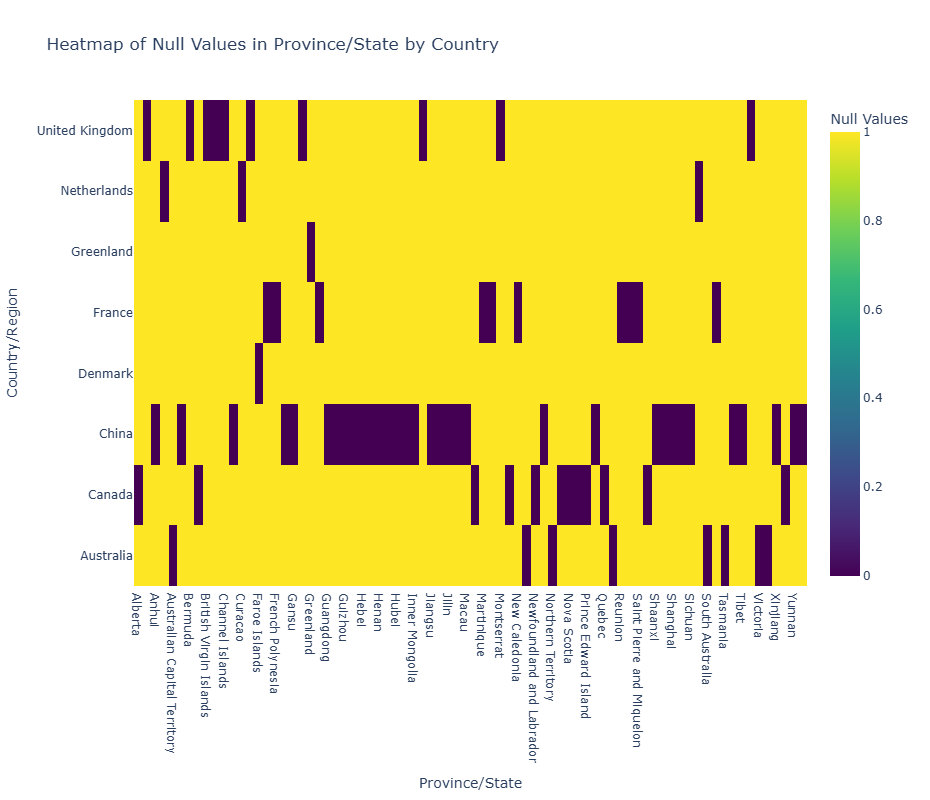

In [42]:
null_data = data.pivot_table(index='Country/Region', columns='Province/State', aggfunc='size').isnull().astype(int)

fig = go.Figure(
    data=go.Heatmap(
        z=null_data.values,          # Data values for heatmap
        x=null_data.columns,         # Columns representing Province/State
        y=null_data.index,           # Rows representing Country/Region
        colorscale='Viridis',        # Color scale for the heatmap
        colorbar_title="Null Values" # Title for the color bar
    )
)

fig.update_layout(
    title="Heatmap of Null Values in Province/State by Country",
    xaxis_title="Province/State",
    yaxis_title="Country/Region",
    width=800,                    
    height=800                     
)
fig.show()

In [43]:
# Only 8 countries have Province/ State details.
# even in those countries there are values of Province/State missing
##  We shall ignore the column for our analysis
data.drop(['Province/State'],axis = 1,inplace = True)
data.head()

,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
0,Afghanistan,33.94,67.71,2020-01-22,0,0,0,0,Eastern Mediterranean
1,Albania,41.15,20.17,2020-01-22,0,0,0,0,Europe
2,Algeria,28.03,1.66,2020-01-22,0,0,0,0,Africa
3,Andorra,42.51,1.52,2020-01-22,0,0,0,0,Europe
4,Angola,-11.20,17.87,2020-01-22,0,0,0,0,Africa


##### Duplicates deletion

In [50]:
data.duplicated().sum()

0

##### Data type conversion and Datetime data handling

In [54]:
data.dtypes,data.memory_usage(deep = True).sum()

(Country/Region     object
 Lat               float64
 Long              float64
 Date               object
 Confirmed           int64
 Deaths              int64
 Recovered           int64
 Active              int64
 WHO Region         object
 dtype: object,
 12116356)

In [56]:
data['Date'] = pd.to_datetime(data['Date'])

# data.set_index('Date', inplace=True) 

# data.sort_index(ascending=True, inplace=True) 

data[data.select_dtypes(include=['int64']).columns] = data.select_dtypes(include=['int64']).astype('int32')


data[data.select_dtypes(include='object').columns] = data.select_dtypes(include='object').astype('category')


print(data.dtypes)
print(data.memory_usage(deep=True).sum())

Country/Region          category
Lat                      float64
Long                     float64
Date              datetime64[ns]
Confirmed                  int32
Deaths                     int32
Recovered                  int32
Active                     int32
WHO Region              category
dtype: object
2127045


#### Exploratory Data Analysis (EDA)

#####  Dataset creation and Frequency alignment 

In [60]:
# global dataset

global_data = data.copy()
global_data['Date'] = pd.to_datetime(global_data['Date'])
global_data.set_index('Date',drop = True, inplace = True)
global_data = global_data.resample('D').sum()
# global_data.reset_index()
print(global_data.isnull().sum())
global_data.head()

Lat          0
Long         0
Confirmed    0
Deaths       0
Recovered    0
Active       0
dtype: int64


,Lat,Long,Confirmed,Deaths,Recovered,Active
Date,,,,,,
2020-01-22,5594.20,6140.87,555,17,28,510
2020-01-23,5594.20,6140.87,654,18,30,606
2020-01-24,5594.20,6140.87,941,26,36,879
2020-01-25,5594.20,6140.87,1434,42,39,1353
2020-01-26,5594.20,6140.87,2118,56,52,2010


In [62]:
global_data.drop(['Lat','Long'],axis = 1, inplace = True)
global_data.reset_index(inplace = True)
print(global_data.dtypes)
global_data.tail(3)

Date         datetime64[ns]
Confirmed             int32
Deaths                int32
Recovered             int32
Active                int32
dtype: object


,Date,Confirmed,Deaths,Recovered,Active
185,2020-07-25,16047190,644517,9158743,6243930
186,2020-07-26,16251796,648621,9293464,6309711
187,2020-07-27,16480485,654036,9468087,6358362


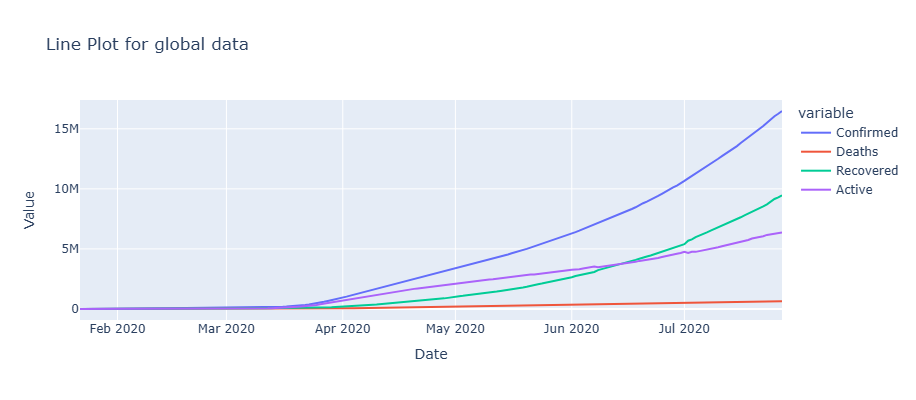

In [64]:
fig = px.line(
    global_data, 
    x='Date', 
    y=global_data.columns.tolist()[1:], 
    # color='Anomaly', 
    title="Line Plot for global data",
    labels={'Value': 'Observed Value', 'Date': 'Date'}
)
fig.update_layout(
    # legend_title="Anomaly Status",
    xaxis_title="Date",
    yaxis_title="Value",
    width=800,  
    height=400  
)
fig.show()

In [65]:
# On June 16, 2020 The number of cases recovered became more than the number of active cases globally

In [68]:
global_data.set_index('Date',drop = True, inplace = True)

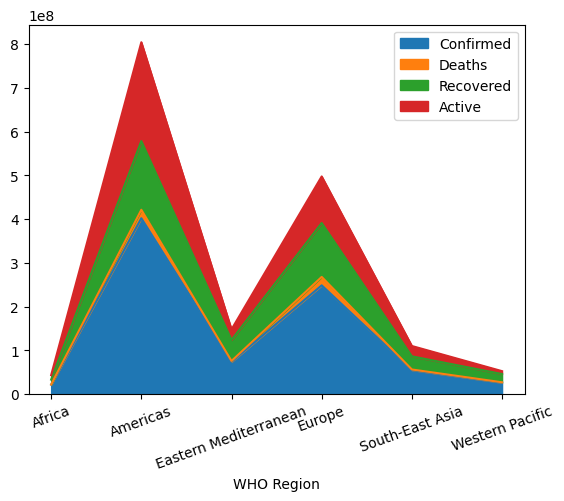

In [70]:
# Group data by 'WHO Region'
who_region_wise_data_sum = df.groupby('WHO Region').agg({
    'Confirmed': 'sum',
    'Deaths': 'sum',
    'Recovered': 'sum',
    'Active': 'sum'
}).reset_index()
who_region_wise_data_sum.index = who_region_wise_data_sum['WHO Region']
# Display the WHO region-wise data
who_region_wise_data_sum.plot(kind = 'area')
plt.xticks(rotation=20)
plt.show()

In [71]:
# WHO region wise data
who_region_datasets = {}
for region, group in data.groupby('WHO Region'):
    who_region_datasets[region] = group

who_region_datasets.keys()

dict_keys(['Africa', 'Americas', 'Eastern Mediterranean', 'Europe', 'South-East Asia', 'Western Pacific'])

In [74]:
def get_dict_shape(nested_dict):
    """
    Recursively traverse a nested dictionary and print its structure.
    """
    def recursive_traversal(d, level=0):
        print(f"Level {level}: {len(d)} keys")
        for key, value in d.items():
            if isinstance(value, dict):
                print(f"  - {key}:")
                recursive_traversal(value, level + 1)
            else:
                print(f"  - {key}: {type(value).__name__}")
    
    recursive_traversal(nested_dict)

get_dict_shape(who_region_datasets)

Level 0: 6 keys
  - Africa: DataFrame
  - Americas: DataFrame
  - Eastern Mediterranean: DataFrame
  - Europe: DataFrame
  - South-East Asia: DataFrame
  - Western Pacific: DataFrame


In [76]:
# Choosing Americas data since it has maximum cases
americas_data = who_region_datasets['Americas']
americas_data['Date'] = pd.to_datetime(americas_data['Date'])
americas_data.set_index('Date',inplace = True,drop = True)
americas_data = americas_data.resample('D').sum()
americas_data.drop(['Lat','Long'],inplace = True,axis = 1)
print(americas_data.isnull().sum())
americas_data.head()

Confirmed    0
Deaths       0
Recovered    0
Active       0
dtype: int64


,Confirmed,Deaths,Recovered,Active
Date,,,,
2020-01-22,1,0,0,1
2020-01-23,1,0,0,1
2020-01-24,2,0,0,2
2020-01-25,2,0,0,2
2020-01-26,6,0,0,6


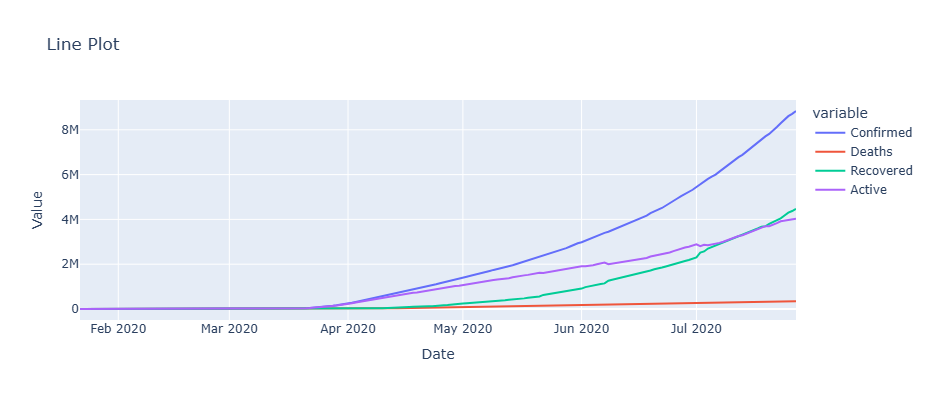

In [78]:
fig = px.line(
    americas_data, 
    x=americas_data.index, 
    y=americas_data.columns.tolist(), 
    # color='Anomaly', 
    title="Line Plot ",
    labels={'Value': 'Observed Value', 'Date': 'Date'}
)
fig.update_layout(
    # legend_title="Anomaly Status",
    xaxis_title="Date",
    yaxis_title="Value",
    width=800,  
    height=400  
)

# Show the plot
fig.show()

In [79]:
# Country wise data
country_datasets = {}
for country, group in data.groupby('Country/Region'):
    country_datasets[country] = group
len(country_datasets.keys())

187

In [82]:
get_dict_shape(country_datasets)

Level 0: 187 keys
  - Afghanistan: DataFrame
  - Albania: DataFrame
  - Algeria: DataFrame
  - Andorra: DataFrame
  - Angola: DataFrame
  - Antigua and Barbuda: DataFrame
  - Argentina: DataFrame
  - Armenia: DataFrame
  - Australia: DataFrame
  - Austria: DataFrame
  - Azerbaijan: DataFrame
  - Bahamas: DataFrame
  - Bahrain: DataFrame
  - Bangladesh: DataFrame
  - Barbados: DataFrame
  - Belarus: DataFrame
  - Belgium: DataFrame
  - Belize: DataFrame
  - Benin: DataFrame
  - Bhutan: DataFrame
  - Bolivia: DataFrame
  - Bosnia and Herzegovina: DataFrame
  - Botswana: DataFrame
  - Brazil: DataFrame
  - Brunei: DataFrame
  - Bulgaria: DataFrame
  - Burkina Faso: DataFrame
  - Burma: DataFrame
  - Burundi: DataFrame
  - Cabo Verde: DataFrame
  - Cambodia: DataFrame
  - Cameroon: DataFrame
  - Canada: DataFrame
  - Central African Republic: DataFrame
  - Chad: DataFrame
  - Chile: DataFrame
  - China: DataFrame
  - Colombia: DataFrame
  - Comoros: DataFrame
  - Congo (Brazzaville): DataF

In [84]:
country_datasets.keys()

dict_keys(['Afghanistan', 'Albania', 'Algeria', 'Andorra', 'Angola', 'Antigua and Barbuda', 'Argentina', 'Armenia', 'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin', 'Bhutan', 'Bolivia', 'Bosnia and Herzegovina', 'Botswana', 'Brazil', 'Brunei', 'Bulgaria', 'Burkina Faso', 'Burma', 'Burundi', 'Cabo Verde', 'Cambodia', 'Cameroon', 'Canada', 'Central African Republic', 'Chad', 'Chile', 'China', 'Colombia', 'Comoros', 'Congo (Brazzaville)', 'Congo (Kinshasa)', 'Costa Rica', "Cote d'Ivoire", 'Croatia', 'Cuba', 'Cyprus', 'Czechia', 'Denmark', 'Djibouti', 'Dominica', 'Dominican Republic', 'Ecuador', 'Egypt', 'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia', 'Eswatini', 'Ethiopia', 'Fiji', 'Finland', 'France', 'Gabon', 'Gambia', 'Georgia', 'Germany', 'Ghana', 'Greece', 'Greenland', 'Grenada', 'Guatemala', 'Guinea', 'Guinea-Bissau', 'Guyana', 'Haiti', 'Holy See', 'Honduras', 'Hungary', 'Iceland', 'India', 'Indo

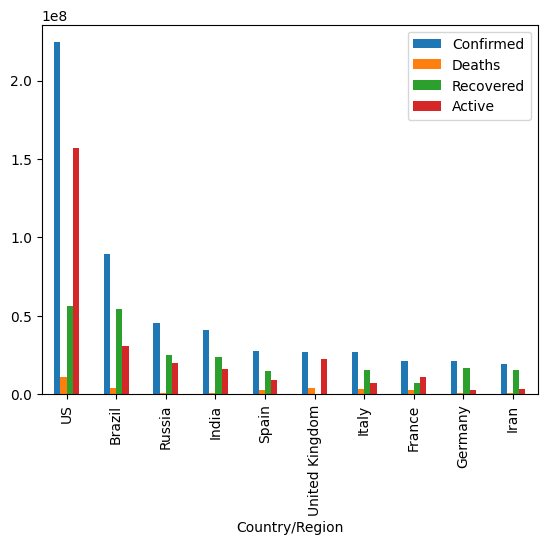

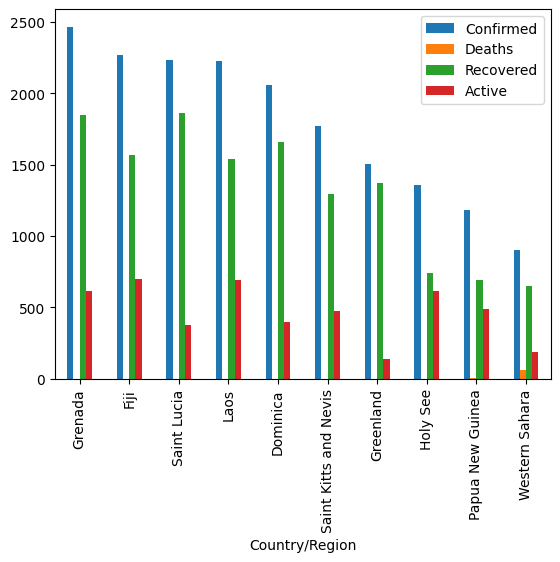

In [86]:
# Group data by 'Country/Region'
country_wise_data_sum = data.groupby('Country/Region').agg({
    'Confirmed': 'sum',
    'Deaths': 'sum',
    'Recovered': 'sum',
    'Active': 'sum'
}).reset_index().set_index('Country/Region')
country_wise_data_sum.sort_values(country_wise_data_sum.columns.tolist(),ascending = False,inplace= True)

# Display the country-wise data
country_wise_data_sum.head(10).plot(kind = 'bar')
plt.show()
country_wise_data_sum.tail(10).plot(kind = 'bar')
plt.show()

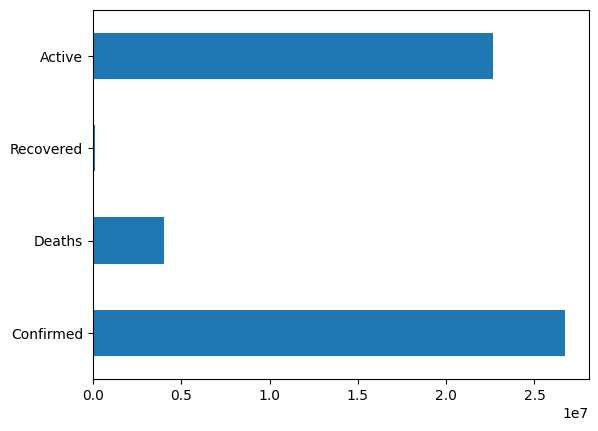

In [87]:
# United Kingdom has very high deaths compared to recovered. The data need to be analysed with other data for examining this case
country_wise_data_sum.loc['United Kingdom'].plot(kind = 'barh')
plt.show()

In [89]:
# Lets choose Brazil, India and Spain for modeling
brazil_data = country_datasets['Brazil']
india_data = country_datasets['India']
spain_data = country_datasets['Spain']

In [90]:
def preprocess(df: pd.DataFrame)-> pd.DataFrame:
    data = df.copy()
    display(data.head(2))
    data['Date'] = pd.to_datetime(data['Date'])
    data.set_index('Date',inplace = True,drop = True)
    data = data.resample('D').sum()
    data.drop(['Lat','Long'],inplace = True,axis = 1)
    print(data.isnull().sum())
    display(data.head(2))
    return data

brazil_data = preprocess(brazil_data)
india_data = preprocess(india_data)
spain_data = preprocess(spain_data)



,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
28,Brazil,-14.23,-51.93,2020-01-22,0,0,0,0,Americas
289,Brazil,-14.23,-51.93,2020-01-23,0,0,0,0,Americas


Confirmed    0
Deaths       0
Recovered    0
Active       0
dtype: int64


,Confirmed,Deaths,Recovered,Active
Date,,,,
2020-01-22,0,0,0,0
2020-01-23,0,0,0,0


,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
129,India,20.59,78.96,2020-01-22,0,0,0,0,South-East Asia
390,India,20.59,78.96,2020-01-23,0,0,0,0,South-East Asia


Confirmed    0
Deaths       0
Recovered    0
Active       0
dtype: int64


,Confirmed,Deaths,Recovered,Active
Date,,,,
2020-01-22,0,0,0,0
2020-01-23,0,0,0,0


,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
199,Spain,40.46,-3.75,2020-01-22,0,0,0,0,Europe
460,Spain,40.46,-3.75,2020-01-23,0,0,0,0,Europe


Confirmed    0
Deaths       0
Recovered    0
Active       0
dtype: int64


,Confirmed,Deaths,Recovered,Active
Date,,,,
2020-01-22,0,0,0,0
2020-01-23,0,0,0,0


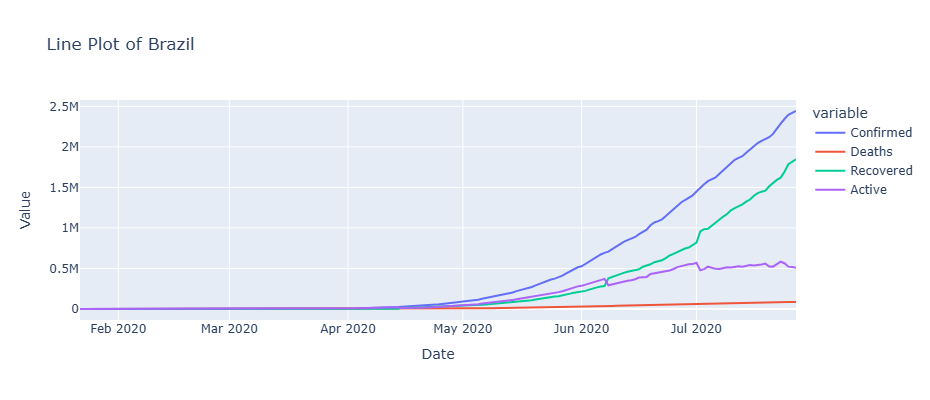

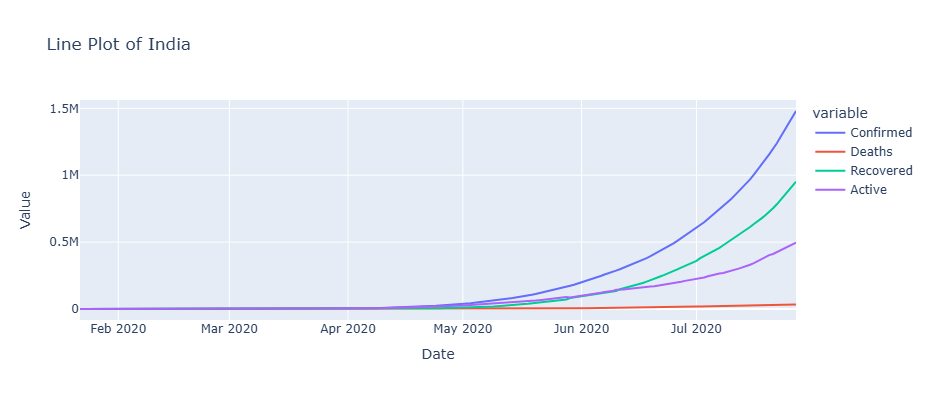

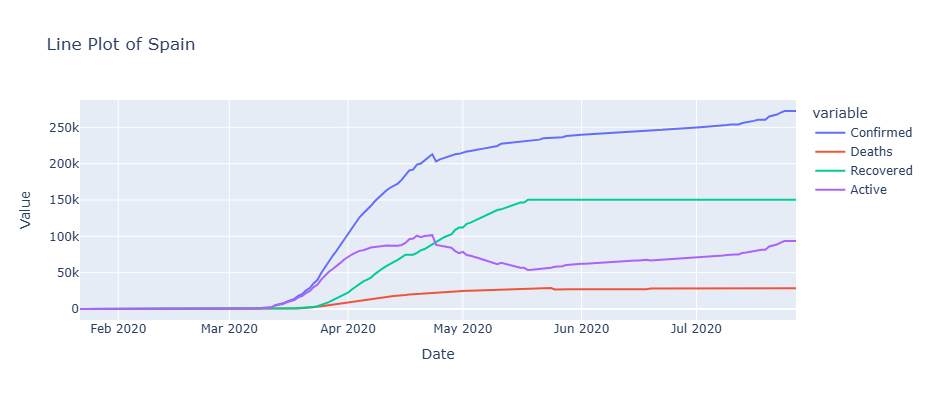

In [93]:
def plot_line(df: pd.DataFrame,name=''):
    fig = px.line(
        df, 
        x=df.index, 
        y=df.columns.tolist(),  
        title=f"Line Plot of {name}",
        labels={'Value': 'Observed Value', 'Date': 'Date'}
    )
    fig.update_layout(
        xaxis_title="Date",
        yaxis_title="Value",
        width=800,  
        height=400  
    )

    fig.show()

plot_line(brazil_data,'Brazil')
plot_line(india_data,'India')
plot_line(spain_data,'Spain')

In [94]:
data_dict = {'global':global_data,
             'americas':americas_data,
             'Brazil': brazil_data,
             'India':india_data,
             'Spain':spain_data
            }

##### Outlier detection and removal

In [102]:
from sklearn.ensemble import IsolationForest
def if_outlier(df:pd.DataFrame):
    data = df.copy()
    features = ['Confirmed', 'Deaths', 'Recovered', 'Active']
    iso_forest = IsolationForest(contamination=0.05)
    data['anomaly'] = iso_forest.fit_predict(data[features])
    
    outliers = data[data['anomaly'] == -1]
    print('Number of outliers using Isolation Forest: ',outliers.shape[0],sep='\n')
    return data

In [103]:
def plot_line_outlier(data: pd.DataFrame,name=''):
    fig = px.line(
        data, 
        x=data.index, 
        y=['Confirmed', 'Deaths', 'Recovered', 'Active'], 
        color='anomaly', 
        title=f"Line Plot with Anomaly of {name}",
        labels={'Value': 'Observed Value', 'Date': 'Date'}
    )
    
    fig.update_layout(
        legend_title="Anomaly Status",
        xaxis_title="Date",
        yaxis_title="Value",
        width=800,  
        height=400  
    )
    fig.show()

In [105]:
def plot_heatmap(df:pd.DataFrame, anomaly = False):
    if anomaly:
        have = 'with'
    else:
        have = 'without'
    
    fig = go.Figure(
        data=go.Heatmap(
            z=df.values,          
            x=df.columns,        
            y=df.index,           
            colorscale='Viridis',        
            colorbar_title="Correlation",
            text=df.round(2).values,  # Text annotations (rounded values)
            hoverinfo="z"
        )
    )
    fig.update_traces(
        texttemplate="%{text}",  # Format to display the text annotations
        textfont={"size": 12}  # Adjust annotation font size
    )
    fig.update_layout(
        title=f"Heatmap of Correlation {have} anomaly",
        xaxis_title="Parmeters",
        yaxis_title="Parameters",
        width=800,                    
        height=800                     
    )
    fig.show()

Number of outliers using Isolation Forest: 
10


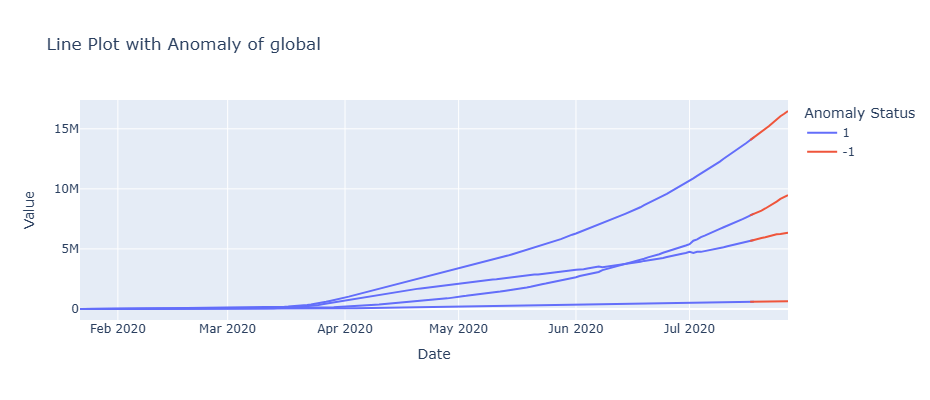

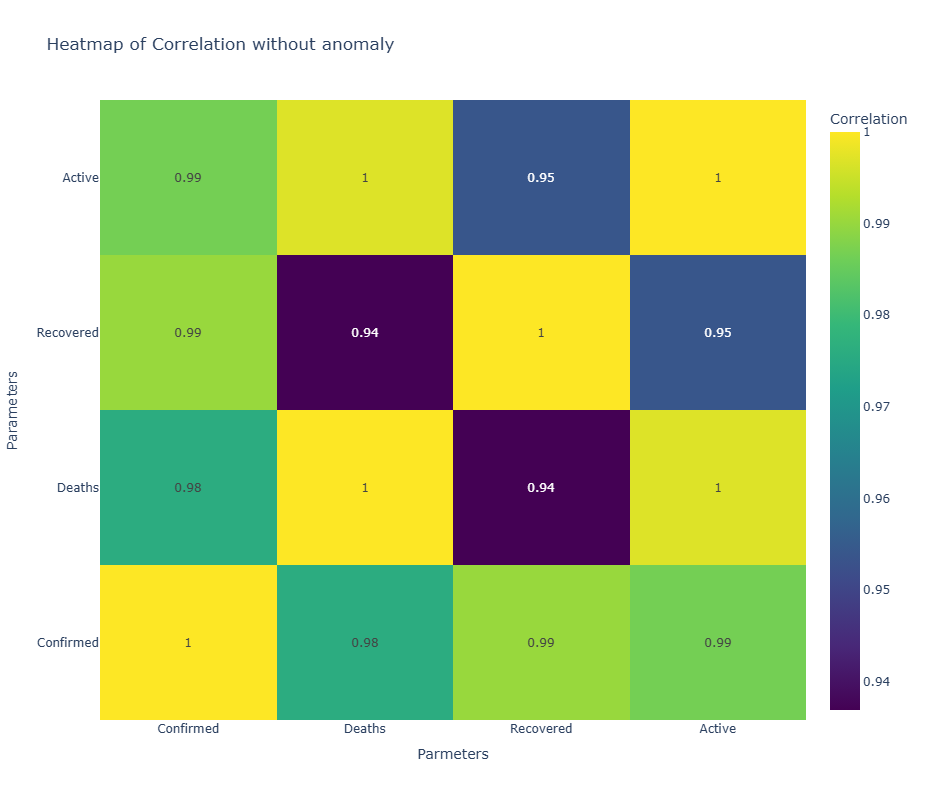

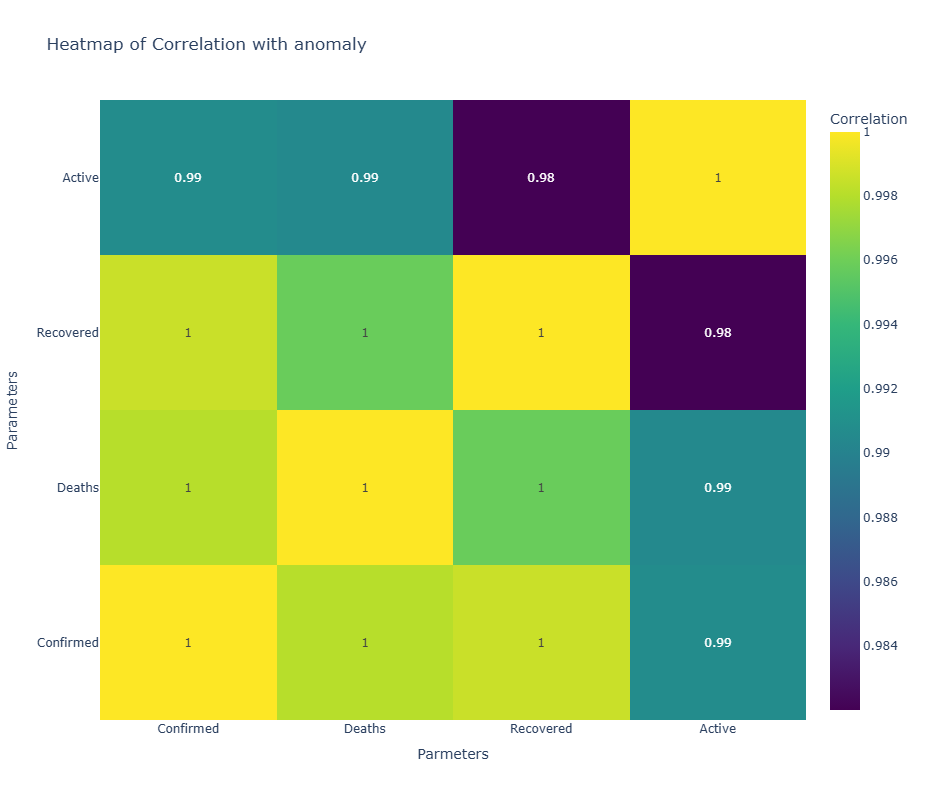

Number of outliers using Isolation Forest: 
10


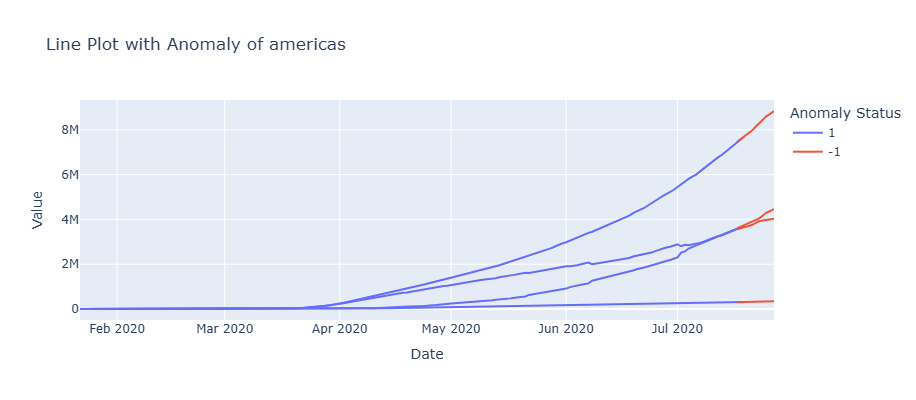

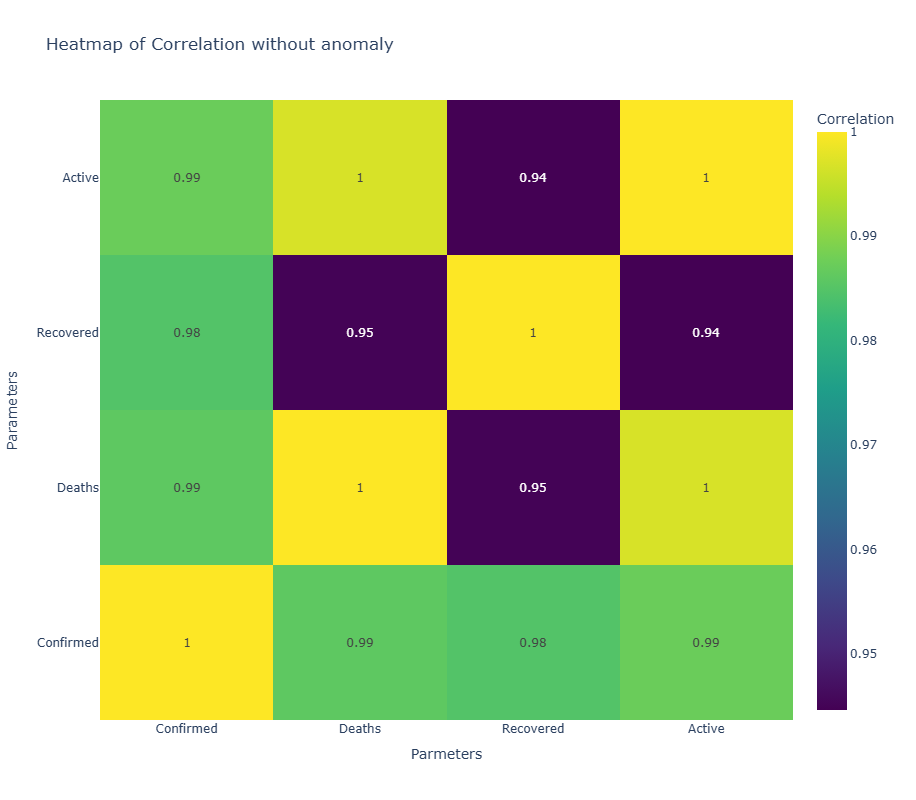

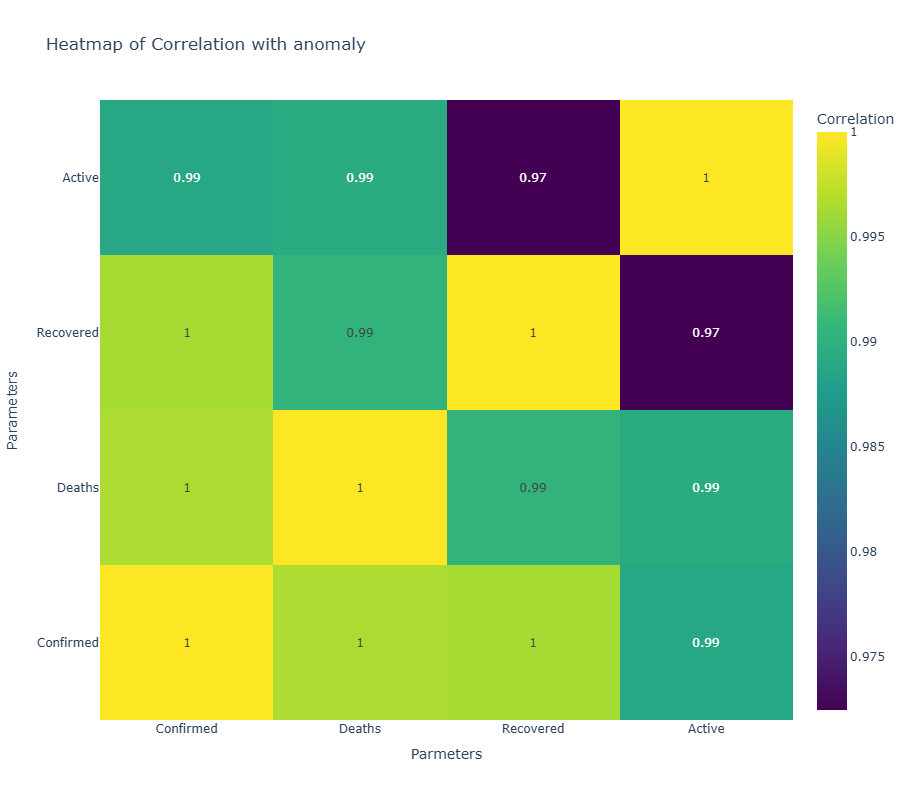

Number of outliers using Isolation Forest: 
10


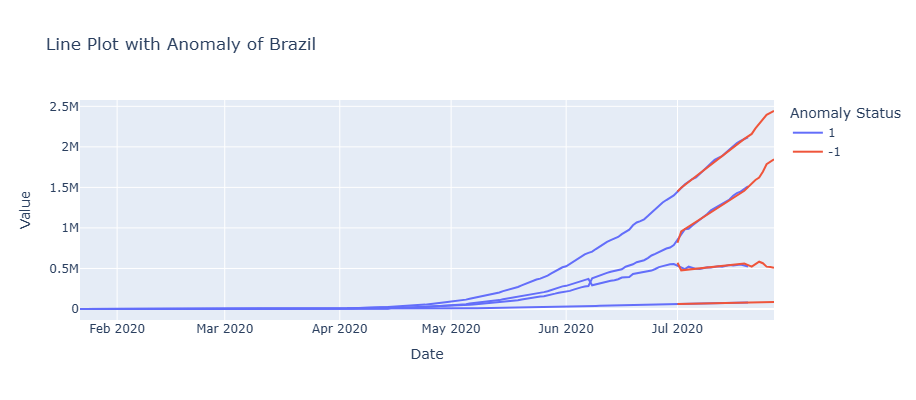

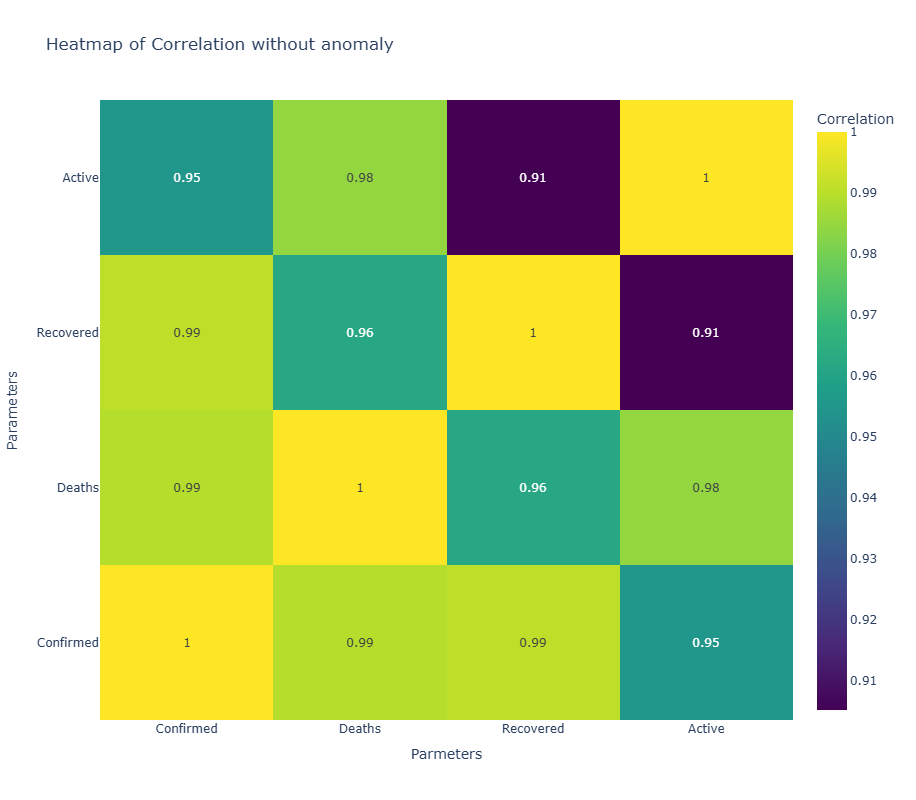

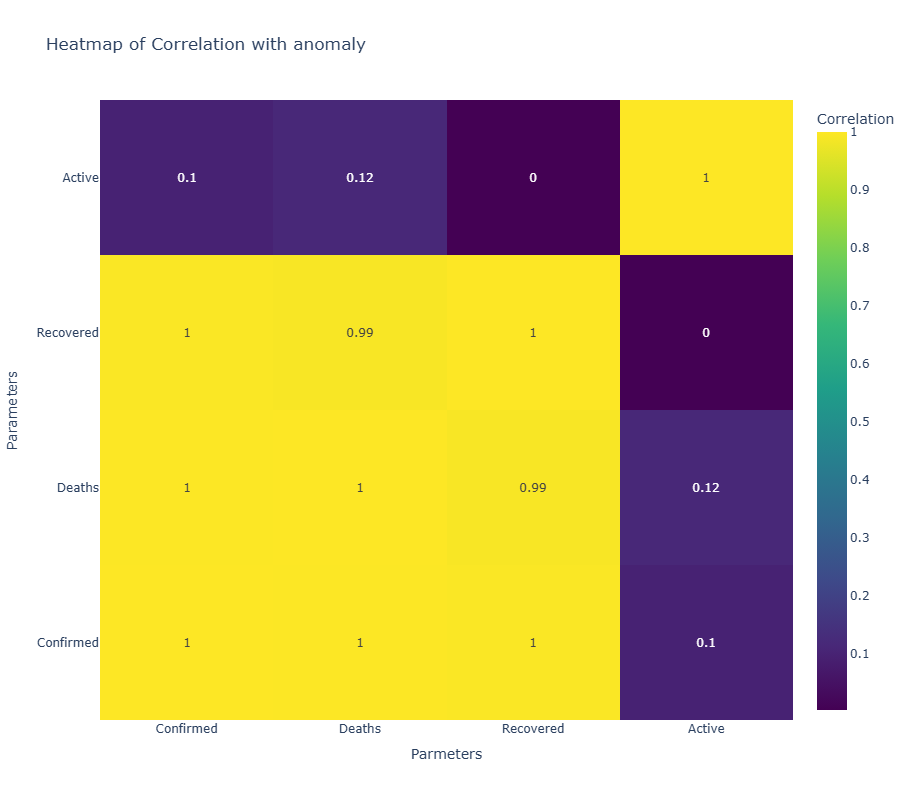

Number of outliers using Isolation Forest: 
10


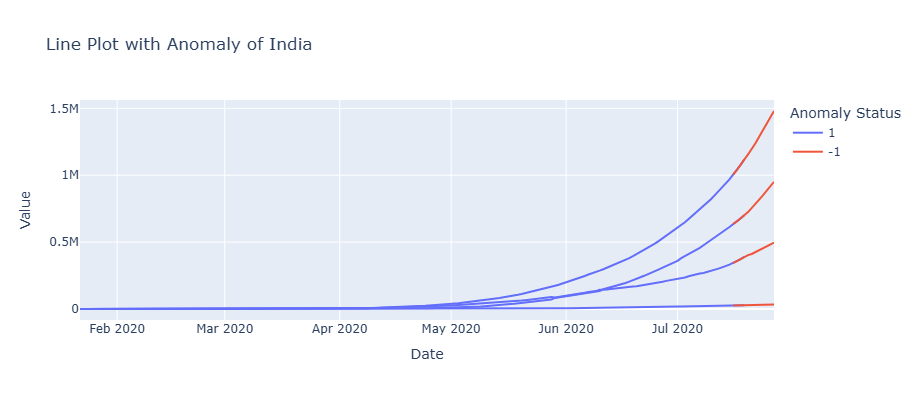

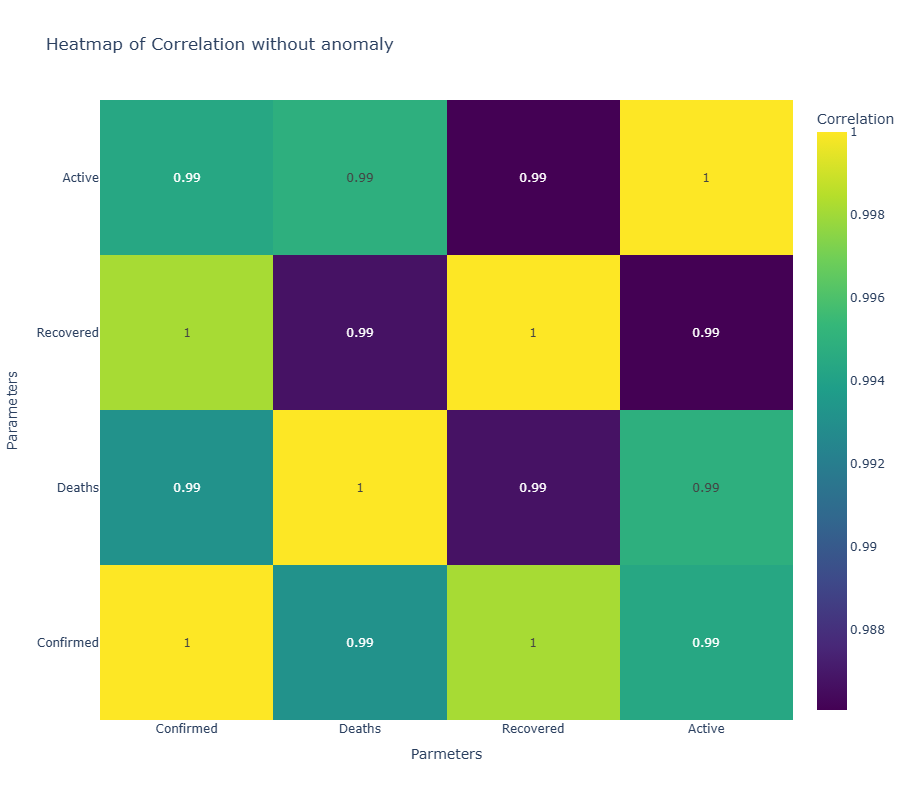

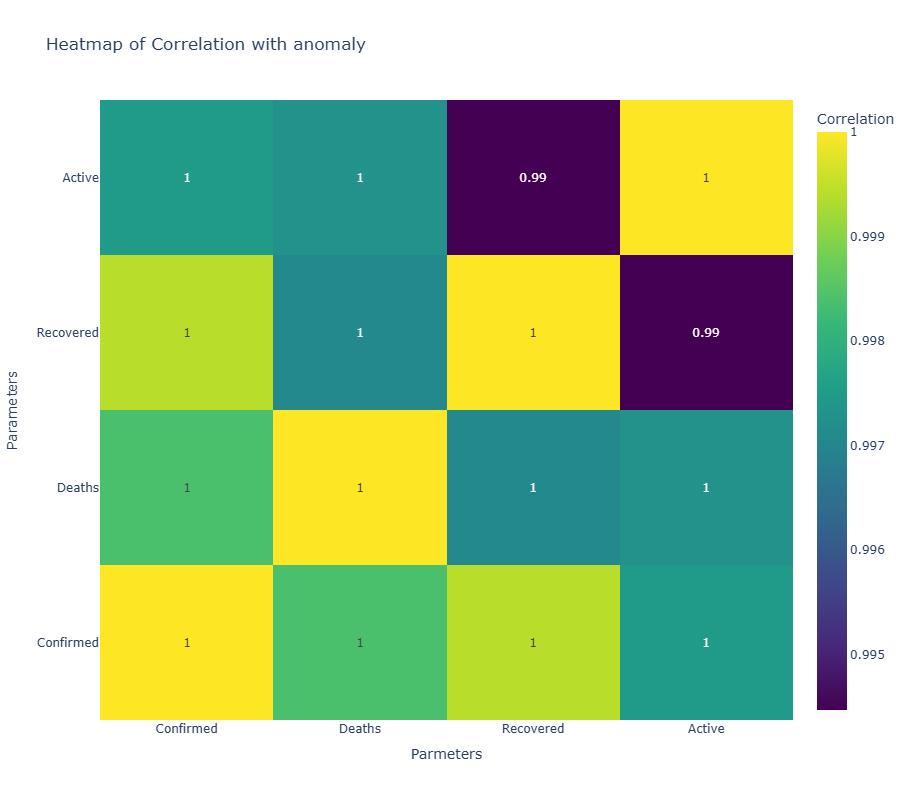

Number of outliers using Isolation Forest: 
10


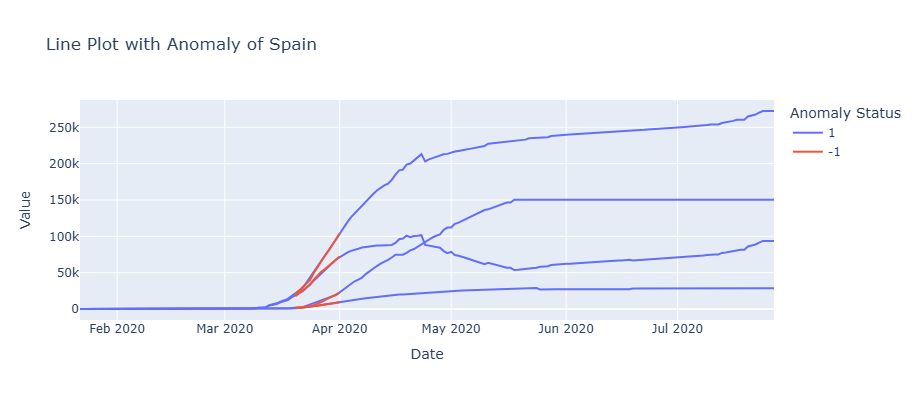

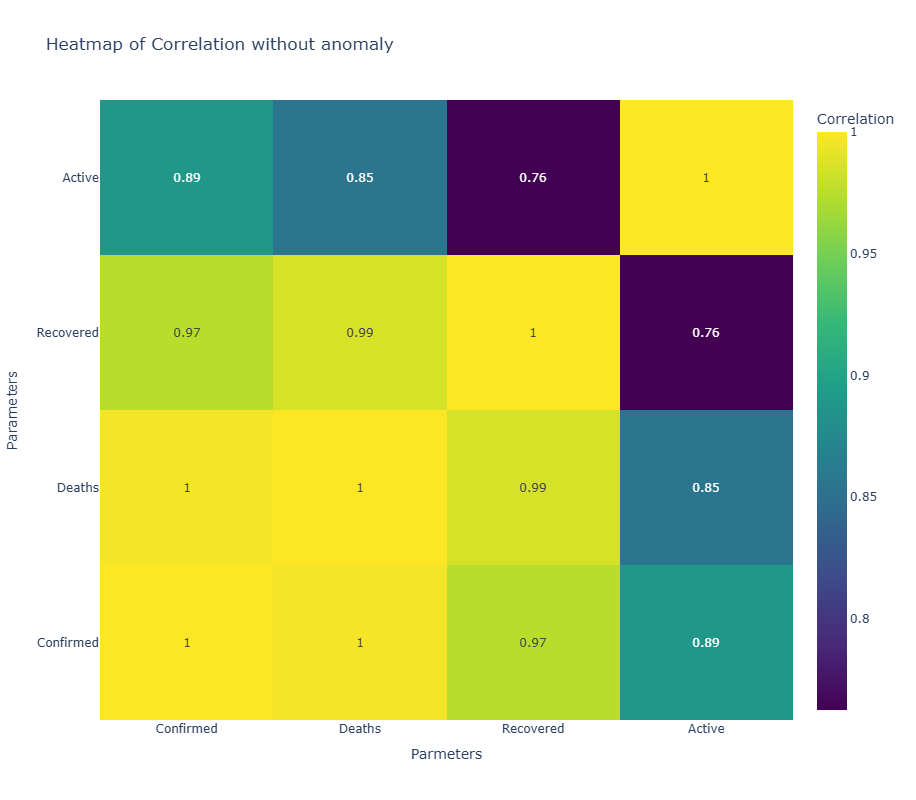

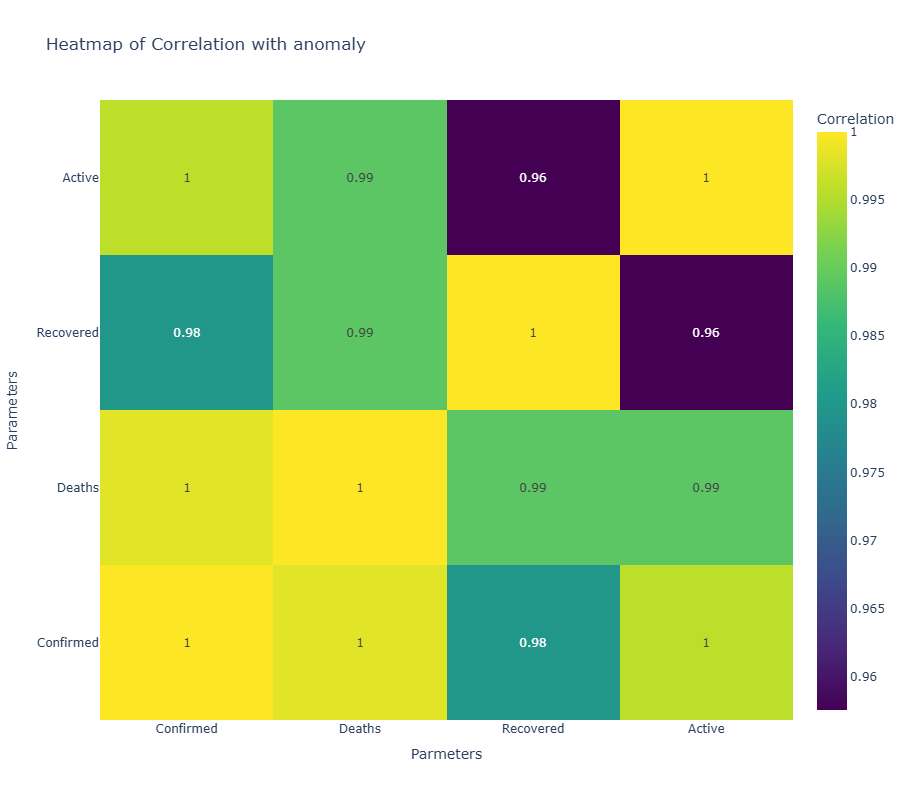

In [108]:
for key, data in data_dict.items():
    with_outlier = if_outlier(data)
    plot_line_outlier(with_outlier,key)
    plot_heatmap(data.corr(numeric_only =True))
    plot_heatmap(with_outlier[with_outlier['anomaly']== -1][['Confirmed', 'Deaths', 'Recovered', 'Active']].corr(numeric_only = True),anomaly = True)

In [109]:
# No outlier removal is required

##### Statistical Understanding of data

In [111]:
data_dict.keys()

dict_keys(['global', 'americas', 'Brazil', 'India', 'Spain'])

In [112]:
import plotly.subplots as sp
def plot_dist(data:pd.DataFrame):
    
    fig = sp.make_subplots(rows=2, cols=2, subplot_titles=('Confirmed', 'Deaths', 'Recovered', 'Active'))
    
    # Add histograms for each column
    fig.add_trace(go.Histogram(x=data['Confirmed'], name='Confirmed'), row=1, col=1)
    fig.add_trace(go.Histogram(x=data['Deaths'], name='Deaths'), row=1, col=2)
    fig.add_trace(go.Histogram(x=data['Recovered'], name='Recovered'), row=2, col=1)
    fig.add_trace(go.Histogram(x=data['Active'], name='Active'), row=2, col=2)
    
    fig.update_layout(
        title="Histograms of Confirmed, Deaths, Recovered, and Active Cases",
        showlegend=False,
        height=600, 
        width=800   
    )
    fig.show()

==================== global ====================


,count,mean,std,min,25%,50%,75%,max
Confirmed,188.00,4406960.01,4757988.32,555.00,112191.00,2848733.00,7422045.50,16480485.00
Deaths,188.00,230770.76,217929.09,17.00,3935.00,204190.00,418634.50,654036.00
Recovered,188.00,2066001.22,2627976.40,28.00,60441.25,784784.00,3416395.75,9468087.00
Active,188.00,2110188.03,1969670.45,510.00,58641.75,1859759.00,3587015.25,6358362.00


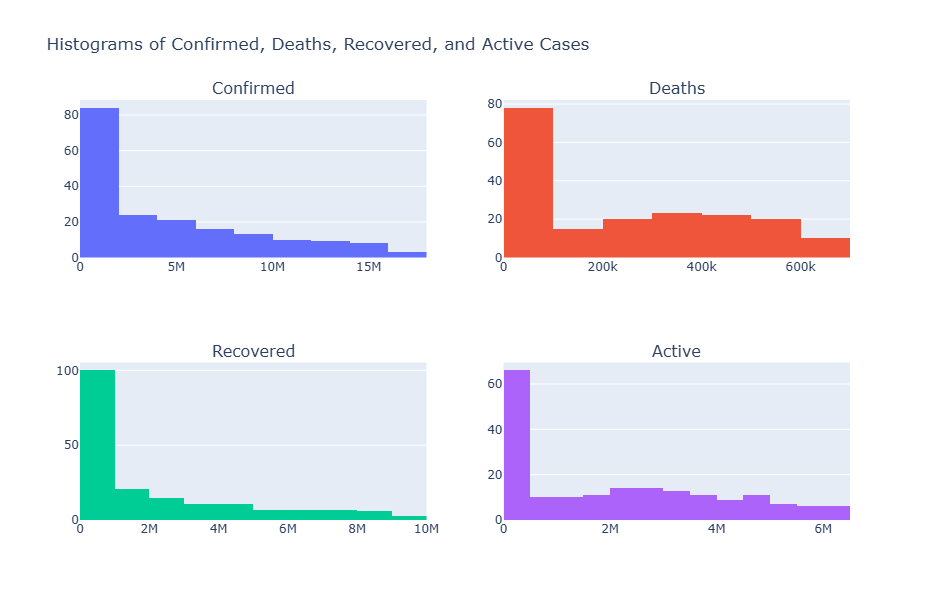

==================== americas ====================


,count,mean,std,min,25%,50%,75%,max
Confirmed,188.00,2139687.20,2524740.89,1.00,675.00,1126233.00,3612036.00,8839286.00
Deaths,188.00,102974.96,110745.04,0.00,23.50,63841.00,194249.25,342732.00
Recovered,188.00,835475.77,1219464.05,0.00,8.00,153406.50,1352441.75,4468616.00
Active,188.00,1201236.48,1230285.38,1.00,643.50,908985.50,2075887.75,4027938.00


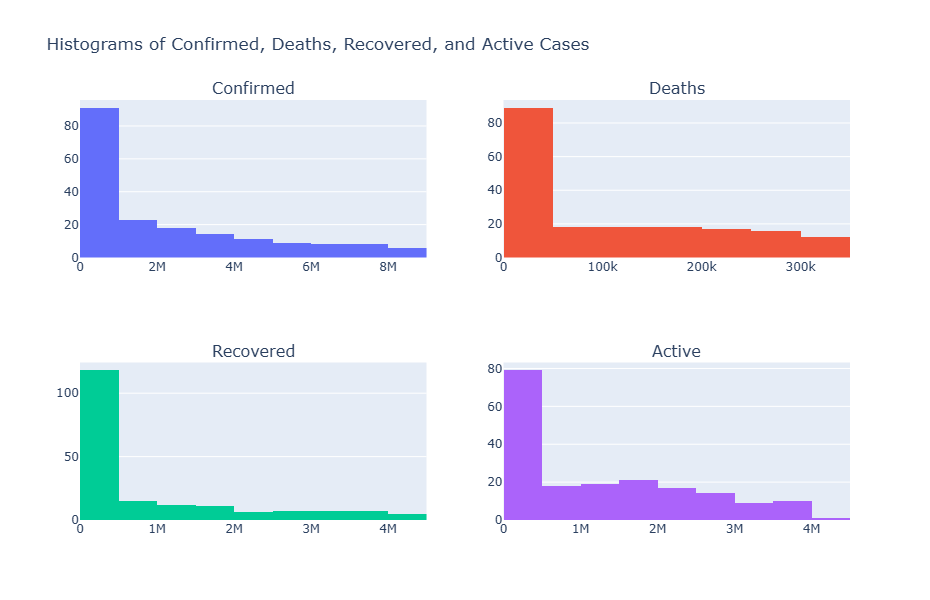

==================== Brazil ====================


,count,mean,std,min,25%,50%,75%,max
Confirmed,188.00,476196.63,702067.52,0.00,23.75,56683.50,780019.00,2442375.00
Deaths,188.00,20946.99,27573.80,0.00,0.00,3880.50,39989.75,87618.00
Recovered,188.00,289855.71,480255.22,0.00,0.00,28407.50,417928.25,1846641.00
Active,188.00,165393.94,208456.48,0.00,23.75,24395.50,344943.25,583080.00


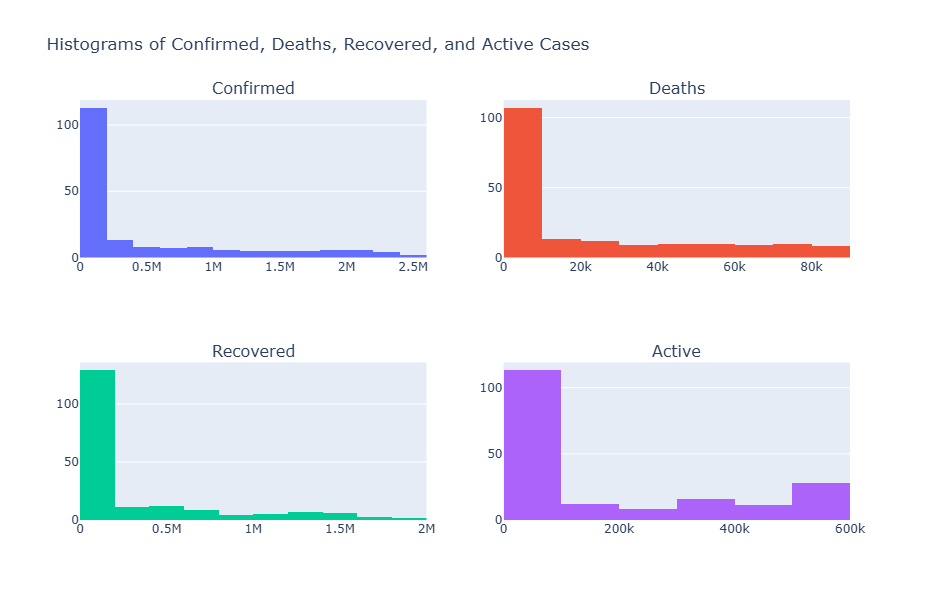

==================== India ====================


,count,mean,std,min,25%,50%,75%,max
Confirmed,188.00,217465.23,354477.95,0.00,42.00,25406.50,289337.50,1480073.00
Deaths,188.00,5913.99,9000.14,0.00,0.00,802.50,8201.00,33408.00
Recovered,188.00,126509.15,223808.89,0.00,3.00,5718.50,138203.25,951166.00
Active,188.00,85042.09,122839.59,0.00,39.00,18885.50,142205.75,495499.00


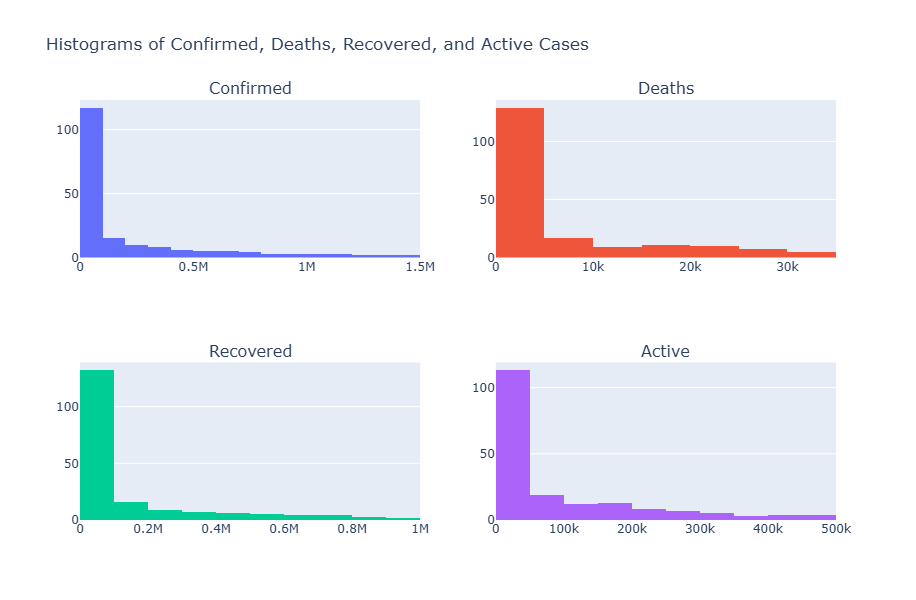

==================== Spain ====================


,count,mean,std,min,25%,50%,75%,max
Confirmed,188.00,145766.20,109213.94,0.00,973.00,208011.50,242386.75,272421.00
Deaths,188.00,16133.14,12486.39,0.00,25.25,22713.00,27563.00,28752.00
Recovered,188.00,80285.02,67628.67,0.00,31.50,94031.50,150376.00,150376.00
Active,188.00,49348.04,34749.96,0.00,916.25,63305.50,75012.75,101617.00


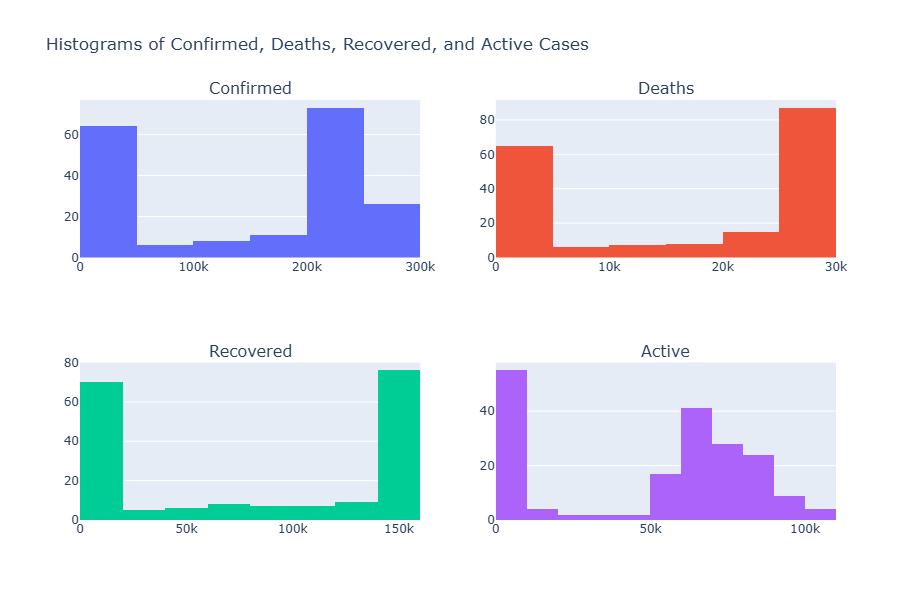

In [113]:
for k, data in data_dict.items():
    print('='*20,k,'='*20)
    display(data.describe(exclude='object').round(3).T)
    plot_dist(data)
    

##### Staionarity test

In [115]:
from statsmodels.tsa.stattools import adfuller
def test_stationarity(timeseries):
    result = adfuller(timeseries)
    print('ADF Statistic:', result[0])
    print('p-value:', result[1])
    print('Critical Values:', result[4])

In [116]:
for k, data in data_dict.items():
    print('='*20,k,'='*20)
    for col in data.columns:
        test_stationarity(data[col])

==================== global ====================
ADF Statistic: 2.056470238587927
p-value: 0.998741982914414
Critical Values: {'1%': -3.4680615871598537, '5%': -2.8781061899535128, '10%': -2.5756015922004134}
ADF Statistic: 1.2120824767055731
p-value: 0.996068307711327
Critical Values: {'1%': -3.4687256239864017, '5%': -2.8783961376954363, '10%': -2.57575634100705}
ADF Statistic: 2.7824562975097313
p-value: 1.0
Critical Values: {'1%': -3.4672111510631, '5%': -2.877734766803841, '10%': -2.575403364197531}
ADF Statistic: 1.6723459556449087
p-value: 0.9980591751830228
Critical Values: {'1%': -3.4668001583460613, '5%': -2.8775552336674317, '10%': -2.5753075498128246}
==================== americas ====================
ADF Statistic: 1.1943983723097724
p-value: 0.9959469518089001
Critical Values: {'1%': -3.4687256239864017, '5%': -2.8783961376954363, '10%': -2.57575634100705}
ADF Statistic: 1.0774501872165105
p-value: 0.9950194989739981
Critical Values: {'1%': -3.4687256239864017, '5%': -2.8

In [117]:
# Non-stationary Data: A p-value > 0.05 indicates that the time series is likely non-stationary, 
# meaning its statistical properties (mean, variance, autocorrelation) change over time.

##### Auto Correlation  and Partial Auto Correlation

In [119]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

def plot_acf_pacf(df:pd.DataFrame,col:pd.Series):
    plt.figure(figsize = (8,3))
    plt.subplot(1,2,1)
    plot_acf(df[col], lags=20, ax=plt.gca())
    plt.title(f'Autocorrelation Function of {col}')
    
    plt.subplot(1,2,2)
    plot_pacf(df[col], lags=20, ax=plt.gca())
    plt.title(f'Partial Autocorrelation Function of {col}')
    plt.tight_layout()
    plt.show()

==================== global ====================


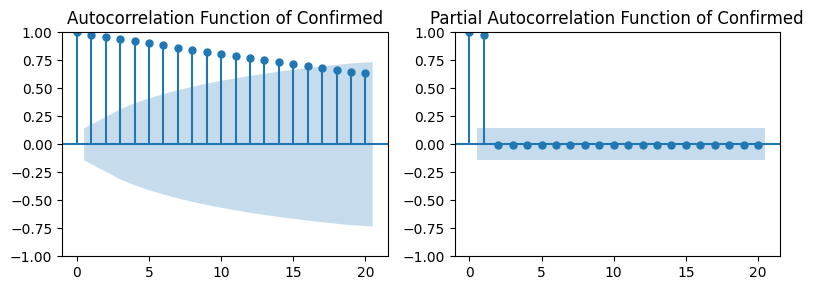

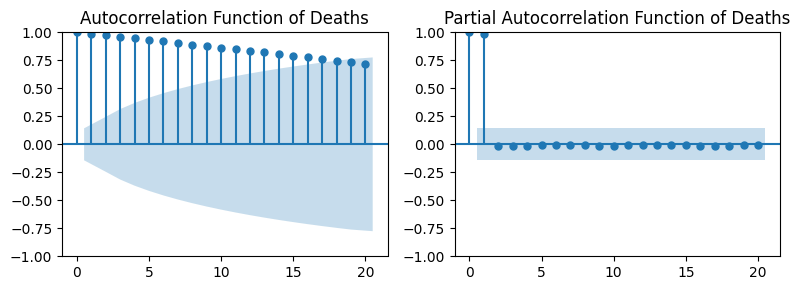

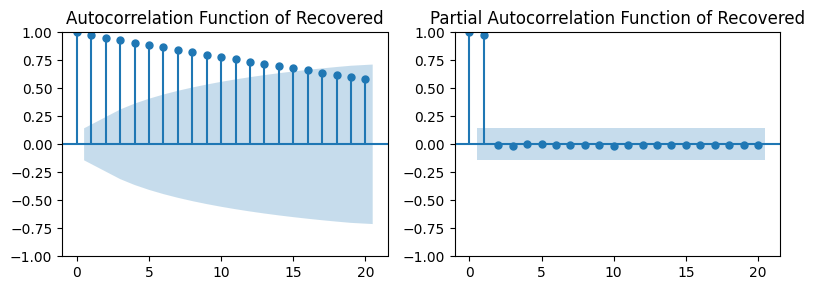

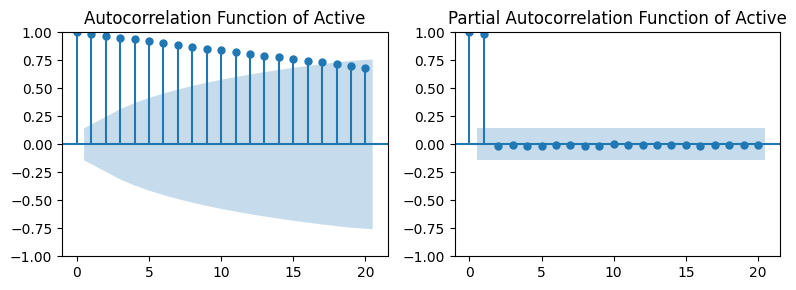

==================== americas ====================


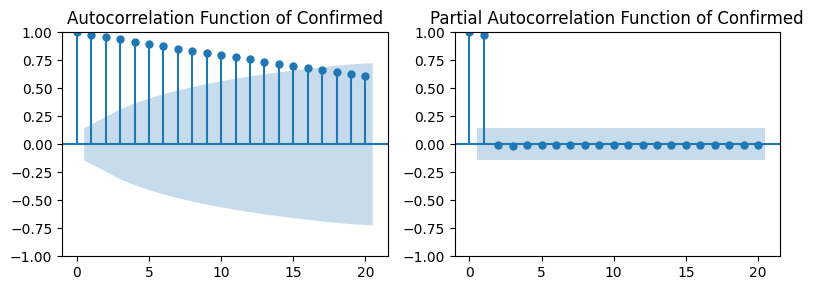

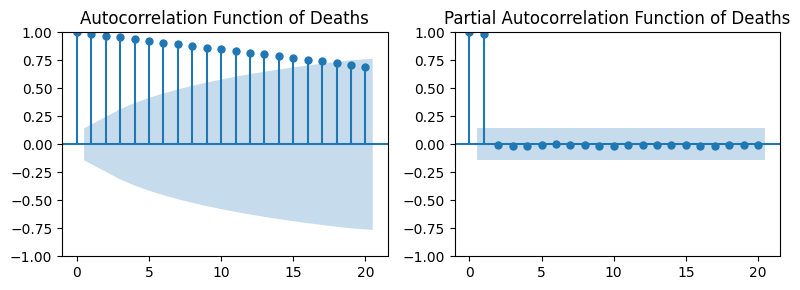

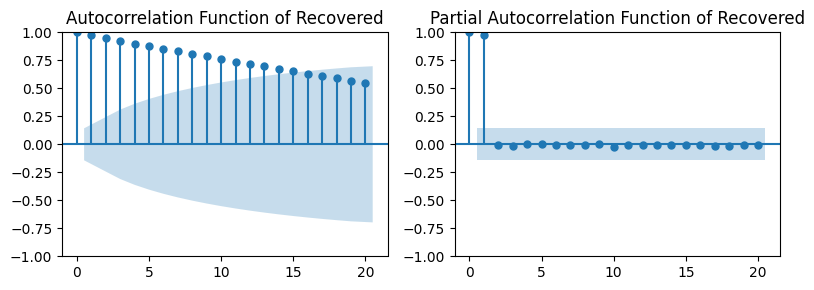

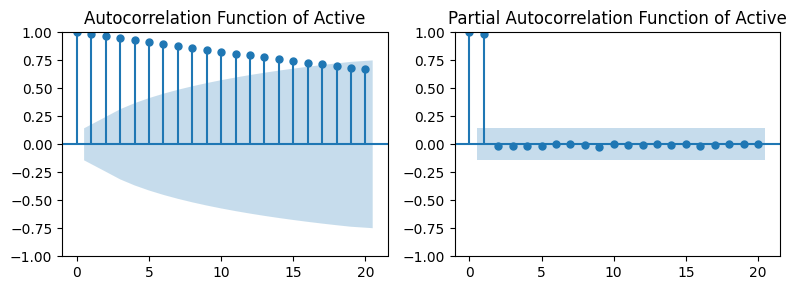

==================== Brazil ====================


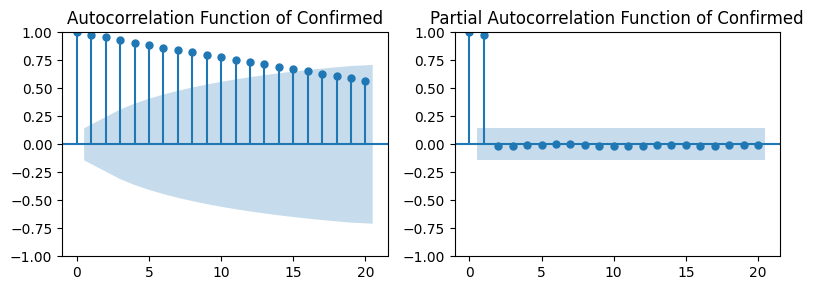

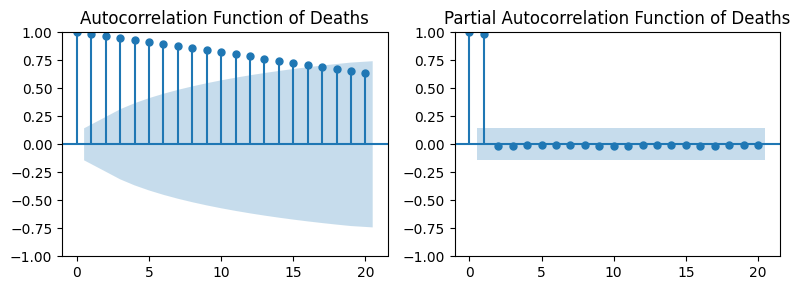

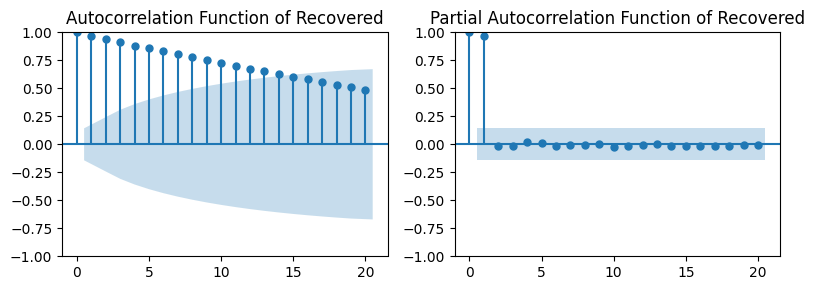

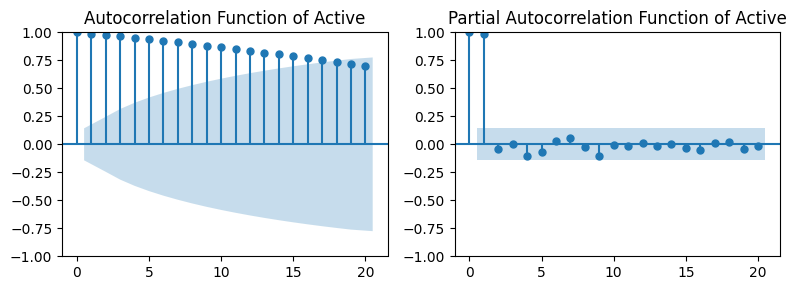

==================== India ====================


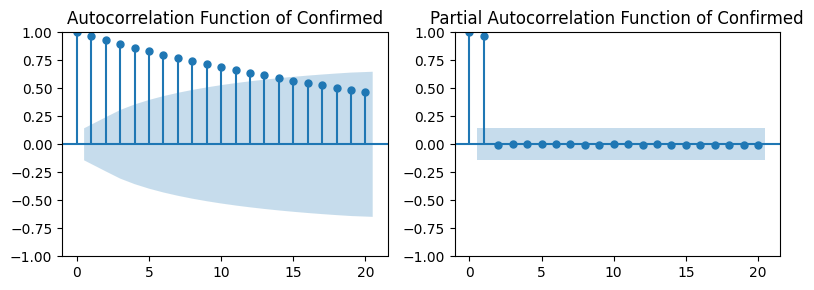

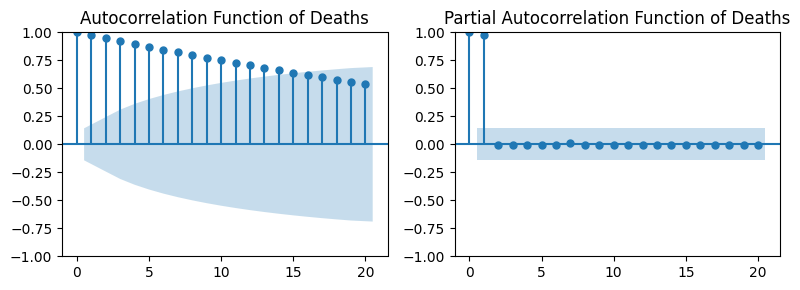

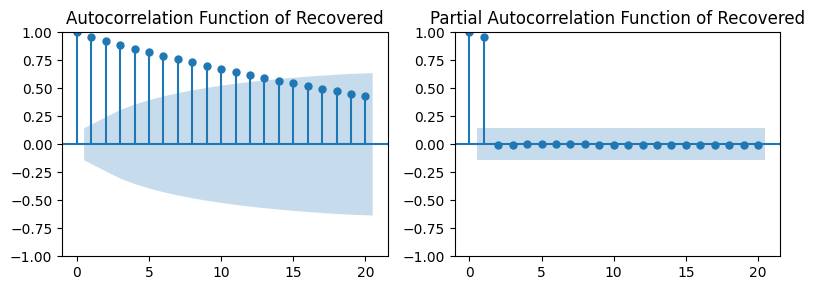

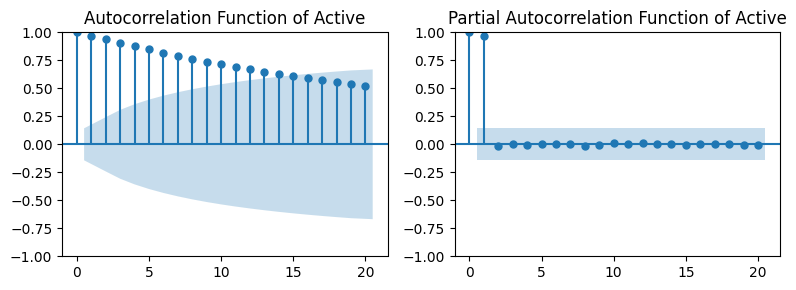

==================== Spain ====================


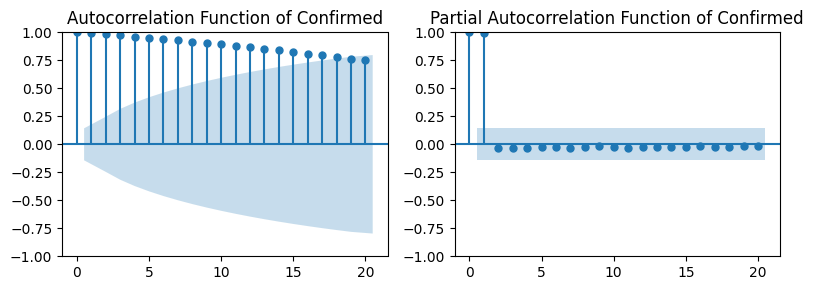

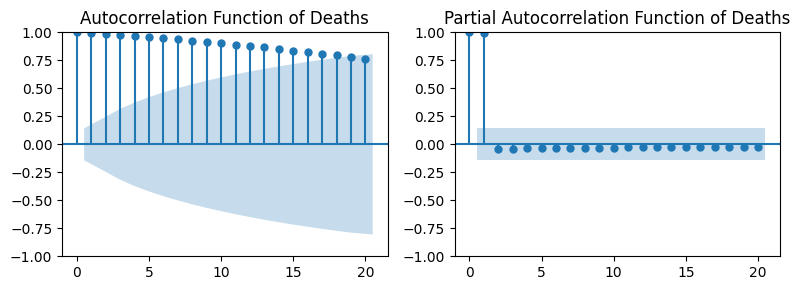

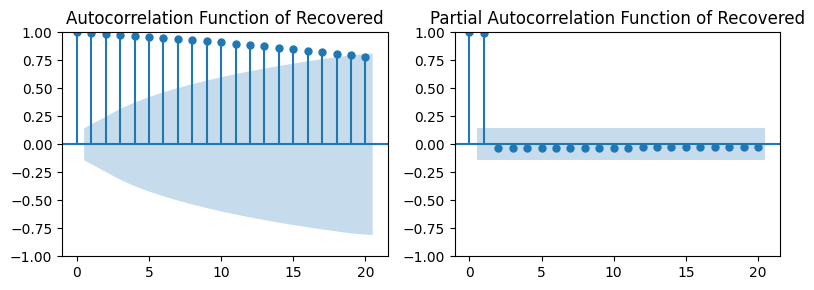

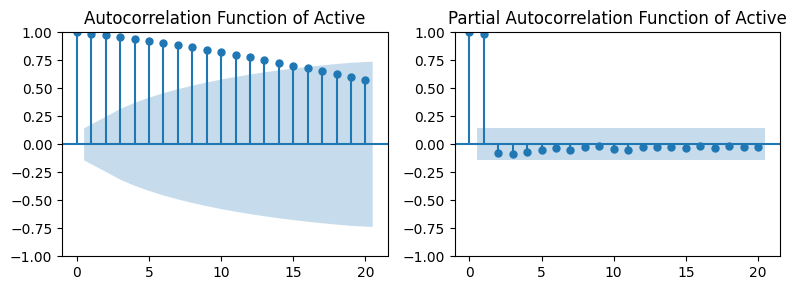

In [120]:
for k, data in data_dict.items():
    print('='*20,k,'='*20)
    for col in data.columns:
        plot_acf_pacf(data,col)

In [121]:
# Partial Autocorrelation with 1 lag for each data. Moving Average or error of lag1 can help in prediction.
# ACF decays => Autocorelation present

##### Seasonal Decomposition

==================== global ====================
-------------------- Confirmed --------------------


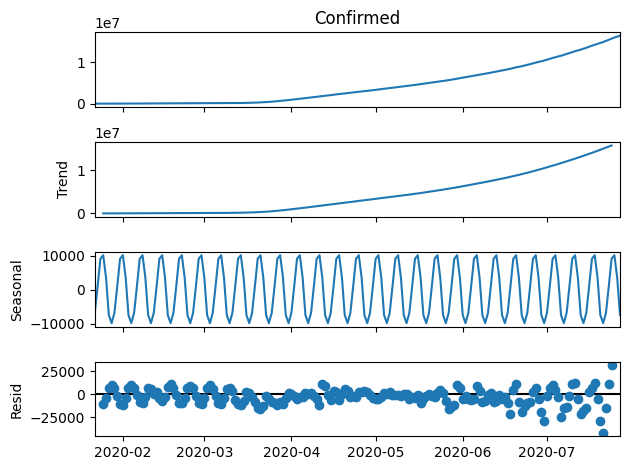

-------------------- Deaths --------------------


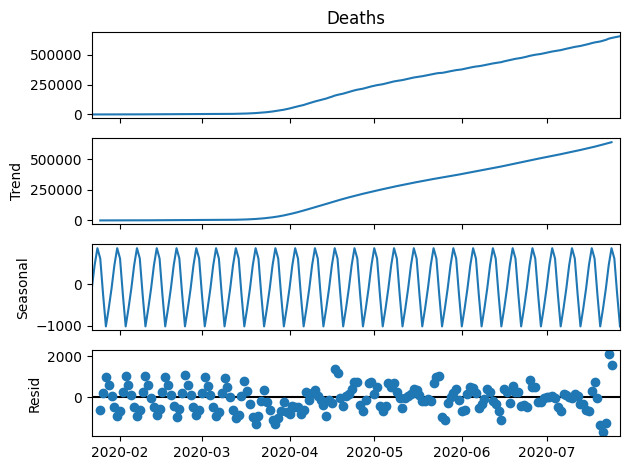

-------------------- Recovered --------------------


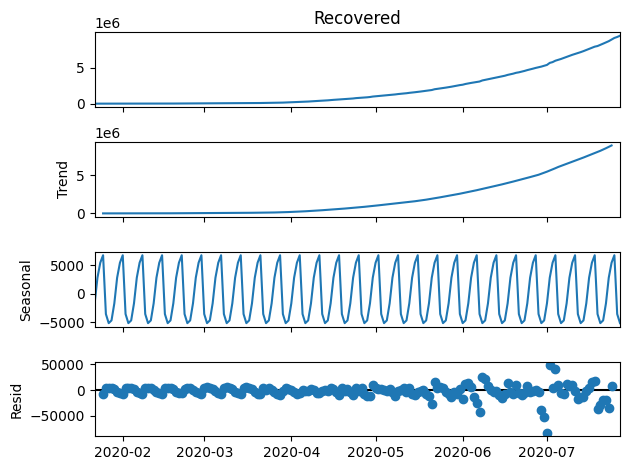

-------------------- Active --------------------


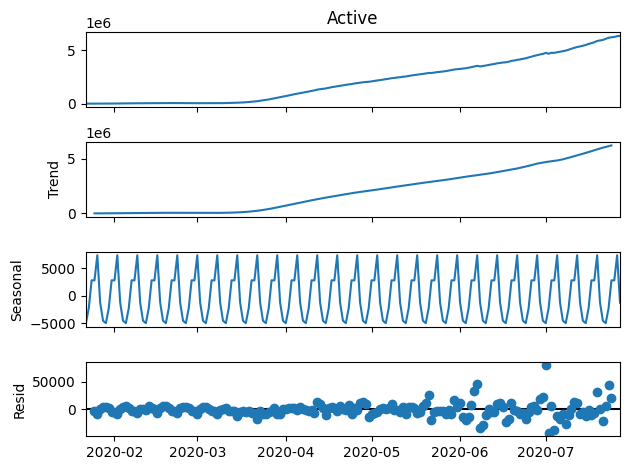

==================== americas ====================
-------------------- Confirmed --------------------


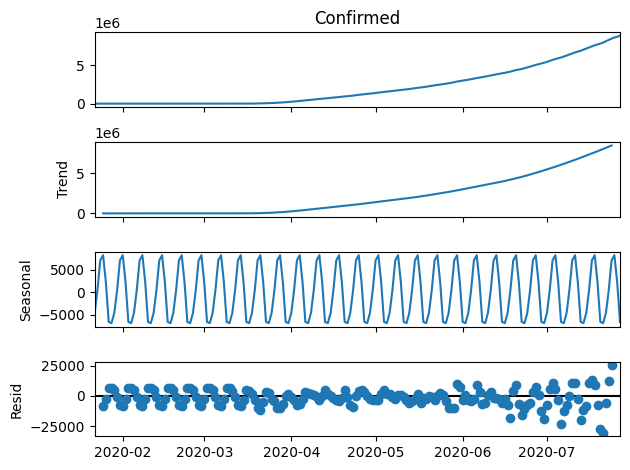

-------------------- Deaths --------------------


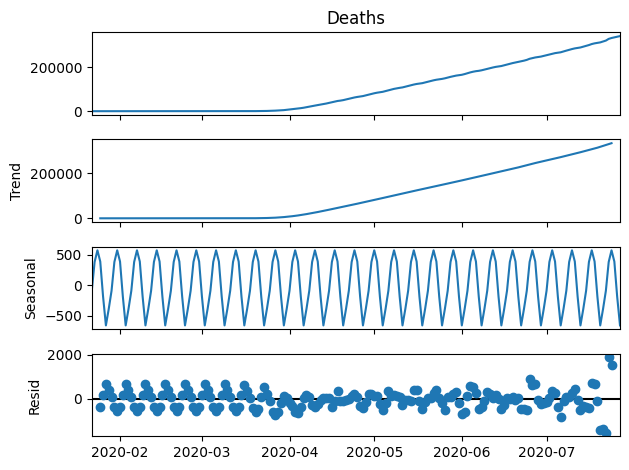

-------------------- Recovered --------------------


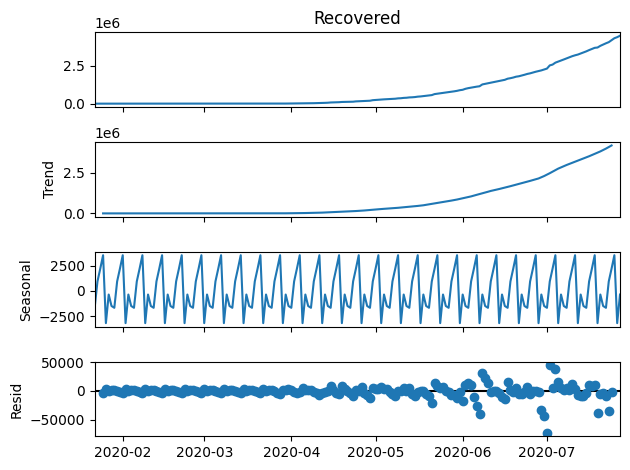

-------------------- Active --------------------


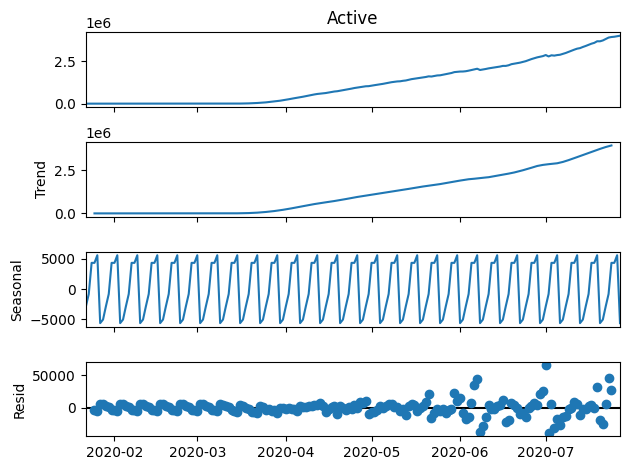

==================== Brazil ====================
-------------------- Confirmed --------------------


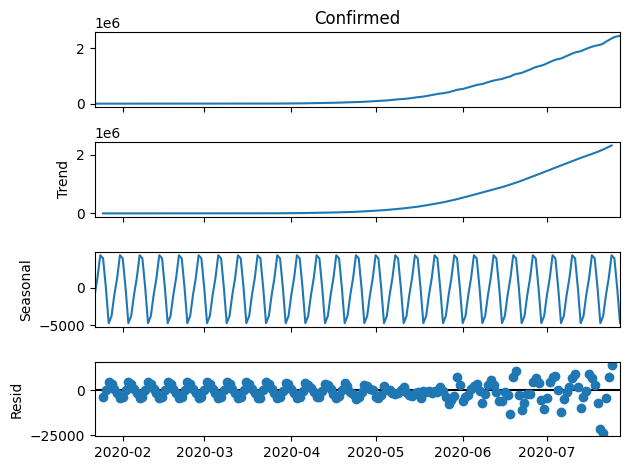

-------------------- Deaths --------------------


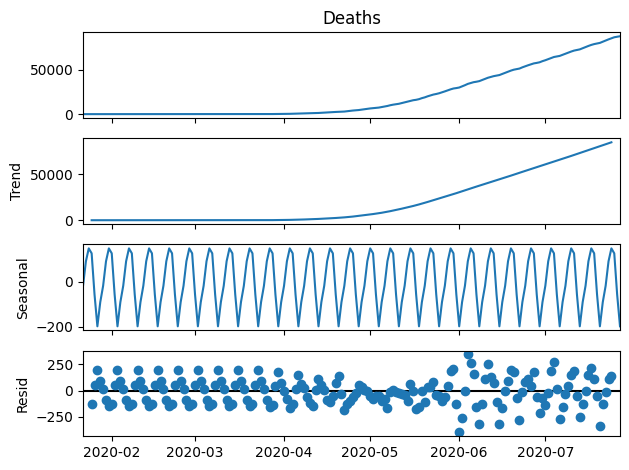

-------------------- Recovered --------------------


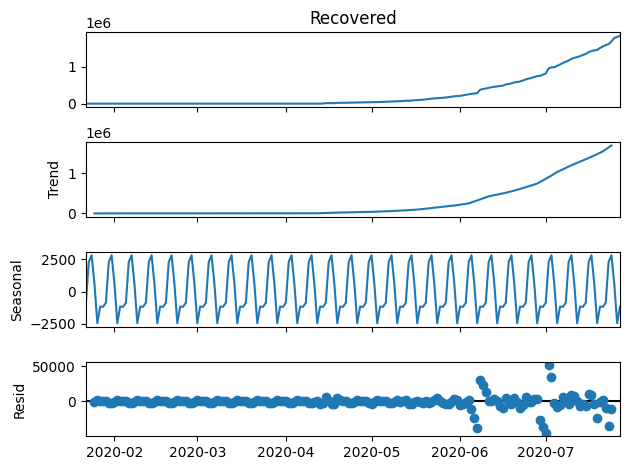

-------------------- Active --------------------


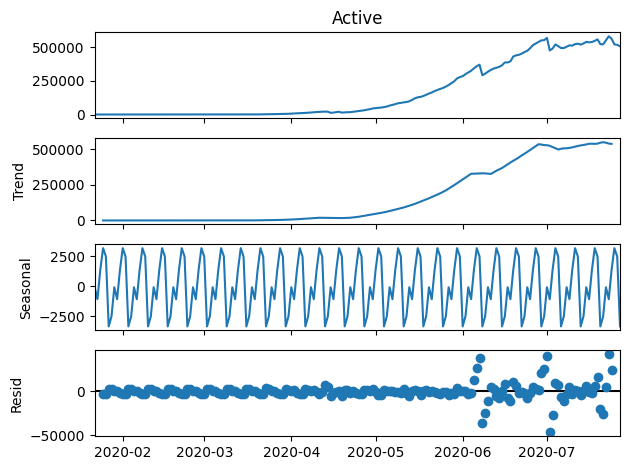

==================== India ====================
-------------------- Confirmed --------------------


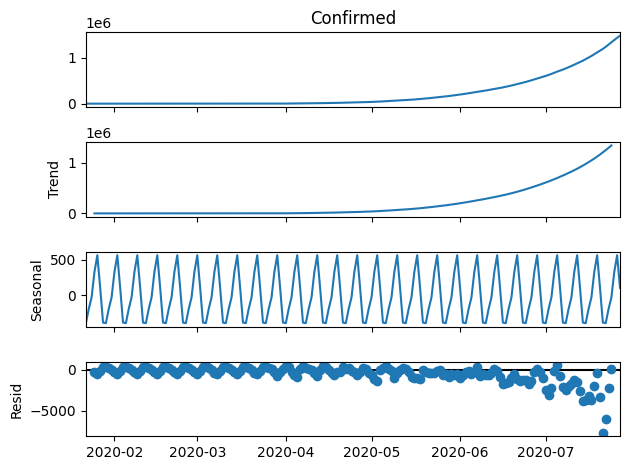

-------------------- Deaths --------------------


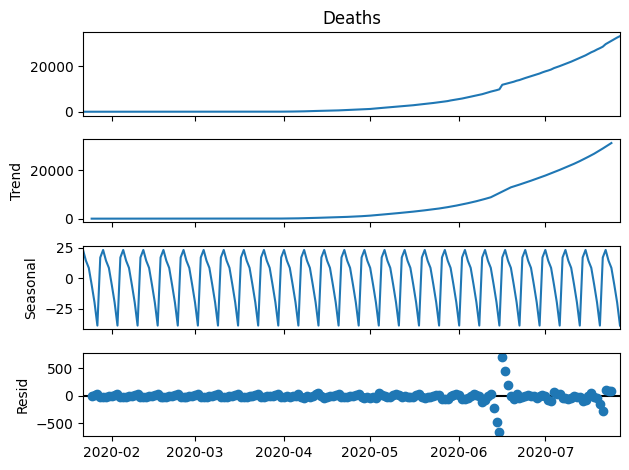

-------------------- Recovered --------------------


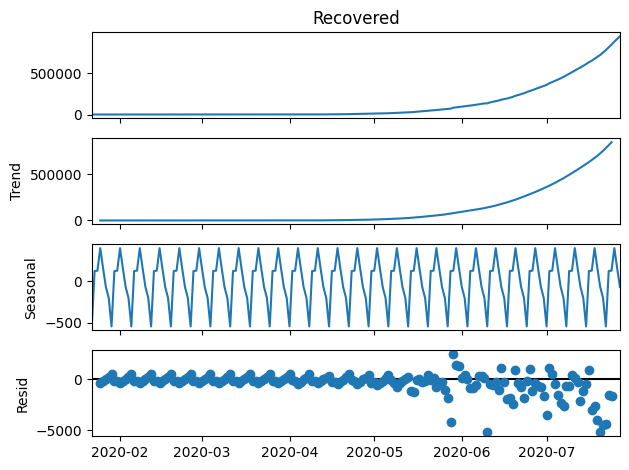

-------------------- Active --------------------


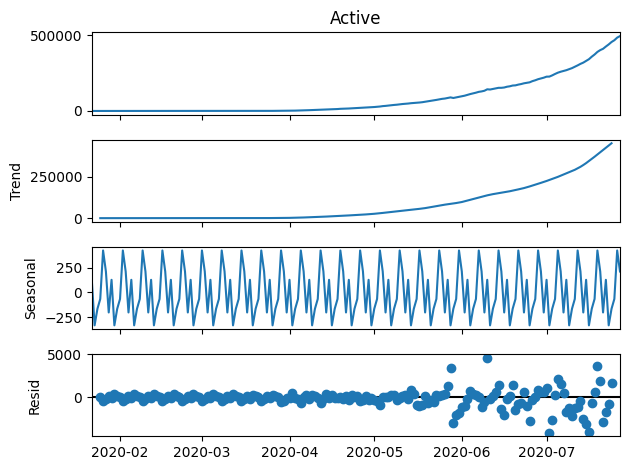

==================== Spain ====================
-------------------- Confirmed --------------------


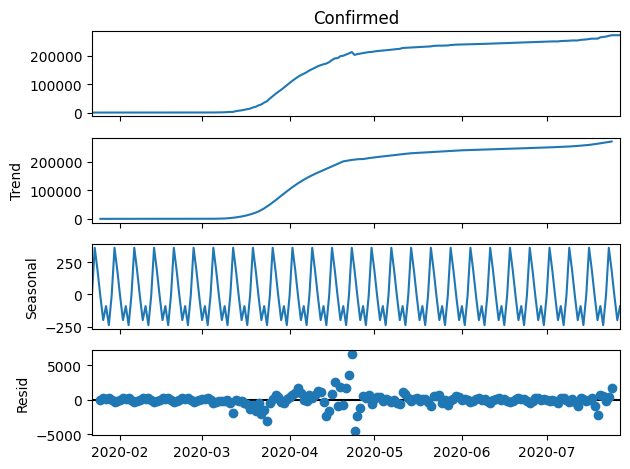

-------------------- Deaths --------------------


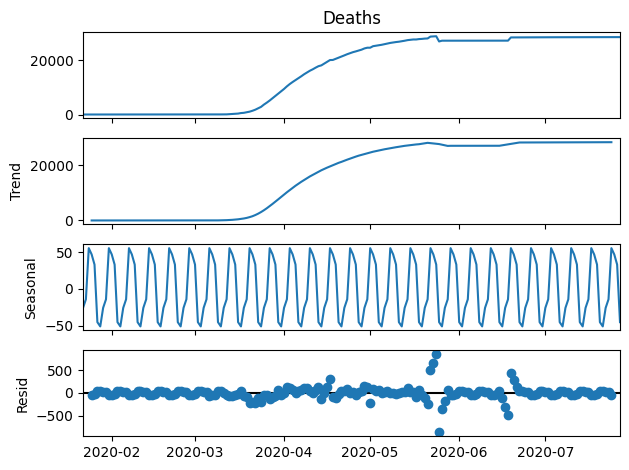

-------------------- Recovered --------------------


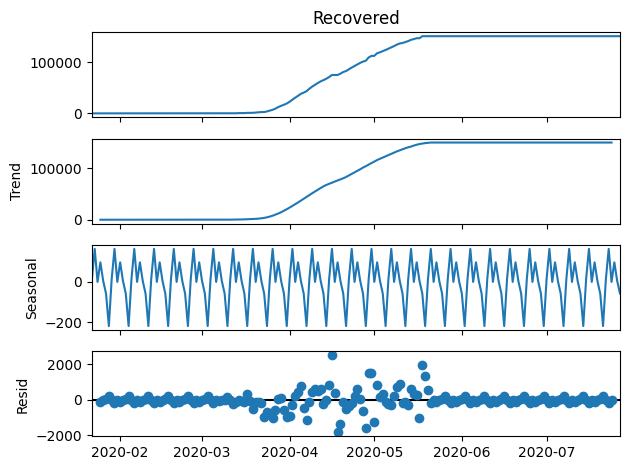

-------------------- Active --------------------


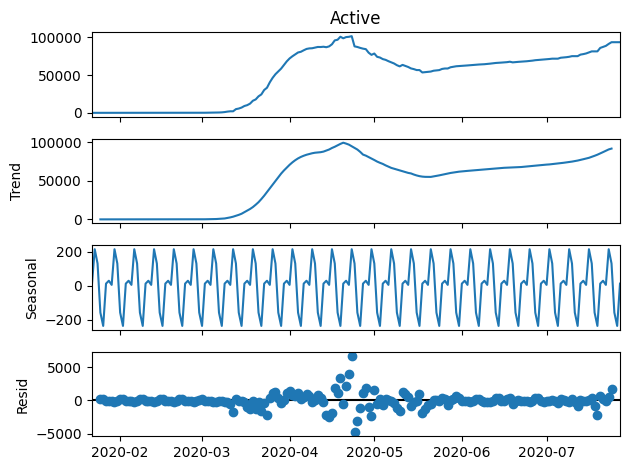

In [127]:
from statsmodels.tsa.seasonal import seasonal_decompose
mse_residue_add = []
for k, data in data_dict.items():
    print('='*20,k,'='*20)
    mse_residue_add_col=[]
    for column in data.columns:
        print('--'*10,column,'--'*10)
        decomposition = seasonal_decompose(data[column], model='additive')
        mse_residue_add_col.append(np.mean(np.square(decomposition.resid.dropna(()))).round(2))
        decomposition.plot()
        plt.show()
    mse_residue_add.append(mse_residue_add_col)


In [128]:
mse_residue_add

[[85612775.71, 384993.08, 169889018.89, 162460049.53],
 [55475088.03, 196971.31, 130902499.36, 147137793.91],
 [23499856.25, 17292.61, 83113263.09, 86191834.45],
 [1467419.1, 9563.67, 1325170.7, 1122674.28],
 [909937.02, 21234.01, 237617.65, 1082017.75]]

==================== global ====================
-------------------- Confirmed --------------------


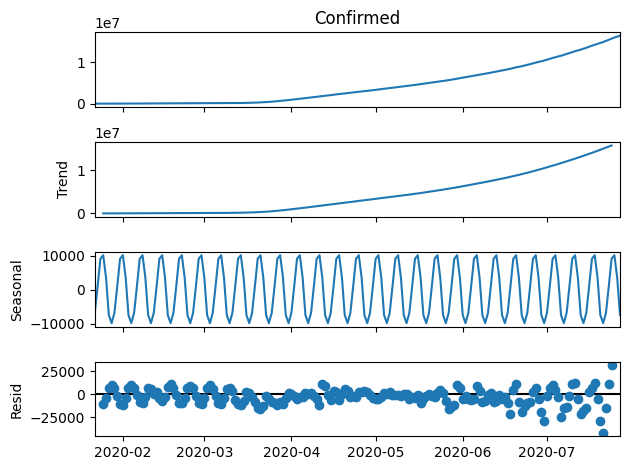

-------------------- Deaths --------------------


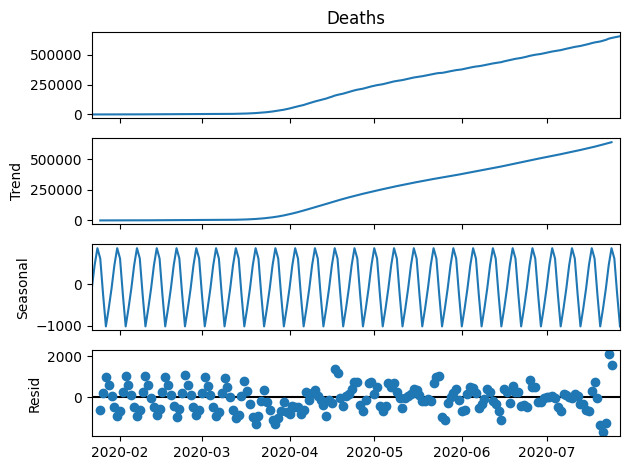

-------------------- Recovered --------------------


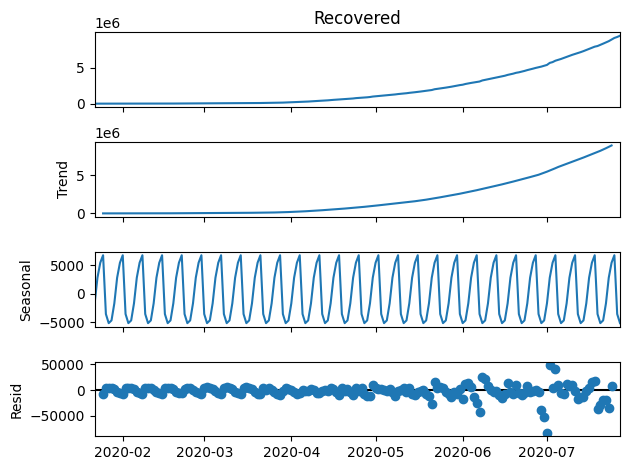

-------------------- Active --------------------


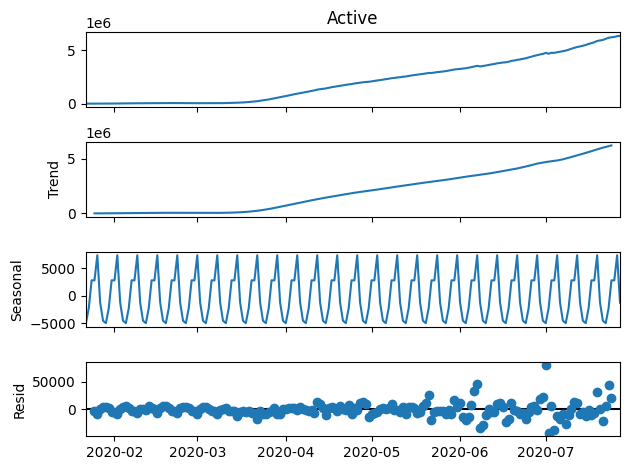

==================== americas ====================
-------------------- Confirmed --------------------


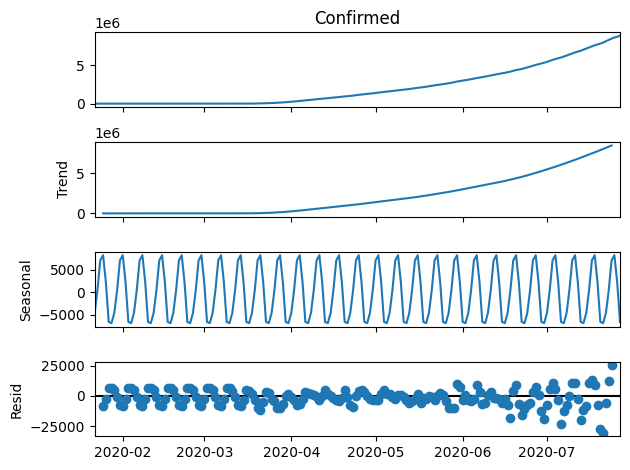

-------------------- Deaths --------------------


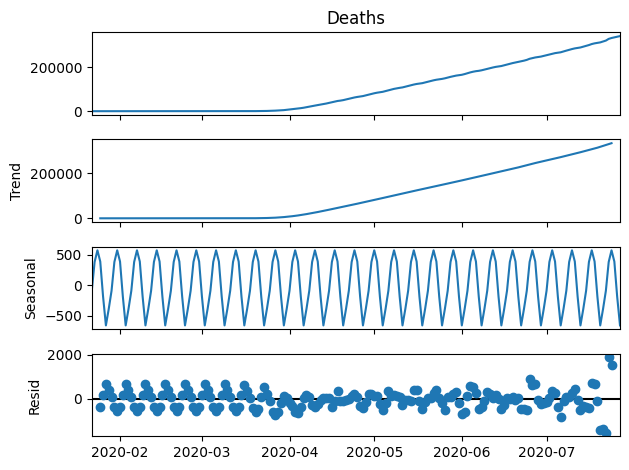

-------------------- Recovered --------------------


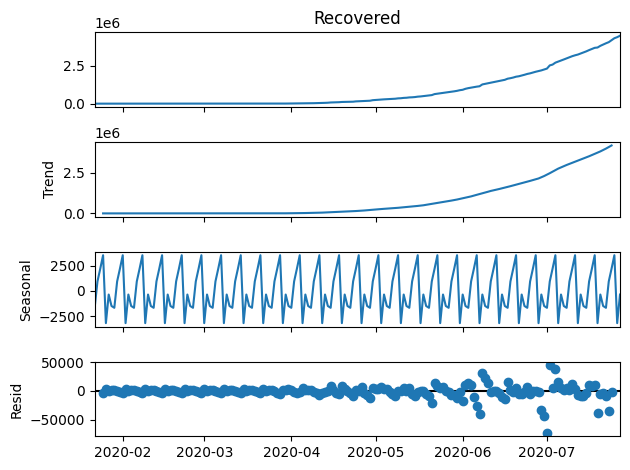

-------------------- Active --------------------


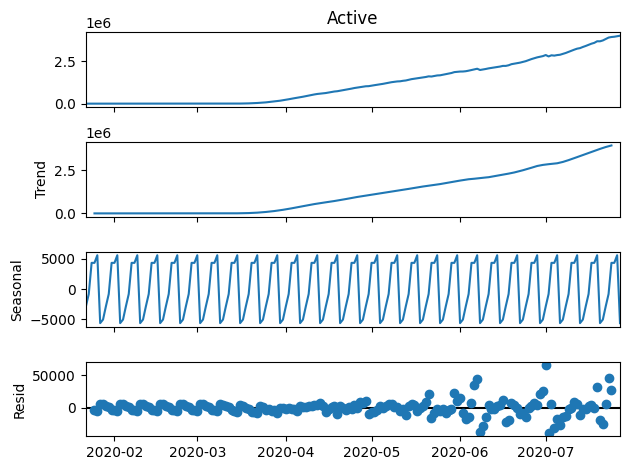

==================== Brazil ====================
-------------------- Confirmed --------------------


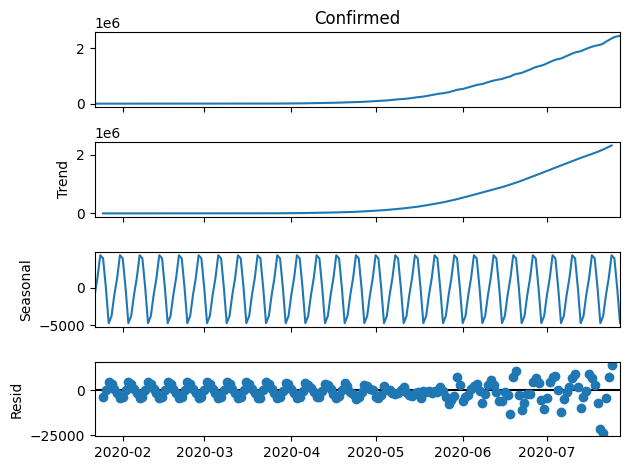

-------------------- Deaths --------------------


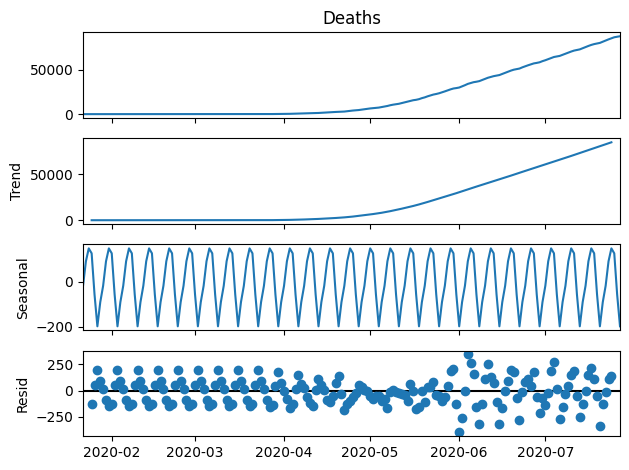

-------------------- Recovered --------------------


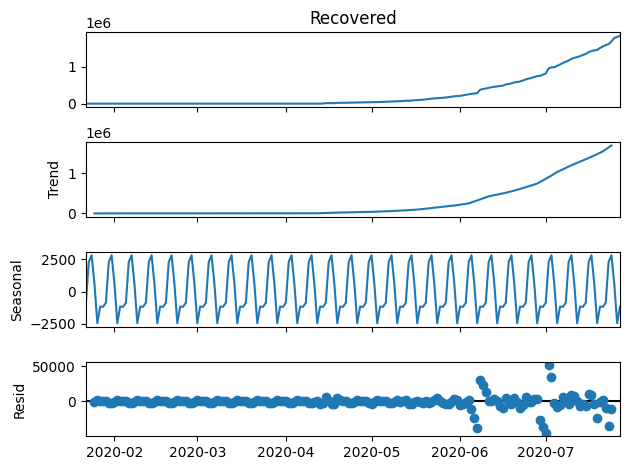

-------------------- Active --------------------


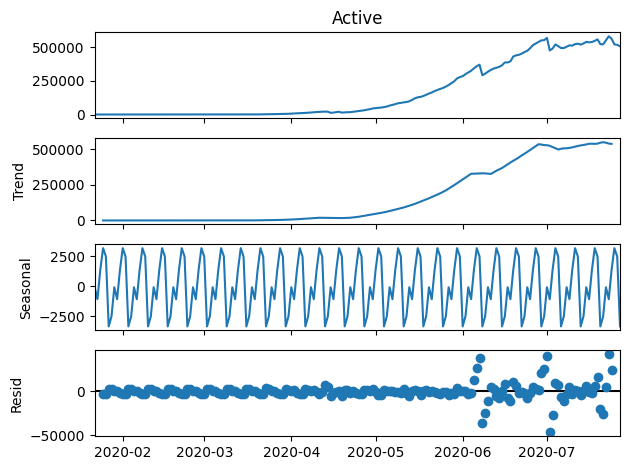

==================== India ====================
-------------------- Confirmed --------------------


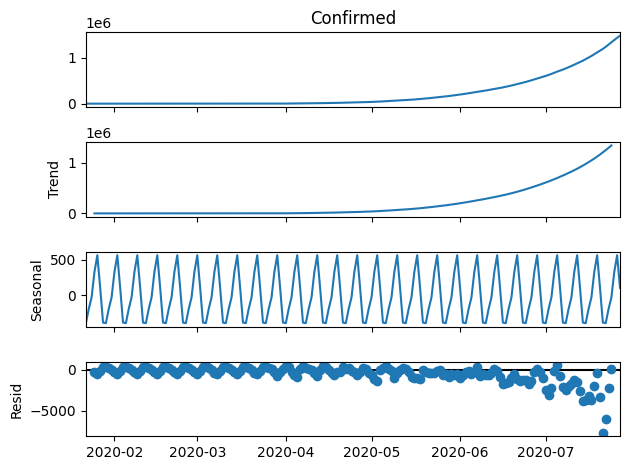

-------------------- Deaths --------------------


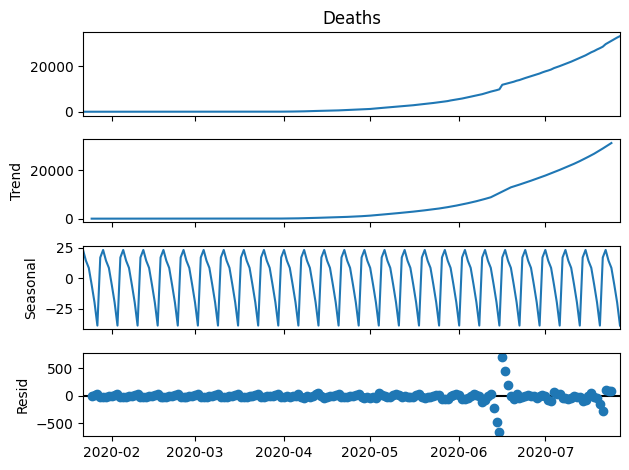

-------------------- Recovered --------------------


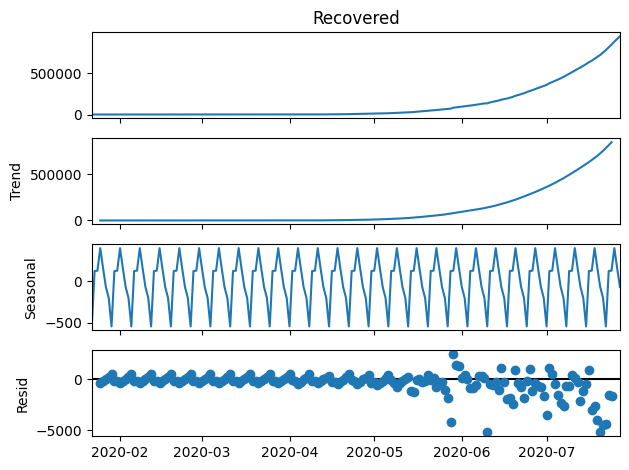

-------------------- Active --------------------


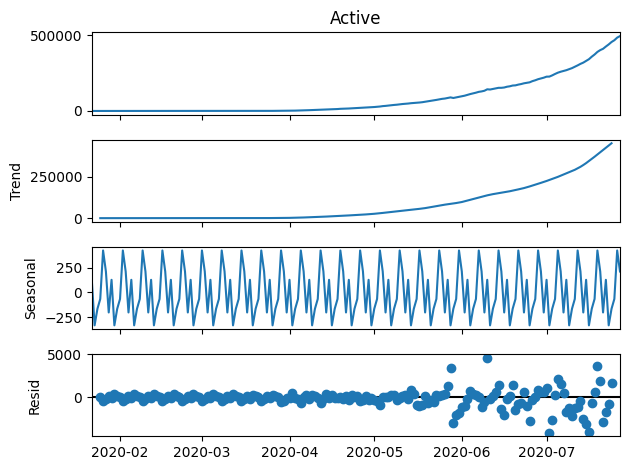

==================== Spain ====================
-------------------- Confirmed --------------------


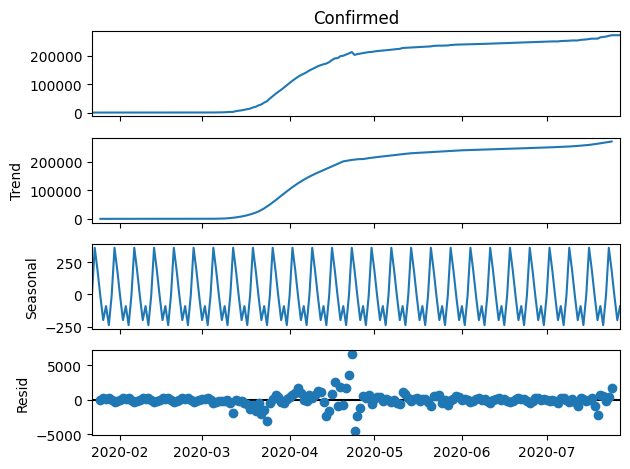

-------------------- Deaths --------------------


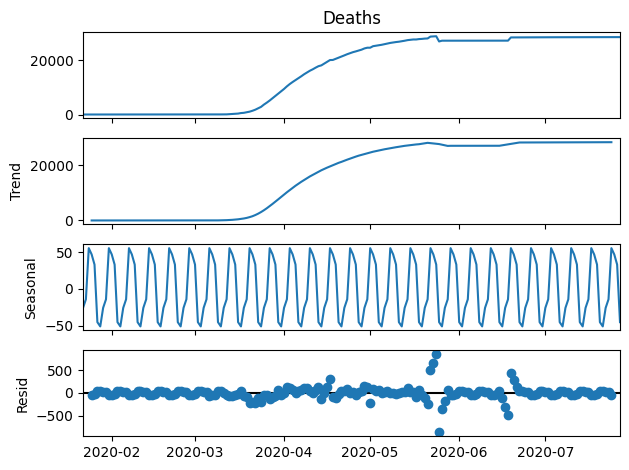

-------------------- Recovered --------------------


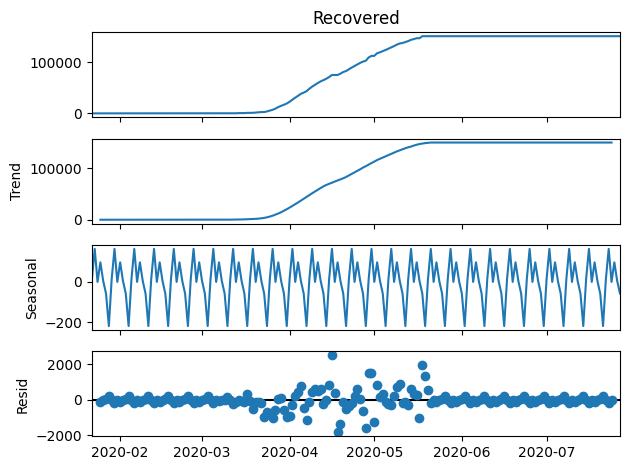

-------------------- Active --------------------


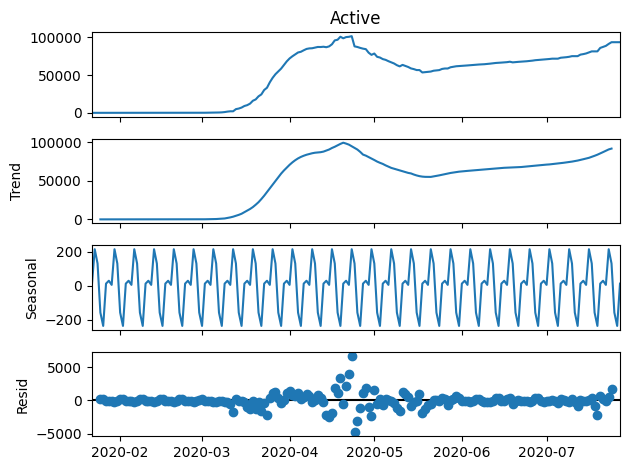

In [129]:
mse_residue_mul = []
for k, data in data_dict.items():
    print('='*20,k,'='*20)
    mse_residue_mul_col=[]
    for column in data.columns:
        print('--'*10,column,'--'*10)
        decomposition = seasonal_decompose(data[column], model='additive')
        mse_residue_mul_col.append(np.mean(np.square(decomposition.resid.dropna(()))).round(2))
        decomposition.plot()
        plt.show()
    mse_residue_mul.append(mse_residue_mul_col)

In [130]:
mse_residue_mul 

[[85612775.71, 384993.08, 169889018.89, 162460049.53],
 [55475088.03, 196971.31, 130902499.36, 147137793.91],
 [23499856.25, 17292.61, 83113263.09, 86191834.45],
 [1467419.1, 9563.67, 1325170.7, 1122674.28],
 [909937.02, 21234.01, 237617.65, 1082017.75]]

In [131]:
np.array(mse_residue_mul)<np.array(mse_residue_add)

array([[False, False, False, False],
       [False, False, False, False],
       [False, False, False, False],
       [False, False, False, False],
       [False, False, False, False]])

In [132]:
# Additive decomposition is better

##### Data Transformation

In [134]:
def plot_rolling_stats(df,rolling_mean,rolling_std,col,j,i):

    plt.subplot(6,4,j+i+1)
    plt.plot(df.index, df[col], label='Original', color='blue')
    plt.plot(df.index, rolling_mean, label='Rolling Mean', color='red')
    plt.plot(df.index, rolling_std, label='Rolling Std', color='green')
    plt.title(f'Rolling Mean & Standard Deviation of {col}')
    plt.legend()
    
def rolling_statistics(data,col):
    df = data.copy()
    rolling_mean = df[col].rolling(window=7).mean()
    rolling_std = df[col].rolling(window=7).std()
    return rolling_mean, rolling_std

==================== global ====================


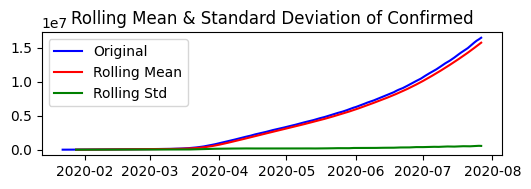

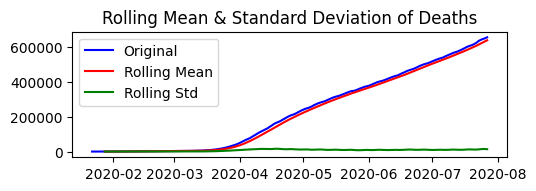

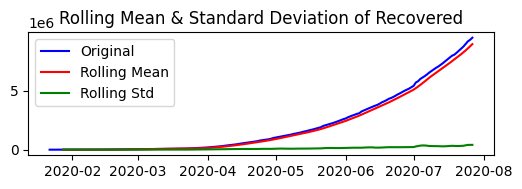

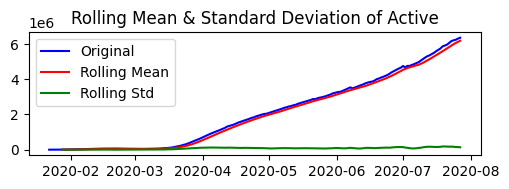

==================== americas ====================


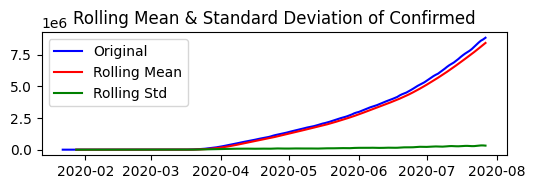

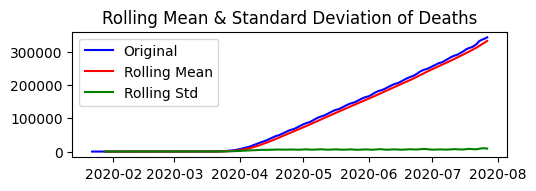

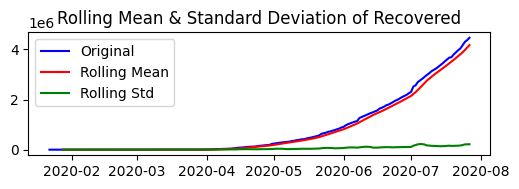

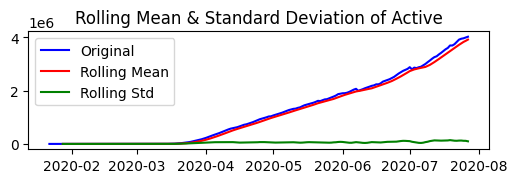

==================== Brazil ====================


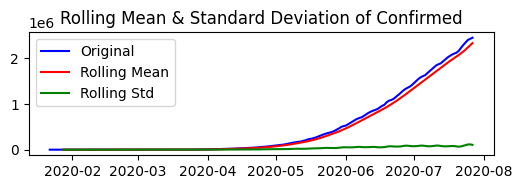

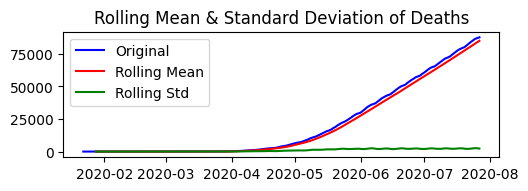

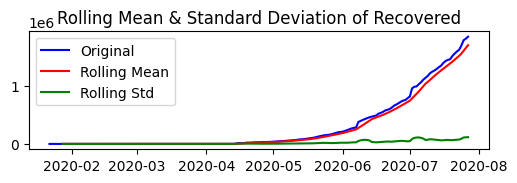

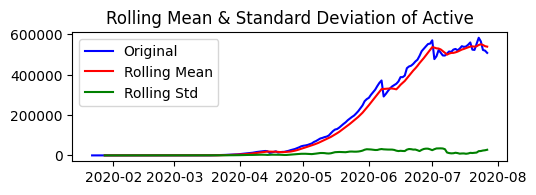

==================== India ====================


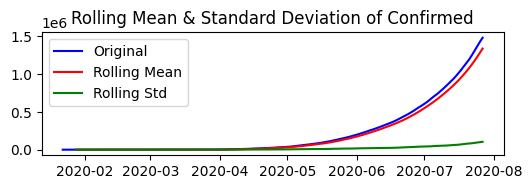

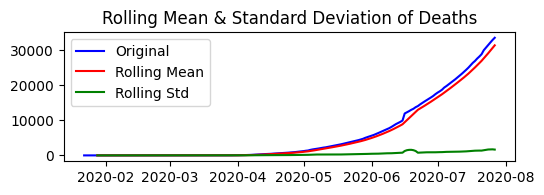

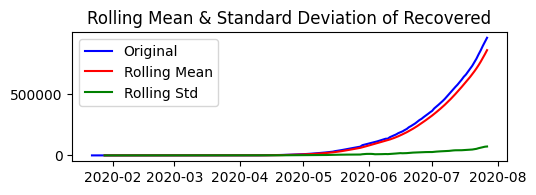

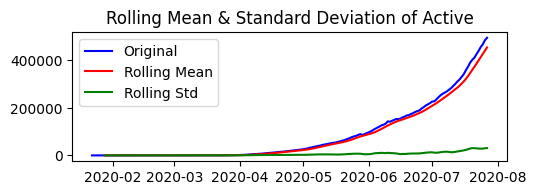

==================== Spain ====================


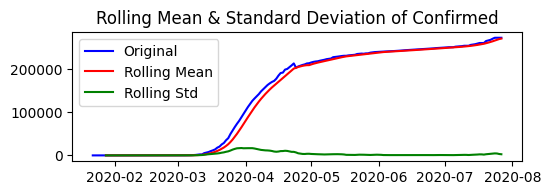

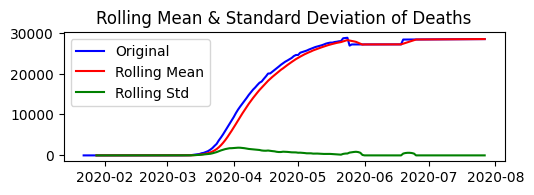

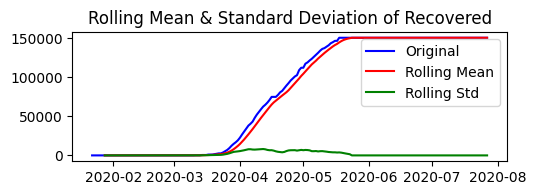

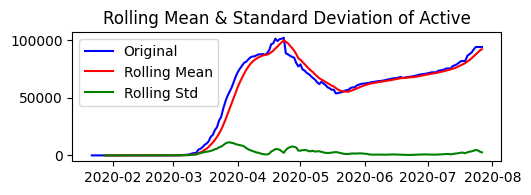

In [139]:
for j,(k, data) in enumerate(data_dict.items()):
    print('='*20, k,'='*20)
    for i,col in enumerate(data.columns):
        rm,rs = rolling_statistics(data,col)
        plt.figure(figsize=(20,10))
        plot_rolling_stats(data,rm,rs,col,j,i)
        plt.tight_layout()
        plt.show()  

In [141]:
# Create lagged features 
for k, data in data_dict.items():
    for i,col in enumerate(data.columns):
        data[f'{col}_lag_1'] = data[col].shift(1)
        print(f'lagged feature for {k} {col} created')
    print(data.sample(2))

lagged feature for global Confirmed created
lagged feature for global Deaths created
lagged feature for global Recovered created
lagged feature for global Active created
            Confirmed  Deaths  Recovered   Active  Confirmed_lag_1  \
Date                                                                 
2020-04-29    3185195  228742     925752  2030701       3108149.00   
2020-05-23    5322253  343385    2062802  2916066       5216964.00   

            Deaths_lag_1  Recovered_lag_1  Active_lag_1  
Date                                                     
2020-04-29     221974.00        884680.00    2001495.00  
2020-05-23     339396.00       2008541.00    2869027.00  
lagged feature for americas Confirmed created
lagged feature for americas Deaths created
lagged feature for americas Recovered created
lagged feature for americas Active created
            Confirmed  Deaths  Recovered   Active  Confirmed_lag_1  \
Date                                                                 

In [142]:
# Extract date-time features - week and month.
for k, data in data_dict.items():
    data['day_of_week'] = data.index.dayofweek
    data['month'] = data.index.month
    print(f'Day of week and month feature for {k} is created')
    print(data.sample(2))


Day of week and month feature for global is created
            Confirmed  Deaths  Recovered   Active  Confirmed_lag_1  \
Date                                                                 
2020-05-29    5940145  366562    2440127  3133456       5818978.00   
2020-04-21    2553508  181122     664043  1708343       2478258.00   

            Deaths_lag_1  Recovered_lag_1  Active_lag_1  day_of_week  month  
Date                                                                         
2020-05-29     361820.00       2363746.00    3093412.00            4      5  
2020-04-21     173965.00        629862.00    1674431.00            1      4  
Day of week and month feature for americas is created
            Confirmed  Deaths  Recovered   Active  Confirmed_lag_1  \
Date                                                                 
2020-03-18      11109     208        118    10783          7856.00   
2020-04-30    1344980   78937     228792  1037251       1299203.00   

            Deaths_l

In [143]:
def plot_box_month(df,col,j,i,color):
    plt.subplot(6,4,j+i+1)
    sns.boxplot(x='month', y=col, data=df,color=color)
    plt.title(f'Box Plot of {k} {col} by Month')
    plt.xlabel('Month')
    plt.ylabel(col)


def plot_box_dow(df,col,j,i,color):
    plt.subplot(6,4,j+i+1)
    sns.boxplot(x='day_of_week', y=col, data=df,color=color)
    plt.title(f'Box Plot of {k} {col} by Day of Week')
    plt.xlabel('Day of Week')
    plt.ylabel(col)   

In [144]:
columns = ['Confirmed',
       'Deaths', 'Recovered', 'Active']
# df.columns

==================== global ====================


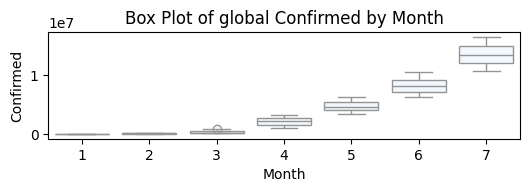

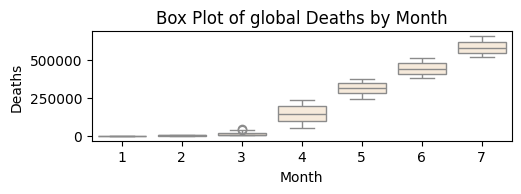

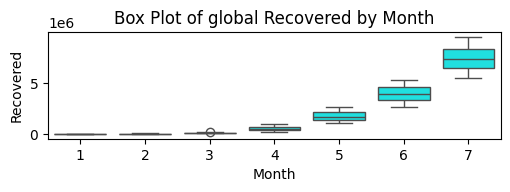

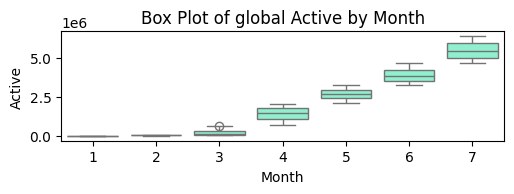

==================== americas ====================


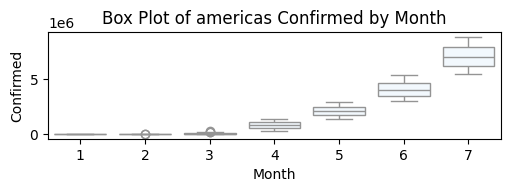

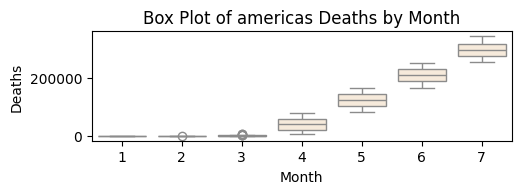

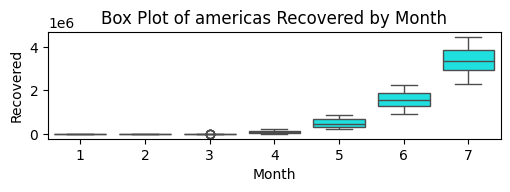

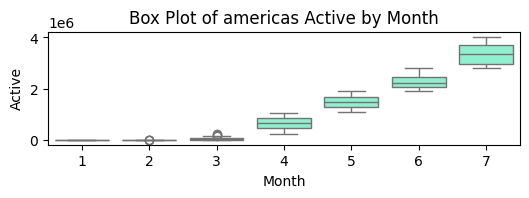

==================== Brazil ====================


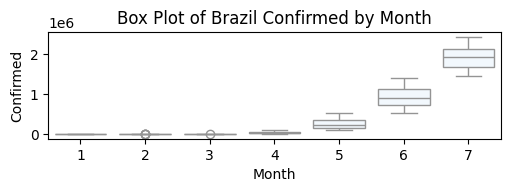

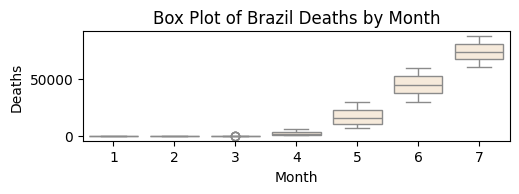

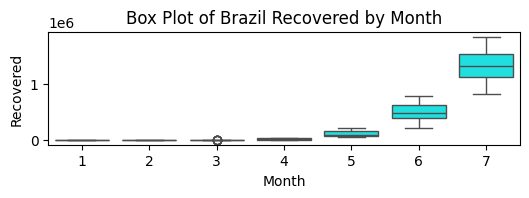

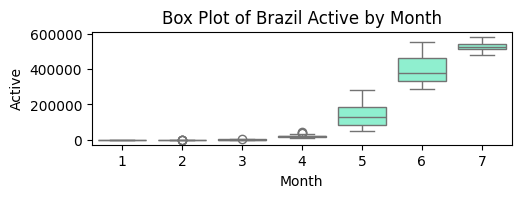

==================== India ====================


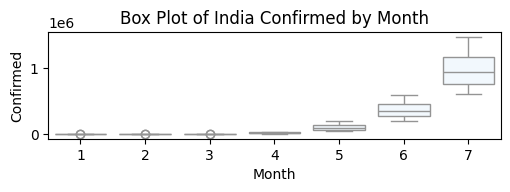

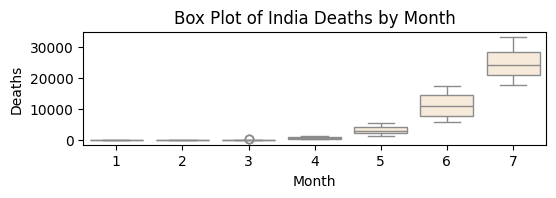

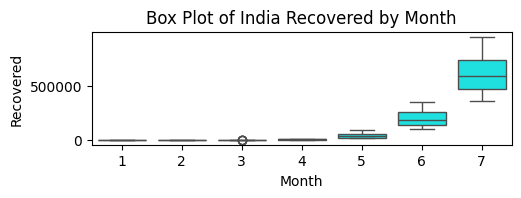

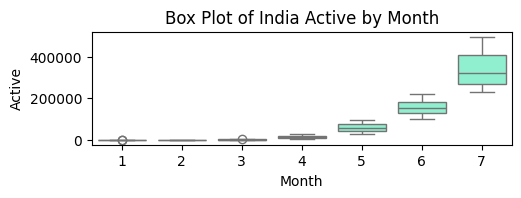

==================== Spain ====================


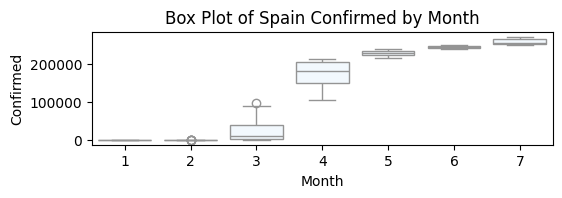

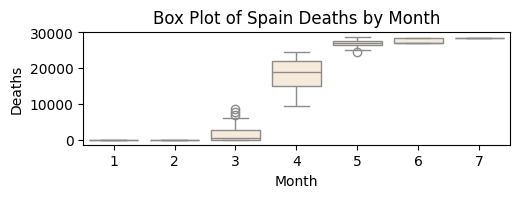

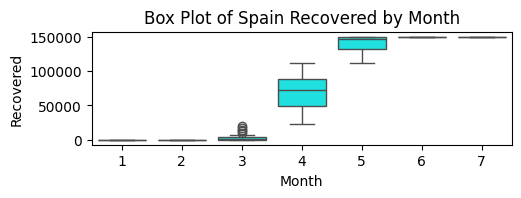

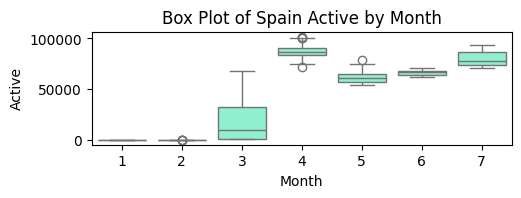

In [145]:
for j,(k, data) in enumerate(data_dict.items()):
    print('='*20, k,'='*20)
    color_list = list(matplotlib.colors.CSS4_COLORS.keys()) 
    for i,(color,col) in enumerate(zip(color_list,columns)):
        plt.figure(figsize=(20,10))
        plot_box_month(data,col,j,i,color)
        plt.tight_layout()
        plt.show()


In [146]:
# shows similar outlier trends as isolation forest

==================== global ====================


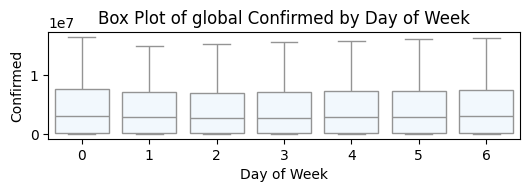

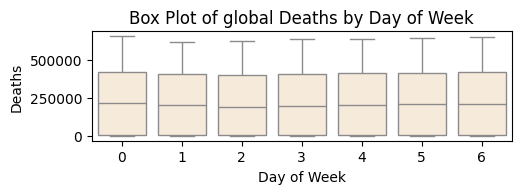

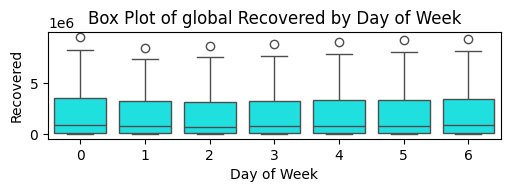

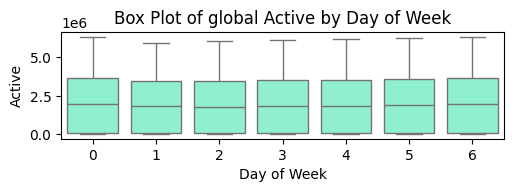

==================== americas ====================


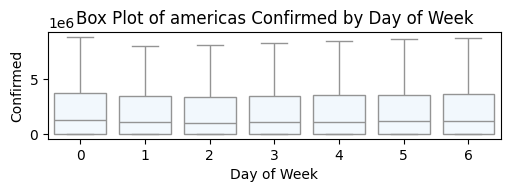

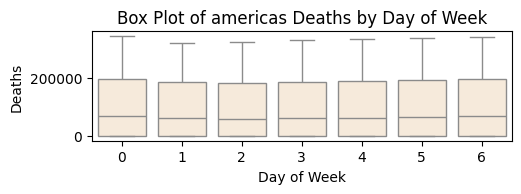

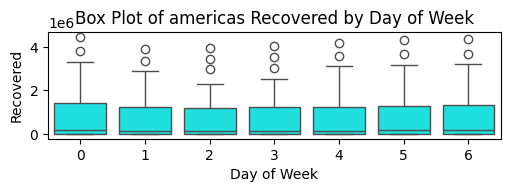

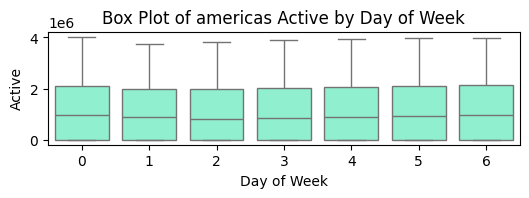

==================== Brazil ====================


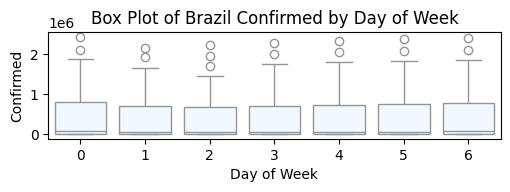

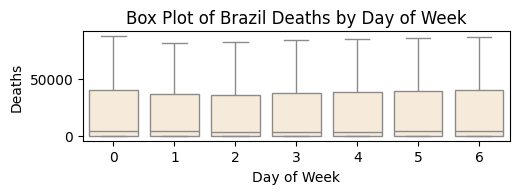

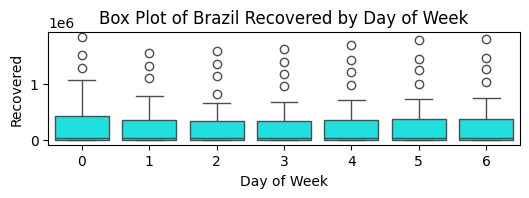

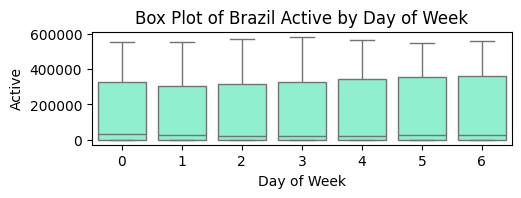

==================== India ====================


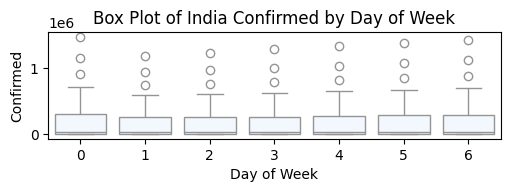

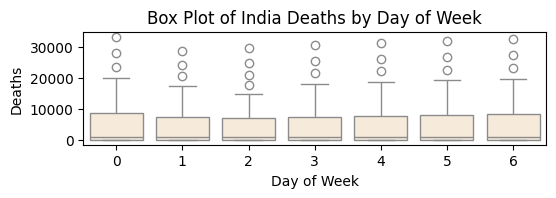

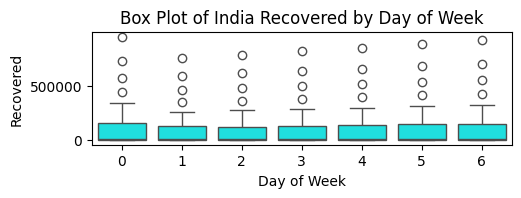

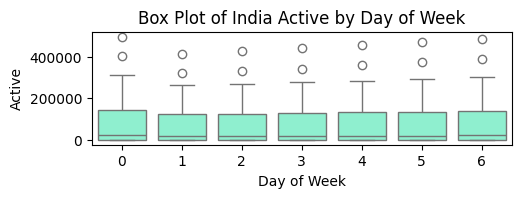

==================== Spain ====================


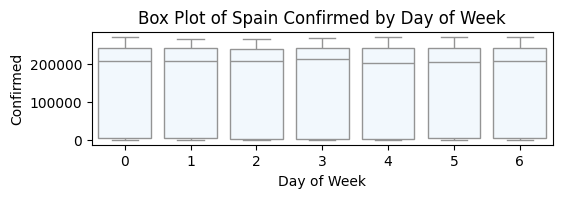

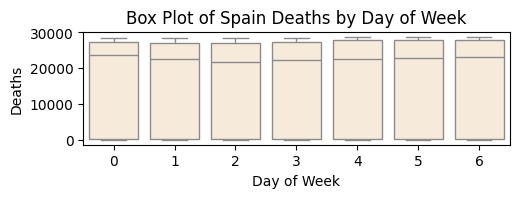

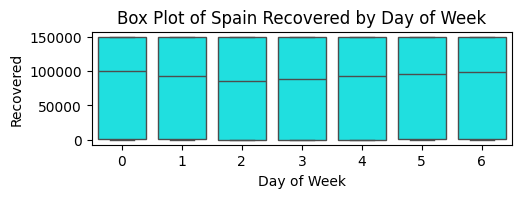

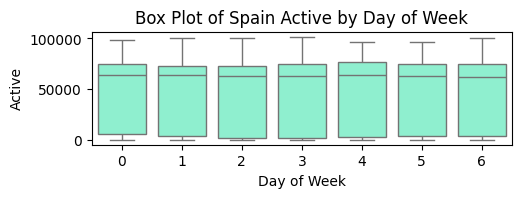

In [147]:
for j,(k, data) in enumerate(data_dict.items()):
    print('='*20, k,'='*20)
    color_list = list(matplotlib.colors.CSS4_COLORS.keys()) 
    for i,(color,col) in enumerate(zip(color_list,columns)):
        plt.figure(figsize=(20,10))
        plot_box_dow(data,col,j,i,color)
        plt.tight_layout()
        plt.show()

In [148]:
# India's data shows weekly variation and ouliers the most followed by Americas and Brazil.

In [149]:
# Perform Fourier Transform to extract frequency domain features
def cal_fft(df,col):
    n = len(df)
    fft_values = np.fft.fft(df[col])
    frequencies = np.fft.fftfreq(n)
    return frequencies,fft_values

# Create a DataFrame for FFT results and plot
def plot_fft(data,col,j,i,color):
    frequencies,fft_values = cal_fft(data,col)
    plt.subplot(6,4,j+i+1)
    fft_df = pd.DataFrame({'Frequency': frequencies, 'FFT_Values': np.abs(fft_values)})
    # display(fft_df)
    plt.plot(fft_df['Frequency'], fft_df['FFT_Values'],color = color)
    plt.title(f'Fourier Transform for {k} {col}')
    plt.xlabel('Frequency')
    plt.ylabel('Magnitude')
    plt.grid(True)


==================== global ====================


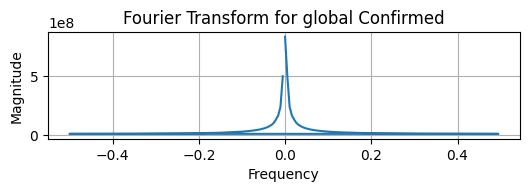

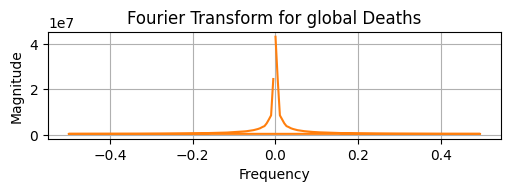

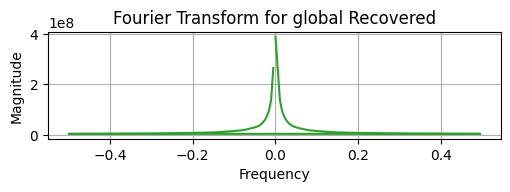

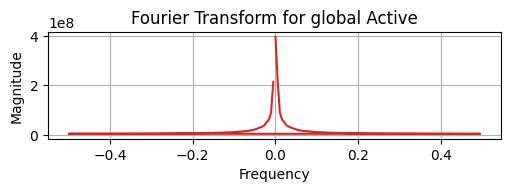

==================== americas ====================


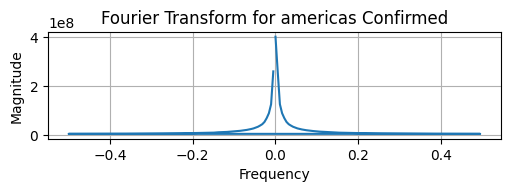

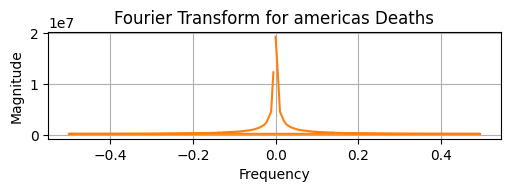

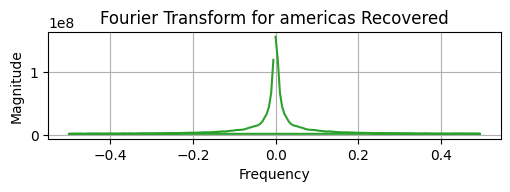

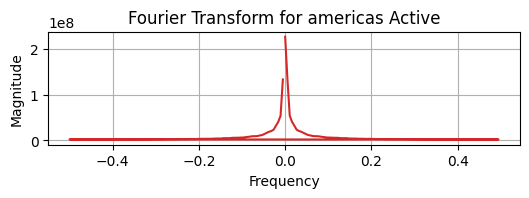

==================== Brazil ====================


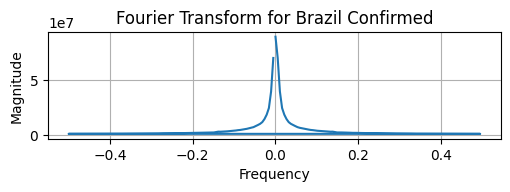

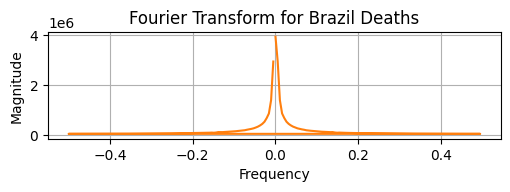

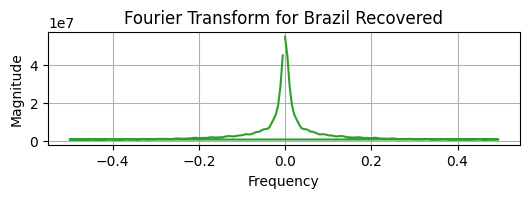

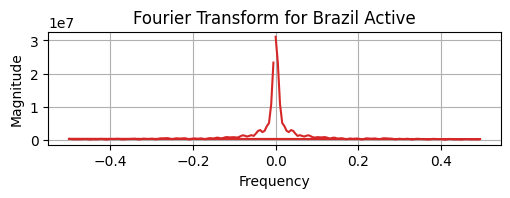

==================== India ====================


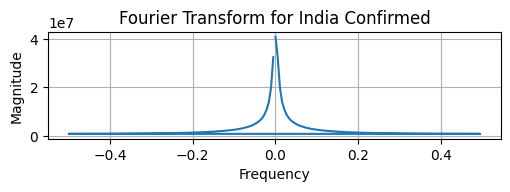

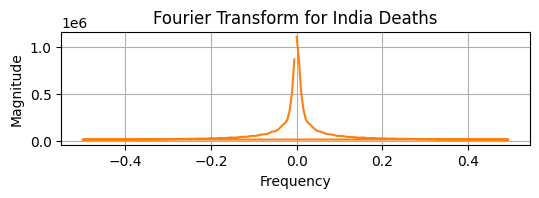

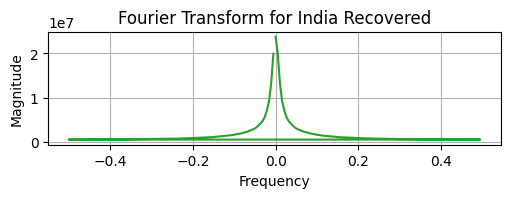

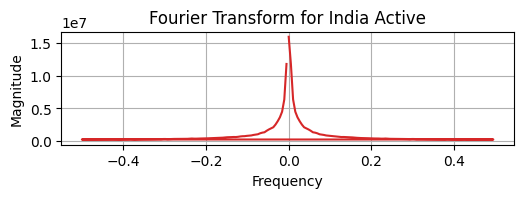

==================== Spain ====================


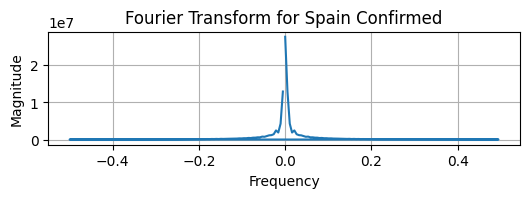

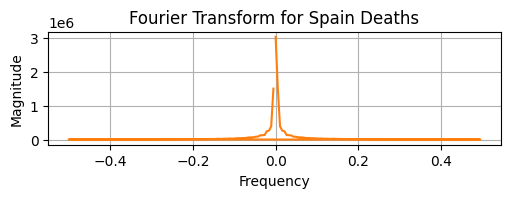

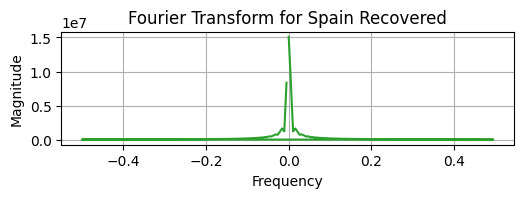

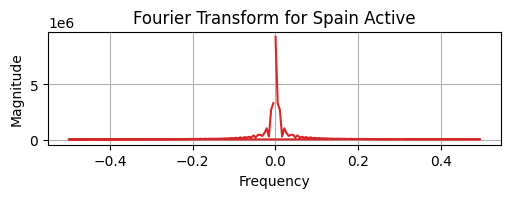

In [150]:
for j,(k, data) in enumerate(data_dict.items()):
    print('='*20, k,'='*20)
    color_list = list(matplotlib.colors.TABLEAU_COLORS.keys()) 
    for i,(color,col) in enumerate(zip(color_list,columns)):
        plt.figure(figsize=(20,10))
        plot_fft(data,col,j,i,color)
        plt.tight_layout()
        plt.show()

### Model (Prophet) and Metric Selection 

In [154]:
global_data.head()

,Confirmed,Deaths,Recovered,Active,Confirmed_lag_1,Deaths_lag_1,Recovered_lag_1,Active_lag_1,day_of_week,month
Date,,,,,,,,,,
2020-01-22,555,17,28,510,NaN,NaN,NaN,NaN,2,1
2020-01-23,654,18,30,606,555.00,17.00,28.00,510.00,3,1
2020-01-24,941,26,36,879,654.00,18.00,30.00,606.00,4,1
2020-01-25,1434,42,39,1353,941.00,26.00,36.00,879.00,5,1
2020-01-26,2118,56,52,2010,1434.00,42.00,39.00,1353.00,6,1


In [155]:
data.index.max()

Timestamp('2020-07-27 00:00:00', freq='D')

In [156]:
forecast_start_dt = date(2020,6,27) #data set ends of (2020-07-27)
forecast_start_date = (forecast_start_dt).strftime("%Y-%m-%d") 
print(forecast_start_date)

2020-06-27


In [157]:
# Ensure future_date is a DataFrame with 'ds' column
future_date = data[data.index > forecast_start_date].reset_index().rename(columns={'Date': 'ds'})

# Convert 'ds' column to datetime format
future_date['ds'] = pd.to_datetime(future_date['ds'])

display(future_date)

,ds,Confirmed,Deaths,Recovered,Active,Confirmed_lag_1,Deaths_lag_1,Recovered_lag_1,Active_lag_1,day_of_week,month
0,2020-06-28,248770,28343,150376,70051,248469.00,28341.00,150376.00,69752.00,6,6
1,2020-06-29,248970,28346,150376,70248,248770.00,28343.00,150376.00,70051.00,0,6
2,2020-06-30,249271,28355,150376,70540,248970.00,28346.00,150376.00,70248.00,1,6
3,2020-07-01,249659,28364,150376,70919,249271.00,28355.00,150376.00,70540.00,2,7
4,2020-07-02,250103,28368,150376,71359,249659.00,28364.00,150376.00,70919.00,3,7
5,2020-07-03,250545,28385,150376,71784,250103.00,28368.00,150376.00,71359.00,4,7
6,2020-07-04,250545,28385,150376,71784,250545.00,28385.00,150376.00,71784.00,5,7
7,2020-07-05,250545,28385,150376,71784,250545.00,28385.00,150376.00,71784.00,6,7
8,2020-07-06,251789,28388,150376,73025,250545.00,28385.00,150376.00,71784.00,0,7
9,2020-07-07,252130,28392,150376,73362,251789.00,28388.00,150376.00,73025.00,1,7


In [158]:
global_data.reset_index(inplace=True)
global_data.head(1)

,Date,Confirmed,Deaths,Recovered,Active,Confirmed_lag_1,Deaths_lag_1,Recovered_lag_1,Active_lag_1,day_of_week,month
0,2020-01-22,555,17,28,510,NaN,NaN,NaN,NaN,2,1


#### Brute force
        - split data
        - train
        - evaluate

In [160]:
# PROPHET MODEL for Confirmed cases
df_copy = global_data.sort_values(by='Date')
df_copy = df_copy.rename(columns={'Date': 'ds', 'Confirmed': 'y'})
df_copy[['y']] = df_copy[['y']].apply(pd.to_numeric)

df_copy['ds'] = pd.to_datetime(df_copy['ds'])

train_set = df_copy[(df_copy['ds'] <= forecast_start_date) ]
ytrue = df_copy[df_copy['ds'] > forecast_start_date]

m = Prophet()

m.fit(train_set)

fcst_prophet_train = m.predict(future_date)

#adding filter to only add the forecasted data into predicted_df
filter = fcst_prophet_train['ds']> forecast_start_date 

predicted_df = fcst_prophet_train[filter][['ds','yhat']]
predicted_df = predicted_df.merge(ytrue)
predicted_df

09:37:06 - cmdstanpy - INFO - Chain [1] start processing
09:37:06 - cmdstanpy - INFO - Chain [1] done processing


,ds,yhat,y,Deaths,Recovered,Active,Confirmed_lag_1,Deaths_lag_1,Recovered_lag_1,Active_lag_1,day_of_week,month
0,2020-06-28,9852834.05,10117227,502357,5070592,4544278,9955597.00,499268.00,4981808.00,4474521.00,6,6
1,2020-06-29,9978050.67,10275799,506078,5164494,4605227,10117227.00,502357.00,5070592.00,4544278.00,0,6
2,2020-06-30,10109960.39,10449697,511210,5281459,4657028,10275799.00,506078.00,5164494.00,4605227.00,1,6
3,2020-07-01,10243155.89,10667386,516221,5397083,4754082,10449697.00,511210.00,5281459.00,4657028.00,2,7
4,2020-07-02,10380523.14,10875091,521341,5681477,4672273,10667386.00,516221.00,5397083.00,4754082.00,3,7
5,2020-07-03,10519902.57,11078585,526336,5790942,4761307,10875091.00,521341.00,5681477.00,4672273.00,4,7
6,2020-07-04,10656082.64,11272152,530705,5986375,4755072,11078585.00,526336.00,5790942.00,4761307.00,5,7
7,2020-07-05,10774559.11,11454847,534150,6105546,4815151,11272152.00,530705.00,5986375.00,4755072.00,6,7
8,2020-07-06,10899775.72,11622190,537947,6228768,4855475,11454847.00,534150.00,6105546.00,4815151.00,0,7
9,2020-07-07,11031685.45,11833034,544054,6373513,4915467,11622190.00,537947.00,6228768.00,4855475.00,1,7


In [161]:
print('RMSE: ',np.sqrt(mean_squared_error(predicted_df['yhat'],predicted_df['y'])))
print('MAPE: ',mean_absolute_percentage_error(predicted_df['yhat'],predicted_df['y']))
print('Accuracy Range: ',100 -mean_absolute_percentage_error(predicted_df['yhat'],predicted_df['y']) ,', ',\
      100 +mean_absolute_percentage_error(predicted_df['yhat'],predicted_df['y']))
# print('R2 Score: ' ,r2_score(predicted_df['yhat'],predicted_df['y'])) 

RMSE:  1567322.7804056515
MAPE:  0.11051144982221618
Accuracy Range:  99.88948855017779 ,  100.11051144982221


In [162]:
# Ensure future_date is a DataFrame with 'ds' column
future_date = data[data.index > forecast_start_date].reset_index().rename(columns={'Date': 'ds'})

# Convert 'ds' column to datetime format
future_date['ds'] = pd.to_datetime(future_date['ds'])

display(future_date)

,ds,Confirmed,Deaths,Recovered,Active,Confirmed_lag_1,Deaths_lag_1,Recovered_lag_1,Active_lag_1,day_of_week,month
0,2020-06-28,248770,28343,150376,70051,248469.00,28341.00,150376.00,69752.00,6,6
1,2020-06-29,248970,28346,150376,70248,248770.00,28343.00,150376.00,70051.00,0,6
2,2020-06-30,249271,28355,150376,70540,248970.00,28346.00,150376.00,70248.00,1,6
3,2020-07-01,249659,28364,150376,70919,249271.00,28355.00,150376.00,70540.00,2,7
4,2020-07-02,250103,28368,150376,71359,249659.00,28364.00,150376.00,70919.00,3,7
5,2020-07-03,250545,28385,150376,71784,250103.00,28368.00,150376.00,71359.00,4,7
6,2020-07-04,250545,28385,150376,71784,250545.00,28385.00,150376.00,71784.00,5,7
7,2020-07-05,250545,28385,150376,71784,250545.00,28385.00,150376.00,71784.00,6,7
8,2020-07-06,251789,28388,150376,73025,250545.00,28385.00,150376.00,71784.00,0,7
9,2020-07-07,252130,28392,150376,73362,251789.00,28388.00,150376.00,73025.00,1,7


In [163]:
df_ = global_data[["Date", "Confirmed", 'Confirmed_lag_1']].dropna().copy()
df_.columns = ["ds", "y", "Confirmed_lag_1"]
df_copy = df_.sort_values(by='ds')

df_copy[['y']] = df_copy[['y']].apply(pd.to_numeric)

df_copy['ds'] = pd.to_datetime(df_copy['ds'])

train_set = df_copy[(df_copy['ds'] <= forecast_start_date) ]
ytrue = df_copy[df_copy['ds'] >= forecast_start_date]

m = Prophet()
# m.add_seasonality(name='weekly', period=91.25, fourier_order=8)
m.add_regressor("Confirmed_lag_1")


m.fit(train_set)

future_date["Confirmed_lag_1"] = train_set["Confirmed_lag_1"].iloc[-1]  

fcst_prophet_train = m.predict(future_date)

#adding filter to only add the forecasted data into predicted_df
filter = fcst_prophet_train['ds']> forecast_start_date 

predicted_df = fcst_prophet_train[filter][['ds','yhat']]
predicted_df = predicted_df.merge(ytrue)
predicted_df.head()

09:37:07 - cmdstanpy - INFO - Chain [1] start processing
09:37:07 - cmdstanpy - INFO - Chain [1] done processing


,ds,yhat,y,Confirmed_lag_1
0,2020-06-28,9946459.40,10117227,9955597.00
1,2020-06-29,9940335.77,10275799,10117227.00
2,2020-06-30,9943400.63,10449697,10275799.00
3,2020-07-01,9942795.61,10667386,10449697.00
4,2020-07-02,9944243.52,10875091,10667386.00


In [164]:
print('RMSE: ',np.sqrt(mean_squared_error(predicted_df['yhat'],predicted_df['y'])))
print('MAPE: ',mean_absolute_percentage_error(predicted_df['yhat'],predicted_df['y']))
print('Accuracy Range: ',100 -mean_absolute_percentage_error(predicted_df['yhat'],predicted_df['y']) ,', ',\
      100 +mean_absolute_percentage_error(predicted_df['yhat'],predicted_df['y']))

RMSE:  3754594.9553471766
MAPE:  0.32507910419717084
Accuracy Range:  99.67492089580283 ,  100.32507910419717


In [165]:
# regressor doesnot improve performance

#### cross validate

09:37:07 - cmdstanpy - INFO - Chain [1] start processing
09:37:07 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/5 [00:00<?, ?it/s]

09:37:07 - cmdstanpy - INFO - Chain [1] start processing
09:37:08 - cmdstanpy - INFO - Chain [1] done processing
09:37:08 - cmdstanpy - INFO - Chain [1] start processing
09:37:08 - cmdstanpy - INFO - Chain [1] done processing
09:37:08 - cmdstanpy - INFO - Chain [1] start processing
09:37:09 - cmdstanpy - INFO - Chain [1] done processing
09:37:09 - cmdstanpy - INFO - Chain [1] start processing
09:37:09 - cmdstanpy - INFO - Chain [1] done processing
09:37:10 - cmdstanpy - INFO - Chain [1] start processing
09:37:10 - cmdstanpy - INFO - Chain [1] done processing


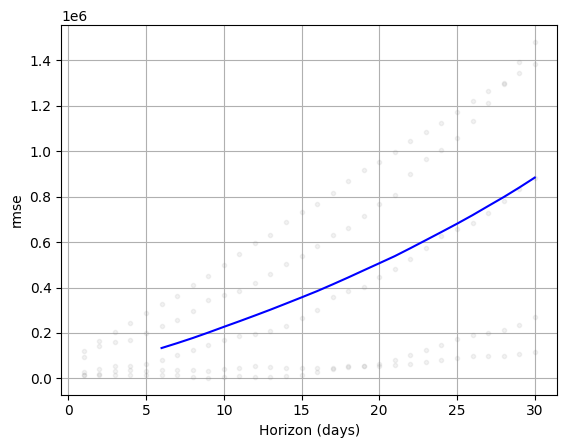

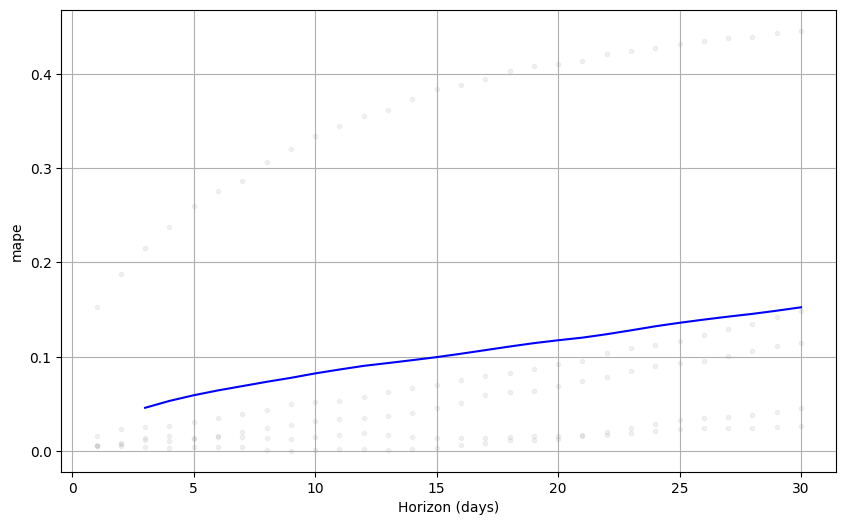

In [167]:
df_copy = global_data.dropna().sort_values(by='Date')
df_copy = df_copy.rename(columns={'Date': 'ds', 'Confirmed': 'y'})
df_copy[['y']] = df_copy[['y']].apply(pd.to_numeric)

df_copy['ds'] = pd.to_datetime(df_copy['ds'])

train_set = df_copy[(df_copy['ds'] <= forecast_start_date) ]
ytrue = df_copy[df_copy['ds'] >= forecast_start_date]

m = Prophet()

m.fit(train_set)

# Perform cross-validation
df_cv = cross_validation(m, initial='60 days', period='15 days', horizon='30days')

# Compute performance metrics
df_p = performance_metrics(df_cv)

# Plot cross-validation metrics with a custom rolling window
fig, ax = plt.subplots()
fig = plot_cross_validation_metric(df_cv, metric='mape')
fig = plot_cross_validation_metric(df_cv, metric='rmse', rolling_window=0.2, ax=ax)
fig.show()


In [168]:
df_cv.head()

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,2020-03-30,673403.57,648742.40,699738.08,794939,2020-03-29
1,2020-03-31,707963.56,682160.81,733578.33,871355,2020-03-29
2,2020-04-01,743860.59,719453.76,768068.06,947569,2020-03-29
3,2020-04-02,784217.54,756555.88,809297.76,1028968,2020-03-29
4,2020-04-03,823721.62,794873.80,852757.58,1112123,2020-03-29


In [176]:
df_cv.tail()

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
145,2020-06-23,8102760.12,7857967.06,8323780.14,9237071,2020-05-28
146,2020-06-24,8194076.82,7937051.56,8434261.19,9408254,2020-05-28
147,2020-06-25,8291326.71,8018932.06,8539899.47,9586141,2020-05-28
148,2020-06-26,8382290.43,8097131.11,8647218.09,9777487,2020-05-28
149,2020-06-27,8473858.70,8175223.36,8751480.04,9955597,2020-05-28


In [177]:
df_p

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,3 days,9626712942.98,98115.81,74043.57,0.05,0.01,0.05,0.00
1,4 days,14146126350.11,118937.49,90271.67,0.05,0.01,0.06,0.00
2,5 days,19495025191.79,139624.59,105159.66,0.06,0.01,0.07,0.07
3,6 days,26026058588.60,161325.94,120527.69,0.06,0.02,0.07,0.13
4,7 days,33852906277.23,183991.59,137756.99,0.07,0.02,0.08,0.20
5,8 days,43511133367.78,208593.22,156012.97,0.07,0.02,0.08,0.27
6,9 days,55226013975.55,235002.16,175067.84,0.08,0.02,0.09,0.33
7,10 days,68940841510.57,262565.88,195801.73,0.08,0.03,0.09,0.40
8,11 days,82828868907.97,287800.05,215751.64,0.09,0.03,0.10,0.40
9,12 days,97818435431.16,312759.39,235198.92,0.09,0.03,0.11,0.40


In [188]:
df_forecast = global_data[["Date", "Confirmed"]].copy()
df_forecast.columns = ["ds", "y"]


model = Prophet()
model.fit(df_forecast)

# Create a future dataframe for forecasting (next 7 days)
future = model.make_future_dataframe(periods=7)


# Make predictions
forecast = model.predict(future)
display(forecast.head())
display(forecast.tail())

09:37:11 - cmdstanpy - INFO - Chain [1] start processing
09:37:11 - cmdstanpy - INFO - Chain [1] done processing


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2020-01-22,-9356.19,-123170.72,87171.93,-9356.19,-9356.19,-10986.21,-10986.21,-10986.21,-10986.21,-10986.21,-10986.21,0.00,0.00,0.00,-20342.40
1,2020-01-23,-6667.73,-115064.90,85242.42,-6667.73,-6667.73,-1078.89,-1078.89,-1078.89,-1078.89,-1078.89,-1078.89,0.00,0.00,0.00,-7746.63
2,2020-01-24,-3979.28,-96765.02,107183.14,-3979.28,-3979.28,10103.25,10103.25,10103.25,10103.25,10103.25,10103.25,0.00,0.00,0.00,6123.97
3,2020-01-25,-1290.83,-92865.30,121993.50,-1290.83,-1290.83,13670.21,13670.21,13670.21,13670.21,13670.21,13670.21,0.00,0.00,0.00,12379.38
4,2020-01-26,1397.62,-92151.69,118905.68,1397.62,1397.62,7218.14,7218.14,7218.14,7218.14,7218.14,7218.14,0.00,0.00,0.00,8615.77


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
190,2020-07-30,16749277.11,16641071.81,16854147.50,16743765.34,16753243.65,-1078.89,-1078.89,-1078.89,-1078.89,-1078.89,-1078.89,0.00,0.00,0.00,16748198.22
191,2020-07-31,16953518.26,16858135.12,17065624.96,16941702.14,16963251.94,10103.25,10103.25,10103.25,10103.25,10103.25,10103.25,0.00,0.00,0.00,16963621.50
192,2020-08-01,17157759.40,17065495.59,17284033.06,17136562.54,17175166.38,13670.21,13670.21,13670.21,13670.21,13670.21,13670.21,0.00,0.00,0.00,17171429.61
193,2020-08-02,17362000.54,17256826.79,17477635.58,17332674.84,17388635.18,7218.14,7218.14,7218.14,7218.14,7218.14,7218.14,0.00,0.00,0.00,17369218.69
194,2020-08-03,17566241.69,17447817.40,17674121.20,17527517.39,17601338.39,-2144.38,-2144.38,-2144.38,-2144.38,-2144.38,-2144.38,0.00,0.00,0.00,17564097.31


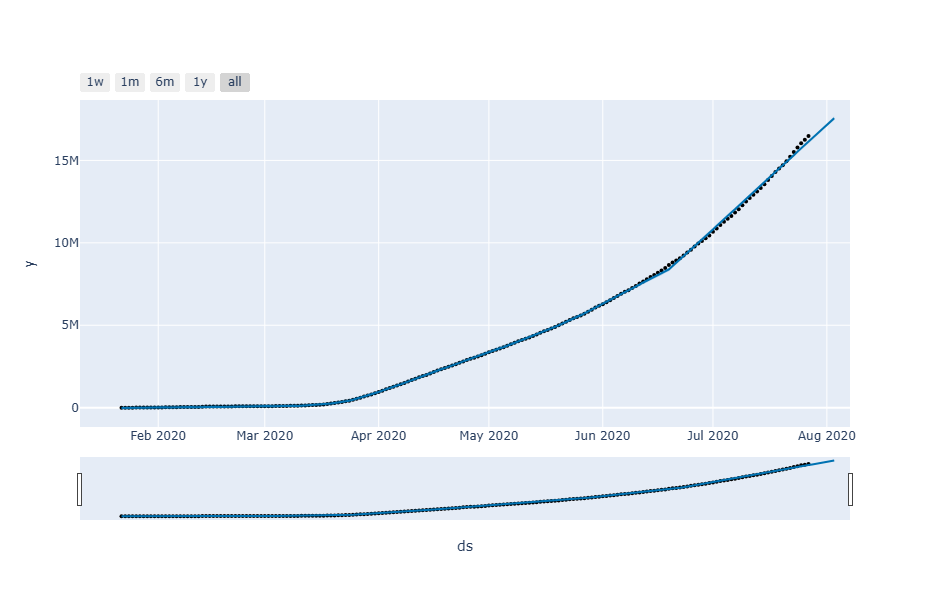

In [189]:
from prophet.plot import plot_plotly, plot_components_plotly

plot_plotly(model, forecast)

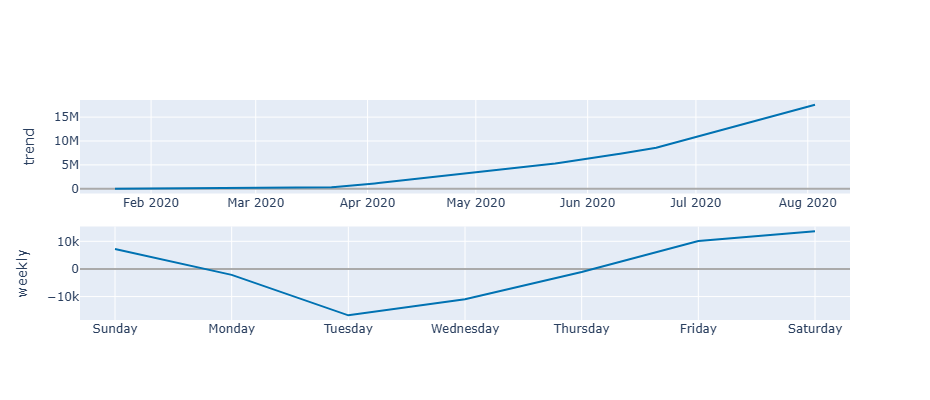

In [202]:
plot_components_plotly(model,forecast)

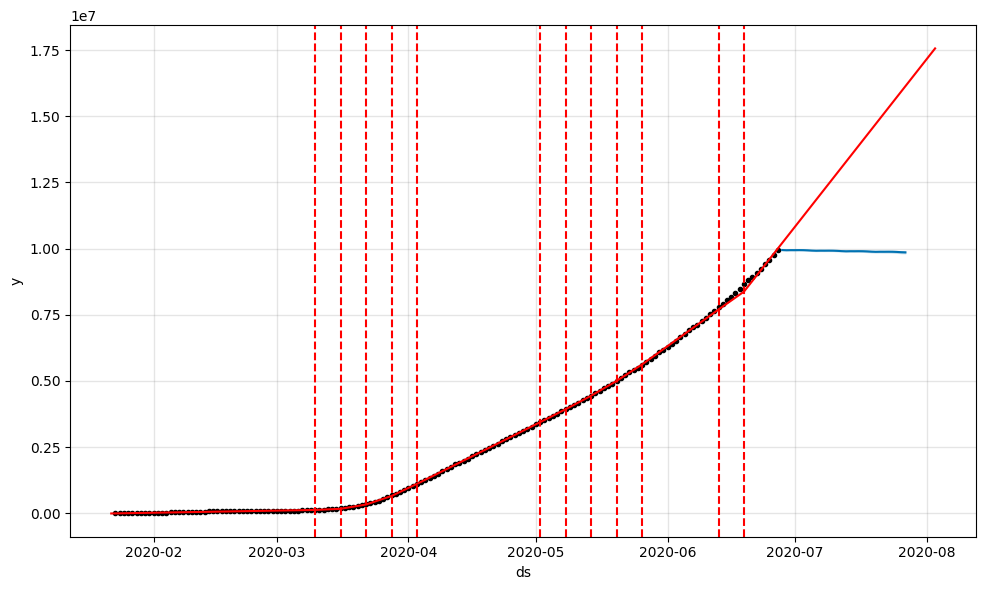

In [203]:
from prophet.plot import add_changepoints_to_plot
fig = m.plot(fcst_prophet_train)
a = add_changepoints_to_plot(fig.gca(),model,forecast)

#### hyperparameter tuning

In [116]:
changepoint_prior_scale_range = np.linspace(0.001, 0.5, num=5).round(5).tolist()
seasonality_prior_scale_range = np.linspace(0.01, 3, num=5).round(5).tolist()
seasonality_mode_options = ['additive', 'multiplicative']
changepoint_range_range = np.linspace(0.5, 0.95, num=5).round(5).tolist()


print(changepoint_prior_scale_range)
print(seasonality_prior_scale_range)
print(seasonality_mode_options)
print(changepoint_range_range)

[0.001, 0.12575, 0.2505, 0.37525, 0.5]
[0.01, 0.7575, 1.505, 2.2525, 3.0]
['additive', 'multiplicative']
[0.5, 0.6125, 0.725, 0.8375, 0.95]


In [117]:
import time
start_time = time.time()
import tqdm
import itertools
param_grid = {  
    "changepoint_prior_scale": changepoint_prior_scale_range,
    "seasonality_prior_scale": seasonality_prior_scale_range, 
    'seasonality_mode': seasonality_mode_options,
    'changepoint_range': changepoint_range_range,
}

# Generate all combinations of parameters
all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())]

rmses = [] 

# Use cross validation to evaluate all parameters
for params in all_params:
    m = Prophet(**params).fit(train_set)  # Fit model with given params
    df_cv = cross_validation(m, initial='120 days', period='30 days', horizon = '10 days', parallel='processes')
    df_p = performance_metrics(df_cv, rolling_window=3)
    rmses.append(df_p['rmse'].values[0])

# Find the best parameters
tuning_results = pd.DataFrame(all_params)
tuning_results['rmse'] = rmses

tuning_results.sort_values('rmse')

print("--- %s seconds ---" % (time.time() - start_time))

21:34:10 - cmdstanpy - INFO - Chain [1] start processing
21:34:10 - cmdstanpy - INFO - Chain [1] done processing
21:34:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:34:11 - cmdstanpy - INFO - Chain [1] start processing
21:34:11 - cmdstanpy - INFO - Chain [1] done processing
21:34:13 - cmdstanpy - INFO - Chain [1] start processing
21:34:14 - cmdstanpy - INFO - Chain [1] done processing
21:34:14 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:34:14 - cmdstanpy - INFO - Chain [1] start processing
21:34:14 - cmdstanpy - INFO - Chain [1] done processing
21:34:16 - cmdstanpy - INFO - Chain [1] start processing
21:34:16 - cmdstanpy - INFO - Chain [1] done processing
21:34:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abn

--- 640.6712856292725 seconds ---


In [118]:
len([v for v in itertools.product(*param_grid.values())])

250

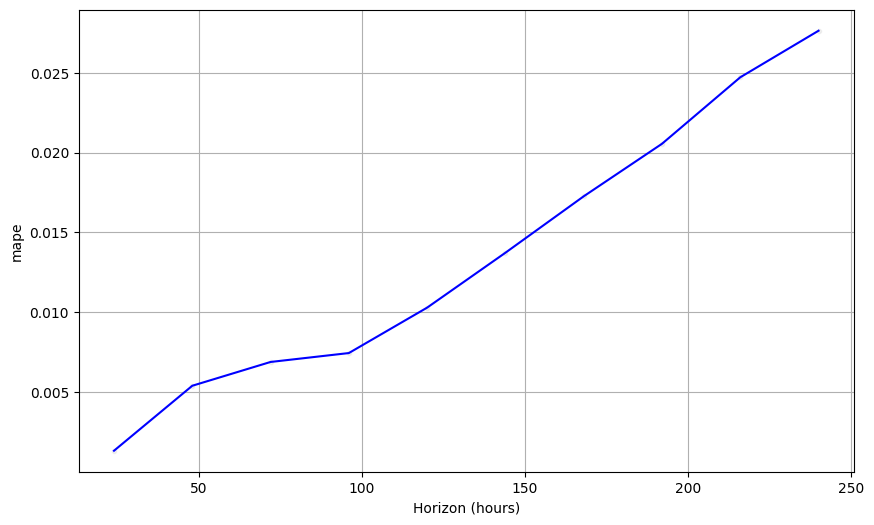

In [119]:
# Plot cross-validation metrics
fig = plot_cross_validation_metric(df_cv, metric='mape')
fig.show()

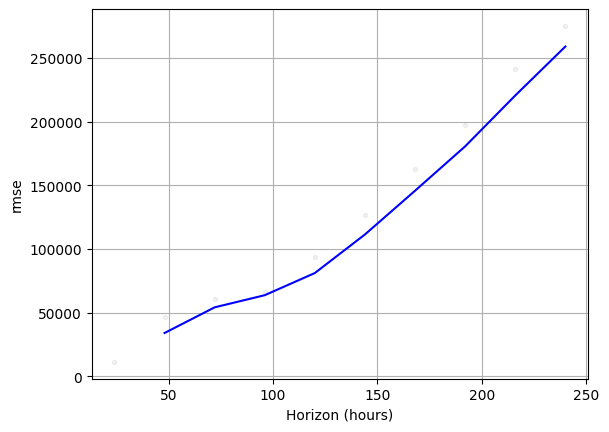

In [120]:
fig, ax = plt.subplots()
fig = plot_cross_validation_metric(df_cv, metric='rmse', rolling_window=0.2, ax=ax)

In [121]:
tuning_results.sort_values('rmse').head()

,changepoint_prior_scale,seasonality_prior_scale,seasonality_mode,changepoint_range,rmse
169,0.38,0.76,multiplicative,0.95,152889.05
209,0.50,0.01,multiplicative,0.95,153001.74
239,0.50,2.25,multiplicative,0.95,153015.60
229,0.50,1.50,multiplicative,0.95,153043.09
199,0.38,3.00,multiplicative,0.95,153057.75


#### Best parameter creation

In [123]:
dict(tuning_results.sort_values('rmse').reset_index(drop=True).iloc[0])

{'changepoint_prior_scale': 0.37525,
 'seasonality_prior_scale': 0.7575,
 'seasonality_mode': 'multiplicative',
 'changepoint_range': 0.95,
 'rmse': 152889.0496322461}

### Best model creation

21:44:52 - cmdstanpy - INFO - Chain [1] start processing
21:44:52 - cmdstanpy - INFO - Chain [1] done processing


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,weekly,weekly_lower,weekly_upper,additive_terms,additive_terms_lower,additive_terms_upper,yhat
0,2020-01-22,-225.36,-7324.59,7051.83,-225.36,-225.36,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,0.00,-225.06
1,2020-01-23,506.96,-6805.68,8016.62,506.96,506.96,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,507.31
2,2020-01-24,1239.28,-5973.49,9283.77,1239.28,1239.28,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1242.63
3,2020-01-25,1971.60,-5294.28,9335.65,1971.60,1971.60,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1976.59
4,2020-01-26,2703.91,-4481.11,10365.53,2703.91,2703.91,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2704.54


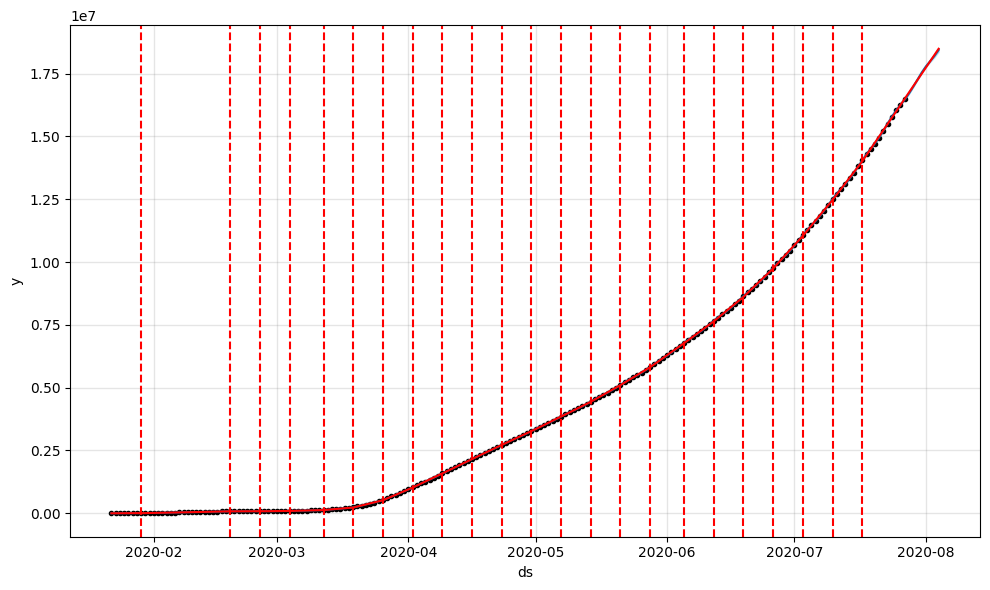

In [125]:
params_dictionary = dict(tuning_results.sort_values('rmse').reset_index(drop=True).drop('rmse',axis='columns').iloc[0])

model = Prophet( 
    changepoint_prior_scale = params_dictionary['changepoint_prior_scale'],
    seasonality_prior_scale = params_dictionary['seasonality_prior_scale'], 
    seasonality_mode= params_dictionary['seasonality_mode'],
    changepoint_range= params_dictionary['changepoint_range']
)

df_forecast = global_data[["Date", "Confirmed"]].copy()
df_forecast.columns = ["ds", "y"]

model = Prophet( **params_dictionary)
model.fit(df_forecast)

future = model.make_future_dataframe(periods=8)


# Make predictions
forecast = model.predict(future)
display(forecast.head())

fig2 = model.plot(forecast)
a = add_changepoints_to_plot(fig2.gca(), model, forecast)


fig = plot_components_plotly(model, forecast)
fig.show()


fig1=plot_plotly(model, forecast)
fig1.show()


### Serialize and Save Model 

In [127]:
# import joblib

# model_name = 'global_data_prophet_model.joblib'
# joblib.dump(model, model_name)
# print(f"Model saved as {model_name}")


In [128]:
# import json

# with open('global_data_model_params.json', 'w') as f:
#     json.dump(params_dictionary, f)


### Insight Aggregation

In [130]:
import joblib

In [131]:
loaded_model = joblib.load('global_data_prophet_model.joblib')
future = loaded_model.make_future_dataframe(periods=7)  
forecast = loaded_model.predict(future)

fig = plot_plotly(loaded_model, forecast)
fig.update_layout(
    title='7-Day COVID Forecast with Confidence Interval globally',
    width=1200,
    height=800
)
fig.show()


forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail(7).to_csv('global_data_weekly_forecast.csv', index=False)

### Creating Pipeline

In [133]:
# data_dict = {'americas':americas_data,
#              'Brazil': brazil_data,
#              'India':india_data,
#              'Spain':spain_data
#             }

In [134]:
data_dict['India'].head()

,Confirmed,Deaths,Recovered,Active,Confirmed_lag_1,Deaths_lag_1,Recovered_lag_1,Active_lag_1,day_of_week,month
Date,,,,,,,,,,
2020-01-22,0,0,0,0,NaN,NaN,NaN,NaN,2,1
2020-01-23,0,0,0,0,0.00,0.00,0.00,0.00,3,1
2020-01-24,0,0,0,0,0.00,0.00,0.00,0.00,4,1
2020-01-25,0,0,0,0,0.00,0.00,0.00,0.00,5,1
2020-01-26,0,0,0,0,0.00,0.00,0.00,0.00,6,1


In [135]:
changepoint_prior_scale_range = np.linspace(0.001, 0.5, num=5).round(5).tolist()
seasonality_prior_scale_range = np.linspace(0.01, 3, num=5).round(5).tolist()
seasonality_mode_options = ['additive', 'multiplicative']
changepoint_range_range = np.linspace(0.5, 0.95, num=5).round(5).tolist()


print(changepoint_prior_scale_range)
print(seasonality_prior_scale_range)
print(seasonality_mode_options)
print(changepoint_range_range)

[0.001, 0.12575, 0.2505, 0.37525, 0.5]
[0.01, 0.7575, 1.505, 2.2525, 3.0]
['additive', 'multiplicative']
[0.5, 0.6125, 0.725, 0.8375, 0.95]


In [298]:
data_dict = {
   'global': global_data,
   'americas': americas_data,
   'Brazil': brazil_data,
   'India': india_data,
   'Spain': spain_data,
}
for data in data_dict.values():
    print(data.columns)

Index(['Date', 'Confirmed', 'Deaths', 'Recovered', 'Active', 'Confirmed_lag_1',
       'Deaths_lag_1', 'Recovered_lag_1', 'Active_lag_1', 'day_of_week',
       'month'],
      dtype='object')
Index(['Confirmed', 'Deaths', 'Recovered', 'Active', 'Confirmed_lag_1',
       'Deaths_lag_1', 'Recovered_lag_1', 'Active_lag_1', 'day_of_week',
       'month'],
      dtype='object')
Index(['Confirmed', 'Deaths', 'Recovered', 'Active', 'Confirmed_lag_1',
       'Deaths_lag_1', 'Recovered_lag_1', 'Active_lag_1', 'day_of_week',
       'month'],
      dtype='object')
Index(['Confirmed', 'Deaths', 'Recovered', 'Active', 'Confirmed_lag_1',
       'Deaths_lag_1', 'Recovered_lag_1', 'Active_lag_1', 'day_of_week',
       'month'],
      dtype='object')
Index(['Confirmed', 'Deaths', 'Recovered', 'Active', 'Confirmed_lag_1',
       'Deaths_lag_1', 'Recovered_lag_1', 'Active_lag_1', 'day_of_week',
       'month'],
      dtype='object')


In [300]:
data_dict = {
   'global': global_data,
   'americas': americas_data.reset_index(),
   'Brazil': brazil_data.reset_index(),
   'India': india_data.reset_index(),
   'Spain': spain_data.reset_index(),
}
for data in data_dict.values():
    print(data.columns)

Index(['Date', 'Confirmed', 'Deaths', 'Recovered', 'Active', 'Confirmed_lag_1',
       'Deaths_lag_1', 'Recovered_lag_1', 'Active_lag_1', 'day_of_week',
       'month'],
      dtype='object')
Index(['Date', 'Confirmed', 'Deaths', 'Recovered', 'Active', 'Confirmed_lag_1',
       'Deaths_lag_1', 'Recovered_lag_1', 'Active_lag_1', 'day_of_week',
       'month'],
      dtype='object')
Index(['Date', 'Confirmed', 'Deaths', 'Recovered', 'Active', 'Confirmed_lag_1',
       'Deaths_lag_1', 'Recovered_lag_1', 'Active_lag_1', 'day_of_week',
       'month'],
      dtype='object')
Index(['Date', 'Confirmed', 'Deaths', 'Recovered', 'Active', 'Confirmed_lag_1',
       'Deaths_lag_1', 'Recovered_lag_1', 'Active_lag_1', 'day_of_week',
       'month'],
      dtype='object')
Index(['Date', 'Confirmed', 'Deaths', 'Recovered', 'Active', 'Confirmed_lag_1',
       'Deaths_lag_1', 'Recovered_lag_1', 'Active_lag_1', 'day_of_week',
       'month'],
      dtype='object')


21:44:53 - cmdstanpy - INFO - Chain [1] start processing


==================== global ====================
******************** Confirmed ********************


21:44:53 - cmdstanpy - INFO - Chain [1] done processing
21:44:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:44:53 - cmdstanpy - INFO - Chain [1] start processing
21:44:54 - cmdstanpy - INFO - Chain [1] done processing
21:44:57 - cmdstanpy - INFO - Chain [1] start processing
21:44:57 - cmdstanpy - INFO - Chain [1] done processing
21:44:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:44:57 - cmdstanpy - INFO - Chain [1] start processing
21:44:57 - cmdstanpy - INFO - Chain [1] done processing
21:45:00 - cmdstanpy - INFO - Chain [1] start processing
21:45:00 - cmdstanpy - INFO - Chain [1] done processing
21:45:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:45:00 - cmdstanpy - I

          ds   trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -225.36    -7282.58     7367.23      -225.36      -225.36   
1 2020-01-23  506.96    -7060.26     8590.40       506.96       506.96   
2 2020-01-24 1239.28    -6135.79     9229.03      1239.28      1239.28   
3 2020-01-25 1971.60    -5318.95     9681.42      1971.60      1971.60   
4 2020-01-26 2703.91    -4385.42     9733.66      2703.91      2703.91   

   multiplicative_terms  multiplicative_terms_lower  \
0                 -0.00                       -0.00   
1                  0.00                        0.00   
2                  0.00                        0.00   
3                  0.00                        0.00   
4                  0.00                        0.00   

   multiplicative_terms_upper  weekly  weekly_lower  weekly_upper  \
0                       -0.00   -0.00         -0.00         -0.00   
1                        0.00    0.00          0.00          0.00   
2                

21:54:45 - cmdstanpy - INFO - Chain [1] start processing
21:54:45 - cmdstanpy - INFO - Chain [1] done processing
21:54:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:54:45 - cmdstanpy - INFO - Chain [1] start processing
21:54:45 - cmdstanpy - INFO - Chain [1] done processing
21:54:48 - cmdstanpy - INFO - Chain [1] start processing
21:54:48 - cmdstanpy - INFO - Chain [1] done processing
21:54:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:54:48 - cmdstanpy - INFO - Chain [1] start processing
21:54:48 - cmdstanpy - INFO - Chain [1] done processing
21:54:51 - cmdstanpy - INFO - Chain [1] start processing
21:54:51 - cmdstanpy - INFO - Chain [1] done processing
21:54:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abn

          ds   trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -343.03    -1183.78      338.47      -343.03      -343.03   
1 2020-01-23 -266.21     -497.96     1113.08      -266.21      -266.21   
2 2020-01-24 -189.39     -132.56     1522.19      -189.39      -189.39   
3 2020-01-25 -112.57     -330.99     1291.50      -112.57      -112.57   
4 2020-01-26  -35.75    -1077.93      419.50       -35.75       -35.75   

   additive_terms  additive_terms_lower  additive_terms_upper  weekly  \
0          -52.47                -52.47                -52.47  -52.47   
1          560.17                560.17                560.17  560.17   
2          906.58                906.58                906.58  906.58   
3          625.21                625.21                625.21  625.21   
4         -331.19               -331.19               -331.19 -331.19   

   weekly_lower  weekly_upper  multiplicative_terms  \
0        -52.47        -52.47                  0.00   
1     

22:04:41 - cmdstanpy - INFO - Chain [1] start processing
22:04:41 - cmdstanpy - INFO - Chain [1] done processing


Model saved as global_Deaths_prophet_model.joblib
******************** Recovered ********************


22:04:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
22:04:41 - cmdstanpy - INFO - Chain [1] start processing
22:04:41 - cmdstanpy - INFO - Chain [1] done processing
22:04:44 - cmdstanpy - INFO - Chain [1] start processing
22:04:44 - cmdstanpy - INFO - Chain [1] done processing
22:04:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
22:04:44 - cmdstanpy - INFO - Chain [1] start processing
22:04:44 - cmdstanpy - INFO - Chain [1] done processing
22:04:47 - cmdstanpy - INFO - Chain [1] start processing
22:04:47 - cmdstanpy - INFO - Chain [1] done processing
22:04:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
22:04:47 - cmdstanpy - INFO - Chain [1] start processing
22:04:47 - cmdstanpy - 

          ds    trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -2894.91   -29253.70    19803.14     -2894.91     -2894.91   
1 2020-01-23 -2538.05   -23090.26    24501.88     -2538.05     -2538.05   
2 2020-01-24 -2181.19   -16786.53    29581.47     -2181.19     -2181.19   
3 2020-01-25 -1824.33   -18752.39    30626.76     -1824.33     -1824.33   
4 2020-01-26 -1467.48   -29530.92    18727.62     -1467.48     -1467.48   

   additive_terms  additive_terms_lower  additive_terms_upper   weekly  \
0        -2151.98              -2151.98              -2151.98 -2151.98   
1         4410.17               4410.17               4410.17  4410.17   
2         7447.75               7447.75               7447.75  7447.75   
3         8434.37               8434.37               8434.37  8434.37   
4        -4494.72              -4494.72              -4494.72 -4494.72   

   weekly_lower  weekly_upper  multiplicative_terms  \
0      -2151.98      -2151.98                  0.

22:14:26 - cmdstanpy - INFO - Chain [1] start processing
22:14:26 - cmdstanpy - INFO - Chain [1] done processing
22:14:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
22:14:26 - cmdstanpy - INFO - Chain [1] start processing


Model saved as global_Recovered_prophet_model.joblib
******************** Active ********************


22:14:26 - cmdstanpy - INFO - Chain [1] done processing
22:14:29 - cmdstanpy - INFO - Chain [1] start processing
22:14:29 - cmdstanpy - INFO - Chain [1] done processing
22:14:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
22:14:29 - cmdstanpy - INFO - Chain [1] start processing
22:14:29 - cmdstanpy - INFO - Chain [1] done processing
22:14:32 - cmdstanpy - INFO - Chain [1] start processing
22:14:32 - cmdstanpy - INFO - Chain [1] done processing
22:14:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
22:14:32 - cmdstanpy - INFO - Chain [1] start processing
22:14:33 - cmdstanpy - INFO - Chain [1] done processing
22:14:35 - cmdstanpy - INFO - Chain [1] start processing
22:14:35 - cmdstanpy - INFO - Chain [1] done processing
22:14:35 - cmdstanpy - ERROR - Chain [1] error: error during proces

          ds    trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -1616.88   -22610.98    20404.62     -1616.88     -1616.88   
1 2020-01-23  -583.29   -23657.19    21732.64      -583.29      -583.29   
2 2020-01-24   450.30   -21842.12    22678.88       450.30       450.30   
3 2020-01-25  1483.89   -20214.71    23898.64      1483.89      1483.89   
4 2020-01-26  2517.48   -17720.19    25224.91      2517.48      2517.48   

   multiplicative_terms  multiplicative_terms_lower  \
0                 -0.00                       -0.00   
1                 -0.00                       -0.00   
2                  0.00                        0.00   
3                  0.00                        0.00   
4                  0.00                        0.00   

   multiplicative_terms_upper  weekly  weekly_lower  weekly_upper  \
0                       -0.00   -0.00         -0.00         -0.00   
1                       -0.00   -0.00         -0.00         -0.00   
2          

22:24:32 - cmdstanpy - INFO - Chain [1] start processing
22:24:32 - cmdstanpy - INFO - Chain [1] done processing
22:24:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
22:24:32 - cmdstanpy - INFO - Chain [1] start processing
22:24:32 - cmdstanpy - INFO - Chain [1] done processing
22:24:34 - cmdstanpy - INFO - Chain [1] start processing
22:24:34 - cmdstanpy - INFO - Chain [1] done processing
22:24:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
22:24:34 - cmdstanpy - INFO - Chain [1] start processing
22:24:35 - cmdstanpy - INFO - Chain [1] done processing
22:24:37 - cmdstanpy - INFO - Chain [1] start processing
22:24:37 - cmdstanpy - INFO - Chain [1] done processing
22:24:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abn

          ds   trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -246.61    -5811.05     5414.47      -246.61      -246.61   
1 2020-01-23 -184.94    -5822.88     5282.85      -184.94      -184.94   
2 2020-01-24 -123.27    -6067.45     5312.29      -123.27      -123.27   
3 2020-01-25  -61.59    -6181.49     5448.54       -61.59       -61.59   
4 2020-01-26    0.08    -5452.60     5484.39         0.08         0.08   

   multiplicative_terms  multiplicative_terms_lower  \
0                 -0.00                       -0.00   
1                  0.00                        0.00   
2                  0.00                        0.00   
3                  0.00                        0.00   
4                  0.00                        0.00   

   multiplicative_terms_upper  weekly  weekly_lower  weekly_upper  \
0                       -0.00   -0.00         -0.00         -0.00   
1                        0.00    0.00          0.00          0.00   
2                

22:34:28 - cmdstanpy - INFO - Chain [1] start processing
22:34:28 - cmdstanpy - INFO - Chain [1] done processing
22:34:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
22:34:28 - cmdstanpy - INFO - Chain [1] start processing
22:34:29 - cmdstanpy - INFO - Chain [1] done processing
22:34:31 - cmdstanpy - INFO - Chain [1] start processing
22:34:31 - cmdstanpy - INFO - Chain [1] done processing
22:34:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
22:34:31 - cmdstanpy - INFO - Chain [1] start processing
22:34:31 - cmdstanpy - INFO - Chain [1] done processing
22:34:34 - cmdstanpy - INFO - Chain [1] start processing
22:34:34 - cmdstanpy - INFO - Chain [1] done processing
22:34:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abn

          ds   trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -177.99     -790.51      311.20      -177.99      -177.99   
1 2020-01-23 -151.69     -294.64      877.72      -151.69      -151.69   
2 2020-01-24 -125.39     -134.37     1028.92      -125.39      -125.39   
3 2020-01-25  -99.09     -260.80      864.36       -99.09       -99.09   
4 2020-01-26  -72.80     -896.86      288.13       -72.80       -72.80   

   additive_terms  additive_terms_lower  additive_terms_upper  weekly  \
0          -61.45                -61.45                -61.45  -61.45   
1          445.84                445.84                445.84  445.84   
2          595.89                595.89                595.89  595.89   
3          398.50                398.50                398.50  398.50   
4         -251.43               -251.43               -251.43 -251.43   

   weekly_lower  weekly_upper  multiplicative_terms  \
0        -61.45        -61.45                  0.00   
1     

22:44:33 - cmdstanpy - INFO - Chain [1] start processing
22:44:33 - cmdstanpy - INFO - Chain [1] done processing
22:44:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
22:44:33 - cmdstanpy - INFO - Chain [1] start processing
22:44:33 - cmdstanpy - INFO - Chain [1] done processing
22:44:36 - cmdstanpy - INFO - Chain [1] start processing
22:44:36 - cmdstanpy - INFO - Chain [1] done processing
22:44:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
22:44:36 - cmdstanpy - INFO - Chain [1] start processing
22:44:36 - cmdstanpy - INFO - Chain [1] done processing
22:44:39 - cmdstanpy - INFO - Chain [1] start processing
22:44:39 - cmdstanpy - INFO - Chain [1] done processing
22:44:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abn

          ds   trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -266.36   -24524.16    18198.72      -266.36      -266.36   
1 2020-01-23 -258.51   -21510.09    22366.07      -258.51      -258.51   
2 2020-01-24 -250.65   -18251.47    25427.69      -250.65      -250.65   
3 2020-01-25 -242.80   -16651.18    24723.08      -242.80      -242.80   
4 2020-01-26 -234.95   -23934.52    18738.45      -234.95      -234.95   

   additive_terms  additive_terms_lower  additive_terms_upper   weekly  \
0        -2157.08              -2157.08              -2157.08 -2157.08   
1         1621.81               1621.81               1621.81  1621.81   
2         3153.38               3153.38               3153.38  3153.38   
3         4668.84               4668.84               4668.84  4668.84   
4        -3417.19              -3417.19              -3417.19 -3417.19   

   weekly_lower  weekly_upper  multiplicative_terms  \
0      -2157.08      -2157.08                  0.00   


22:54:25 - cmdstanpy - INFO - Chain [1] start processing
22:54:25 - cmdstanpy - INFO - Chain [1] done processing
22:54:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
22:54:25 - cmdstanpy - INFO - Chain [1] start processing
22:54:25 - cmdstanpy - INFO - Chain [1] done processing
22:54:28 - cmdstanpy - INFO - Chain [1] start processing
22:54:28 - cmdstanpy - INFO - Chain [1] done processing
22:54:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
22:54:28 - cmdstanpy - INFO - Chain [1] start processing
22:54:28 - cmdstanpy - INFO - Chain [1] done processing
22:54:31 - cmdstanpy - INFO - Chain [1] start processing
22:54:31 - cmdstanpy - INFO - Chain [1] done processing
22:54:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abn

          ds   trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -264.39   -23119.41    20367.75      -264.39      -264.39   
1 2020-01-23 -252.71   -19666.57    21592.87      -252.71      -252.71   
2 2020-01-24 -241.03   -22706.15    21925.09      -241.03      -241.03   
3 2020-01-25 -229.35   -21991.36    21917.52      -229.35      -229.35   
4 2020-01-26 -217.68   -21915.22    21317.21      -217.68      -217.68   

   multiplicative_terms  multiplicative_terms_lower  \
0                 -0.00                       -0.00   
1                  0.00                        0.00   
2                  0.00                        0.00   
3                  0.00                        0.00   
4                  0.00                        0.00   

   multiplicative_terms_upper  weekly  weekly_lower  weekly_upper  \
0                       -0.00   -0.00         -0.00         -0.00   
1                        0.00    0.00          0.00          0.00   
2                

23:04:21 - cmdstanpy - INFO - Chain [1] start processing
23:04:21 - cmdstanpy - INFO - Chain [1] done processing
23:04:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
23:04:21 - cmdstanpy - INFO - Chain [1] start processing
23:04:21 - cmdstanpy - INFO - Chain [1] done processing
23:04:24 - cmdstanpy - INFO - Chain [1] start processing
23:04:24 - cmdstanpy - INFO - Chain [1] done processing
23:04:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
23:04:24 - cmdstanpy - INFO - Chain [1] start processing
23:04:25 - cmdstanpy - INFO - Chain [1] done processing
23:04:27 - cmdstanpy - INFO - Chain [1] start processing
23:04:27 - cmdstanpy - INFO - Chain [1] done processing
23:04:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abn

          ds  trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -21.24    -5100.57     5345.04       -21.24       -21.24   
1 2020-01-23 -20.44    -5359.36     4948.46       -20.44       -20.44   
2 2020-01-24 -19.64    -5144.86     4919.95       -19.64       -19.64   
3 2020-01-25 -18.85    -5151.49     5101.53       -18.85       -18.85   
4 2020-01-26 -18.05    -5079.61     5092.59       -18.05       -18.05   

   multiplicative_terms  multiplicative_terms_lower  \
0                 -0.00                       -0.00   
1                  0.00                        0.00   
2                  0.01                        0.01   
3                  0.01                        0.01   
4                 -0.00                       -0.00   

   multiplicative_terms_upper  weekly  weekly_lower  weekly_upper  \
0                       -0.00   -0.00         -0.00         -0.00   
1                        0.00    0.00          0.00          0.00   
2                      

23:14:11 - cmdstanpy - INFO - Chain [1] start processing
23:14:11 - cmdstanpy - INFO - Chain [1] done processing
23:14:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
23:14:11 - cmdstanpy - INFO - Chain [1] start processing
23:14:11 - cmdstanpy - INFO - Chain [1] done processing
23:14:13 - cmdstanpy - INFO - Chain [1] start processing
23:14:13 - cmdstanpy - INFO - Chain [1] done processing
23:14:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
23:14:14 - cmdstanpy - INFO - Chain [1] start processing
23:14:14 - cmdstanpy - INFO - Chain [1] done processing
23:14:16 - cmdstanpy - INFO - Chain [1] start processing
23:14:17 - cmdstanpy - INFO - Chain [1] done processing
23:14:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abn

          ds  trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22   0.19     -126.34      118.67         0.19         0.19   
1 2020-01-23   0.13     -117.87      113.99         0.13         0.13   
2 2020-01-24   0.08     -118.11      117.57         0.08         0.08   
3 2020-01-25   0.02     -131.17      121.73         0.02         0.02   
4 2020-01-26  -0.03     -116.91      112.94        -0.03        -0.03   

   multiplicative_terms  multiplicative_terms_lower  \
0                 -0.00                       -0.00   
1                  0.00                        0.00   
2                  0.01                        0.01   
3                  0.01                        0.01   
4                 -0.00                       -0.00   

   multiplicative_terms_upper  weekly  weekly_lower  weekly_upper  \
0                       -0.00   -0.00         -0.00         -0.00   
1                        0.00    0.00          0.00          0.00   
2                      

23:24:11 - cmdstanpy - INFO - Chain [1] start processing
23:24:11 - cmdstanpy - INFO - Chain [1] done processing
23:24:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
23:24:11 - cmdstanpy - INFO - Chain [1] start processing
23:24:11 - cmdstanpy - INFO - Chain [1] done processing
23:24:14 - cmdstanpy - INFO - Chain [1] start processing
23:24:14 - cmdstanpy - INFO - Chain [1] done processing
23:24:14 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
23:24:14 - cmdstanpy - INFO - Chain [1] start processing
23:24:14 - cmdstanpy - INFO - Chain [1] done processing
23:24:16 - cmdstanpy - INFO - Chain [1] start processing
23:24:16 - cmdstanpy - INFO - Chain [1] done processing
23:24:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abn

          ds  trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22   5.06   -16311.08    13522.84         5.06         5.06   
1 2020-01-23   1.42   -12758.95    17783.50         1.42         1.42   
2 2020-01-24  -2.23   -12722.95    18329.28        -2.23        -2.23   
3 2020-01-25  -5.87   -13398.91    16946.02        -5.87        -5.87   
4 2020-01-26  -9.52   -17137.99    12751.85        -9.52        -9.52   

   additive_terms  additive_terms_lower  additive_terms_upper   weekly  \
0        -1423.97              -1423.97              -1423.97 -1423.97   
1         2262.71               2262.71               2262.71  2262.71   
2         3132.17               3132.17               3132.17  3132.17   
3         1882.05               1882.05               1882.05  1882.05   
4        -2058.15              -2058.15              -2058.15 -2058.15   

   weekly_lower  weekly_upper  multiplicative_terms  \
0      -1423.97      -1423.97                  0.00   
1     

23:34:42 - cmdstanpy - INFO - Chain [1] start processing
23:34:43 - cmdstanpy - INFO - Chain [1] done processing
23:34:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
23:34:43 - cmdstanpy - INFO - Chain [1] start processing
23:34:43 - cmdstanpy - INFO - Chain [1] done processing
23:34:45 - cmdstanpy - INFO - Chain [1] start processing
23:34:45 - cmdstanpy - INFO - Chain [1] done processing
23:34:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
23:34:45 - cmdstanpy - INFO - Chain [1] start processing
23:34:46 - cmdstanpy - INFO - Chain [1] done processing
23:34:48 - cmdstanpy - INFO - Chain [1] start processing
23:34:48 - cmdstanpy - INFO - Chain [1] done processing
23:34:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abn

          ds   trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -368.95   -14414.85    15550.48      -368.95      -368.95   
1 2020-01-23 -356.41   -16138.36    13932.60      -356.41      -356.41   
2 2020-01-24 -343.88   -12715.46    15531.45      -343.88      -343.88   
3 2020-01-25 -331.34   -12308.26    17123.75      -331.34      -331.34   
4 2020-01-26 -318.81   -13326.93    16474.04      -318.81      -318.81   

   additive_terms  additive_terms_lower  additive_terms_upper  weekly  \
0          583.05                583.05                583.05  583.05   
1         -659.38               -659.38               -659.38 -659.38   
2         1297.01               1297.01               1297.01 1297.01   
3         2570.96               2570.96               2570.96 2570.96   
4         1949.40               1949.40               1949.40 1949.40   

   weekly_lower  weekly_upper  multiplicative_terms  \
0        583.05        583.05                  0.00   
1     

00:57:36 - cmdstanpy - INFO - Chain [1] start processing
00:57:36 - cmdstanpy - INFO - Chain [1] done processing
00:57:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
00:57:36 - cmdstanpy - INFO - Chain [1] start processing


Model saved as Brazil_Active_prophet_model.joblib
==================== India ====================
******************** Confirmed ********************


00:57:36 - cmdstanpy - INFO - Chain [1] done processing
00:57:38 - cmdstanpy - INFO - Chain [1] start processing
00:57:39 - cmdstanpy - INFO - Chain [1] done processing
00:57:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
00:57:39 - cmdstanpy - INFO - Chain [1] start processing
00:57:39 - cmdstanpy - INFO - Chain [1] done processing
00:57:41 - cmdstanpy - INFO - Chain [1] start processing
00:57:41 - cmdstanpy - INFO - Chain [1] done processing
00:57:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
00:57:41 - cmdstanpy - INFO - Chain [1] start processing
00:57:42 - cmdstanpy - INFO - Chain [1] done processing
00:57:44 - cmdstanpy - INFO - Chain [1] start processing
00:57:44 - cmdstanpy - INFO - Chain [1] done processing
00:57:44 - cmdstanpy - ERROR - Chain [1] error: error during proces

          ds  trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -48.12    -3122.93     1752.86       -48.12       -48.12   
1 2020-01-23 -44.29    -2415.28     2476.08       -44.29       -44.29   
2 2020-01-24 -40.47    -1978.29     3374.05       -40.47       -40.47   
3 2020-01-25 -36.64    -2015.87     3037.19       -36.64       -36.64   
4 2020-01-26 -32.81    -2113.21     3043.44       -32.81       -32.81   

   additive_terms  additive_terms_lower  additive_terms_upper  weekly  \
0         -647.27               -647.27               -647.27 -647.27   
1          104.10                104.10                104.10  104.10   
2          730.01                730.01                730.01  730.01   
3          514.33                514.33                514.33  514.33   
4          465.80                465.80                465.80  465.80   

   weekly_lower  weekly_upper  multiplicative_terms  \
0       -647.27       -647.27                  0.00   
1        104

01:07:37 - cmdstanpy - INFO - Chain [1] start processing
01:07:37 - cmdstanpy - INFO - Chain [1] done processing
01:07:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
01:07:37 - cmdstanpy - INFO - Chain [1] start processing
01:07:37 - cmdstanpy - INFO - Chain [1] done processing
01:07:40 - cmdstanpy - INFO - Chain [1] start processing
01:07:40 - cmdstanpy - INFO - Chain [1] done processing
01:07:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
01:07:40 - cmdstanpy - INFO - Chain [1] start processing
01:07:40 - cmdstanpy - INFO - Chain [1] done processing
01:07:42 - cmdstanpy - INFO - Chain [1] start processing
01:07:42 - cmdstanpy - INFO - Chain [1] done processing
01:07:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abn

          ds  trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22  -4.26      -99.96      139.91        -4.26        -4.26   
1 2020-01-23  -3.91      -97.79      137.94        -3.91        -3.91   
2 2020-01-24  -3.55      -97.49      142.96        -3.55        -3.55   
3 2020-01-25  -3.20     -124.32      118.03        -3.20        -3.20   
4 2020-01-26  -2.85     -145.79       98.50        -2.85        -2.85   

   additive_terms  additive_terms_lower  additive_terms_upper  weekly  \
0           21.61                 21.61                 21.61   21.61   
1           22.41                 22.41                 22.41   22.41   
2           20.53                 20.53                 20.53   20.53   
3           -2.56                 -2.56                 -2.56   -2.56   
4          -23.99                -23.99                -23.99  -23.99   

   weekly_lower  weekly_upper  multiplicative_terms  \
0         21.61         21.61                  0.00   
1         22

01:17:19 - cmdstanpy - INFO - Chain [1] start processing
01:17:19 - cmdstanpy - INFO - Chain [1] done processing
01:17:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
01:17:19 - cmdstanpy - INFO - Chain [1] start processing
01:17:19 - cmdstanpy - INFO - Chain [1] done processing
01:17:21 - cmdstanpy - INFO - Chain [1] start processing
01:17:21 - cmdstanpy - INFO - Chain [1] done processing
01:17:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
01:17:22 - cmdstanpy - INFO - Chain [1] start processing
01:17:22 - cmdstanpy - INFO - Chain [1] done processing
01:17:24 - cmdstanpy - INFO - Chain [1] start processing
01:17:24 - cmdstanpy - INFO - Chain [1] done processing
01:17:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abn

          ds  trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -73.85    -3632.86     2156.75       -73.85       -73.85   
1 2020-01-23 -62.28    -2467.88     2946.58       -62.28       -62.28   
2 2020-01-24 -50.72    -2023.82     3146.47       -50.72       -50.72   
3 2020-01-25 -39.15    -2046.44     3570.88       -39.15       -39.15   
4 2020-01-26 -27.59    -2992.86     2662.59       -27.59       -27.59   

   additive_terms  additive_terms_lower  additive_terms_upper  weekly  \
0         -760.83               -760.83               -760.83 -760.83   
1          257.00                257.00                257.00  257.00   
2          625.85                625.85                625.85  625.85   
3          578.86                578.86                578.86  578.86   
4           92.37                 92.37                 92.37   92.37   

   weekly_lower  weekly_upper  multiplicative_terms  \
0       -760.83       -760.83                  0.00   
1        257

01:26:57 - cmdstanpy - INFO - Chain [1] start processing
01:26:57 - cmdstanpy - INFO - Chain [1] done processing
01:26:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
01:26:57 - cmdstanpy - INFO - Chain [1] start processing
01:26:58 - cmdstanpy - INFO - Chain [1] done processing
01:27:00 - cmdstanpy - INFO - Chain [1] start processing
01:27:00 - cmdstanpy - INFO - Chain [1] done processing
01:27:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
01:27:01 - cmdstanpy - INFO - Chain [1] start processing
01:27:01 - cmdstanpy - INFO - Chain [1] done processing
01:27:04 - cmdstanpy - INFO - Chain [1] start processing
01:27:04 - cmdstanpy - INFO - Chain [1] done processing
01:27:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abn

          ds  trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -14.96    -1721.45     1793.23       -14.96       -14.96   
1 2020-01-23 -14.15    -1744.75     1494.90       -14.15       -14.15   
2 2020-01-24 -13.35    -1706.85     1790.71       -13.35       -13.35   
3 2020-01-25 -12.54    -1836.67     1643.30       -12.54       -12.54   
4 2020-01-26 -11.73    -1299.41     2161.52       -11.73       -11.73   

   additive_terms  additive_terms_lower  additive_terms_upper  weekly  \
0           92.51                 92.51                 92.51   92.51   
1         -174.61               -174.61               -174.61 -174.61   
2           83.01                 83.01                 83.01   83.01   
3          -62.15                -62.15                -62.15  -62.15   
4          397.63                397.63                397.63  397.63   

   weekly_lower  weekly_upper  multiplicative_terms  \
0         92.51         92.51                  0.00   
1       -174

01:36:44 - cmdstanpy - INFO - Chain [1] start processing
01:36:44 - cmdstanpy - INFO - Chain [1] done processing
01:36:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.


Model saved as India_Active_prophet_model.joblib
==================== Spain ====================
******************** Confirmed ********************


01:36:44 - cmdstanpy - INFO - Chain [1] start processing
01:36:44 - cmdstanpy - INFO - Chain [1] done processing
01:36:46 - cmdstanpy - INFO - Chain [1] start processing
01:36:47 - cmdstanpy - INFO - Chain [1] done processing
01:36:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
01:36:47 - cmdstanpy - INFO - Chain [1] start processing
01:36:47 - cmdstanpy - INFO - Chain [1] done processing
01:36:49 - cmdstanpy - INFO - Chain [1] start processing
01:36:49 - cmdstanpy - INFO - Chain [1] done processing
01:36:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
01:36:49 - cmdstanpy - INFO - Chain [1] start processing
01:36:50 - cmdstanpy - INFO - Chain [1] done processing
01:36:52 - cmdstanpy - INFO - Chain [1] start processing
01:36:52 - cmdstanpy - INFO - Chain [1] done processing
01:36:52 -

          ds  trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -29.24    -1401.59     1522.40       -29.24       -29.24   
1 2020-01-23 -27.83    -1040.37     1757.41       -27.83       -27.83   
2 2020-01-24 -26.42    -1319.49     1587.16       -26.42       -26.42   
3 2020-01-25 -25.01    -1511.01     1362.33       -25.01       -25.01   
4 2020-01-26 -23.60    -1662.86     1242.38       -23.60       -23.60   

   additive_terms  additive_terms_lower  additive_terms_upper  weekly  \
0           21.82                 21.82                 21.82   21.82   
1          382.02                382.02                382.02  382.02   
2          212.40                212.40                212.40  212.40   
3           14.56                 14.56                 14.56   14.56   
4         -228.77               -228.77               -228.77 -228.77   

   weekly_lower  weekly_upper  multiplicative_terms  \
0         21.82         21.82                  0.00   
1        382

01:46:46 - cmdstanpy - INFO - Chain [1] start processing
01:46:46 - cmdstanpy - INFO - Chain [1] done processing
01:46:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
01:46:46 - cmdstanpy - INFO - Chain [1] start processing
01:46:46 - cmdstanpy - INFO - Chain [1] done processing
01:46:49 - cmdstanpy - INFO - Chain [1] start processing
01:46:49 - cmdstanpy - INFO - Chain [1] done processing
01:46:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
01:46:49 - cmdstanpy - INFO - Chain [1] start processing
01:46:49 - cmdstanpy - INFO - Chain [1] done processing
01:46:51 - cmdstanpy - INFO - Chain [1] start processing
01:46:51 - cmdstanpy - INFO - Chain [1] done processing
01:46:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abn

          ds  trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22  -0.87     -286.40      286.27        -0.87        -0.87   
1 2020-01-23  -0.96     -282.44      282.45        -0.96        -0.96   
2 2020-01-24  -1.04     -300.48      288.88        -1.04        -1.04   
3 2020-01-25  -1.13     -280.00      299.47        -1.13        -1.13   
4 2020-01-26  -1.21     -319.15      291.06        -1.21        -1.21   

   multiplicative_terms  multiplicative_terms_lower  \
0                 -0.00                       -0.00   
1                 -0.00                       -0.00   
2                  0.00                        0.00   
3                  0.00                        0.00   
4                  0.00                        0.00   

   multiplicative_terms_upper  weekly  weekly_lower  weekly_upper  \
0                       -0.00   -0.00         -0.00         -0.00   
1                       -0.00   -0.00         -0.00         -0.00   
2                      

07:44:43 - cmdstanpy - INFO - Chain [1] start processing
07:44:43 - cmdstanpy - INFO - Chain [1] done processing
07:44:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
07:44:43 - cmdstanpy - INFO - Chain [1] start processing


Model saved as Spain_Deaths_prophet_model.joblib
******************** Recovered ********************


07:44:43 - cmdstanpy - INFO - Chain [1] done processing
07:44:46 - cmdstanpy - INFO - Chain [1] start processing
07:44:46 - cmdstanpy - INFO - Chain [1] done processing
07:44:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
07:44:46 - cmdstanpy - INFO - Chain [1] start processing
07:44:46 - cmdstanpy - INFO - Chain [1] done processing
07:44:48 - cmdstanpy - INFO - Chain [1] start processing
07:44:48 - cmdstanpy - INFO - Chain [1] done processing
07:44:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
07:44:48 - cmdstanpy - INFO - Chain [1] start processing
07:44:49 - cmdstanpy - INFO - Chain [1] done processing
07:44:51 - cmdstanpy - INFO - Chain [1] start processing
07:44:51 - cmdstanpy - INFO - Chain [1] done processing
07:44:51 - cmdstanpy - ERROR - Chain [1] error: error during proces

          ds  trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -17.53     -729.13      683.69       -17.53       -17.53   
1 2020-01-23 -16.93     -574.95      880.84       -16.93       -16.93   
2 2020-01-24 -16.33     -709.78      692.17       -16.33       -16.33   
3 2020-01-25 -15.73     -622.35      802.80       -15.73       -15.73   
4 2020-01-26 -15.13     -668.45      718.89       -15.13       -15.13   

   additive_terms  additive_terms_lower  additive_terms_upper  weekly  \
0           14.31                 14.31                 14.31   14.31   
1          156.81                156.81                156.81  156.81   
2            0.72                  0.72                  0.72    0.72   
3           93.33                 93.33                 93.33   93.33   
4            5.65                  5.65                  5.65    5.65   

   weekly_lower  weekly_upper  multiplicative_terms  \
0         14.31         14.31                  0.00   
1        156

07:54:55 - cmdstanpy - INFO - Chain [1] start processing
07:54:55 - cmdstanpy - INFO - Chain [1] done processing
07:54:58 - cmdstanpy - INFO - Chain [1] start processing
07:54:58 - cmdstanpy - INFO - Chain [1] done processing
07:55:01 - cmdstanpy - INFO - Chain [1] start processing
07:55:01 - cmdstanpy - INFO - Chain [1] done processing
07:55:03 - cmdstanpy - INFO - Chain [1] start processing
07:55:04 - cmdstanpy - INFO - Chain [1] done processing
07:55:06 - cmdstanpy - INFO - Chain [1] start processing
07:55:06 - cmdstanpy - INFO - Chain [1] done processing
07:55:09 - cmdstanpy - INFO - Chain [1] start processing
07:55:09 - cmdstanpy - INFO - Chain [1] done processing
07:55:11 - cmdstanpy - INFO - Chain [1] start processing
07:55:11 - cmdstanpy - INFO - Chain [1] done processing
07:55:14 - cmdstanpy - INFO - Chain [1] start processing
07:55:14 - cmdstanpy - INFO - Chain [1] done processing
07:55:16 - cmdstanpy - INFO - Chain [1] start processing
07:55:16 - cmdstanpy - INFO - Chain [1]

          ds  trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0 2020-01-22 -24.22    -1642.44     1584.80       -24.22       -24.22   
1 2020-01-23 -23.37    -1467.20     1800.86       -23.37       -23.37   
2 2020-01-24 -22.51    -1581.71     1775.02       -22.51       -22.51   
3 2020-01-25 -21.66    -1853.03     1406.08       -21.66       -21.66   
4 2020-01-26 -20.80    -1924.66     1390.49       -20.80       -20.80   

   additive_terms  additive_terms_lower  additive_terms_upper  weekly  \
0           30.27                 30.27                 30.27   30.27   
1          238.51                238.51                238.51  238.51   
2          157.06                157.06                157.06  157.06   
3         -124.12               -124.12               -124.12 -124.12   
4         -265.09               -265.09               -265.09 -265.09   

   weekly_lower  weekly_upper  multiplicative_terms  \
0         30.27         30.27                  0.00   
1        238

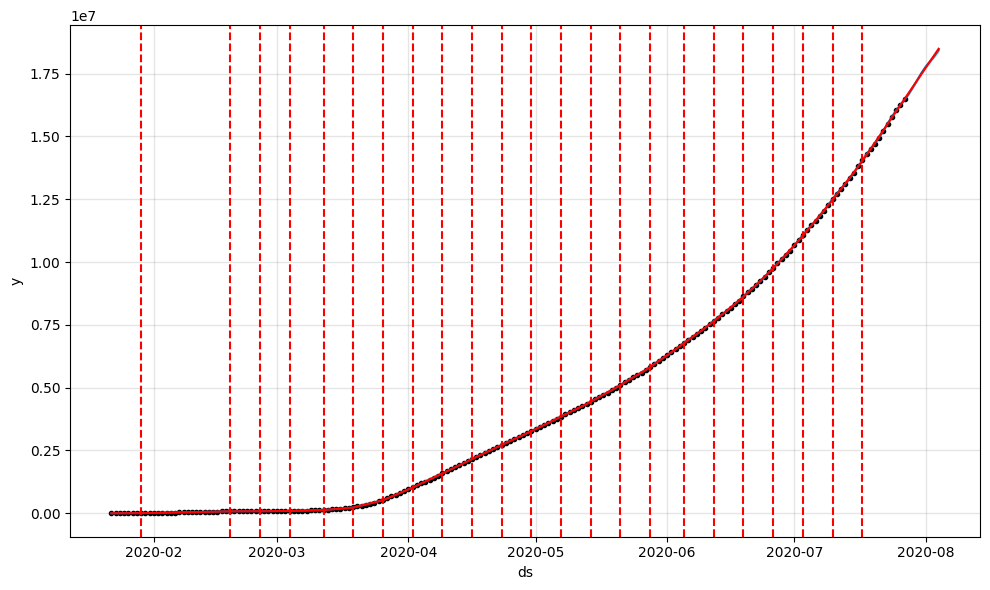

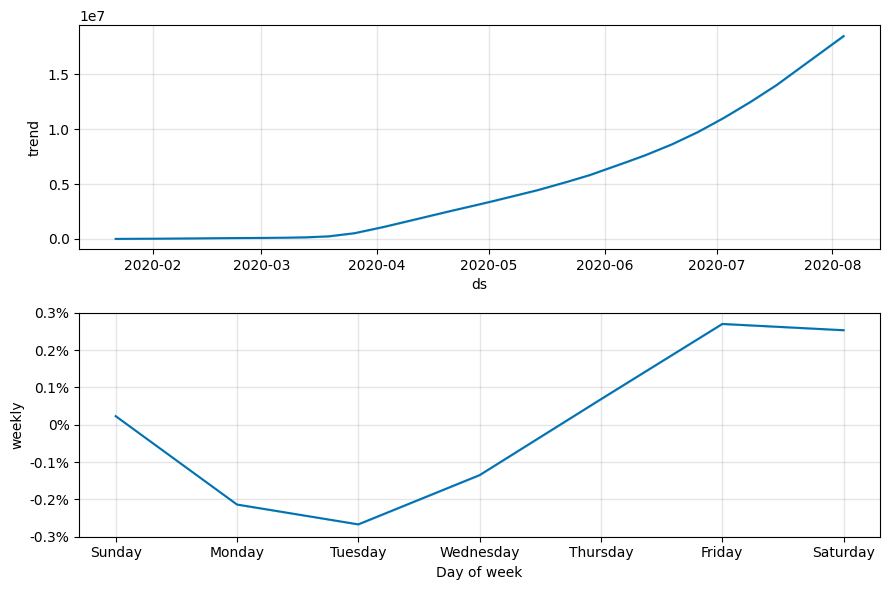

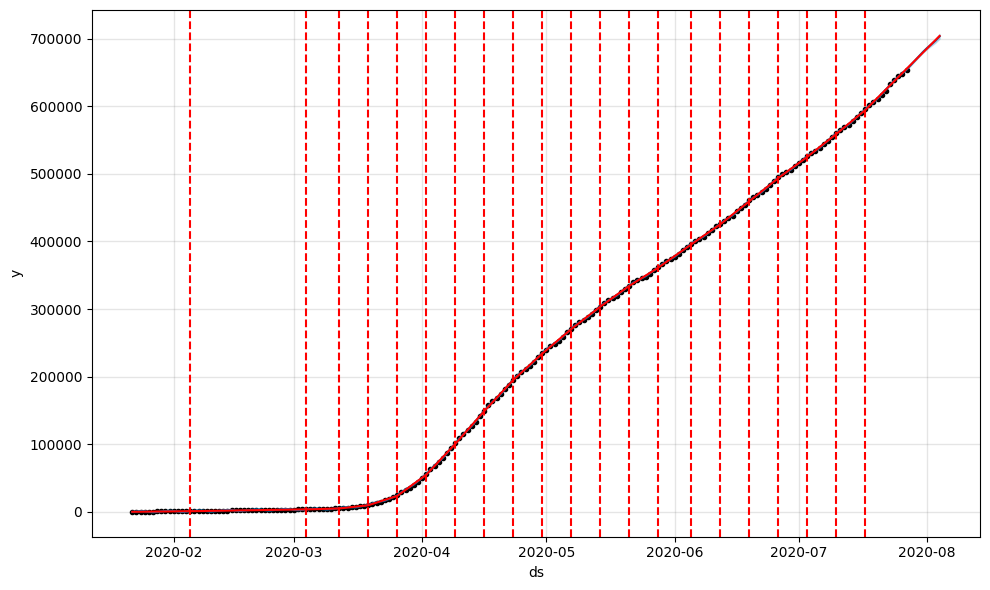

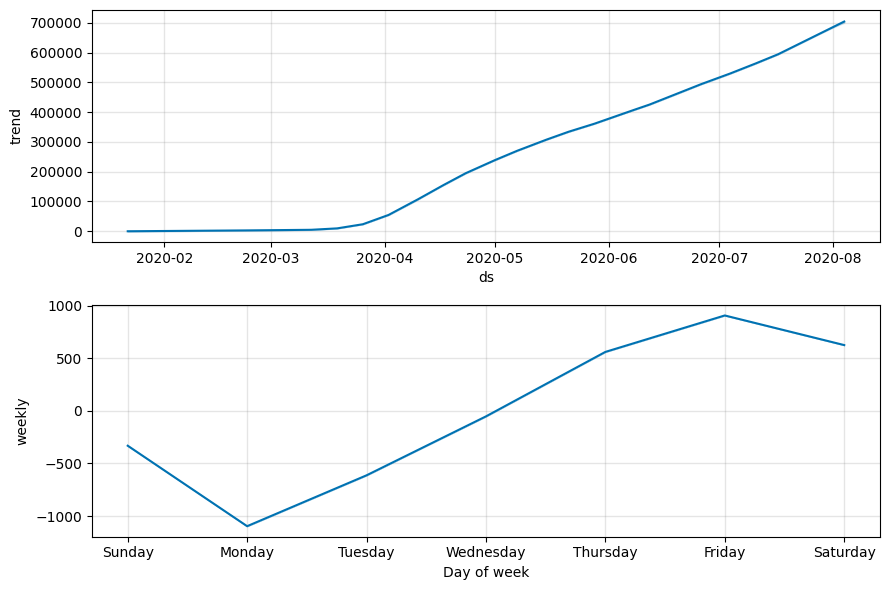

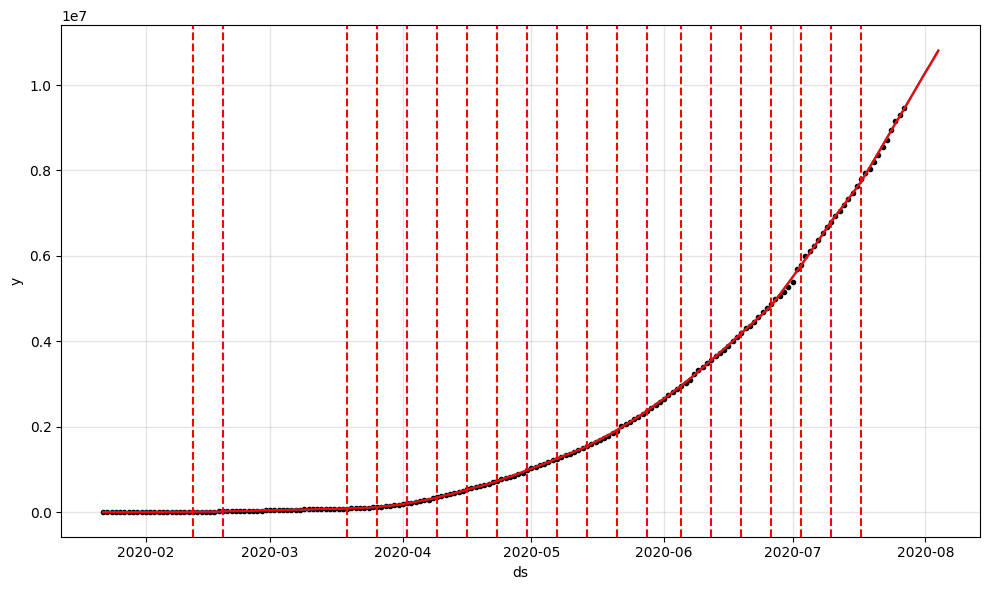

...

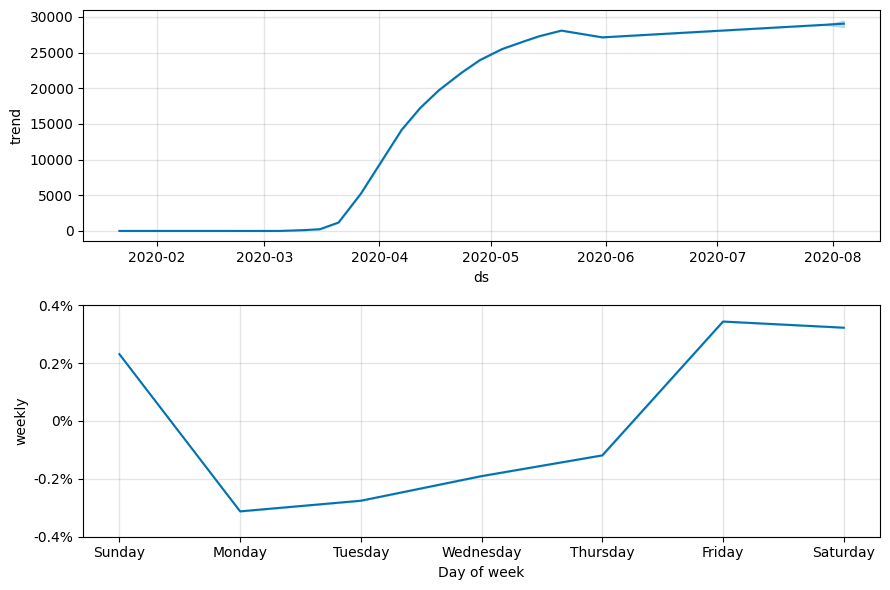

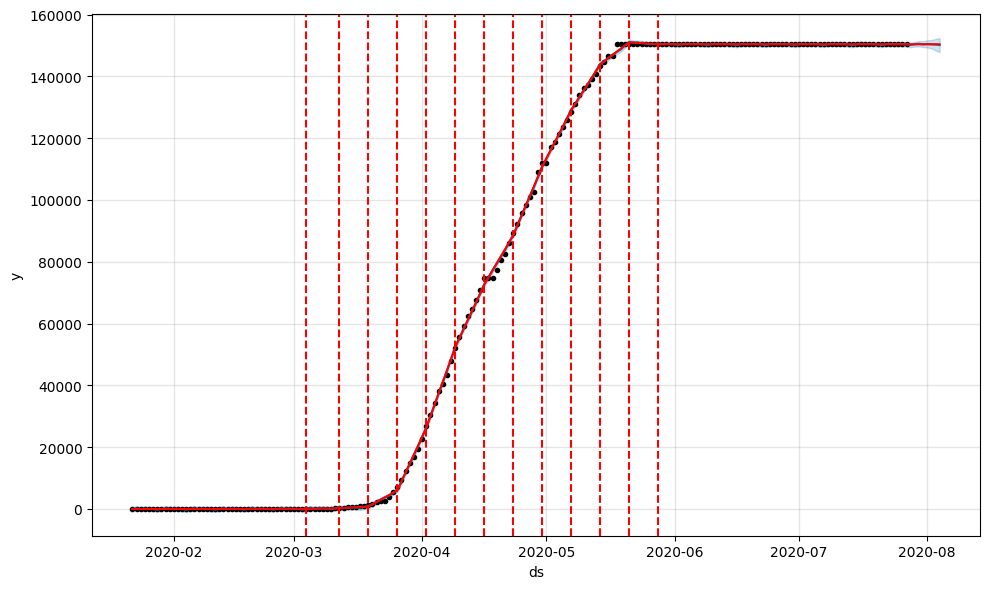

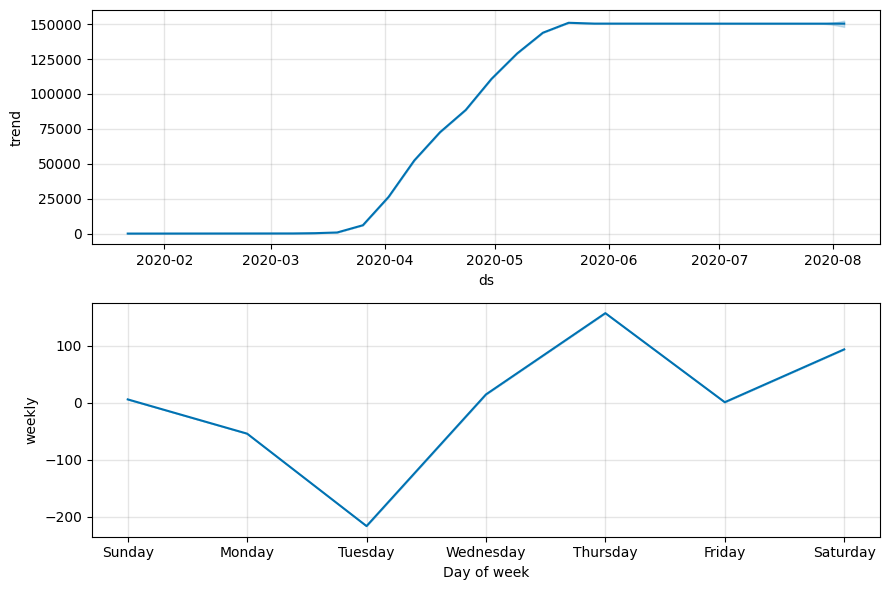

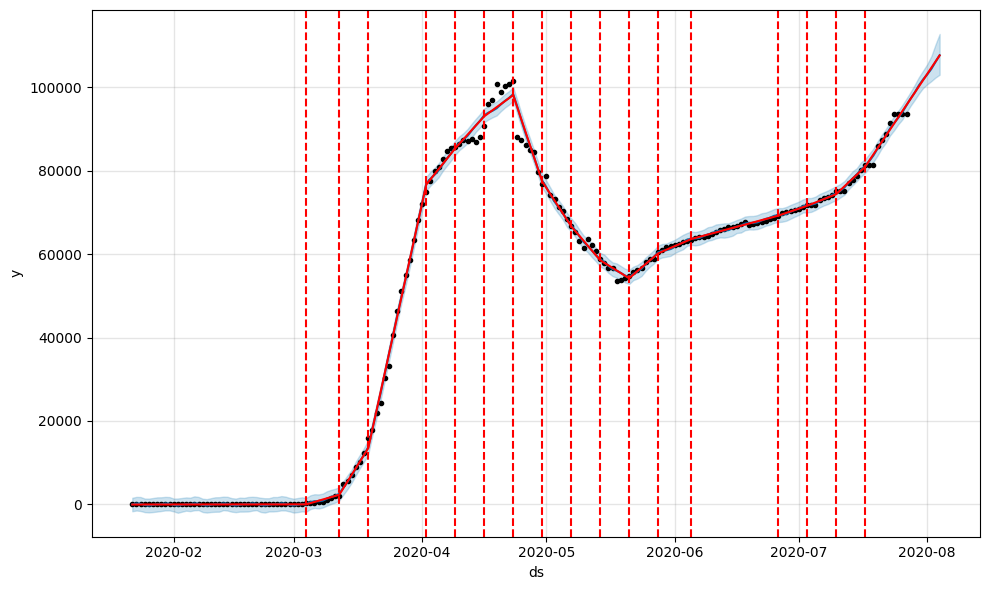

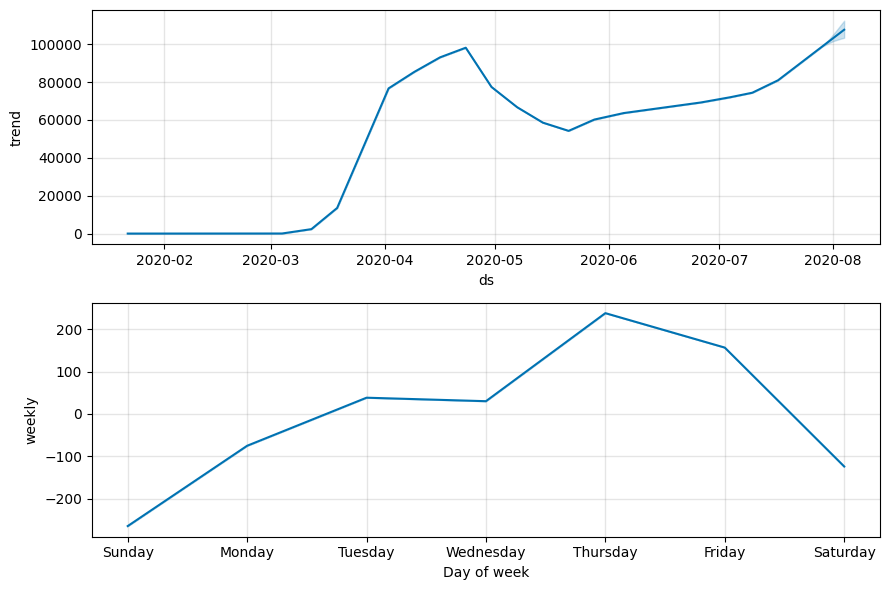

In [138]:
import time
import itertools
import pandas as pd
from prophet import Prophet
from prophet.diagnostics import cross_validation, performance_metrics
import joblib
import json

# Start timing
start_time = time.time()

# Define parameter grid
param_grid = {  
    "changepoint_prior_scale": changepoint_prior_scale_range,
    "seasonality_prior_scale": seasonality_prior_scale_range, 
    "seasonality_mode": seasonality_mode_options,
    "changepoint_range": changepoint_range_range,
}

# Generate all combinations of parameters
all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())]

for j, (k, data) in enumerate(data_dict.items()):
    print("=" * 20, k, "=" * 20)
    
    for i, col in enumerate(['Confirmed', 'Deaths', 'Recovered', 'Active']):
        print("**" * 10, col, "**" * 10)
        
        df_copy = data[['Date', col]].sort_values(by='Date')
        df_copy = df_copy.rename(columns={'Date': 'ds', col: 'y'})
        df_copy['y'] = pd.to_numeric(df_copy['y'], errors='coerce')  # Ensure numeric
        df_copy['ds'] = pd.to_datetime(df_copy['ds'])  # Ensure datetime
        
        train_set = df_copy.copy()
        
        rmses = [] 
        
        # Use cross-validation to evaluate all parameters
        for params in all_params:
            try:
                # Fit model with given parameters
                m = Prophet(**params).fit(train_set)
                
                # Perform cross-validation
                df_cv = cross_validation(m, initial='120 days', period='30 days', horizon='10 days', parallel='processes')
                
                # Calculate performance metrics
                df_p = performance_metrics(df_cv, rolling_window=3)
                rmses.append(df_p['rmse'].values[0])
            except Exception as e:
                print(f"Error with parameters {params}: {e}")
                rmses.append(float('inf'))  # Append a large value to indicate failure
                
        # Find the best parameters
        tuning_results = pd.DataFrame(all_params)
        tuning_results['rmse'] = rmses
        tuning_results = tuning_results.sort_values('rmse').reset_index(drop=True)
        
        best_params = tuning_results.iloc[0].drop('rmse').to_dict()
        
        # Best Model creation
        model = Prophet(**best_params)
        
        model.fit(train_set)
        
        future = model.make_future_dataframe(periods=8)
        
        # Make predictions
        forecast = model.predict(future)
        print(forecast.head())
        
        fig2 = model.plot(forecast)
        fig2.show()
        add_changepoints_to_plot(fig2.gca(), model, forecast)
        
        fig = model.plot_components(forecast)
        fig.show()
        
        # Save Model
        model_name = f"{k}_{col}_prophet_model.joblib"
        joblib.dump(model, model_name)
        print(f"Model saved as {model_name}")
        
        # Save Parameters
        with open(f"{k}_{col}_model_params.json", "w") as f:
            json.dump(best_params, f)

print("--- %s minutes ---" % ((time.time() - start_time) / 60))


==================== global ====================
******************** Confirmed ********************


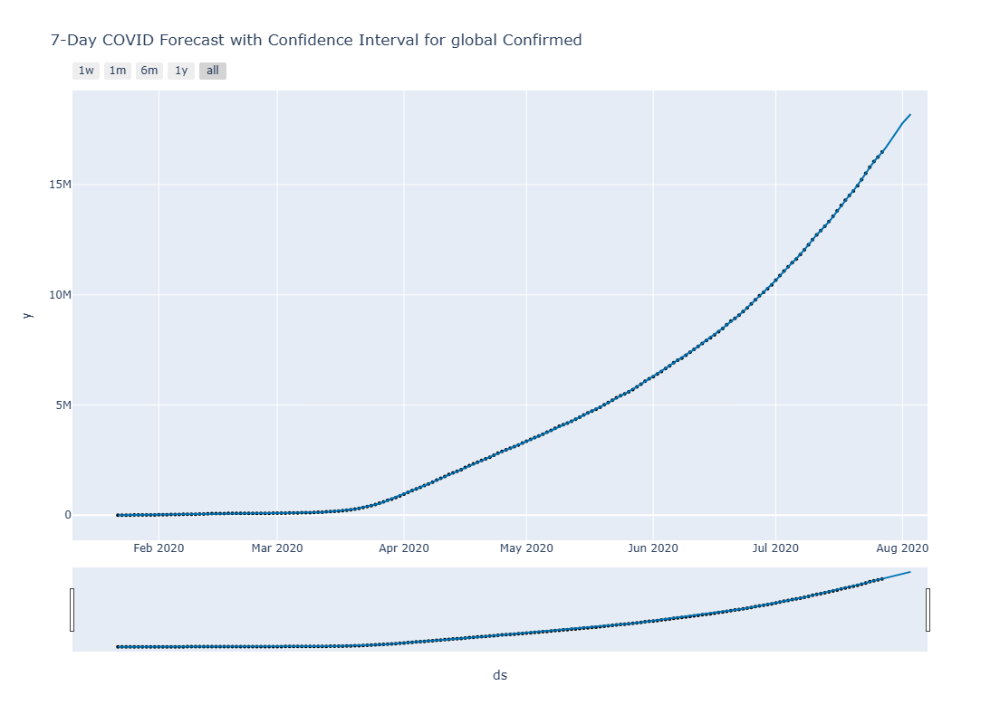

******************** Deaths ********************


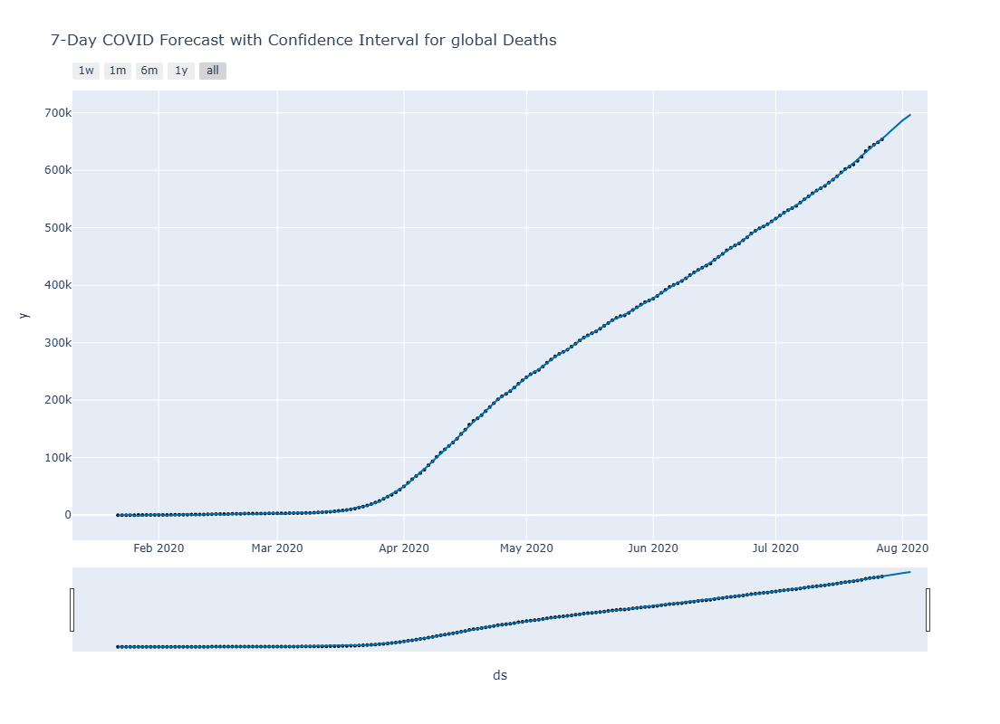

******************** Recovered ********************


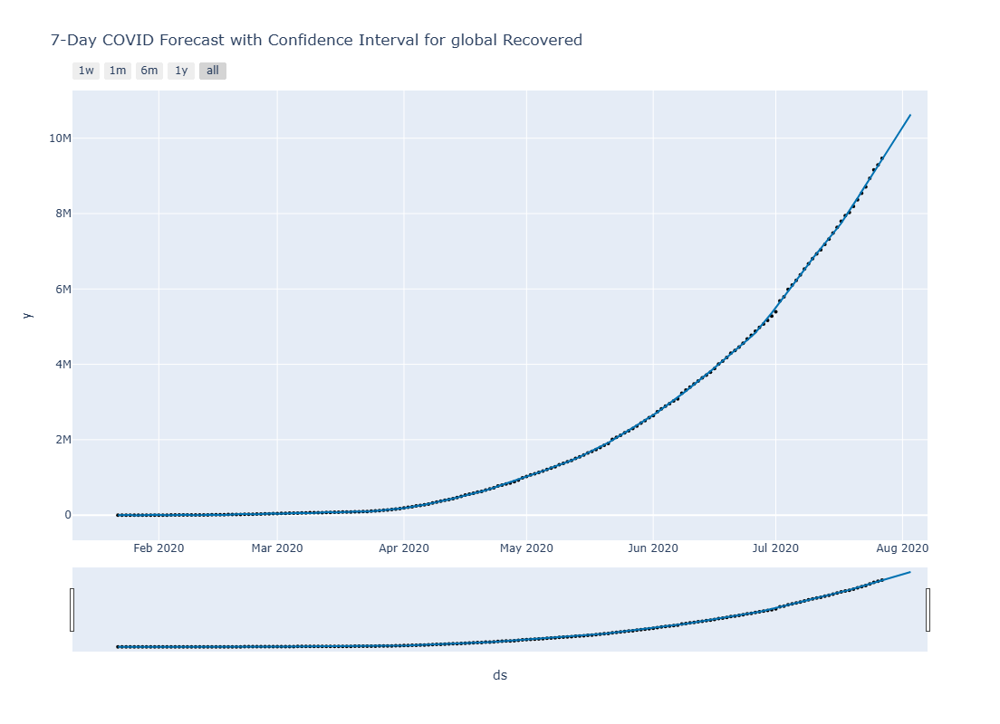

******************** Active ********************


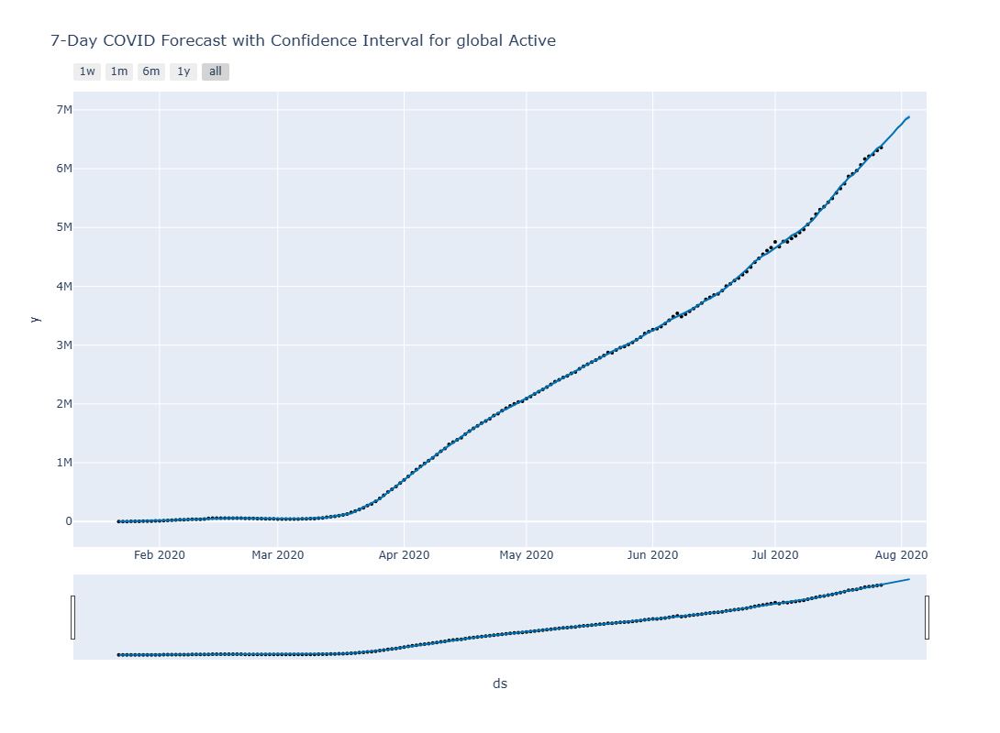

==================== americas ====================
******************** Confirmed ********************


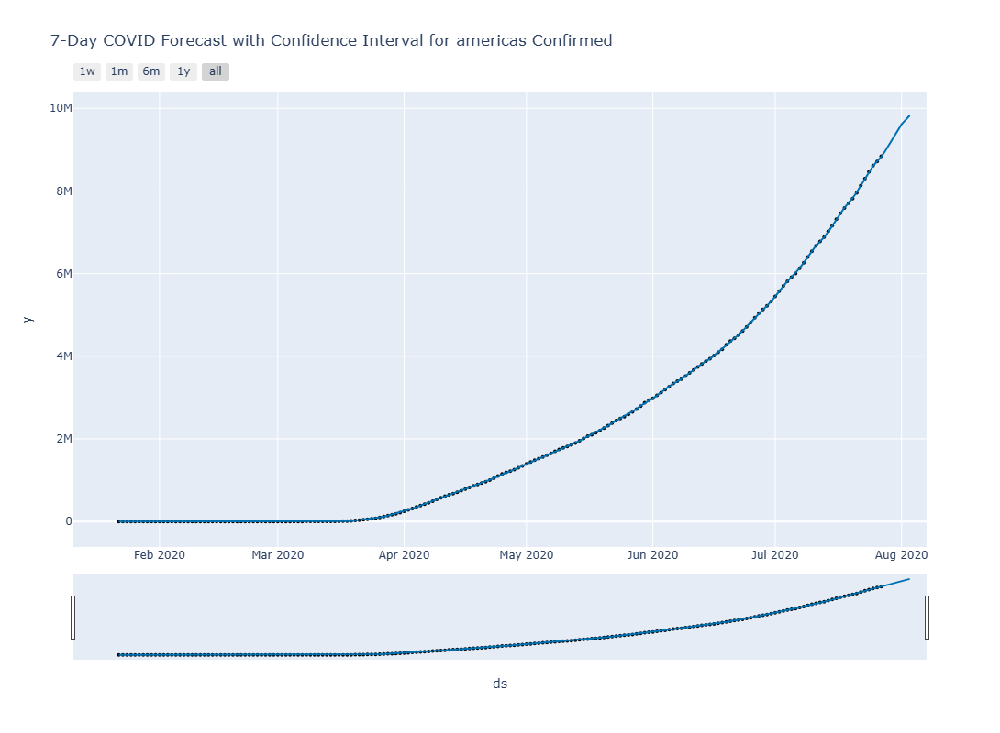

******************** Deaths ********************


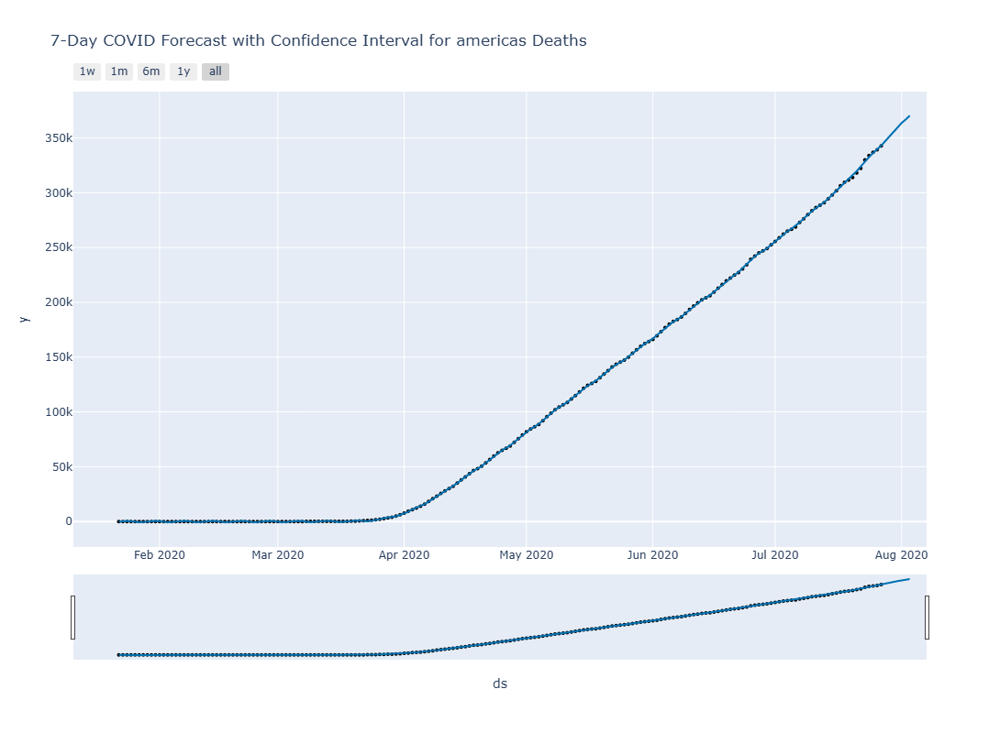

******************** Recovered ********************


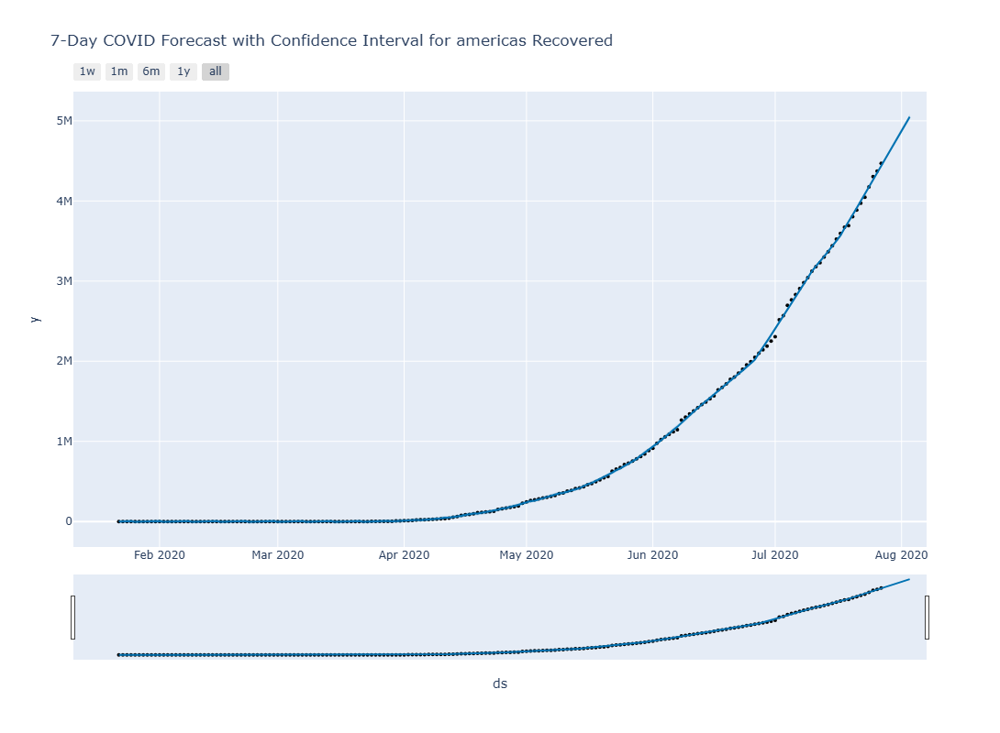

******************** Active ********************


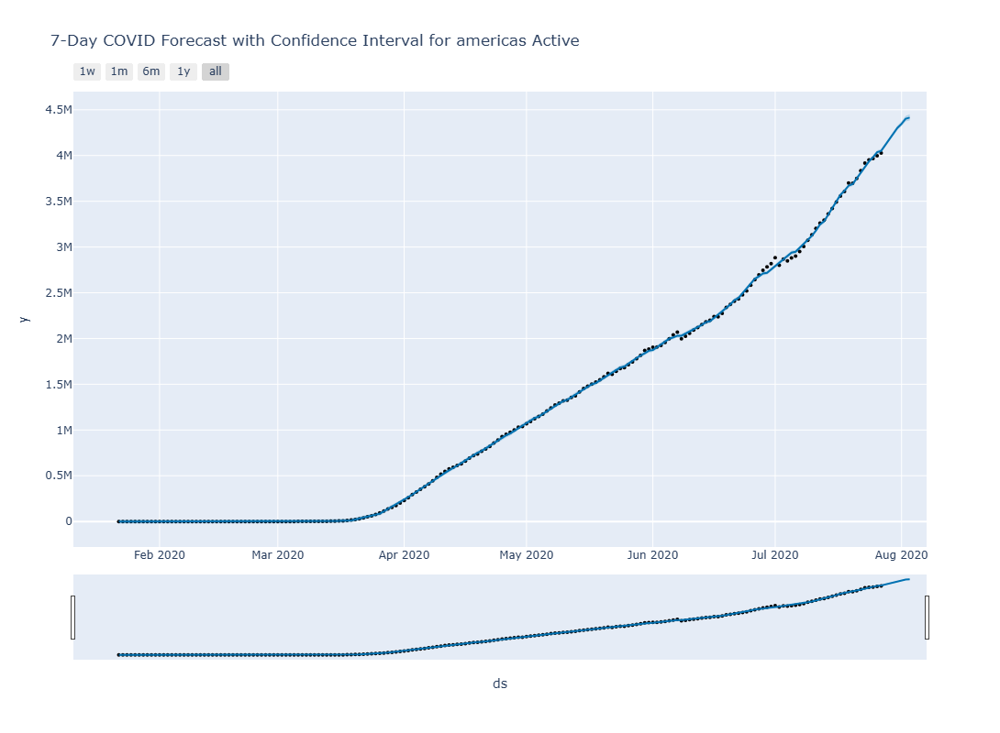

==================== Brazil ====================
******************** Confirmed ********************


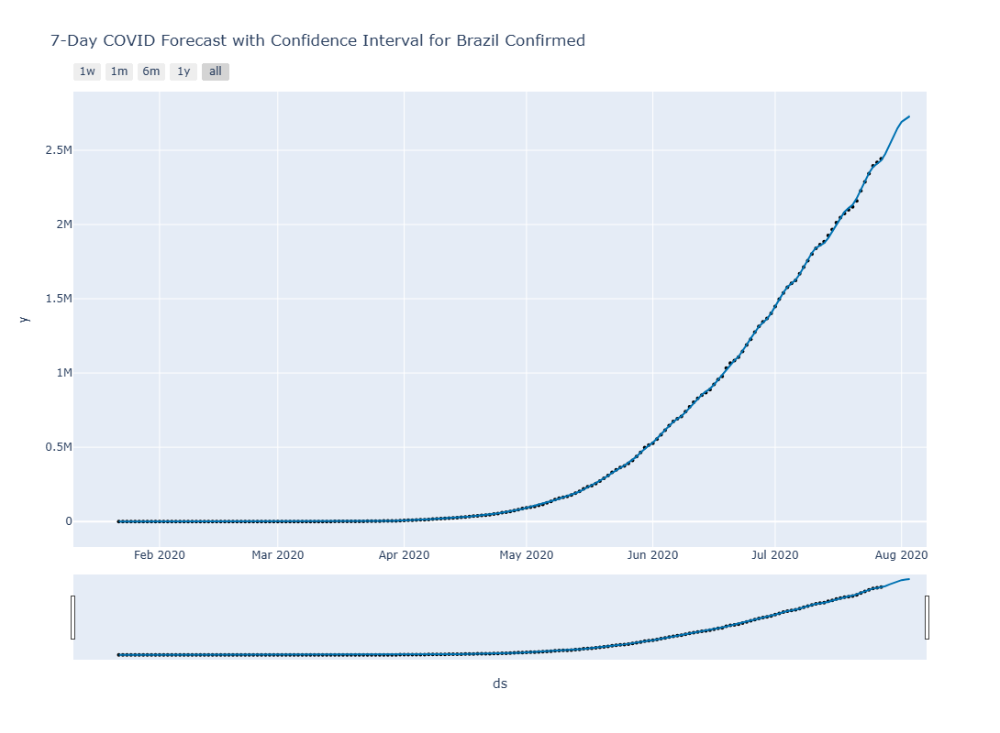

******************** Deaths ********************


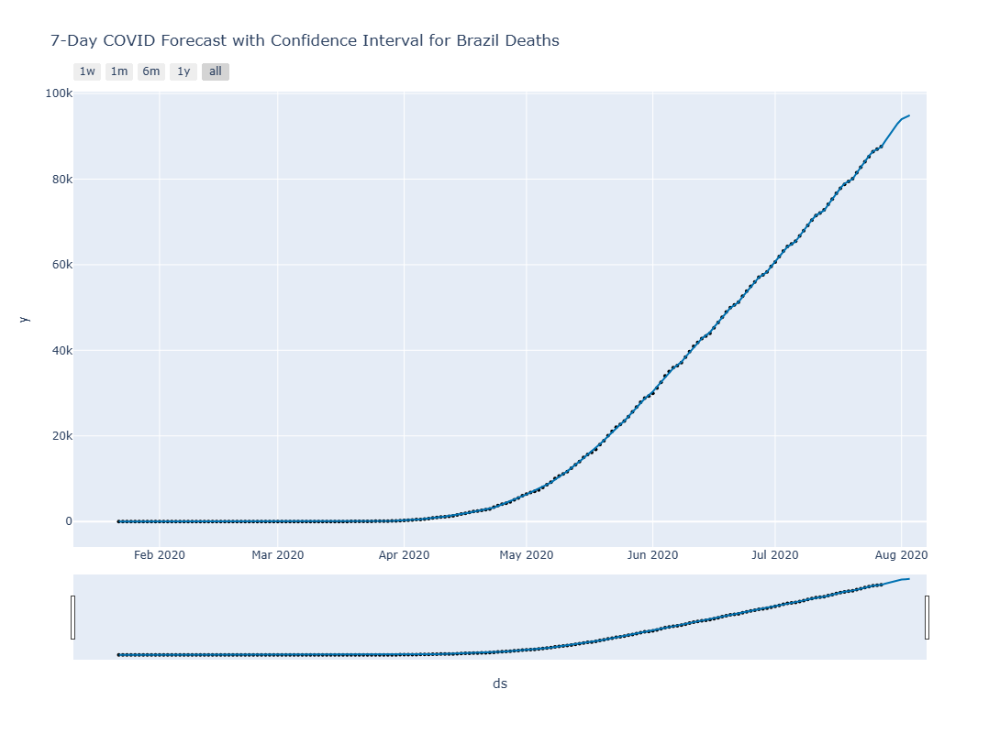

******************** Recovered ********************


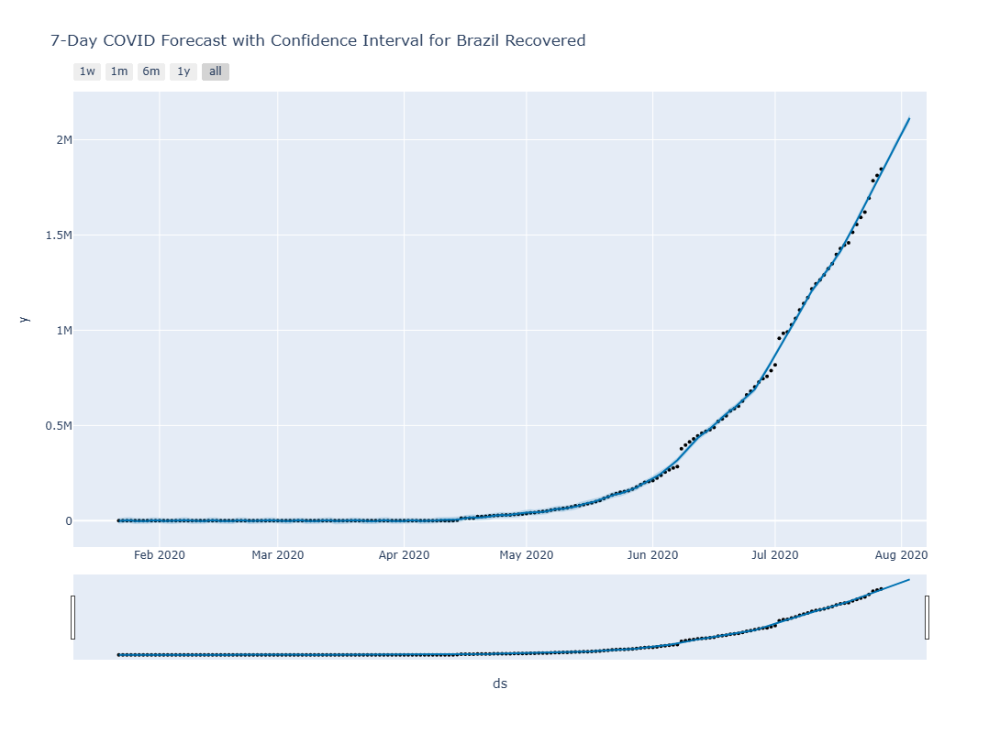

******************** Active ********************


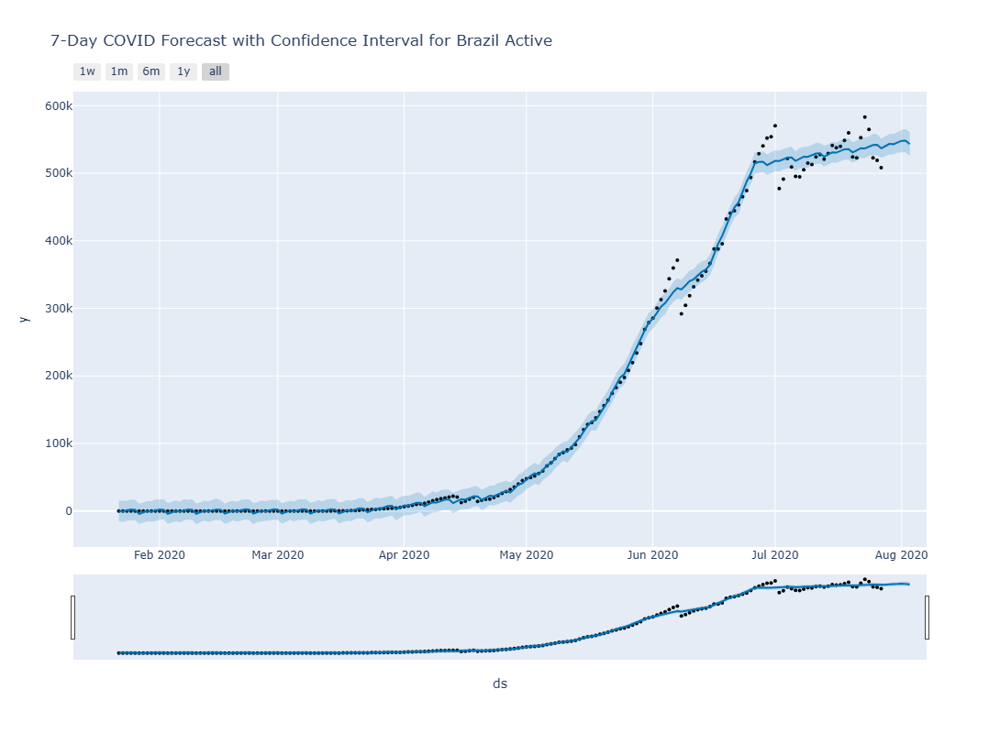

==================== India ====================
******************** Confirmed ********************


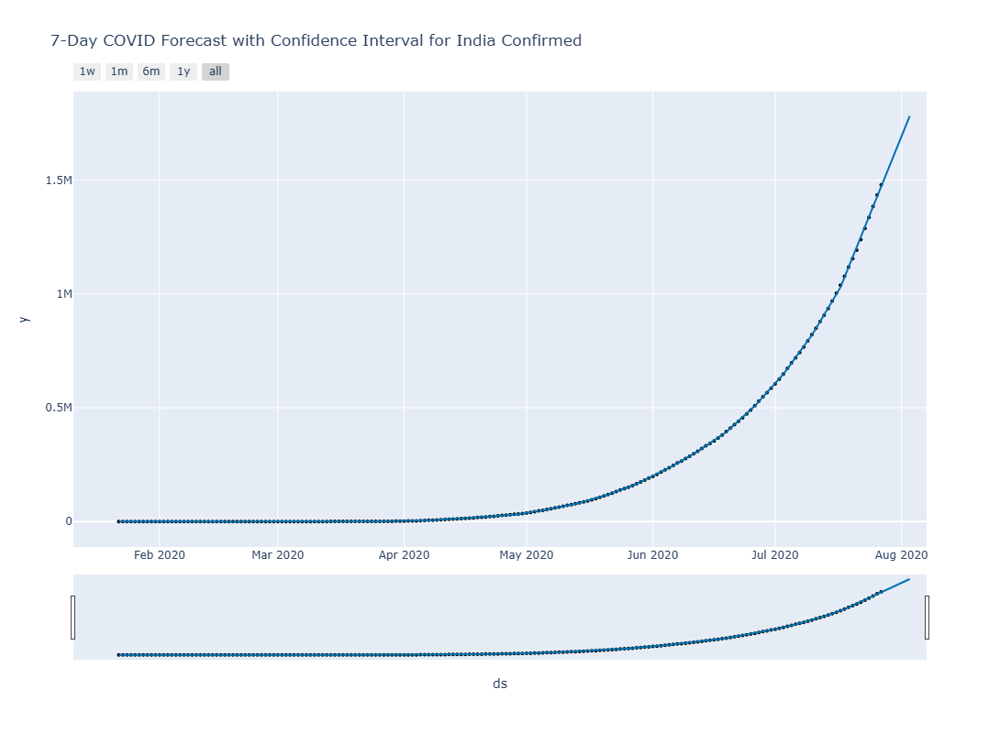

******************** Deaths ********************


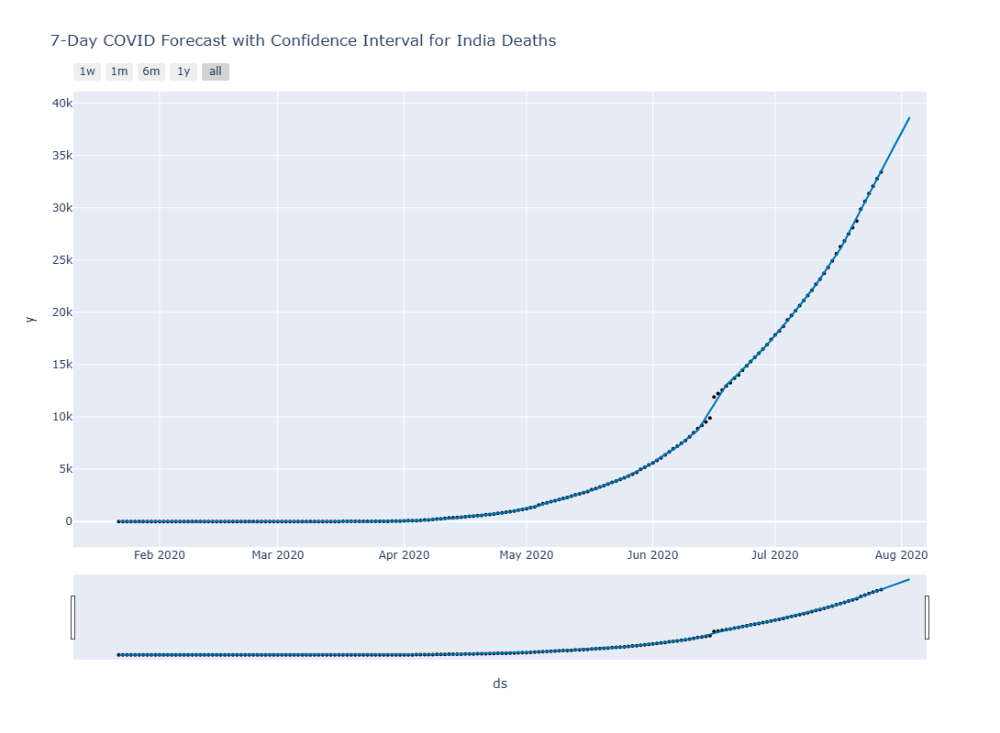

******************** Recovered ********************


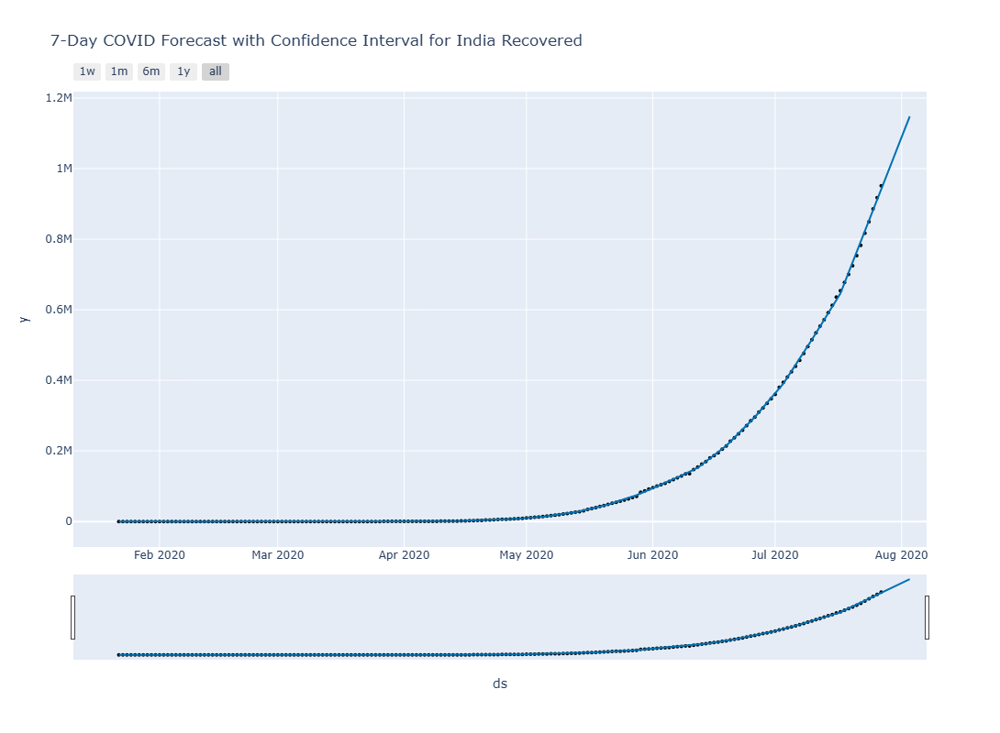

******************** Active ********************


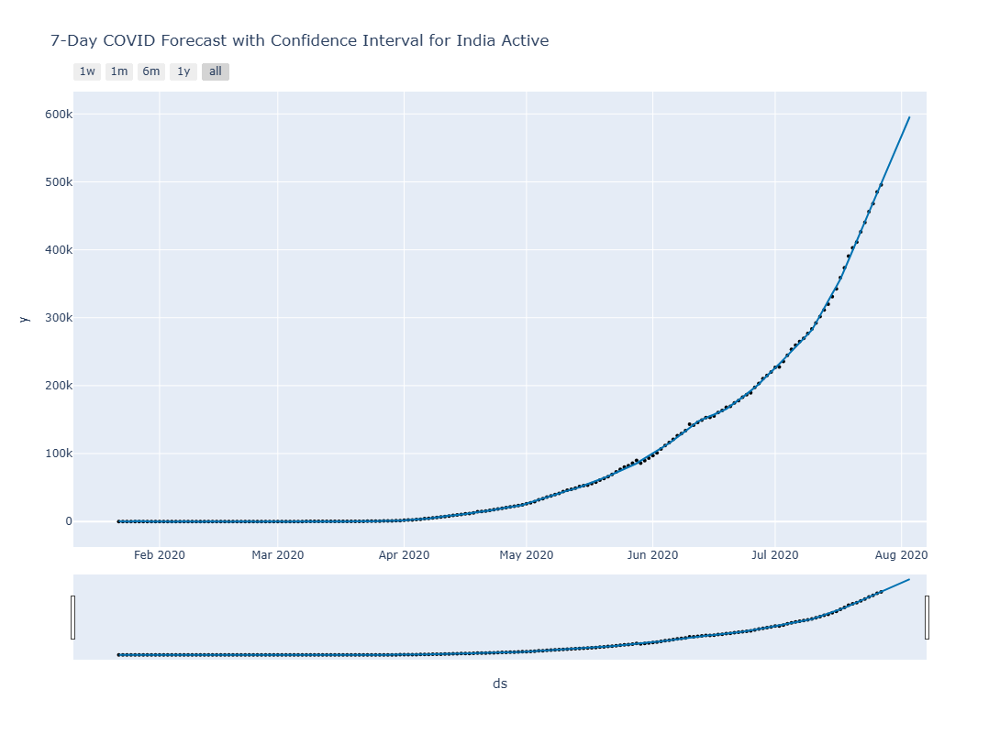

==================== Spain ====================
******************** Confirmed ********************


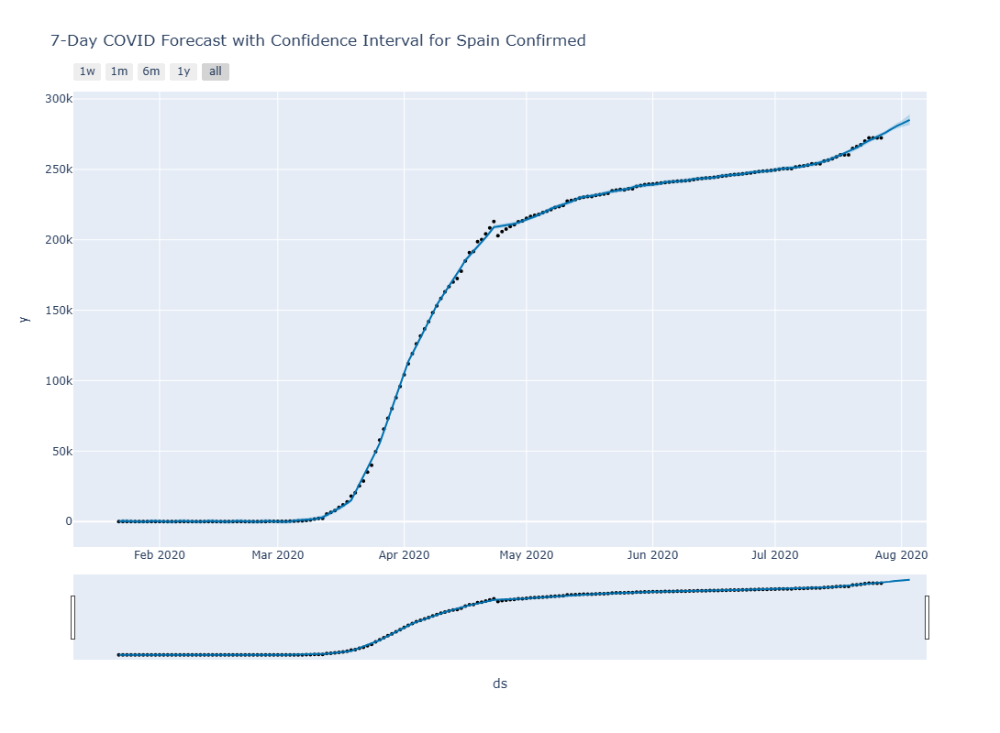

******************** Deaths ********************


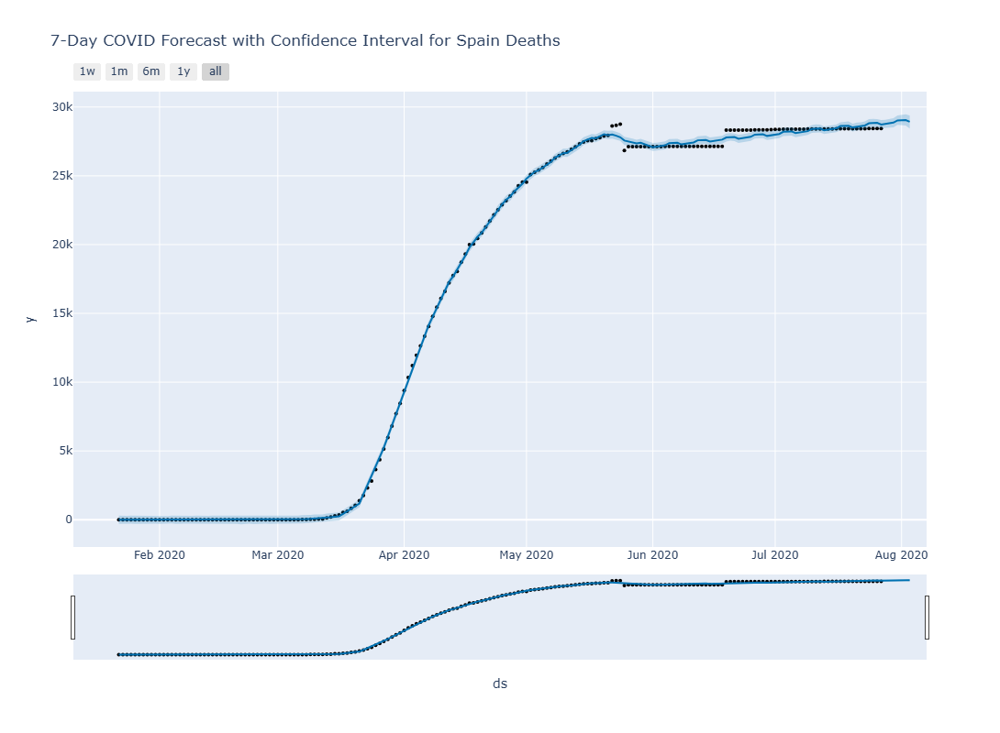

******************** Recovered ********************


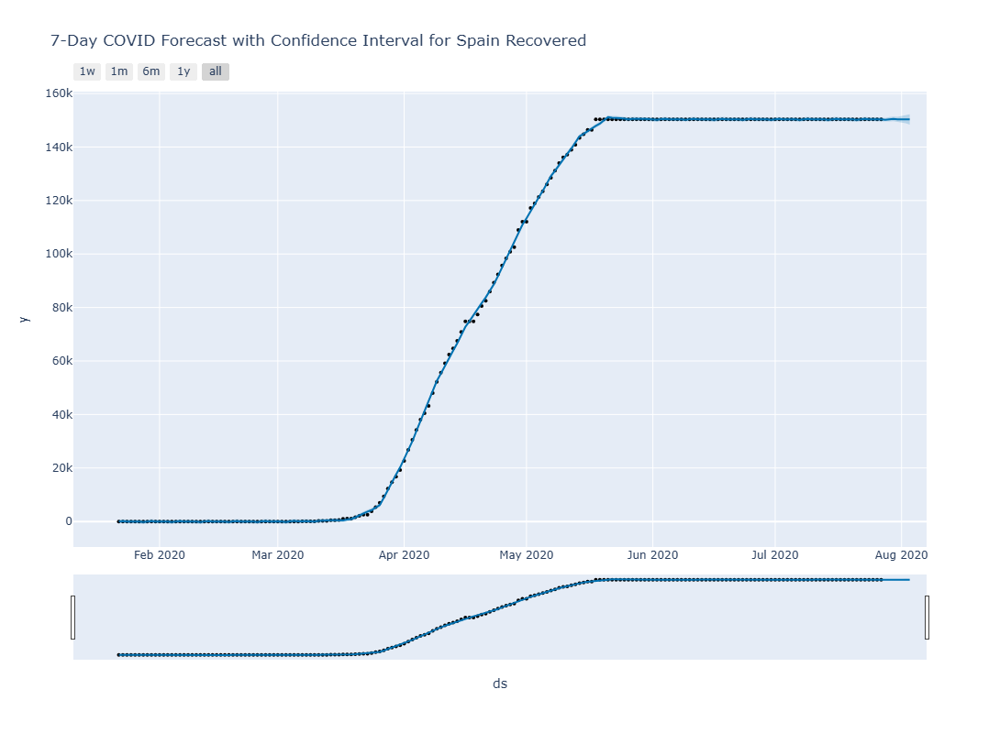

******************** Active ********************


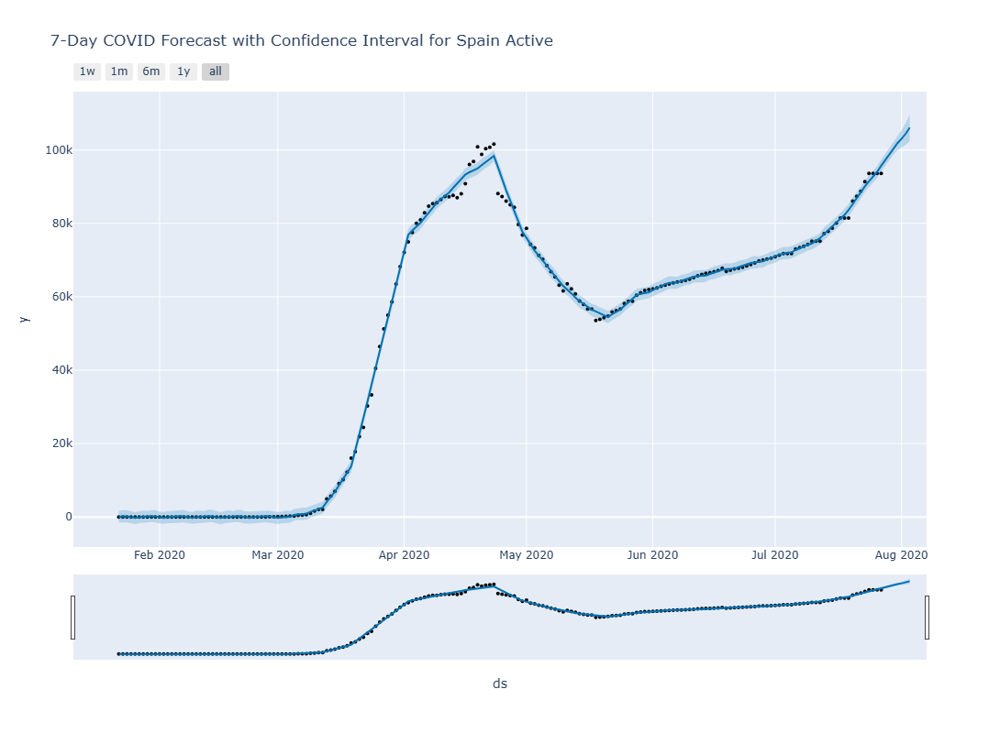

In [153]:
for j,(k, data) in enumerate(data_dict.items()):
    print('='*20, k,'='*20)
    for i,col in enumerate(['Confirmed', 'Deaths', 'Recovered', 'Active']):
        print('**'*10,col,'**'*10)

        loaded_model = joblib.load(f'{k}_{col}_prophet_model.joblib')
        future = loaded_model.make_future_dataframe(periods=7)  
        forecast = loaded_model.predict(future)
        
        fig = plot_plotly(loaded_model, forecast)
        fig.update_layout(
            title=f'7-Day COVID Forecast with Confidence Interval for {k} {col}',
            width=1200,
            height=800
        )
        fig.show()


        forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail(7).to_csv(f'{k}_{col}_weekly_forecast.csv', index=False)

### Report Creation and Submission

In [216]:
data_dict.keys()

dict_keys(['global', 'americas', 'Brazil', 'India', 'Spain'])

## 1. Visualize the impact

`Globally` 
`WHO Region wise`
`Country/Region wise`

In [219]:
import plotly.graph_objects as go
from PIL import Image


def create_line_plot(data: pd.DataFrame, name:str):
    """
    Creates a line plot using Plotly.

    Parameters:
    - data (DataFrame): The data source for the plot.
    - name (str): Name of the dataset
    Returns:
    - fig: The Plotly figure object.
    """
    fig = px.line(
        data, 
        x='Date', 
        y=['Confirmed', 'Deaths', 'Recovered', 'Active'], 
        title=f"Line Plot for {name} ",
        labels={'Value': 'Observed Value', 'Date': 'Date'}
    )
    fig.update_layout(
        xaxis_title="Date",
        yaxis_title="Value",
        width=800,  
        height=400  
    )
    fig.show()
    return fig


def save_plotly_figure(fig):
    """
    Saves a Plotly figure to a specified file.

    Parameters:
    - fig: The Plotly figure object to be saved.
    Returns:
    - None
    """
    try:
        fig.write_image(f'{fig}.png')
        print(f"Figure saved successfully as '{fig}'!")
    except Exception as e:
        print(f"An error occurred while saving the figure: {e}")



def display_image(image_path):
    """
    Loads and displays an image using the PIL library.

    Parameters:
    - image_path (str): The file path of the image to load.

    Returns:
    - None
    """
    try:
        image = Image.open(image_path)
        
        image.show()
        print(f"Image displayed successfully: {image_path}")
    except FileNotFoundError:
        print(f"Error: The file '{image_path}' was not found.")
    except Exception as e:
        print(f"An error occurred: {e}")




In [221]:
data_dict['global']

,Date,Confirmed,Deaths,Recovered,Active,Confirmed_lag_1,Deaths_lag_1,Recovered_lag_1,Active_lag_1,day_of_week,month
0,2020-01-22,555,17,28,510,NaN,NaN,NaN,NaN,2,1
1,2020-01-23,654,18,30,606,555.00,17.00,28.00,510.00,3,1
2,2020-01-24,941,26,36,879,654.00,18.00,30.00,606.00,4,1
3,2020-01-25,1434,42,39,1353,941.00,26.00,36.00,879.00,5,1
4,2020-01-26,2118,56,52,2010,1434.00,42.00,39.00,1353.00,6,1
5,2020-01-27,2927,82,61,2784,2118.00,56.00,52.00,2010.00,0,1
6,2020-01-28,5578,131,107,5340,2927.00,82.00,61.00,2784.00,1,1
7,2020-01-29,6166,133,125,5908,5578.00,131.00,107.00,5340.00,2,1
8,2020-01-30,8234,171,141,7922,6166.00,133.00,125.00,5908.00,3,1
9,2020-01-31,9927,213,219,9495,8234.00,171.00,141.00,7922.00,4,1


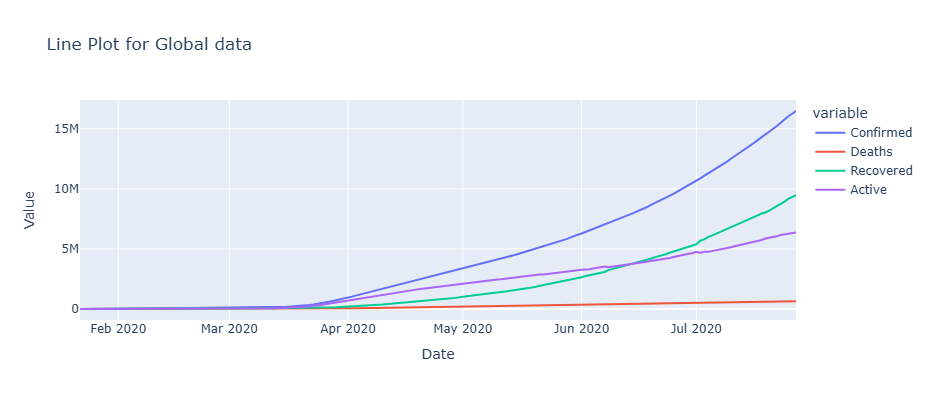

In [223]:
# Globally
global_cases_plot = create_line_plot(data=data_dict['global'], name='Global data')

###### On June 16, 2020 The number of cases recovered became more than the number of active cases globally.
There is an exponential rise in cases. However fortunately the rise in number of deaths is comparetively much low which is the silverlining.

In [234]:
def plot_who_region_area(df):
    """
    Plots a stacked area chart for WHO Region-wise aggregated data using Plotly.

    Parameters:
    - df (DataFrame): The input DataFrame containing 'WHO Region', 'Confirmed', 'Deaths', 'Recovered', and 'Active' columns.

    Returns:
    - fig: The Plotly figure object for the area chart.
    """
    # Group data by 'WHO Region'
    who_region_wise_data_sum = df.groupby('WHO Region').agg({
        'Confirmed': 'sum',
        'Deaths': 'sum',
        'Recovered': 'sum',
        'Active': 'sum'
    }).reset_index()

    # Plot the stacked area chart using Plotly
    fig = px.area(
        who_region_wise_data_sum,
        x='WHO Region',
        y=['Confirmed', 'Deaths', 'Recovered', 'Active'],
        title="WHO Region-wise Data (Stacked Area Chart)",
        labels={'value': 'Cases', 'variable': 'Status', 'WHO Region': 'WHO Region'}
    )
    fig.update_layout(
        xaxis_title="WHO Region",
        yaxis_title="Number of Cases",
        width=800,
        height=400
    )
    fig.show()

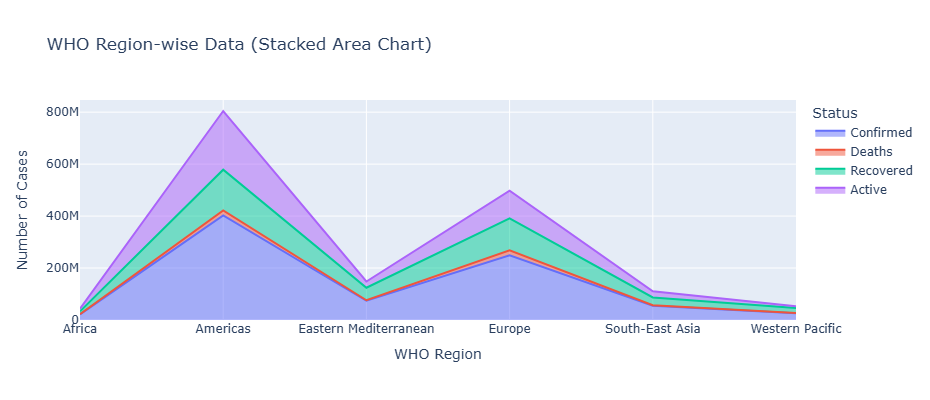

In [236]:
# WHO Region wise
plot_who_region_area(df)

###### Maximun affected WHO Region is the Americas followed by Europe whereas the rest of the region has comparitevely lower number of cases.\
The reason for such a phenomena should be researched with addition data.

In [239]:
country_datasets.keys()

dict_keys(['Afghanistan', 'Albania', 'Algeria', 'Andorra', 'Angola', 'Antigua and Barbuda', 'Argentina', 'Armenia', 'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin', 'Bhutan', 'Bolivia', 'Bosnia and Herzegovina', 'Botswana', 'Brazil', 'Brunei', 'Bulgaria', 'Burkina Faso', 'Burma', 'Burundi', 'Cabo Verde', 'Cambodia', 'Cameroon', 'Canada', 'Central African Republic', 'Chad', 'Chile', 'China', 'Colombia', 'Comoros', 'Congo (Brazzaville)', 'Congo (Kinshasa)', 'Costa Rica', "Cote d'Ivoire", 'Croatia', 'Cuba', 'Cyprus', 'Czechia', 'Denmark', 'Djibouti', 'Dominica', 'Dominican Republic', 'Ecuador', 'Egypt', 'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia', 'Eswatini', 'Ethiopia', 'Fiji', 'Finland', 'France', 'Gabon', 'Gambia', 'Georgia', 'Germany', 'Ghana', 'Greece', 'Greenland', 'Grenada', 'Guatemala', 'Guinea', 'Guinea-Bissau', 'Guyana', 'Haiti', 'Holy See', 'Honduras', 'Hungary', 'Iceland', 'India', 'Indo

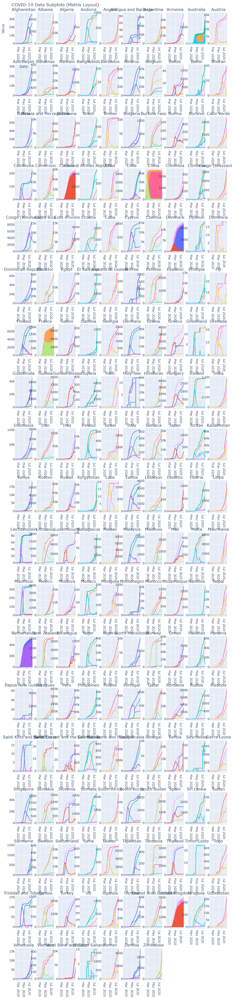

In [271]:
# Country/Region wise
import plotly.subplots as sp
import plotly.graph_objects as go

rows = 19
cols = 10
col_name = ['Confirmed', 'Deaths', 'Recovered', 'Active']

# Create the subplot figure with a matrix layout
fig = sp.make_subplots(
    rows=rows,
    cols=cols,
    subplot_titles=list(country_datasets.keys())[:rows * cols],  # Display country names
    vertical_spacing=0.02,  # Adjust spacing between rows
    horizontal_spacing=0.02  # Adjust spacing between columns
)

# Iterate over country datasets and add traces to subplots
for i, (country, df) in enumerate(country_datasets.items()):
    # Determine the row and column for the current subplot
    row = i // cols + 1
    col = i % cols + 1
    
    # Add traces for each country data
    for col_item in col_name:
        fig.add_trace(
            go.Scatter(
                x=df['Date'],
                y=df[col_item],
                mode='lines',
                name=f"{country} - {col_item}"  # Unique name for each trace
            ),
            row=row, col=col
        )
    
    # Stop adding plots if the grid is filled
    if i + 1 >= rows * cols:
        break

# Update layout to make it tight and readable
fig.update_layout(
    title="COVID-19 Data Subplots (Matrix Layout)",
    xaxis_title="Date",
    yaxis_title="Value",
    width=2000,  # Adjust width
    height=4000,  # Adjust height
    margin=dict(l=20, r=20, t=50, b=20),  # Tight margins
    showlegend=False  # Disable legend for clarity
)

# Show the figure
fig.show()


In [273]:
# For the choosen countries and who region

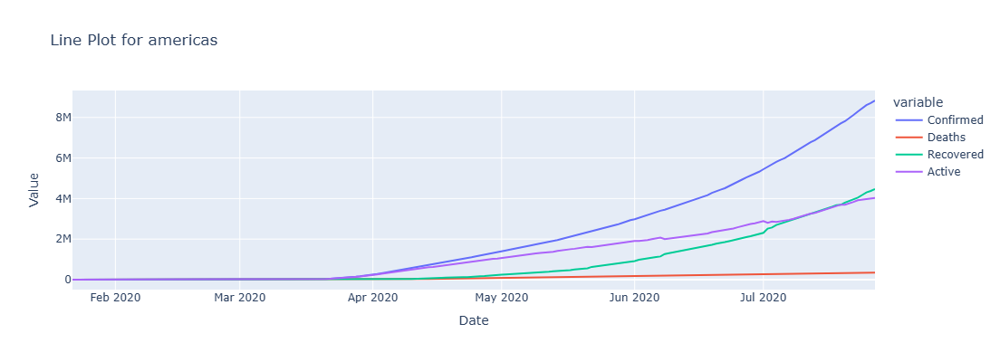

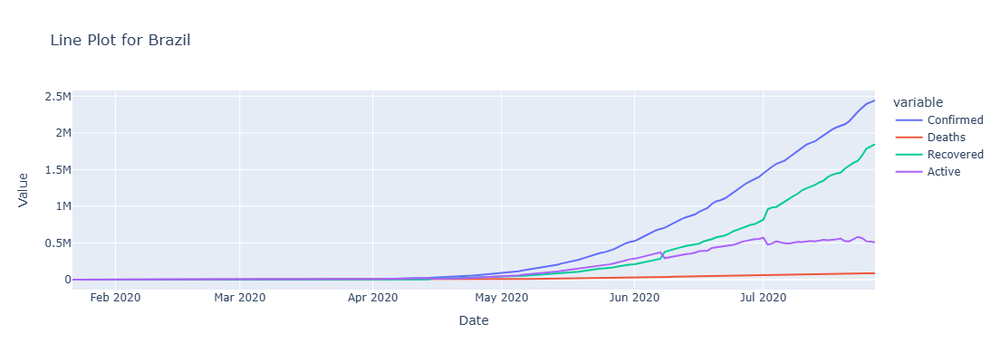

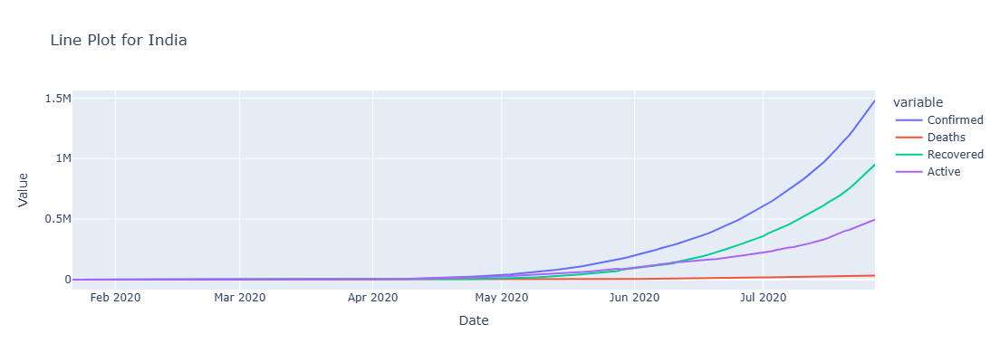

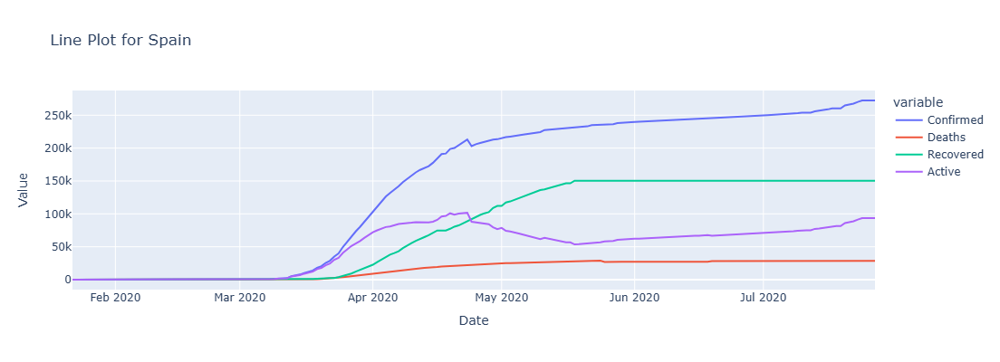

In [281]:
for i, (k, df) in enumerate(data_dict.items()):  
    if i != 0: create_line_plot(data=df, name=k)
    

##### Date when cases recovered surpassed the number of active cases:
- Americas: 13 july 2020 
- Brazil: 8 June 2020
- India: 11 June 2020
- Spain: 24 April 2020

##### From The Graph it is clear that cases in Spain has started to plateau but in rest it is still rising.

##### First case was captured according to the data in 
- Americas: 22 January 2020 
- Brazil: 26 February 2020
- India: 2 March 2020
- Spain: 25 February 2020

## 2. Analyze the trend  
`Daily` `Weekly` `Monthly`\
`Seasonal Decomposition`

==================== global ====================


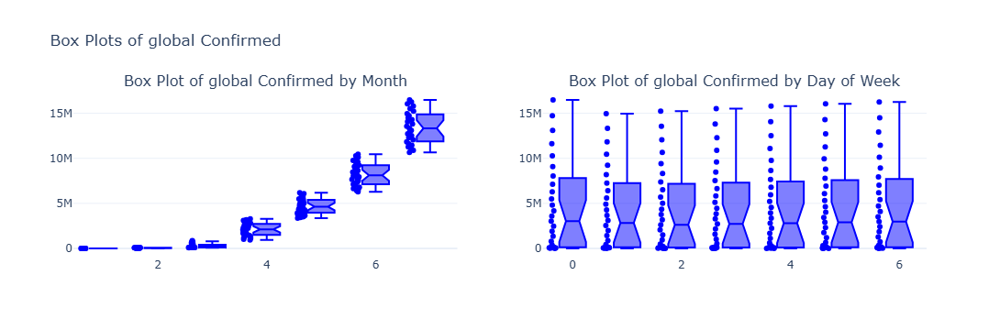

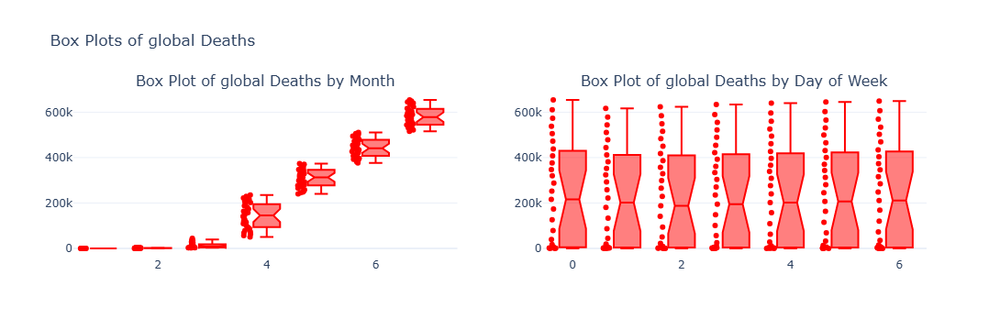

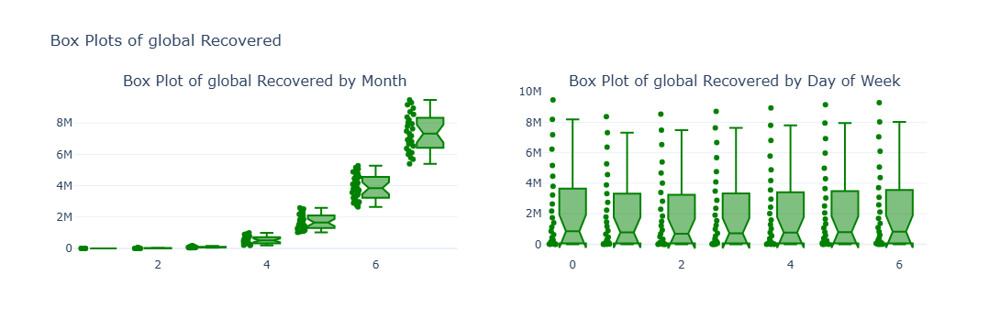

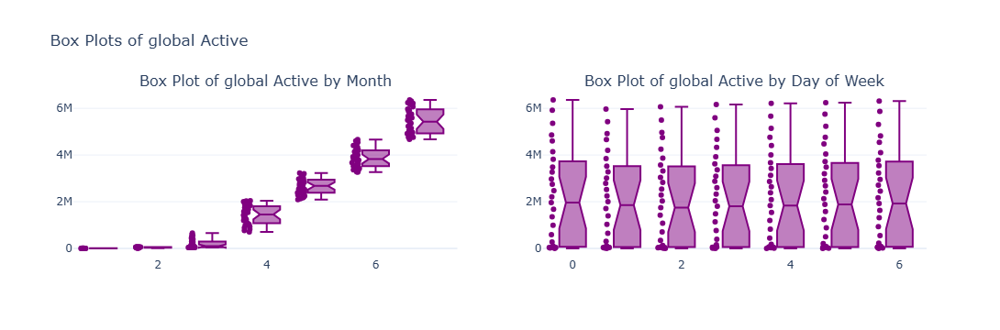

==================== americas ====================


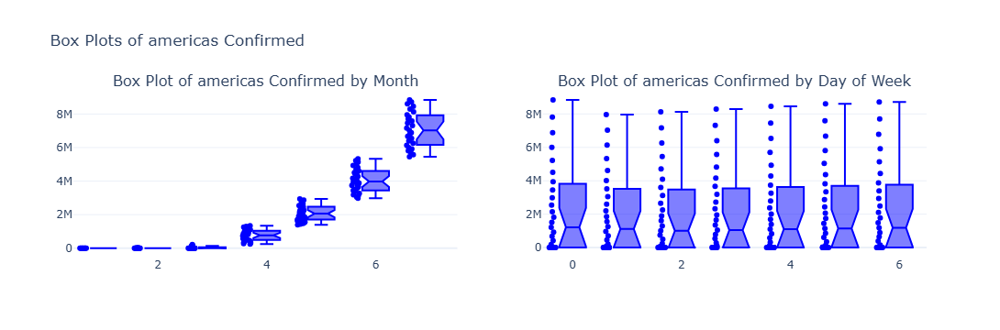

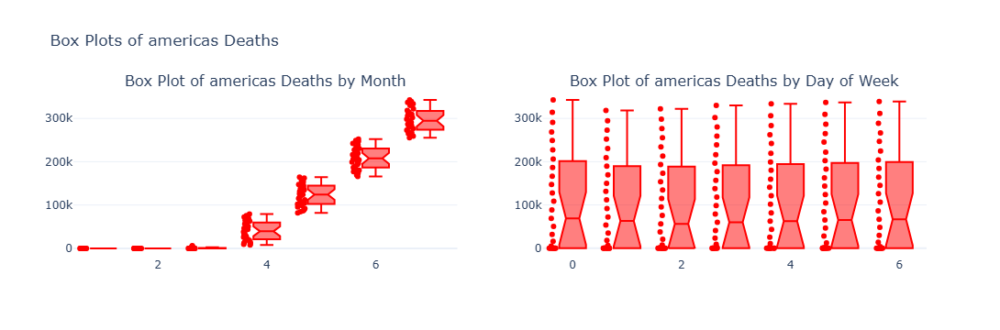

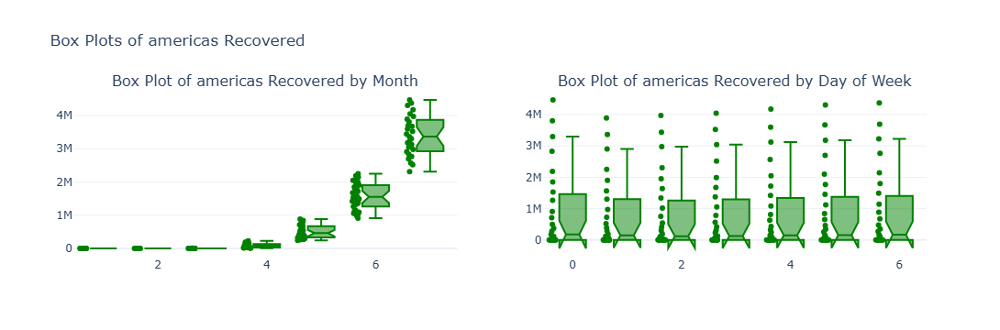

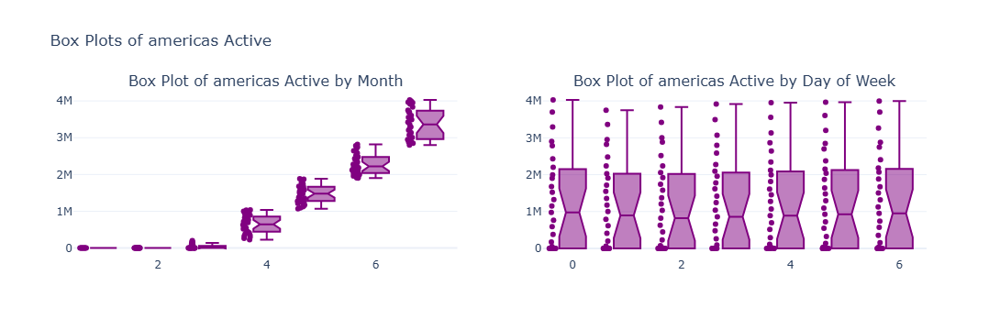

==================== Brazil ====================


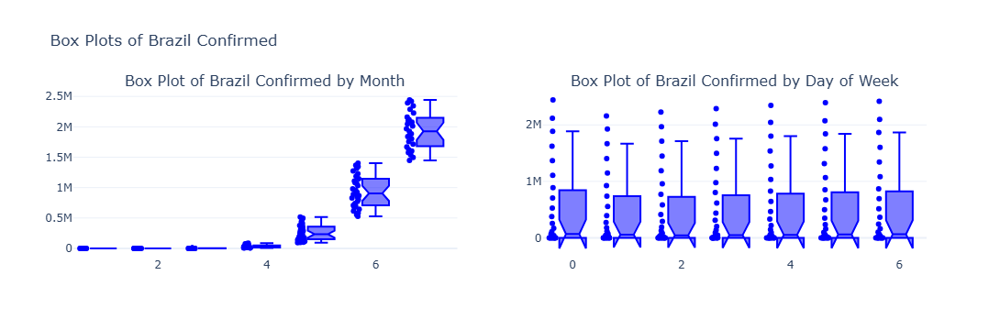

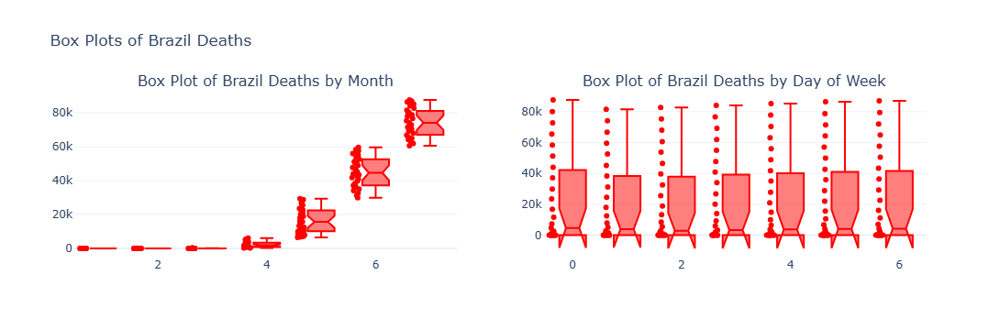

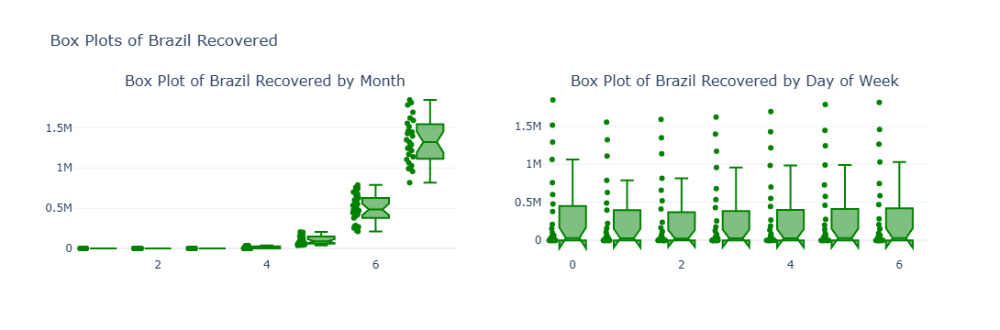

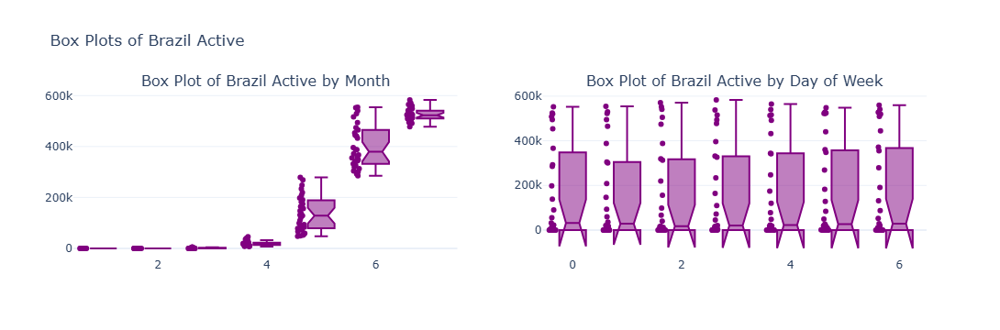

==================== India ====================


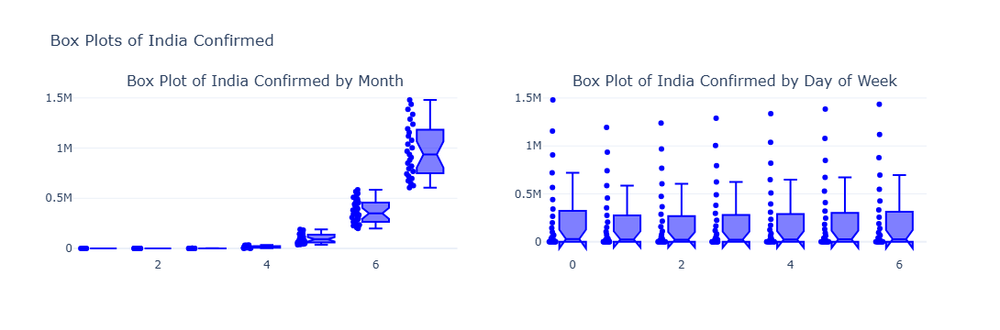

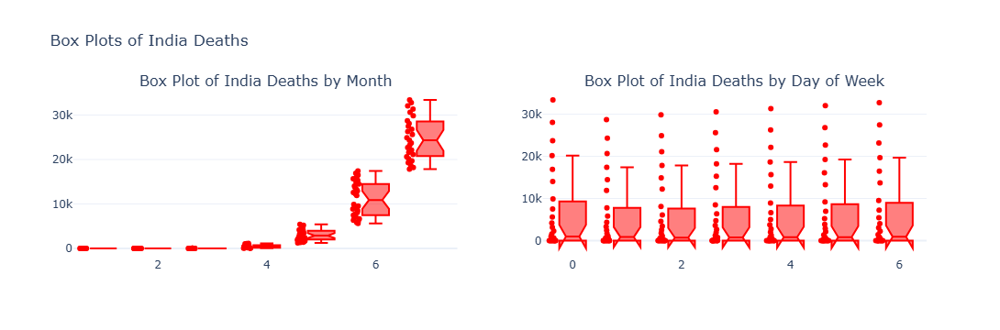

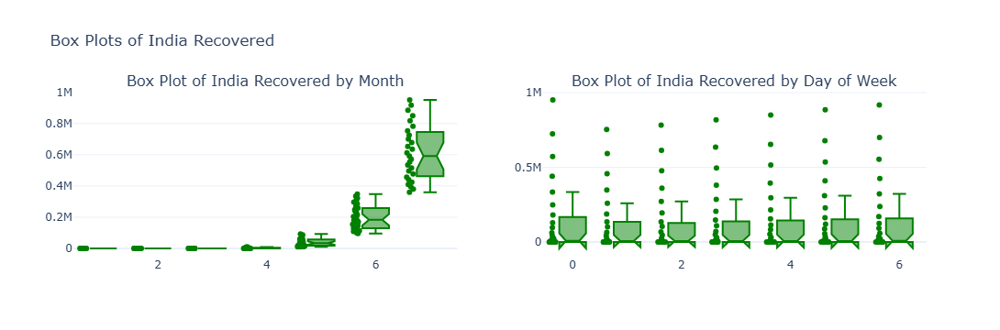

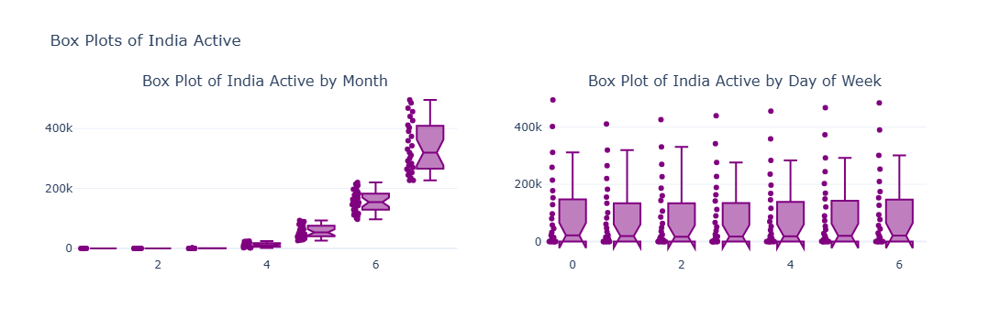

==================== Spain ====================


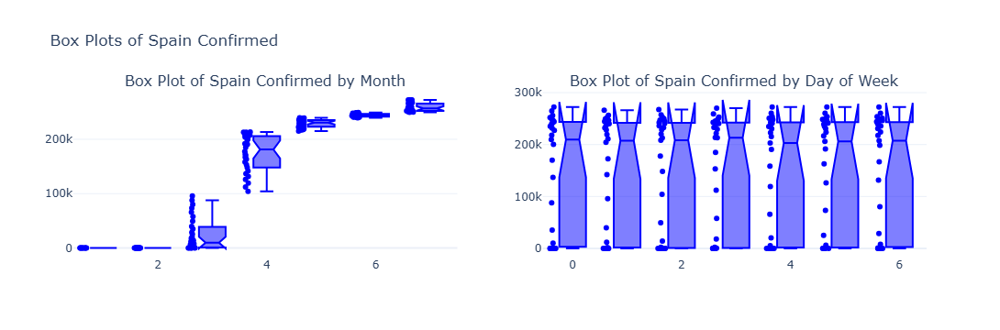

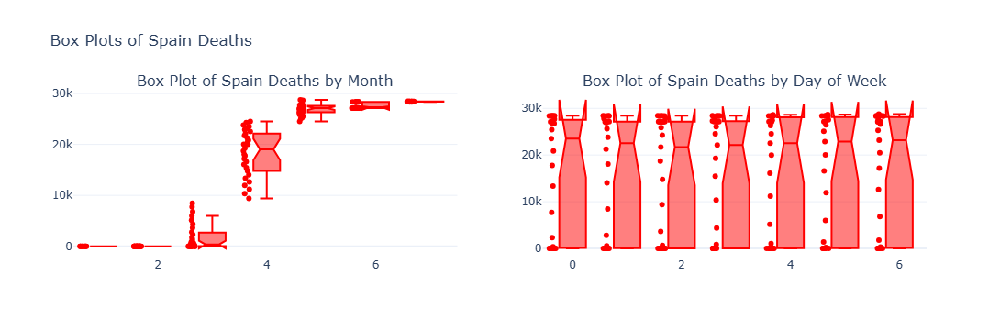

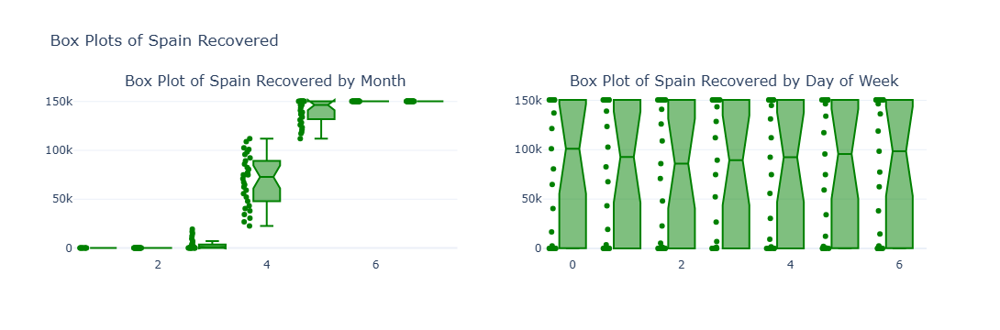

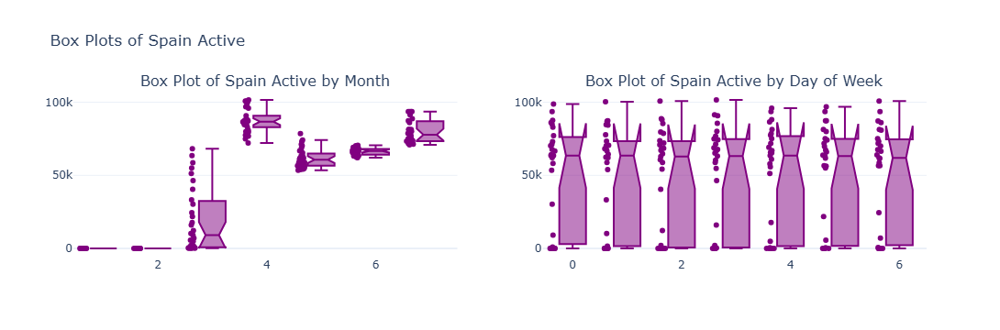

In [352]:
# Weekly and monthly trend
import plotly.express as px
import plotly.graph_objects as go
import plotly.subplots as sp

def plot_box_subplots(df, col, k, color):
    if not all(col_name in df.columns for col_name in ['month', 'day_of_week', col]):
        print(f"Warning: Required column(s) missing in dataset '{k}'")
        return None
    
    # Create subplot figure
    fig = sp.make_subplots(rows=1, cols=2, subplot_titles=(
        f'Box Plot of {k} {col} by Month',
        f'Box Plot of {k} {col} by Day of Week'
    ))
    
    # Add box plot by month
    box_month = go.Box(x=df['month'], y=df[col], marker_color=color, boxpoints='all', name=f'{col} by Month', notched=True)
    fig.add_trace(box_month, row=1, col=1)
    
    # Add box plot by day of week
    box_dow = go.Box(x=df['day_of_week'], y=df[col], marker_color=color, boxpoints='all', name=f'{col} by Day of Week', notched=True)
    fig.add_trace(box_dow, row=1, col=2)
    
    fig.update_layout(title_text=f'Box Plots of {k} {col}', template='plotly_white', showlegend=False)
    return fig


columns = ['Confirmed', 'Deaths', 'Recovered', 'Active']
colors = ['blue', 'red', 'green', 'purple']

# Loop through datasets and generate subplot plots
for k, data in data_dict.items():
    print('='*20, k, '='*20)
    for col, color in zip(columns, colors):
        fig = plot_box_subplots(data, col, k, color)
        if fig:
            fig.show()


###### Similar to daily plot
Except Brazil Active cases And Spain all the others are rising in the number of of cases with increase in month.
But on Weekly basis, India's data shows variation on week day wise data unlike others. Since such change is present in all the cases this can be investigated further.

==================== global ====================
-------------------- Confirmed --------------------


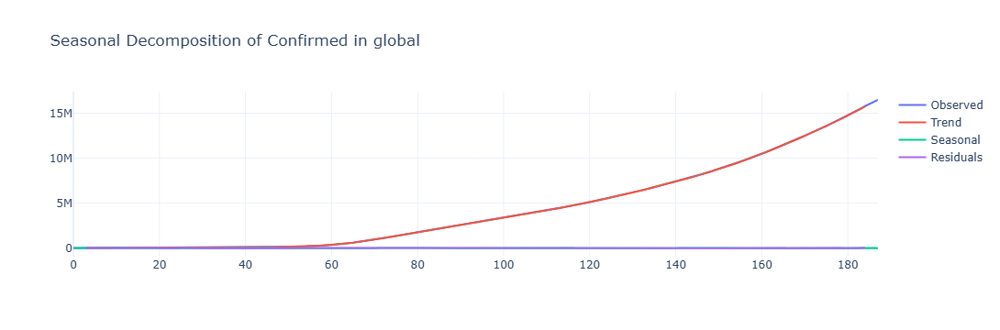

-------------------- Deaths --------------------


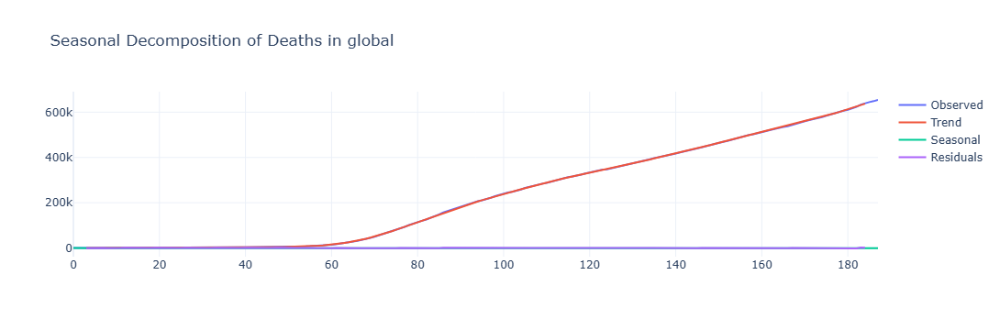

-------------------- Recovered --------------------


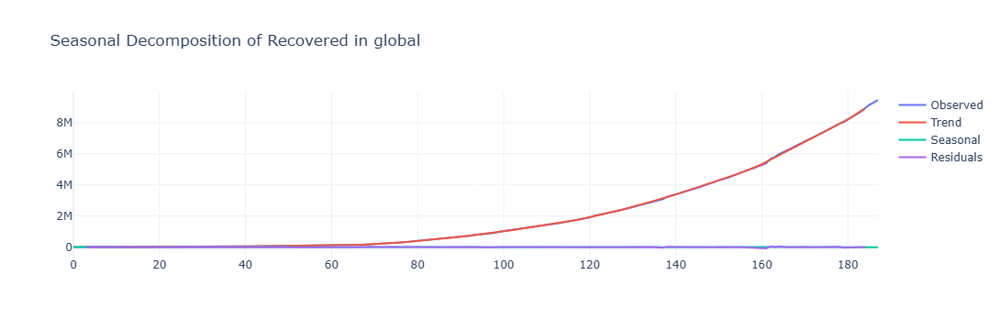

-------------------- Active --------------------


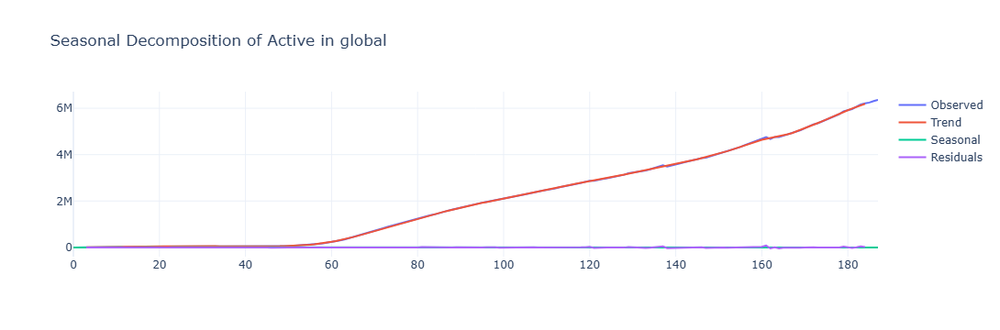

==================== americas ====================
-------------------- Confirmed --------------------


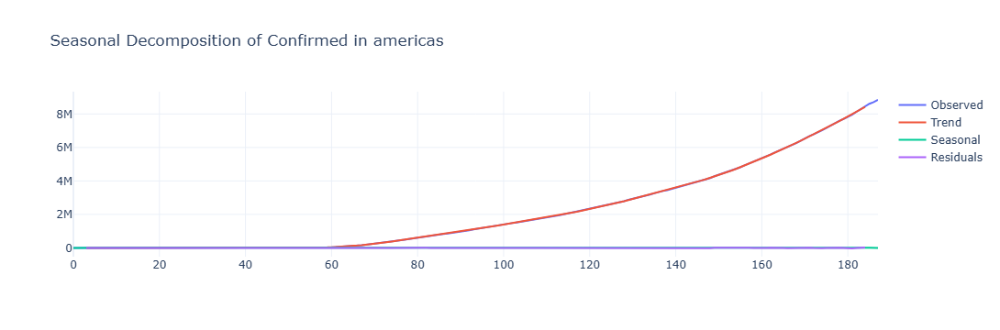

-------------------- Deaths --------------------


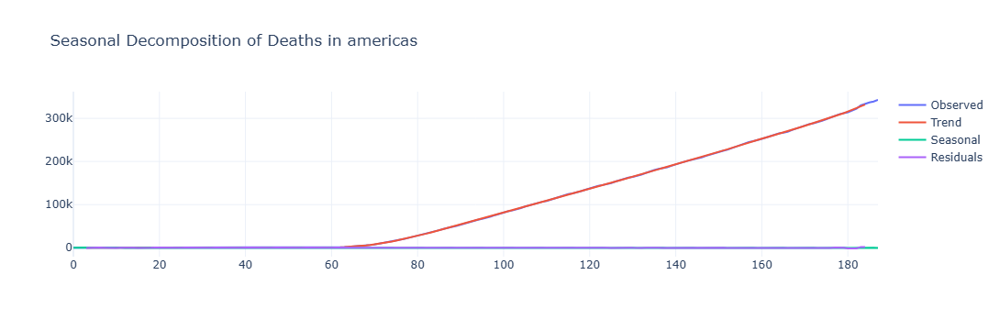

-------------------- Recovered --------------------


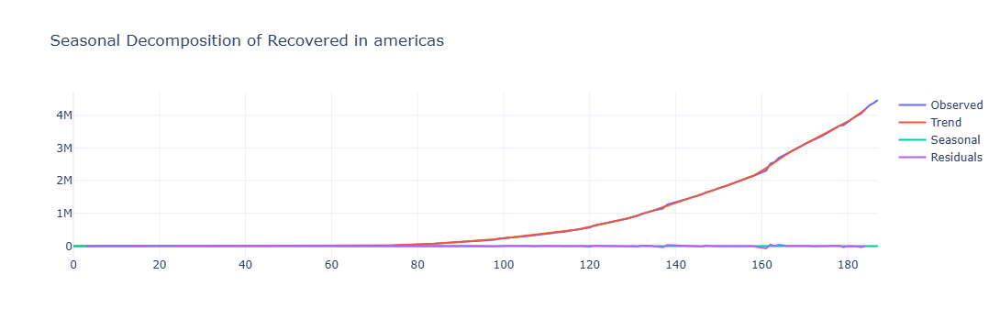

-------------------- Active --------------------


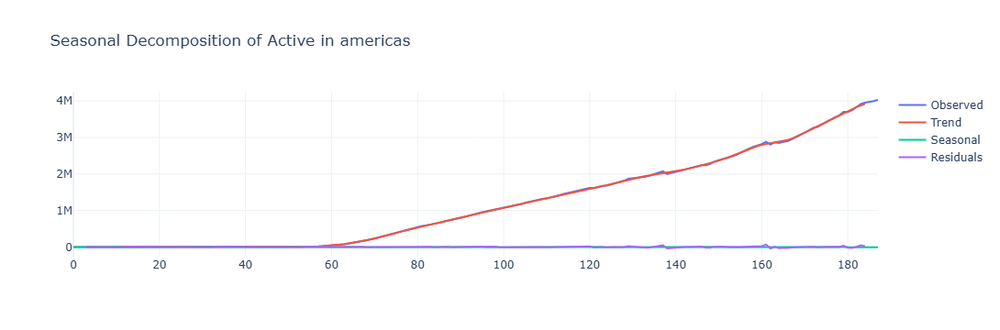

==================== Brazil ====================
-------------------- Confirmed --------------------


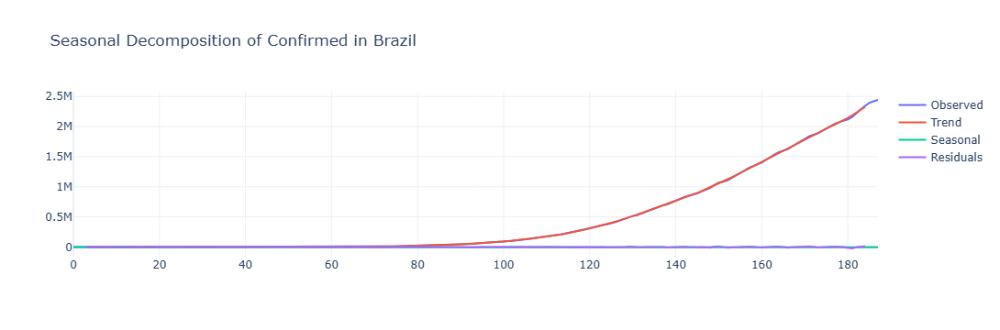

-------------------- Deaths --------------------


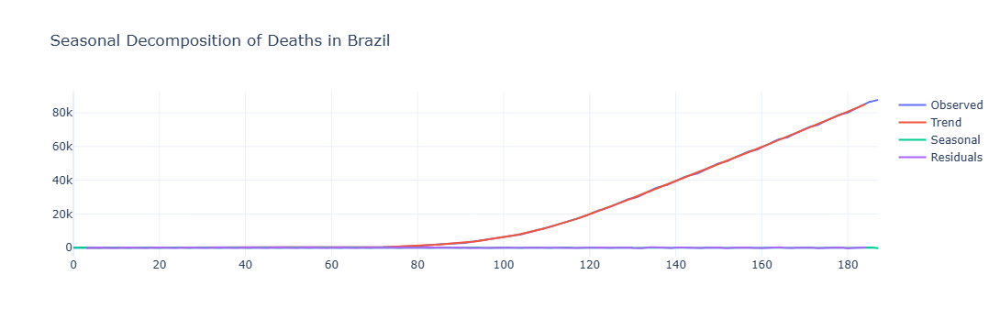

-------------------- Recovered --------------------


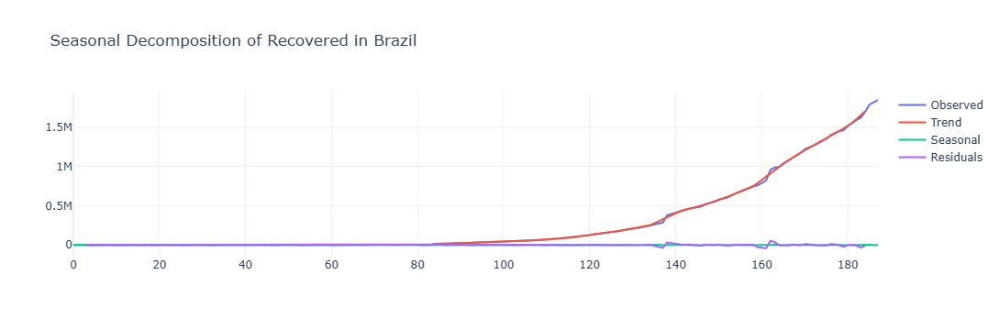

-------------------- Active --------------------


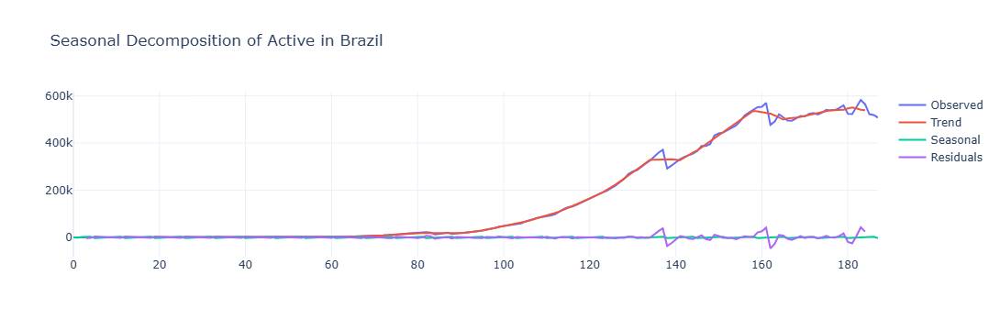

==================== India ====================
-------------------- Confirmed --------------------


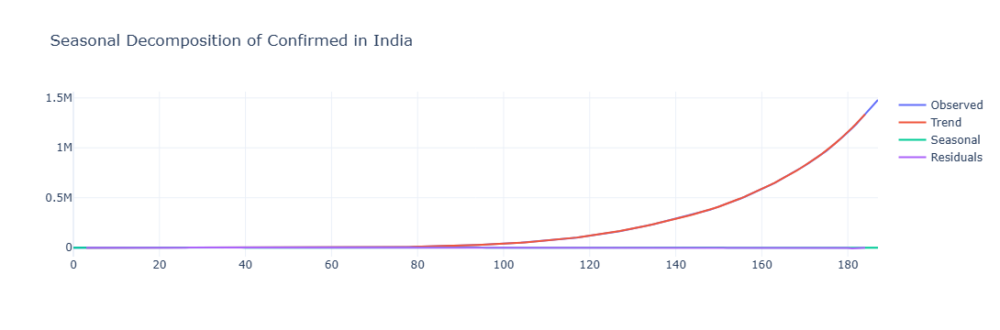

-------------------- Deaths --------------------


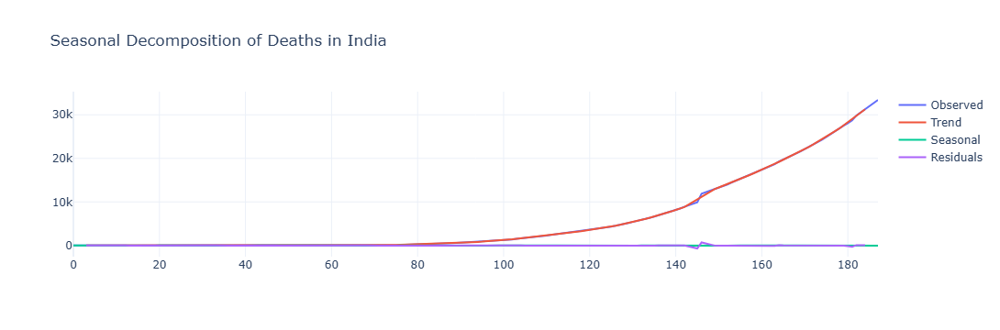

-------------------- Recovered --------------------


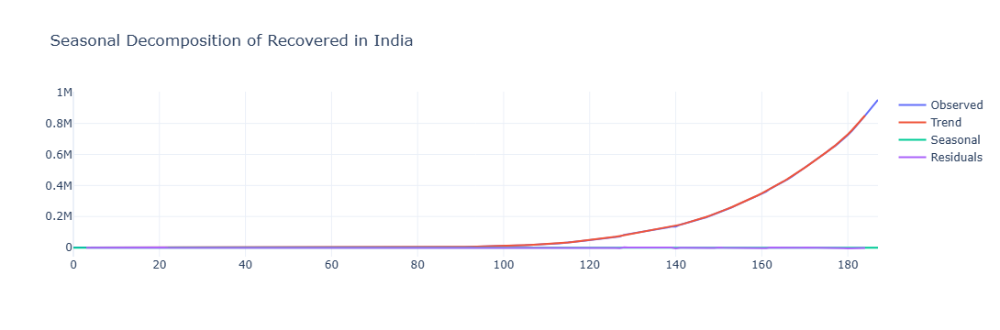

-------------------- Active --------------------


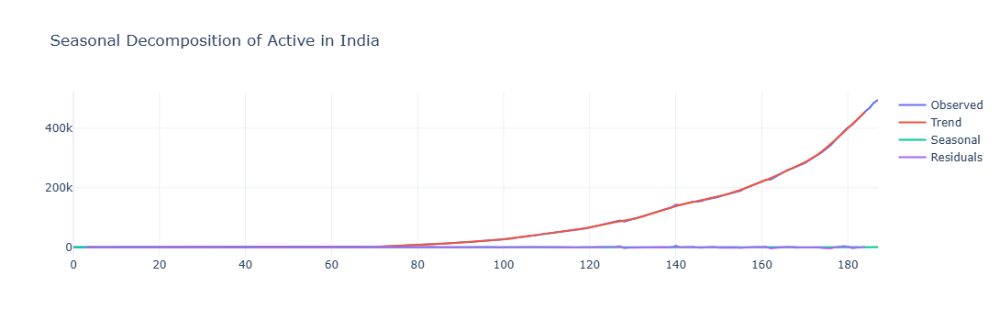

==================== Spain ====================
-------------------- Confirmed --------------------


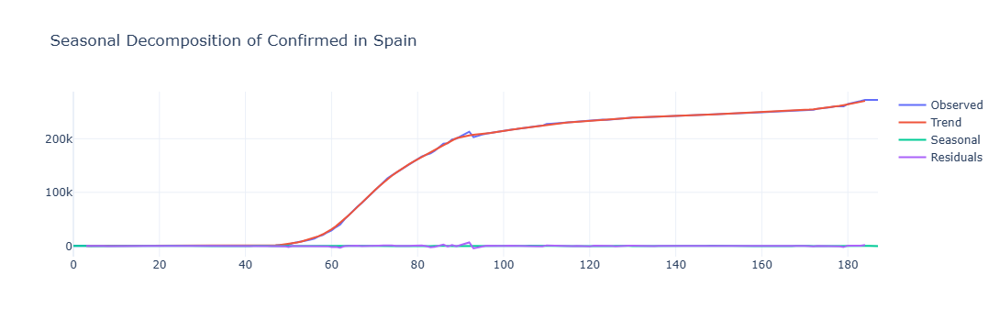

-------------------- Deaths --------------------


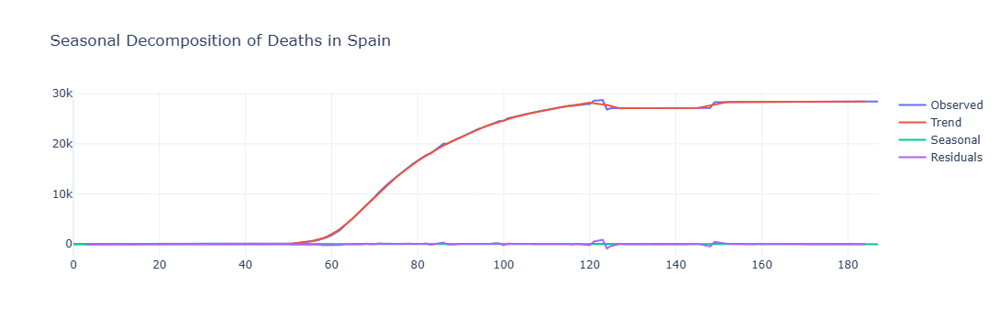

-------------------- Recovered --------------------


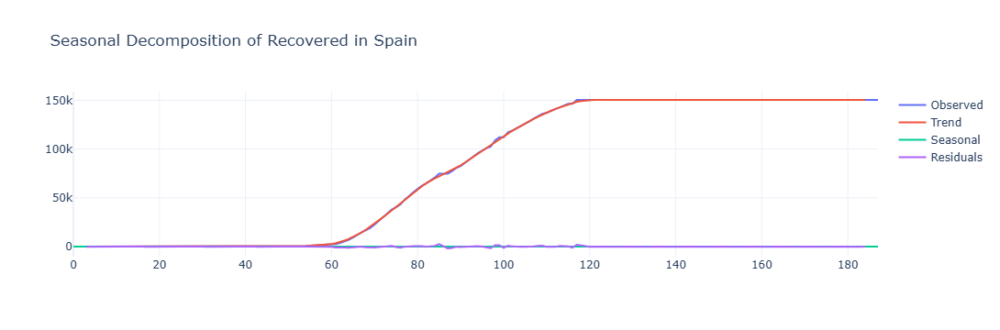

-------------------- Active --------------------


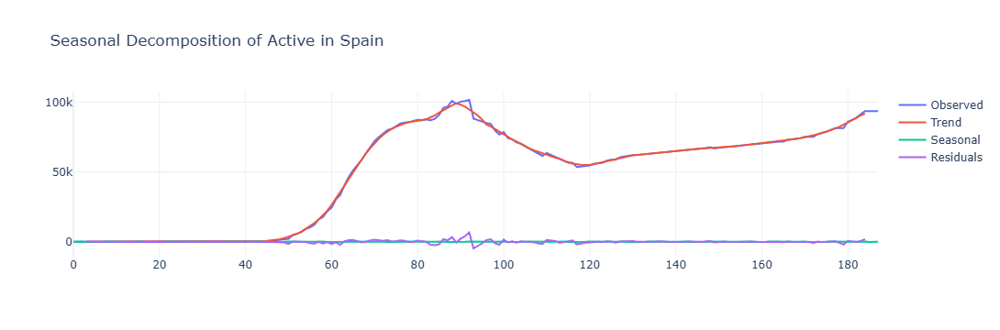

In [369]:
# Seasonal Decomposition
import plotly.graph_objects as go
from statsmodels.tsa.seasonal import seasonal_decompose
for k, data in data_dict.items():
    print('='*20, k, '='*20)
    _data = data.copy()
    _data = _data.set_index('Date',drop = True)
    for column in columns:
        print('--'*10, column, '--'*10)
        decomposition = seasonal_decompose(_data[column], model='additive')
        
        fig = go.Figure()
        fig.add_trace(go.Scatter(y=decomposition.observed, mode='lines', name='Observed'))
        fig.add_trace(go.Scatter(y=decomposition.trend, mode='lines', name='Trend'))
        fig.add_trace(go.Scatter(y=decomposition.seasonal, mode='lines', name='Seasonal'))
        fig.add_trace(go.Scatter(y=decomposition.resid, mode='lines', name='Residuals'))
        
        fig.update_layout(title=f'Seasonal Decomposition of {column} in {k}', template='plotly_white')
        fig.show()


### 2a. Rate of infection

In [434]:

def plot_rate(data, col):
    """
    Plots the daily percentage change of a specified column and calculates
    the average daily return and volatility.
    """
    if col not in data.columns:
        print(f"Error: Column '{col}' not found in the DataFrame.")
        return

    try:
        pct_change = data[col].pct_change()
    except TypeError:
        print(f"Error: Cannot calculate percentage change for column '{col}'. Check data types.")
        return

    x = pct_change.dropna()

    if x.empty:
        print(f"Warning: No valid data points after calculating percentage change for column '{col}'.")
        return

    try:
        confirmed_pct_change = data['Confirmed'].pct_change().dropna()
        date = data.loc[confirmed_pct_change.index, 'Date'] # Use loc instead of iloc
    except KeyError:
        print("Warning: 'Confirmed' or 'Date' columns not found. Using available index for date.")
        date = x.index

    fig = go.Figure(data=[go.Bar(x=date, y=x)])

    fig.update_layout(
        title=f'Rate of {col}',
        xaxis_title='Date',
        yaxis_title='Daily Change'
    )

    fig.show()

==================== global ====================


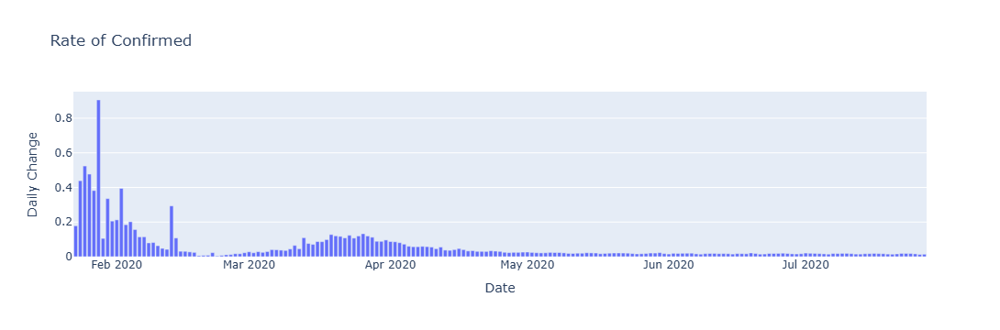

==================== americas ====================


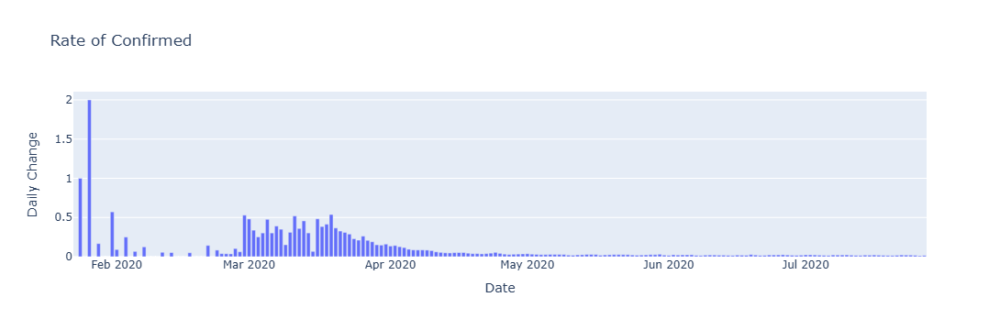

==================== Brazil ====================


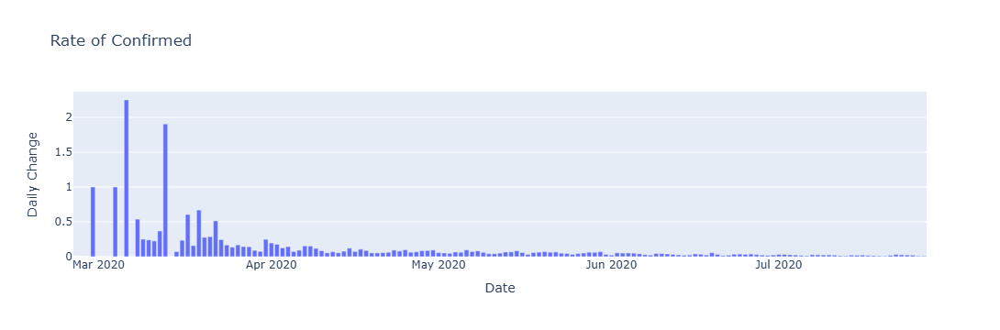

==================== India ====================


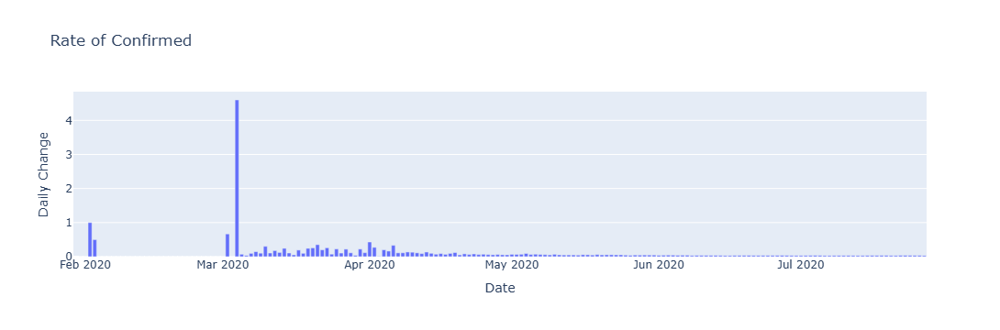

==================== Spain ====================


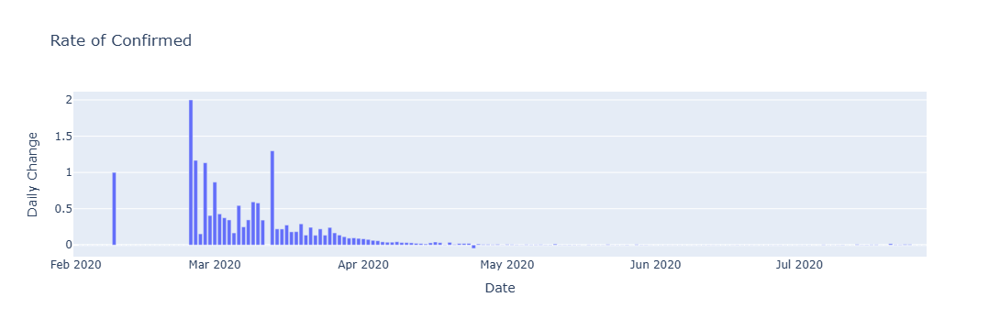

In [436]:
for k, data in data_dict.items():
    print('='*20, k, '='*20)
    plot_rate(data,'Confirmed')

### 2a. Rate of recovery

==================== global ====================


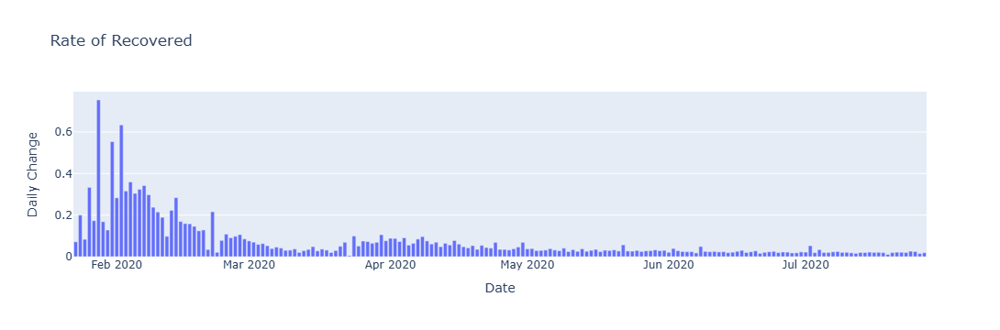

==================== americas ====================


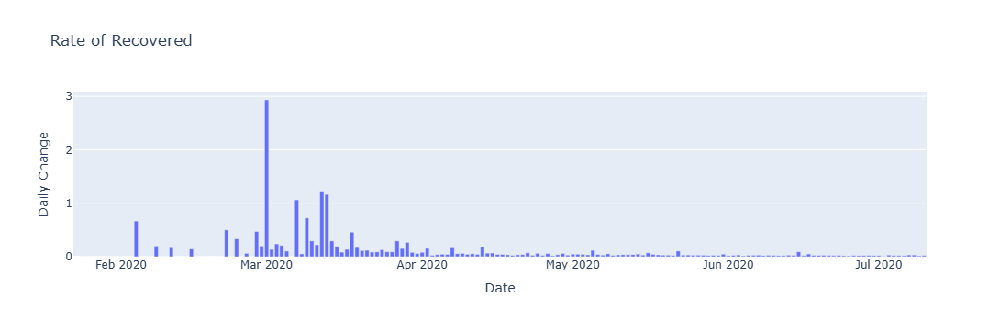

==================== Brazil ====================


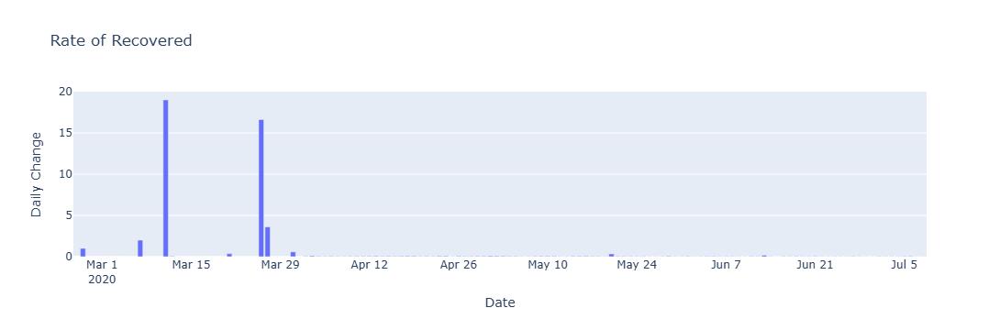

==================== India ====================


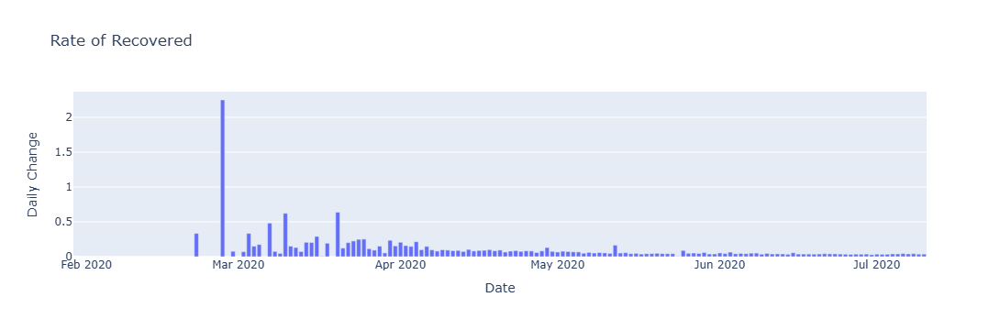

==================== Spain ====================


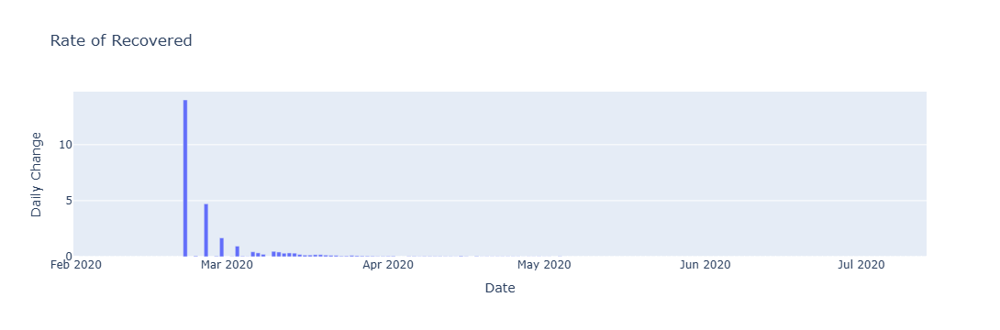

In [439]:
for k, data in data_dict.items():
    print('='*20, k, '='*20)
    plot_rate(data,'Recovered')

## 3. Make predictions about the number of cases expected a week in future based on the current trends

==================== global ====================
******************** Confirmed ********************


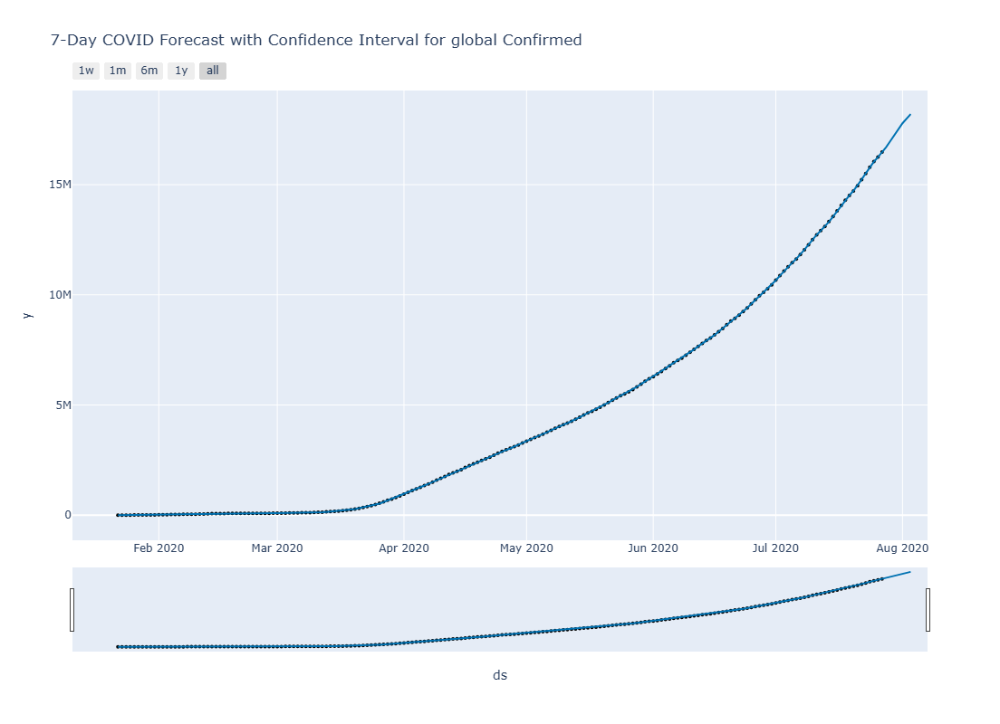

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,16702863.13,16695129.47,16711040.85
1,2020-07-29,16973468.69,16964583.34,16982524.71
2,2020-07-30,17257050.99,17247011.90,17268590.21
3,2020-07-31,17541311.14,17526918.32,17560322.86
4,2020-08-01,17787836.41,17766576.44,17814972.41
5,2020-08-02,17995859.59,17963036.35,18039337.56
6,2020-08-03,18201541.25,18157405.65,18253739.57


******************** Deaths ********************


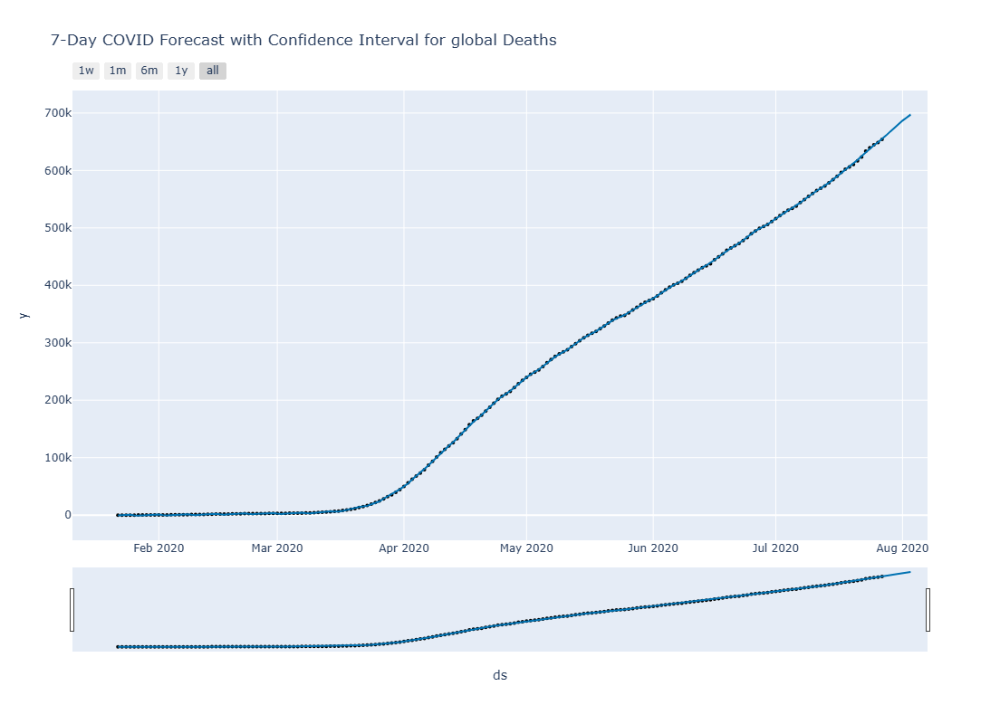

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,661039.30,660158.52,661877.00
1,2020-07-29,667709.08,666836.18,668544.29
2,2020-07-30,674431.48,673412.20,675482.18
3,2020-07-31,680887.65,679719.91,682079.01
4,2020-08-01,686716.04,685308.28,688090.04
5,2020-08-02,691869.41,689928.94,693814.98
6,2020-08-03,697214.55,694852.25,699770.42


******************** Recovered ********************


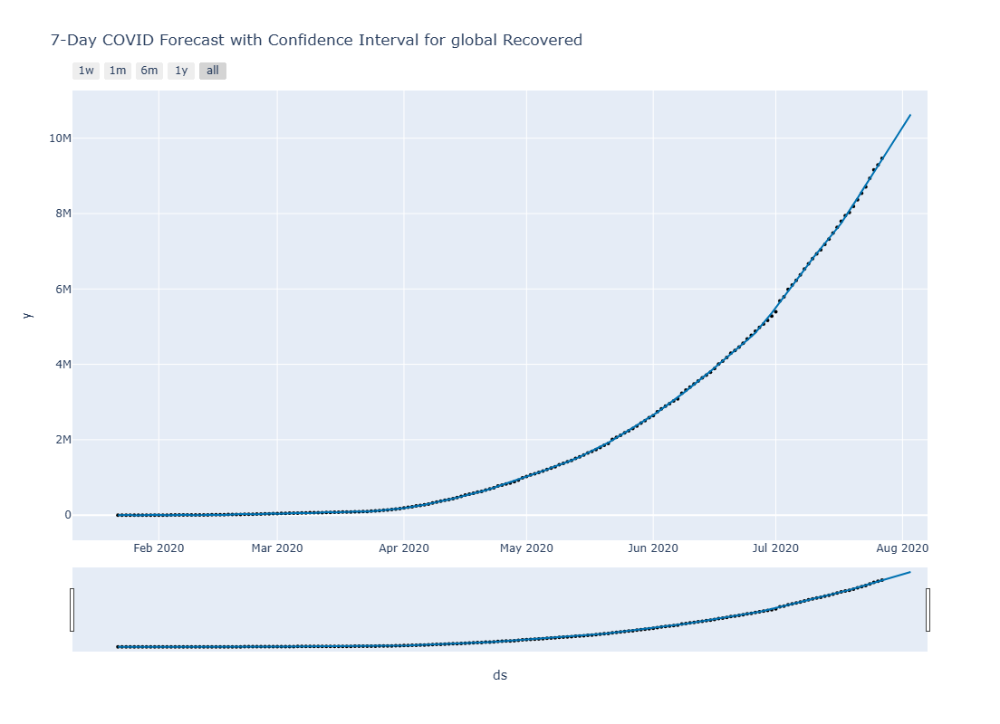

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,9605734.18,9580643.42,9629252.67
1,2020-07-29,9781291.64,9756208.85,9805067.49
2,2020-07-30,9958578.13,9931765.40,9983819.83
3,2020-07-31,10132340.06,10101950.46,10159683.12
4,2020-08-01,10304051.02,10272256.95,10331328.32
5,2020-08-02,10461846.27,10424858.46,10496588.59
6,2020-08-03,10630404.85,10584458.40,10669816.71


******************** Active ********************


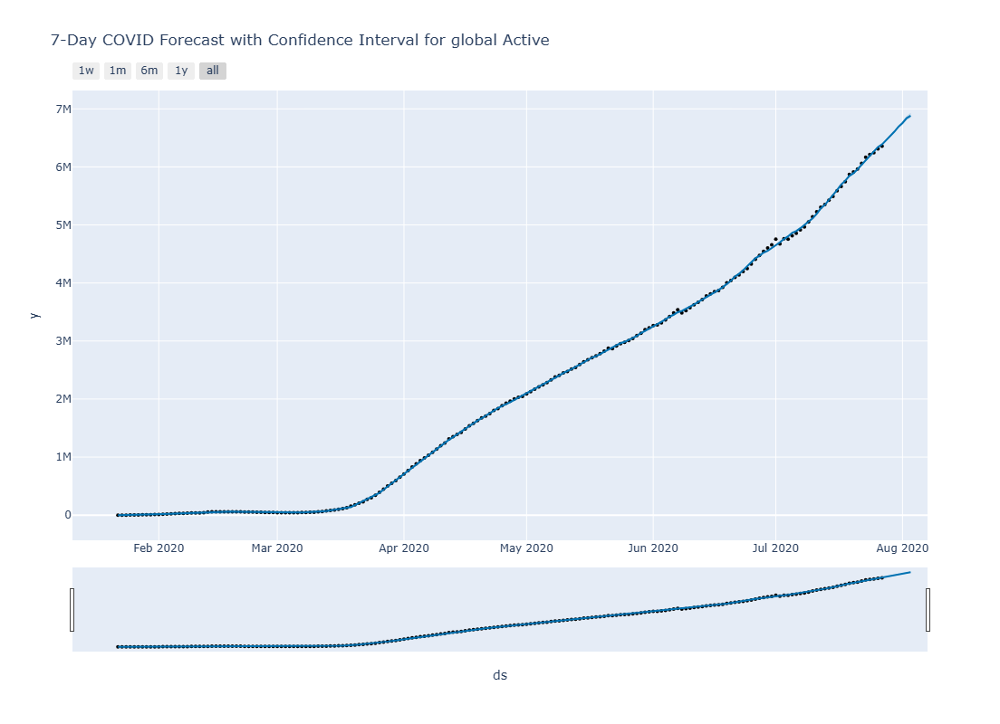

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,6456493.40,6433870.97,6479075.11
1,2020-07-29,6530785.59,6507357.01,6554310.04
2,2020-07-30,6606927.28,6582613.59,6630984.50
3,2020-07-31,6691935.11,6666214.21,6718693.59
4,2020-08-01,6755257.06,6725979.59,6783488.82
5,2020-08-02,6840620.58,6807967.88,6877770.31
6,2020-08-03,6883048.74,6842266.57,6923133.79


==================== americas ====================
******************** Confirmed ********************


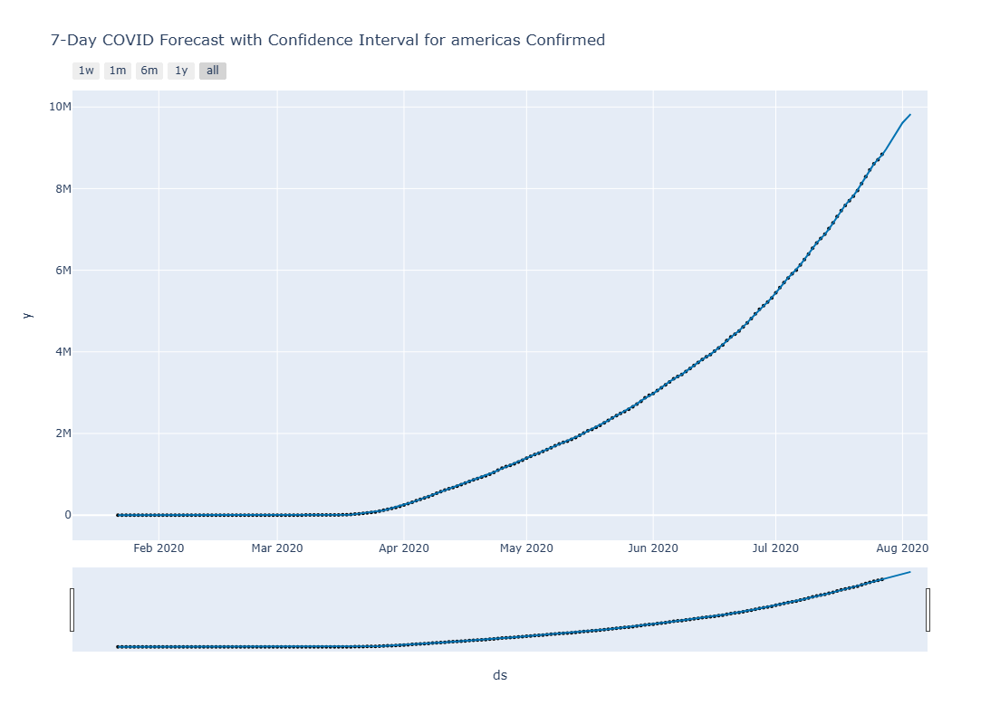

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,8967865.21,8962083.18,8973337.96
1,2020-07-29,9128851.28,9121678.61,9135386.00
2,2020-07-30,9298689.07,9290269.92,9306520.90
3,2020-07-31,9470520.27,9460217.39,9479946.60
4,2020-08-01,9612827.68,9597452.90,9624726.52
5,2020-08-02,9718611.45,9697420.99,9736343.86
6,2020-08-03,9825279.91,9796532.56,9851654.50


******************** Deaths ********************


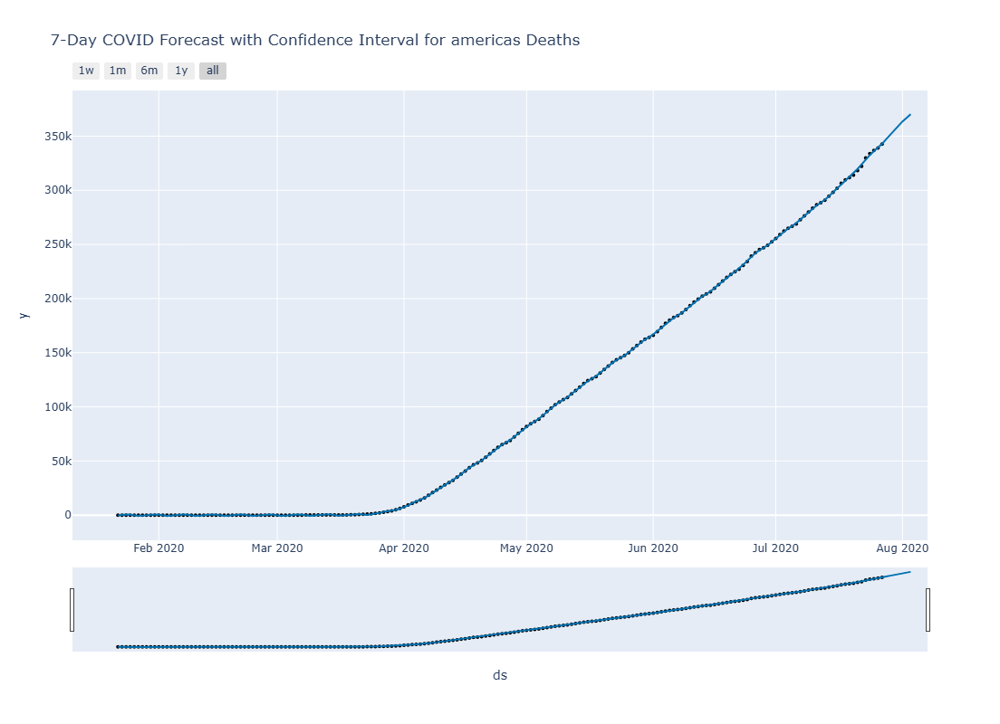

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,347139.95,346555.26,347728.03
1,2020-07-29,351406.84,350777.22,352020.29
2,2020-07-30,355830.33,355188.09,356460.07
3,2020-07-31,359896.57,359172.39,360622.34
4,2020-08-01,363615.37,362854.52,364491.87
5,2020-08-02,366881.64,365999.57,367804.51
6,2020-08-03,370334.05,369213.54,371515.28


******************** Recovered ********************


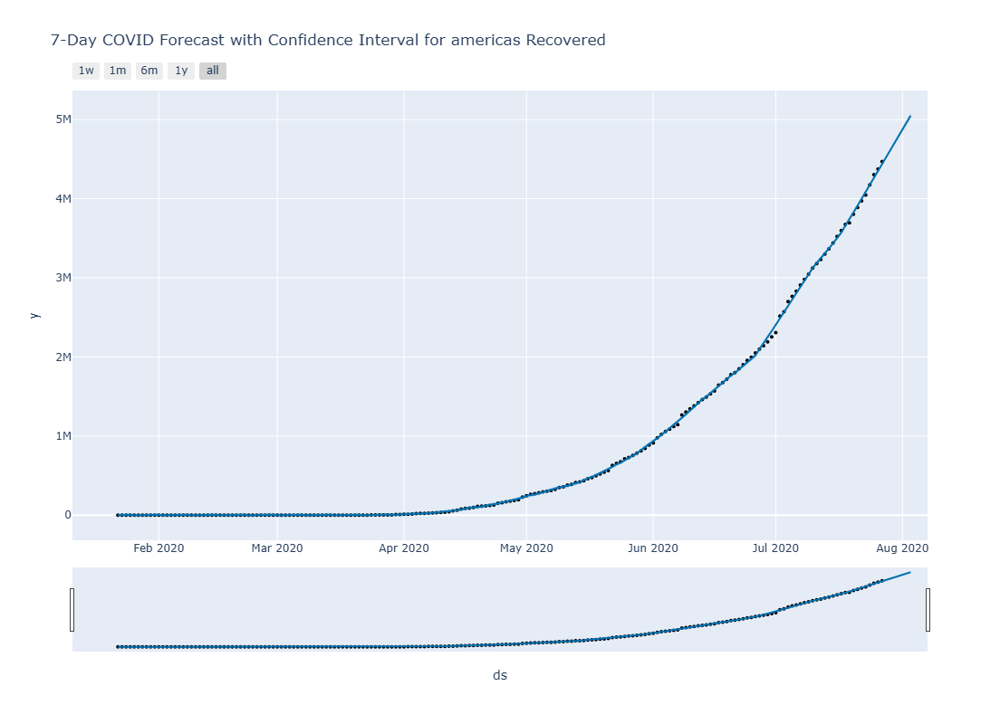

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,4524018.91,4503148.54,4545776.59
1,2020-07-29,4612263.35,4590254.43,4632892.11
2,2020-07-30,4703460.69,4681659.20,4726408.43
3,2020-07-31,4792410.73,4769449.15,4817251.11
4,2020-08-01,4881344.64,4856481.53,4908889.72
5,2020-08-02,4960677.07,4934498.01,4989427.23
6,2020-08-03,5050626.02,5018662.22,5080619.59


******************** Active ********************


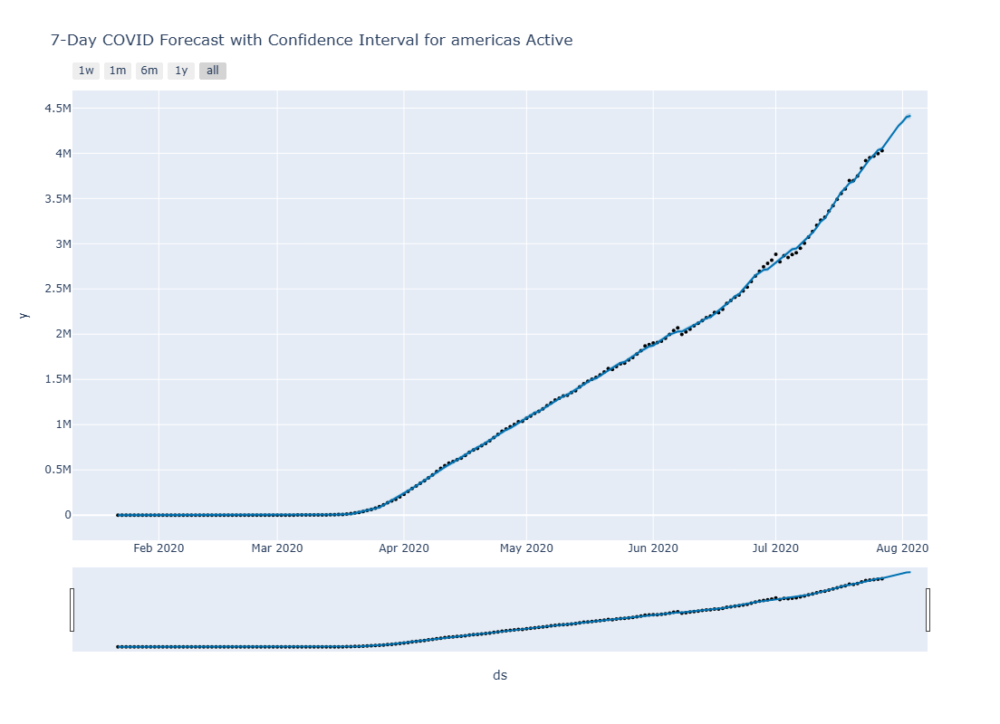

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,4113895.02,4091351.21,4135254.24
1,2020-07-29,4178058.95,4156304.02,4201260.52
2,2020-07-30,4235410.90,4212485.17,4258554.46
3,2020-07-31,4303304.82,4279395.64,4328160.11
4,2020-08-01,4347062.68,4321608.16,4374614.06
5,2020-08-02,4402093.70,4372706.02,4434079.55
6,2020-08-03,4414303.88,4383079.10,4449606.48


==================== Brazil ====================
******************** Confirmed ********************


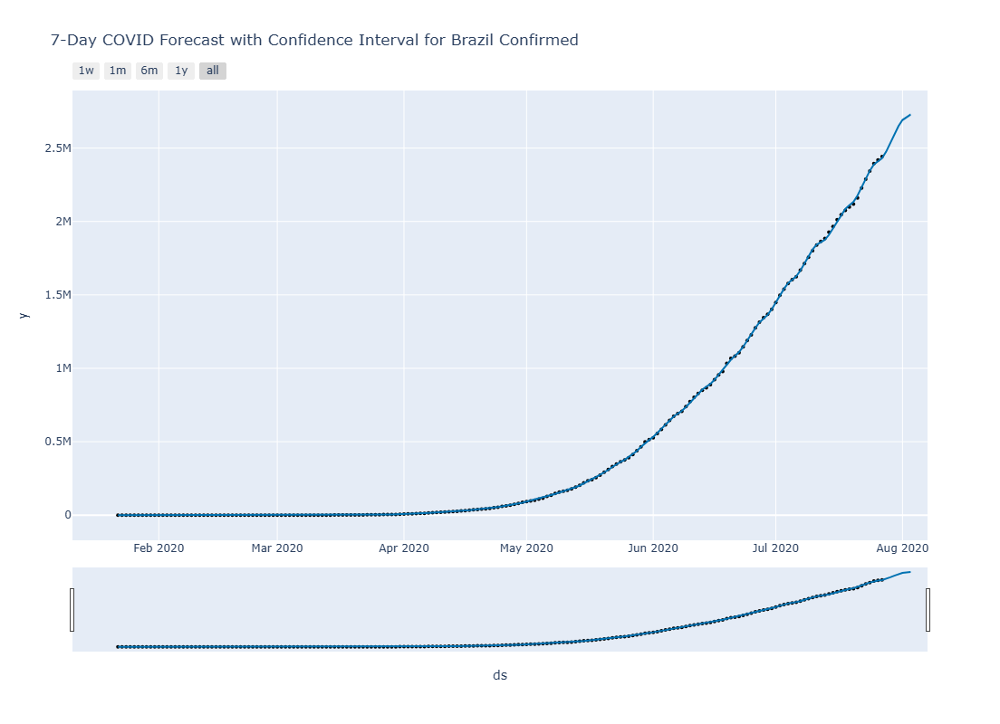

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,2475350.50,2470202.47,2480213.98
1,2020-07-29,2535398.44,2529978.04,2540614.23
2,2020-07-30,2592420.74,2586040.87,2598434.26
3,2020-07-31,2648865.46,2641909.73,2655991.24
4,2020-08-01,2691549.45,2684450.34,2698845.89
5,2020-08-02,2712010.38,2703723.97,2722606.75
6,2020-08-03,2728895.71,2718584.38,2741720.45


******************** Deaths ********************


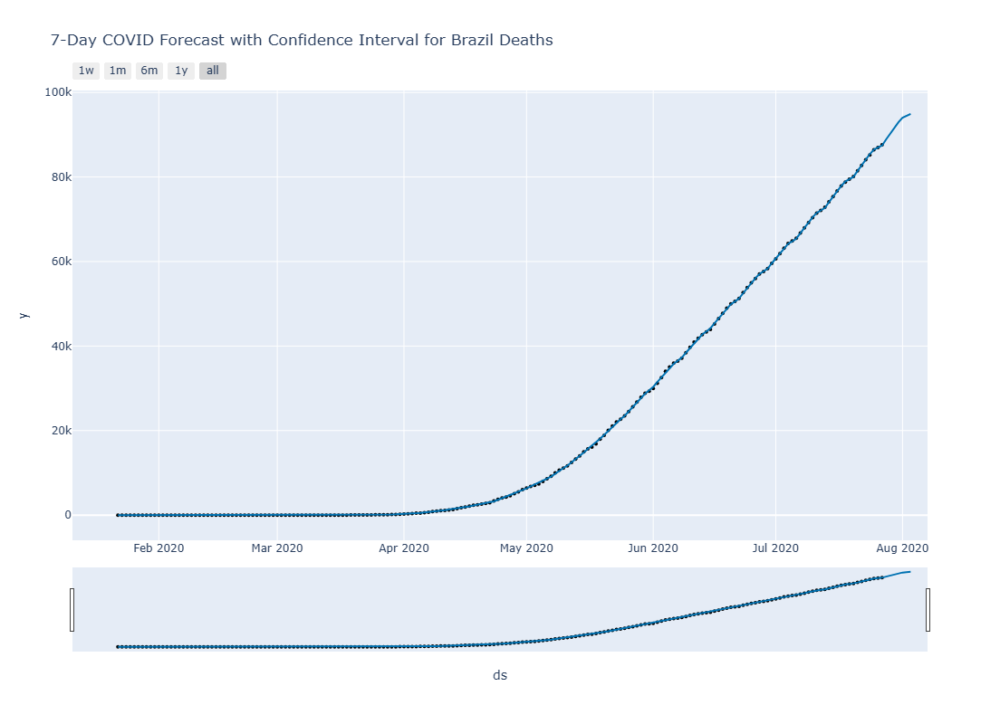

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,88916.45,88800.28,89040.23
1,2020-07-29,90277.82,90156.77,90400.12
2,2020-07-30,91724.65,91601.41,91844.82
3,2020-07-31,92959.21,92806.82,93108.07
4,2020-08-01,94021.94,93859.60,94197.31
5,2020-08-02,94411.37,94222.66,94604.90
6,2020-08-03,94910.60,94668.08,95125.67


******************** Recovered ********************


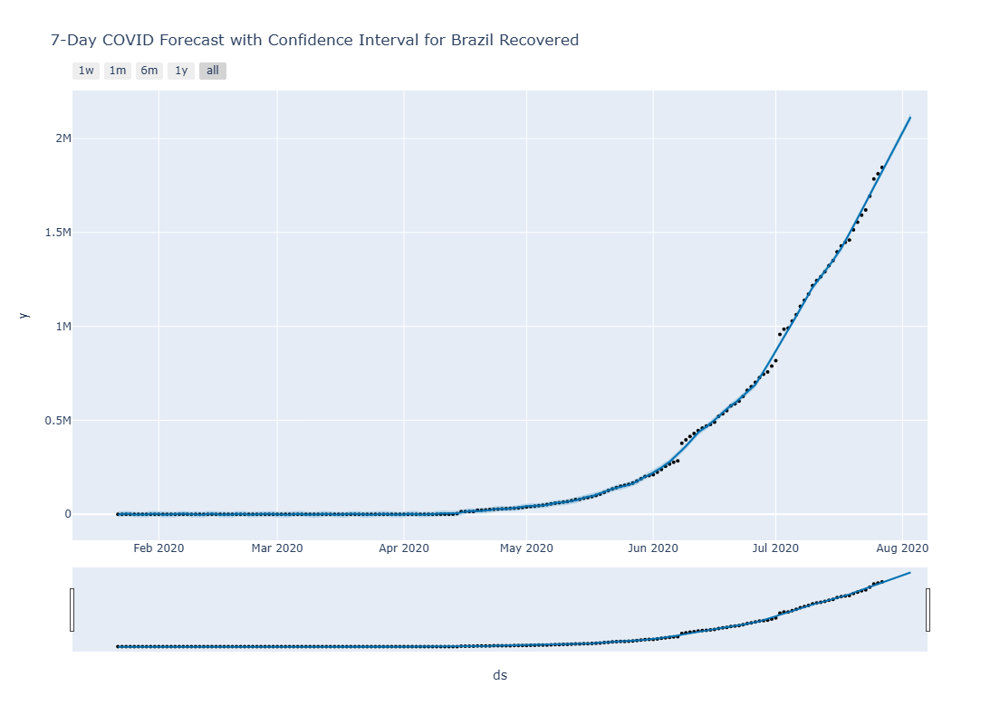

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,1865184.79,1849571.01,1880552.95
1,2020-07-29,1907508.31,1891901.82,1922544.99
2,2020-07-30,1952627.90,1937664.26,1969554.67
3,2020-07-31,1994930.27,1978227.02,2010967.93
4,2020-08-01,2035113.05,2017810.55,2051624.20
5,2020-08-02,2072605.76,2053325.75,2091033.79
6,2020-08-03,2114616.59,2093769.37,2133092.56


******************** Active ********************


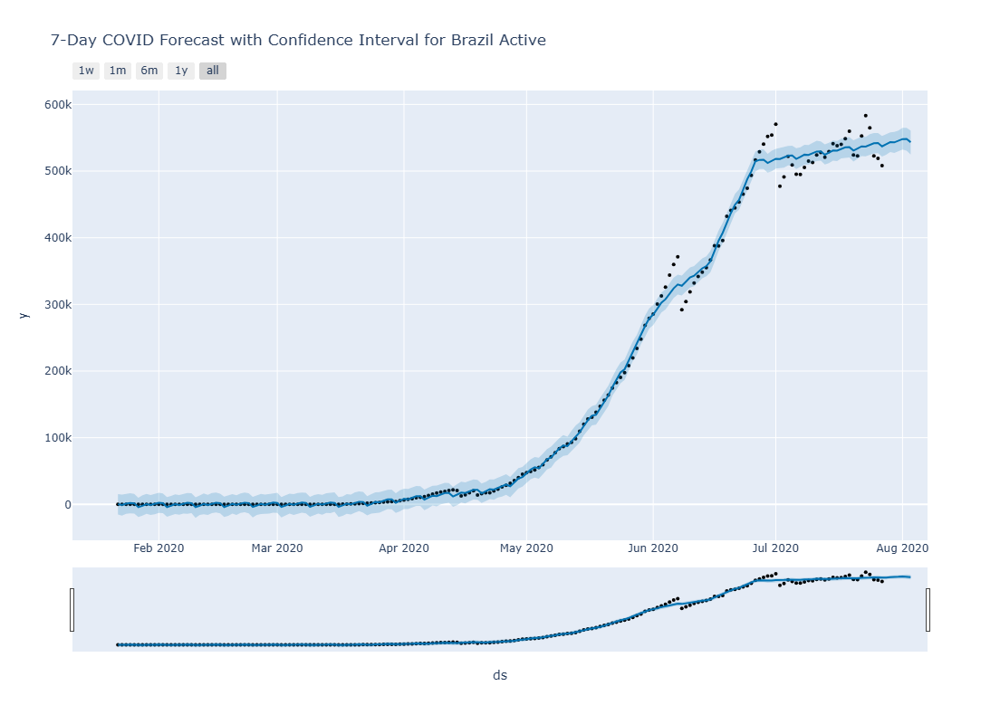

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,540145.96,525505.50,554530.50
1,2020-07-29,543395.74,527647.82,557973.19
2,2020-07-30,543045.60,528080.90,558349.22
3,2020-07-31,545894.30,530491.26,560748.06
4,2020-08-01,548060.55,531009.27,564308.64
5,2020-08-02,548331.29,531140.99,565721.03
6,2020-08-03,543307.56,525252.24,560918.15


==================== India ====================
******************** Confirmed ********************


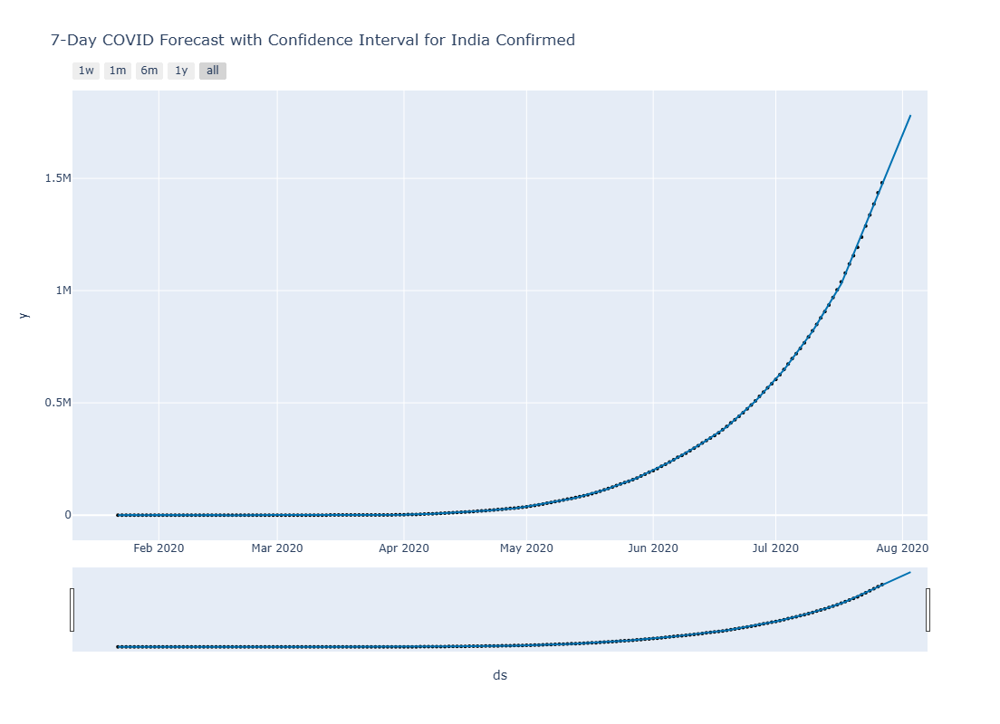

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,1515200.13,1512735.04,1517660.16
1,2020-07-29,1559865.83,1557107.58,1562723.86
2,2020-07-30,1604957.86,1601485.54,1607928.47
3,2020-07-31,1649924.44,1645793.82,1653572.54
4,2020-08-01,1694049.43,1688874.46,1698551.80
5,2020-08-02,1738341.56,1731964.72,1744238.12
6,2020-08-03,1782021.75,1772387.86,1789587.67


******************** Deaths ********************


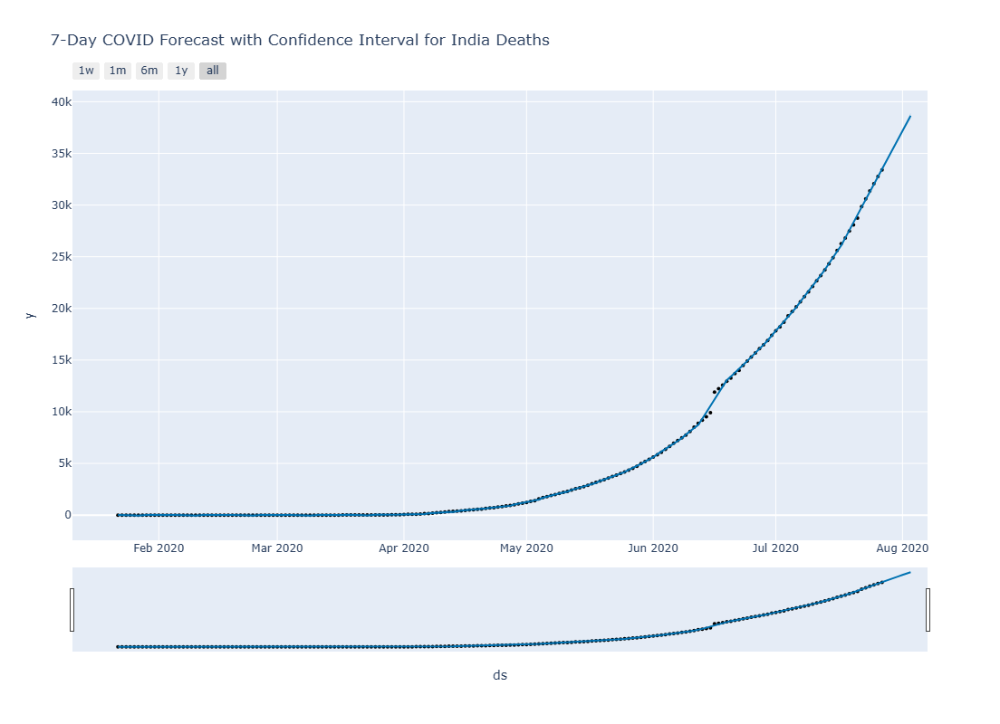

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,34243.64,34128.92,34359.41
1,2020-07-29,34997.99,34881.36,35115.53
2,2020-07-30,35741.96,35610.10,35878.45
3,2020-07-31,36483.26,36335.52,36639.90
4,2020-08-01,37203.33,37034.22,37391.25
5,2020-08-02,37925.07,37739.93,38127.54
6,2020-08-03,38643.82,38409.17,38925.49


******************** Recovered ********************


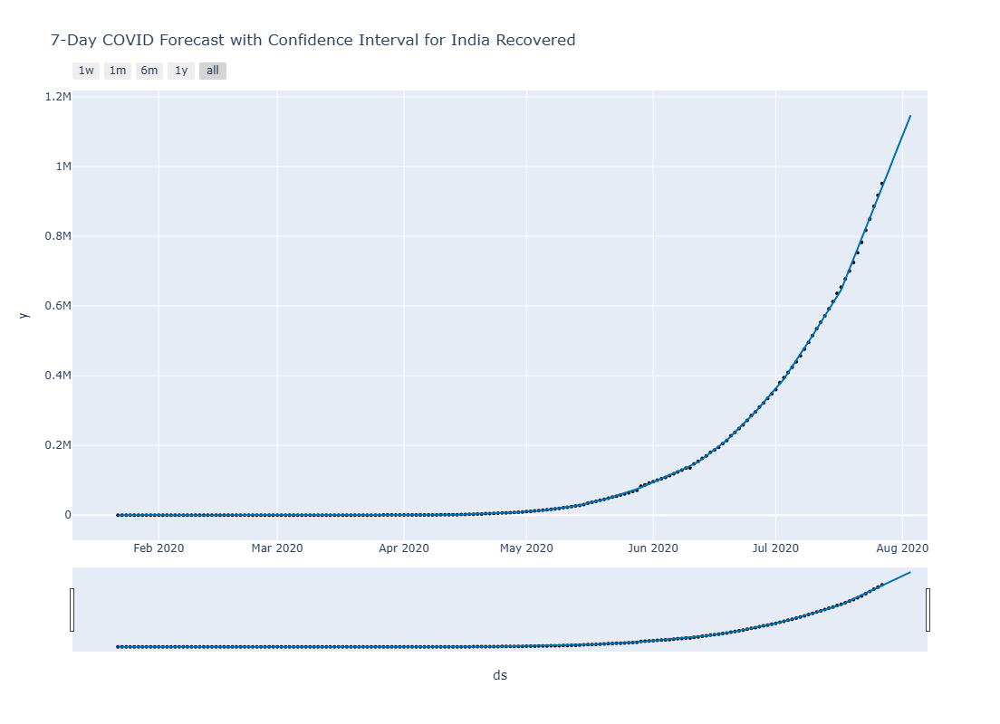

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,969703.99,966795.38,972478.43
1,2020-07-29,999126.11,996154.31,1002225.18
2,2020-07-30,1029669.14,1026258.12,1032725.36
3,2020-07-31,1059563.20,1056204.24,1063013.93
4,2020-08-01,1089041.43,1085077.37,1093437.28
5,2020-08-02,1118080.14,1113677.68,1123056.83
6,2020-08-03,1147377.48,1142000.77,1153578.67


******************** Active ********************


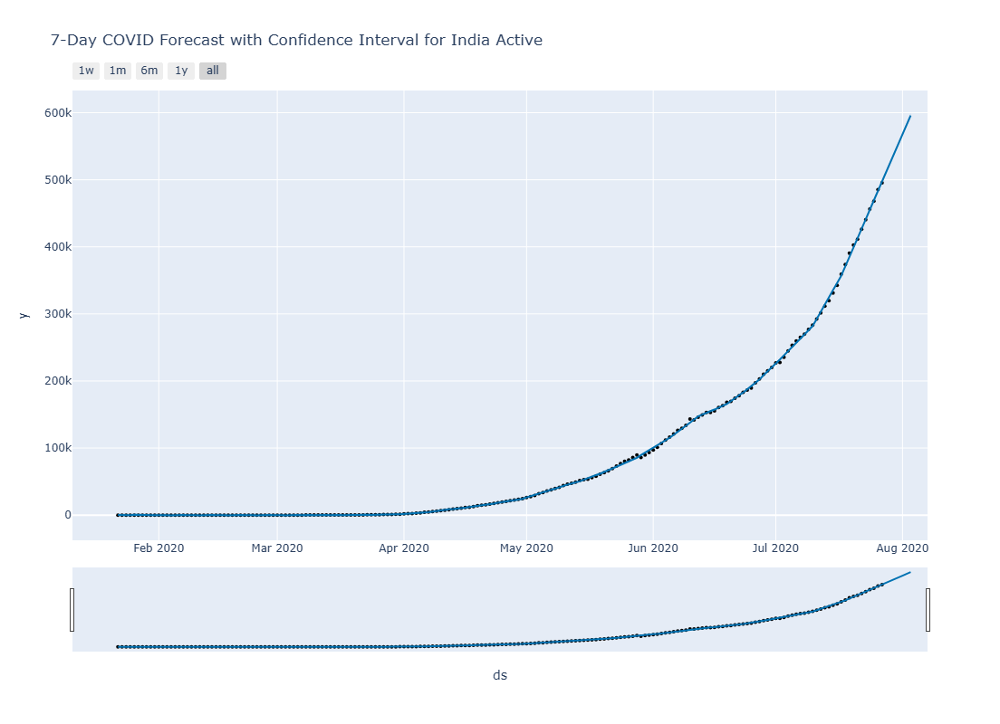

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,511174.83,509442.24,513032.59
1,2020-07-29,525659.26,523811.46,527560.43
2,2020-07-30,539457.60,537441.53,541329.53
3,2020-07-31,553780.67,551531.66,556017.29
4,2020-08-01,567700.97,565116.96,570137.54
5,2020-08-02,582226.20,579012.18,585041.64
6,2020-08-03,595884.09,592042.07,599297.37


==================== Spain ====================
******************** Confirmed ********************


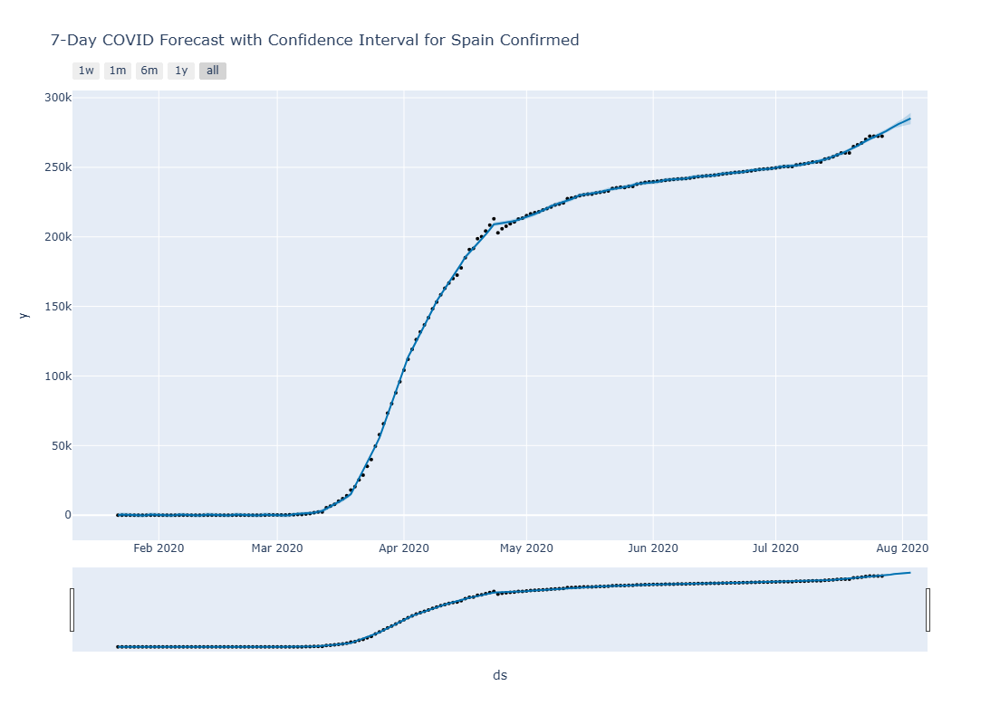

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,276042.65,274508.46,277460.23
1,2020-07-29,277806.98,276222.21,279345.49
2,2020-07-30,279683.95,278027.37,281420.82
3,2020-07-31,281031.10,279261.95,283081.44
4,2020-08-01,282350.03,280062.66,284609.85
5,2020-08-02,283623.48,280868.03,286546.33
6,2020-08-03,285192.73,281589.40,289051.11


******************** Deaths ********************


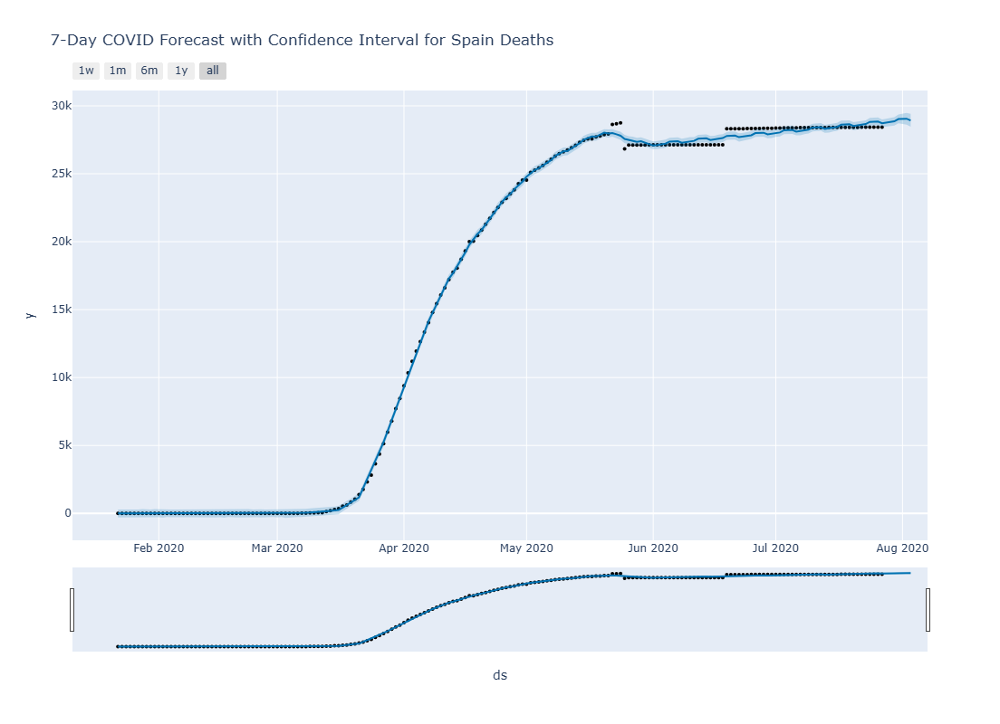

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,28760.76,28483.87,29064.11
1,2020-07-29,28814.66,28508.10,29119.42
2,2020-07-30,28864.73,28526.13,29190.60
3,2020-07-31,29027.93,28702.24,29385.13
4,2020-08-01,29051.29,28681.40,29439.47
5,2020-08-02,29054.29,28661.91,29464.51
6,2020-08-03,28926.12,28436.53,29379.94


******************** Recovered ********************


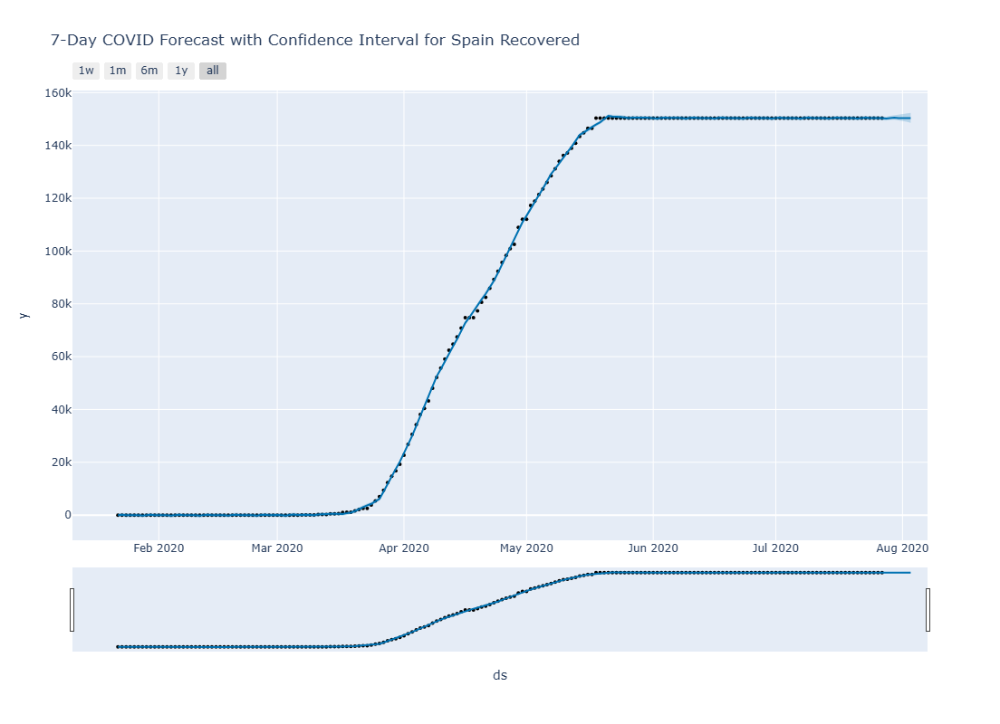

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,150150.84,149393.51,150885.80
1,2020-07-29,150381.30,149598.89,151172.67
2,2020-07-30,150523.55,149655.01,151395.13
3,2020-07-31,150367.21,149402.62,151317.48
4,2020-08-01,150459.57,149305.71,151623.58
5,2020-08-02,150371.63,148933.49,151888.63
6,2020-08-03,150311.33,148380.40,152200.83


******************** Active ********************


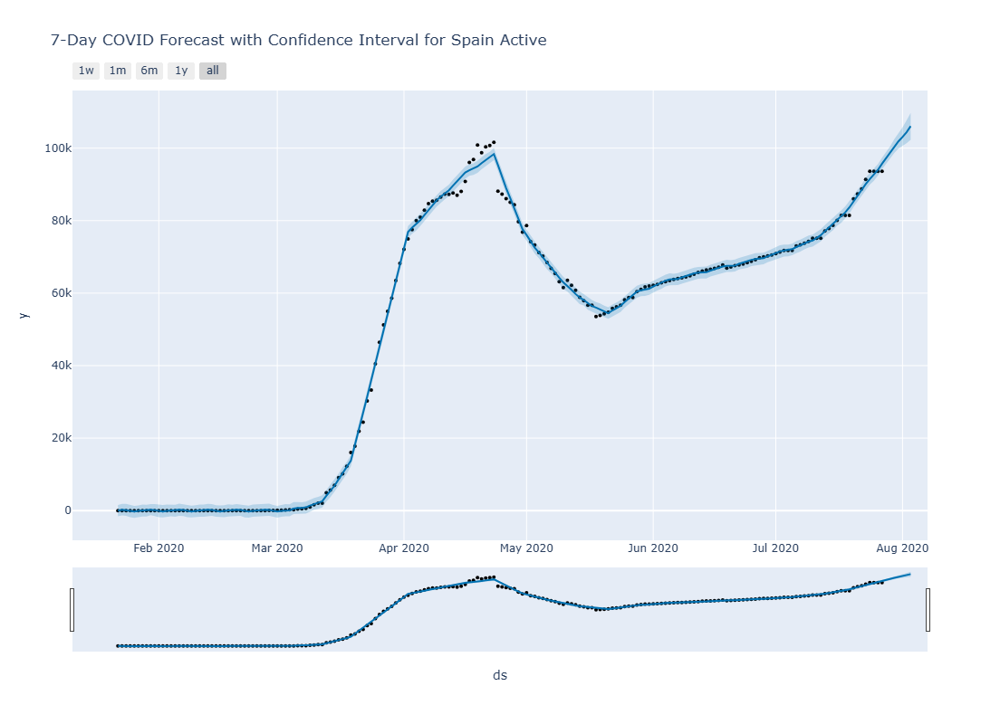

,ds,yhat,yhat_lower,yhat_upper
0,2020-07-28,97294.51,95623.09,98944.60
1,2020-07-29,98769.91,97045.13,100514.96
2,2020-07-30,100461.81,98751.20,102279.30
3,2020-07-31,101864.02,99891.97,103981.48
4,2020-08-01,103066.50,100548.92,105423.31
5,2020-08-02,104409.19,101423.57,107370.97
6,2020-08-03,106082.79,102324.85,109695.19


In [446]:
import joblib
for j,(k, data) in enumerate(data_dict.items()):
    print('='*20, k,'='*20)
    for i,col in enumerate(['Confirmed', 'Deaths', 'Recovered', 'Active']):
        print('**'*10,col,'**'*10)

        loaded_model = joblib.load(f'{k}_{col}_prophet_model.joblib')
        future = loaded_model.make_future_dataframe(periods=7)  
        forecast = loaded_model.predict(future)
        
        fig = plot_plotly(loaded_model, forecast)
        fig.update_layout(
            title=f'7-Day COVID Forecast with Confidence Interval for {k} {col}',
            width=1200,
            height=800
        )
        fig.show()


        forecast=pd.read_csv(f'{k}_{col}_weekly_forecast.csv')
        display(forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail(7))

# Thank You!
Avinash Mishra